# Import

In [1]:
import numpy as np
import matplotlib
import pandas as pd
import healpy as hp
import scipy
import matplotlib.patches as patches
import photutils
import seaborn as sns

from matplotlib import pyplot as plt
from scipy.io import FortranFile as ff
from scipy.ndimage import gaussian_filter
from scipy import interpolate
from astropy.utils.data import get_pkg_data_filename
from astropy.io import fits 
from scipy import stats
from ipywidgets import IntProgress
from IPython.display import display
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LinearSegmentedColormap
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from matplotlib.colors import LogNorm
from regions import PixCoord, CircleSkyRegion, CirclePixelRegion, RectangleSkyRegion, RectanglePixelRegion
from photutils import CircularAperture, CircularAnnulus
from matplotlib.gridspec import GridSpec
from mpl_toolkits.axes_grid1 import make_axes_locatable 
from matplotlib.lines import Line2D
from matplotlib import rcParams
    
cFS = '#80A4ED'
cnoFS ='#87A937'
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B


rcParams["text.usetex"] = 'True'
rcParams['font.family'] = 'serif'
rcParams['font.serif'] = 'Times'
rcParams["xtick.direction"] = "in"
rcParams["ytick.direction"] = "in"
rcParams["xtick.minor.visible"] = "True"
rcParams["ytick.minor.visible"] = "True"
plt.rc('font', size=15) 
plt.rc('text.latex', preamble=r'\usepackage{amsmath,newtxmath}')

# Functions

In [2]:
def read_file(Dir,FileName,ndir):
    f = ff('%s/%s_spectrum'%(Dir,FileName))
    n = f.read_ints()[0]
    aperture,lmin,lmax = f.read_reals('d')
    spec = np.zeros((ndir,n))
    spec[0,:] = f.read_reals('d')
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        spec[j,:] = f.read_reals('d')
    f.close()

    return lmin,lmax,n,spec

# To get the spectra, in the appropriate units
def read_spectrum_si(path_to_data, halo):
    f = ff('%s/%s/SiII_SMC/spectra_SiII_1260/IC_photons_%i_nphots'%(path_to_data,str(halo).zfill(5),
                                                                          1000000))
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file('%s/%s/SiII_SMC/spectra_SiII_1260/'%(path_to_data,str(halo).zfill(5)),'output.out',ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux


def read_spectrum_c(path_to_data,halo):
    f = ff('%s/%s/CII_SMC/spectra_CII_1334/IC_photons_%i_nphots'%(path_to_data,str(halo).zfill(5),
                                                                          1000000))
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file('%s/%s/CII_SMC/spectra_CII_1334/'%(path_to_data,str(halo).zfill(5)),'output.out',ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux


def read_cube(path,ndir):
    
    f = ff('%s/output.out_cube'%path,'r')
    nlbda,nxy = f.read_ints()
    lmin,lmax,imsize = f.read_reals('d')
    center = f.read_reals('d')
    cube = np.zeros((ndir,nxy,nxy,nlbda))
    cube1 = f.read_reals('d')
    cube[0] = cube1.reshape(nxy,nxy,nlbda)
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        f.read_reals('d')
        cube1 = f.read_reals('d')
        cube[j] = cube1.reshape((nxy,nxy,nlbda))
    f.close()
    
    f = ff('%s/IC_photons_16000000_nphots'%path,'r')
    nphot = f.read_ints()[0]
    total_lum = f.read_reals()
    f.close()
    
    l = np.linspace(lmin,lmax,nlbda)
    
    cube = cube*total_lum/nphot
    cube = cube*h_cgs*c_cgs / (l*1e-8)
    cube = cube/((lmax-lmin)/nlbda)   

    return nxy,imsize*cu_to_pc,l,cube

ndirections = 300
directions = np.zeros((ndirections,3))
for i in range(ndirections):
    directions[i,:] = hp.pix2vec(5,i)

In [42]:
def measureEWabs(lam, vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        fluxA[fluxA>1.0]=1.0
        EW = scipy.integrate.simps(fluxA[valid]-1, x = lam[valid])
        EWstd = 0
    else:
        mes = np.zeros(1000)
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            modFlux[modFlux>1] = 1
            modFlux[modFlux<0] = 0
            mes[i] =  scipy.integrate.simps(modFlux-1, x = lam[valid])
        EW = np.median(mes)
        EWstd = np.std(mes)
    return [EW, EWstd]

def measureEWemi(lam, vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        fluxA[fluxA<1]=1
        EW = scipy.integrate.simps(fluxA[valid]-1, x = lam[valid])
        EWstd = 0
    else:
        mes = np.zeros(1000)
        modFlux = fluxA[valid].copy()
        modFlux[modFlux<0.95] = 1
        EW =  scipy.integrate.simps(modFlux-1, x = lam[valid])
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            modFlux[modFlux<0.95] = 1
            mes[i] =  scipy.integrate.simps(modFlux-1, x = lam[valid])
        #EW = np.median(mes)
        EWstd = np.std(mes)
    return [EW, EWstd]

def measureMinVel(vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        modFlux = gaussian_filter(fluxA[valid], sigma = 0.)
        V = vel[valid][modFlux == np.min(modFlux)][0]
        Vstd = 0
        Fmin =  np.min(modFlux[(vel[valid]>=V-20) & (vel[valid] <=V+20)])
        Fstd = 0
    else:
        mes = np.zeros(1000)
        mes2 = np.zeros(1000)
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            mes[i] =  vel[valid][modFlux == np.min(modFlux)][0]
            mes2[i] =  np.median(modFlux[(vel[valid]>=mes[i]-20) & (vel[valid] <=mes[i]+20)])
        V = np.median(mes)
        Vstd = np.std(mes)        
        Fstd = np.std(mes2)
        Fmin = np.median(mes2)
    return [V, Vstd, Fmin, Fstd]

def measureMaxVel(vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        modFlux = gaussian_filter(fluxA[valid], sigma = 0.)
        V = vel[valid][modFlux == np.max(modFlux)][0]
        Vstd = 0
        Fmin = np.max(modFlux)
        Fstd = 0
    else:
        mes = np.zeros(1000)
        mes2 = np.zeros(1000)
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            mes[i] =  vel[valid][modFlux == np.max(modFlux)][0]
            mes2[i] = np.median(modFlux[(vel[valid]>= mes[i]-20) & (vel[valid] <= mes[i]+20)])
        V = np.median(mes)
        Vstd = np.std(mes)        
        Fstd = np.std(mes2)
        Fmin = np.median(mes2)  
    return [V, Vstd, Fmin, Fstd]

def measureCenV(vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)  
    vel2= vel[valid]
    if(np.sum(errA) == 0): 
        modFlux = gaussian_filter(1-fluxA[valid], sigma = 0.)
        modFlux[modFlux<= 0] = 0
        vcen = vel2[np.cumsum(modFlux)>= 0.5*np.max(np.cumsum(modFlux))][0]
        vstd = 0
    else:
        mes = np.zeros(1000)
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            modFlux = 1 - modFlux
            modFlux[modFlux<= 0] = 0
            mes[i] =  vel2[np.cumsum(modFlux)>= 0.5*np.max(np.cumsum(modFlux))][0]
        vcen = np.median(mes)
        vstd = np.std(mes)        
    return [vcen, vstd]

In [4]:
#Read Simu measurements

fescM = np.zeros(75)
fesc900M = np.zeros(75)
fesc = np.zeros((75,300))
fesc900 = np.zeros((75,300))

EWabsSiIIfs = np.zeros((75,300))
EWemiSiIIfs = np.zeros((75,300))
VabsSiIIfs = np.zeros((75,300))
VcenSiIIfs = np.zeros((75,300))
VemiSiIIfs = np.zeros((75,300))
RSiIIfs = np.zeros((75,300))
EWabsCIIfs = np.zeros((75,300))
EWemiCIIfs = np.zeros((75,300))
VabsCIIfs = np.zeros((75,300))
VcenCIIfs = np.zeros((75,300))
VemiCIIfs = np.zeros((75,300))
RCIIfs = np.zeros((75,300))

EWabsSiIInf = np.zeros((75,300))
EWemiSiIInf = np.zeros((75,300))
VabsSiIInf = np.zeros((75,300))
VcenSiIInf = np.zeros((75,300))
VemiSiIInf = np.zeros((75,300))
RSiIInf = np.zeros((75,300))
EWabsCIInf = np.zeros((75,300))
EWemiCIInf = np.zeros((75,300))
VabsCIInf = np.zeros((75,300))
VcenCIInf = np.zeros((75,300))
VemiCIInf = np.zeros((75,300))
RCIInf = np.zeros((75,300))

EWabsSiIIdu = np.zeros((75,300))
EWemiSiIIdu = np.zeros((75,300))
VabsSiIIdu = np.zeros((75,300))
VcenSiIIdu = np.zeros((75,300))
VemiSiIIdu = np.zeros((75,300))
RSiIIdu = np.zeros((75,300))
EWabsCIIdu = np.zeros((75,300))
EWemiCIIdu = np.zeros((75,300))
VabsCIIdu = np.zeros((75,300))
VcenCIIdu = np.zeros((75,300))
VemiCIIdu = np.zeros((75,300))
RCIIdu = np.zeros((75,300))


EWabsSiIIdep = np.zeros((75,300))
EWemiSiIIdep = np.zeros((75,300))
VabsSiIIdep = np.zeros((75,300))
VcenSiIIdep = np.zeros((75,300))
VemiSiIIdep = np.zeros((75,300))
RSiIIdep = np.zeros((75,300))
EWabsCIIdep = np.zeros((75,300))
EWemiCIIdep = np.zeros((75,300))
VabsCIIdep = np.zeros((75,300))
VcenCIIdep = np.zeros((75,300))
VemiCIIdep = np.zeros((75,300))
RCIIdep = np.zeros((75,300))
for i in range(75):
    f = pd.read_csv('dat_files/fesc/fesc_%d.txt'%int(i+90), delimiter = ' ', skiprows=1, header= None)
#     print(f)
    fesc[i,:]    = f[0]
    fesc900[i,:] = f[1]

    fescM[i] = np.round(np.mean(fesc[i,:]),4)
    fesc900M[i] = np.round(np.mean(fesc900[i,:]),4)
    
    EWSiII = pd.read_csv(f'CII_SiII_nofine/Measurements/SiII_%d_300.csv'%(i+90))
    EWCII = pd.read_csv(f'CII_SiII_nofine/Measurements/CII_%d_300.csv'%(i+90))
    
    EWabsSiIInf[i] = EWSiII['EWabsLR']
    EWemiSiIInf[i] = EWSiII['EWemiLR']
    VabsSiIInf[i]  = EWSiII['VabsLR']
    VcenSiIInf[i]  = EWSiII['VcenLR']
    VemiSiIInf[i]  = EWSiII['VemiLR']
    RSiIInf[i]     = EWSiII['RabsLR']
    EWabsCIInf[i]  = EWCII['EWabsLR']
    EWemiCIInf[i]  = EWCII['EWemiLR']
    VabsCIInf[i]   = EWCII['VabsLR']
    VcenCIInf[i]   = EWCII['VcenLR']
    VemiCIInf[i]   = EWCII['VemiLR']
    RCIInf[i]      = EWCII['RabsLR']
    
    EWSiII = pd.read_csv(f'CII_SiII_fine/Measurements/SiII_%d_300.csv'%(i+90))
    EWCII = pd.read_csv(f'CII_SiII_fine/Measurements/CII_%d_300.csv'%(i+90))
    
    EWabsSiIIfs[i] = EWSiII['EWabsLR']
    EWemiSiIIfs[i] = EWSiII['EWemiLR']
    VabsSiIIfs[i]  = EWSiII['VabsLR']
    VcenSiIIfs[i]  = EWSiII['VcenLR']
    VemiSiIIfs[i]  = EWSiII['VemiLR']
    RSiIIfs[i]     = EWSiII['RabsLR']
    EWabsCIIfs[i]  = EWCII['EWabsLR']
    EWemiCIIfs[i]  = EWCII['EWemiLR']
    VabsCIIfs[i]   = EWCII['VabsLR']
    VcenCIIfs[i]   = EWCII['VcenLR']
    VemiCIIfs[i]   = EWCII['VemiLR']
    RCIIfs[i]      = EWCII['RabsLR']
    
    EWSiII = pd.read_csv(f'CII_SiII_ND/Measurements/SiII_%d_300.csv'%(i+90))
    EWCII = pd.read_csv(f'CII_SiII_ND/Measurements/CII_%d_300.csv'%(i+90))
    
    EWabsSiIIdu[i] = EWSiII['EWabsLR']
    EWemiSiIIdu[i] = EWSiII['EWemiLR']
    VabsSiIIdu[i]  = EWSiII['VabsLR']
    VcenSiIIdu[i]  = EWSiII['VcenLR']
    VemiSiIIdu[i]  = EWSiII['VemiLR']
    RSiIIdu[i]     = EWSiII['RabsLR']
    EWabsCIIdu[i]  = EWCII['EWabsLR']
    EWemiCIIdu[i]  = EWCII['EWemiLR']
    VabsCIIdu[i]   = EWCII['VabsLR']
    VcenCIIdu[i]   = EWCII['VcenLR']
    VemiCIIdu[i]   = EWCII['VemiLR']
    RCIIdu[i]      = EWCII['RabsLR']
    
    EWSiII = pd.read_csv(f'CII_SiII_depletion/Measurements/SiII_%d_300.csv'%(i+90))
    EWCII = pd.read_csv(f'CII_SiII_depletion/Measurements/CII_%d_300.csv'%(i+90))
    
    EWabsSiIIdep[i] = EWSiII['EWabsLR']
    EWemiSiIIdep[i] = EWSiII['EWemiLR']
    VabsSiIIdep[i]  = EWSiII['VabsLR']
    VcenSiIIdep[i]  = EWSiII['VcenLR']
    VemiSiIIdep[i]  = EWSiII['VemiLR']
    RSiIIdep[i]     = EWSiII['RabsLR']
    EWabsCIIdep[i]  = EWCII['EWabsLR']
    EWemiCIIdep[i]  = EWCII['EWemiLR']
    VabsCIIdep[i]   = EWCII['VabsLR']
    VcenCIIdep[i]   = EWCII['VcenLR']
    VemiCIIdep[i]   = EWCII['VemiLR']
    RCIIdep[i]      = EWCII['RabsLR']
#     print(fescM, fesc900M
# print(VcenSiIInf)
Mgas = np.zeros(75)
f = pd.read_csv('dat_files/Mgas.dat', delimiter = ' ', header= None)
Mgas = f[3][f[0]>=90].values

Mhalo = np.zeros(75)
f = pd.read_csv('dat_files/Mhalo.dat', delimiter = ' ', header= None)
Mhalo = f[1][f[0]>=90].values

Mstar = np.zeros(75)
f = pd.read_csv('dat_files/Mstar.dat', delimiter = ' ', header= None)
Mstar = f[3][f[0]>=90].values
# print(Mstar)
Zgas = np.zeros(75)
f = pd.read_csv('dat_files/Zgas.dat', delimiter = ' ', header= None)
Zgas = f[1][f[0]>=90].values

Zstar = np.zeros(75)
f = pd.read_csv('dat_files/Zstar.dat', delimiter = ' ', header= None)
Zstar = f[1][f[0]>=90].values

SFR10 = np.zeros(75)
f = pd.read_csv('dat_files/SFR_10.dat', delimiter = ' ', header= None)
SFR10 = f[3][f[0]>=90].values

SFR100 = np.zeros(75)
f = pd.read_csv('dat_files/SFR_100.dat', delimiter = ' ', header= None)
SFR100 = f[3][f[0]>=90].values


EWabsSiIIim = np.zeros((300,63))
EWemiSiIIim =  np.zeros((300,63))
VcenSiIIim = np.zeros((300,63))
RSiIIim =  np.zeros((300,63))
EWabsCIIim =  np.zeros((300,63))
EWemiCIIim =  np.zeros((300,63))
VcenCIIim =  np.zeros((300,63))
RCIIim = np.zeros((300,63))
ContCIIim = np.zeros((300,63))
ContSiIIim =  np.zeros((300,63))

for i in range(300):
    
    EWSiII = pd.read_csv(f'data_cubes_output_148/Image_Measurements_dep/SiII_image_%d.csv'%(i))
    EWCII = pd.read_csv(f'data_cubes_output_148/Image_Measurements_dep/CII_image_%d.csv'%(i))
    
    EWabsSiIIim[i] = EWSiII['EWabs']
    EWemiSiIIim[i] = EWSiII['EWemi']
    VcenSiIIim[i]  = EWSiII['Vcen']
    RSiIIim[i]     = EWSiII['Rabs']
    ContSiIIim[i]     = EWSiII['Rabs']

    EWabsCIIim[i]  = EWCII['EWabs']
    EWemiCIIim[i]  = EWCII['EWemi']
    VcenCIIim[i]   = EWCII['Vcen']
    RCIIim[i]      = EWCII['Rabs']
    ContCIIim[i]      = EWCII['Rabs']

# Classy parameters

In [5]:
galaxy = ['J0021_0052','J0036_3333','J0127_0619','J0144_0453','J0337_0502','J0405_3648','J0808_3948',
          'J0823_2806','J0926_4427','J0934_5514','J0938_5428','J0940_2935','J0942_3547','J0944_0038',
          'J0944_3442','J1016_3754','J1024_0524','J1025_3622','J1044_0353','J1105_4444','J1112_5503',
          'J1119_5130','J1129_2034','J1132_1411','J1132_5722','J1144_4012','J1148_2546','J1150_1501',
          'J1157_3220','J1200_1343','J1225_6109','J1253_0312','J1314_3452','J1323_0132','J1359_5726',
          'J1416_1223','J1418_2102','J1428_1653','J1429_0643','J1444_4237','J1448_0110','J1521_0759',
          'J1525_0757','J1545_0858','J1612_0817']

label  = ['j0021+0052','j0036-3333','j0127-0619','j0144+0453','j0337-0502','j0405-3648','j0808+3948',
          'j0823+2806','j0926+4427','j0934+5514','j0938+5428','j0940+2935','j0942+3547','j0944-0038',
          'j0944+3442','j1016+3754','j1024+0524','j1025+3622','j1044+0353','j1105+4444','j1112+5503',
          'j1119+5130','j1129+2034','j1132+1411','j1132+5722','j1144+4012','j1148+2546','j1150+1501',
          'j1157+3220','j1200+1343','j1225+6109','j1253-0312','j1314+3452','j1323-0132','j1359+5726',
          'j1416+1223','j1418+2102','j1428+1653','j1429+0643','j1444+4237','j1448-0110','j1521+0759',
          'j1525+0757','j1545+0858','j1612+0817']

z = np.array([0.098393,0.020598,0.005400,0.005200,0.013520,0.002800,0.091230,
              0.047223,0.180667,0.002500,0.102102,0.001675,0.014857,0.004776,
              0.020046,0.003879,0.033191,0.126500,0.012870,0.021540,0.131635,
              0.004458,0.004703,0.017637,0.005041,0.126947,0.045117,0.002448,
              0.010970,0.066750,0.002341,0.022723,0.002885,0.022464,0.033829,
              0.123156,0.008550,0.181666,0.173502,0.002300,0.027412,0.094261,
              0.075791,0.037724,0.149143])

df = pd.read_csv('../Classy/AnalysisClassy.csv')
res   =  df['resol'].values
MstarAp   =  df['MstarAper'].values
MstarTot  =  df['MstarTot'].values
SFRAp  =  df['SFRAper'].values
SFRTot  =  df['SFRTot'].values
aperSize = df['aper'].values
fractAp = df['fr50aper'].values
EWLya = df['EWtotLya'].values

h_cgs     = 6.6260755e-27  # [erg s]
c_cgs     = 2.99792458e10  # [cm/s]
c = 299792.458

cu_to_cm  = 0.218526280953331e26
cu_to_pc  = cu_to_cm/3.086e18

classy = pd.read_csv('../Classy/AnalysisClassy.csv')
ClassFluo =  pd.read_csv('csv/Classy_Fluo.csv')

offsiIIfluo1265 = ((1265.002-1260.42)/1260.42*c)
offcIIfluo1335 = ((1335.708-1334.5322)/1334.532*c)
wcII1334  = 1334.532
wsiII1260 = 1260.42
wLya = 1215.67

nGal = len(galaxy)
mask_all = []

path_to_data_arr=['CII_SiII_nofine/', 'CII_SiII_fine/', 'CII_SiII_ND/', 'CII_SiII_depletion/']
sIIExclude = [2,4,10,11,13,22,24,27,30,32,36,39]

for i in range(nGal):
    spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[i].replace("_", ""), label[i])
    gal   = fits.open(spec)
    HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 
    mask  = HRB['MASK'].astype('bool')

    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']#[mask]
    flux   = data['flux']#[mask]
    fit    = gaussian_filter(data['fit'], sigma = 10)#[mask]
    fitori = gaussian_filter(data['fit'], sigma = 0)#[mask]
    err    = data['err']
    absflux = gaussian_filter(flux/fit,sigma = 0)

    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

    if label[i] == 'j0337-0502' :
        mask = mask | (abs(vcIId)<1000) | (abs(vsiIId) < 600)
        mask_all.append(mask)
    elif label[i] == 'j0405-3648':
        mask = mask & ~((vcIId < -500) & (vcIId > -1000)) & ~((vsiIId < -500) & (vsiIId > -1000))
        mask_all.append(mask)
    elif label[i] == 'j0823+2806':
        mask = mask | (abs(vsiIId) < 2000)
        mask_all.append(mask)
    elif label[i] == 'j0934+5514':
        mask = mask & ~((vcIId < -300) & (vcIId > -2000)) & ~((vsiIId < -300) & (vsiIId > -2000))
        mask_all.append(mask)
    elif label[i] == 'j0940+2935':
        mask = mask & ~((vcIId < -300) & (vcIId > -1200)) & ~((vsiIId < -300) & (vsiIId > -1200))
        mask_all.append(mask)
    elif label[i] == 'j0942+3547':
        mask = mask | (abs(vcIId)<1000) 
        mask_all.append(mask)
    elif label[i] == 'j0944+3442':
        mask = mask & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)
    elif label[i] ==  'j1016+3754':
        mask = mask & ~((vcIId < -600) & (vcIId > -1000))
        mask_all.append(mask)       
    elif label[i] == 'j1024+0524':
        mask = mask | (vsiIId < 300) | (vsiIId>700) 
        mask_all.append(mask)     
    elif label[i] == 'j1044+0353':
        mask = (mask | (vcIId < 1000)) & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)   
    elif label[i] == 'j1105+4444':
        mask = mask & ~((abs(vcIId)< 1500))
        mask_all.append(mask)    
    elif label[i] == 'j1132+1411':
        mask = mask | (vcIId < 00) 
        mask_all.append(mask)         
    elif label[i] == 'j1148+2546':
        mask = (mask & ~((abs(vcIId)< 1500))) | (abs(vsiIId) < 300) 
        mask_all.append(mask)  
    elif label[i] == 'j1157+3220':
        mask = mask & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)   
    elif label[i] == 'j1314+3452':
        mask = mask & ~((vcIId < -400) & (vcIId > -1000))
        mask_all.append(mask)   
    elif label[i] == 'j1359+5726':
        mask = mask & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)    
    elif label[i] == 'j1525+0757':
        mask = mask | ((abs(vsiIId)< 2000))
        mask_all.append(mask)        
    elif label[i] == 'j1545+0858':
        mask = mask | (vsiIId >-300) 
        mask_all.append(mask)      
    else:
        mask_all.append(mask)
        
        
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-800) & (vsiIId<2000) 

    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]
    if(i == 4):
        absflux[cutSiIIall] = absflux[cutSiIIall]/0.8


# Measure EWs, V and R

## CLASSY

J0021_0052
J0036_3333
J0127_0619
J0144_0453
J0337_0502
J0405_3648
J0808_3948
J0823_2806
J0926_4427
J0405_3648
J0808_3948
J0823_2806
J0926_4427
J0934_5514
J0938_5428
J0940_2935
J0942_3547


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/na

J0944_0038
J0938_5428
J0940_2935
J0942_3547
J0944_0038
J0944_3442
J1016_3754
J1024_0524
J1025_3622
J1044_0353
J1016_3754
J1024_0524
J1025_3622
J1044_0353
J1105_4444
J1112_5503
J1119_5130
J1129_2034
J1132_1411
J1112_5503
J1119_5130
J1129_2034
J1132_1411
J1132_5722
J1144_4012
J1148_2546
J1150_1501
J1157_3220


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


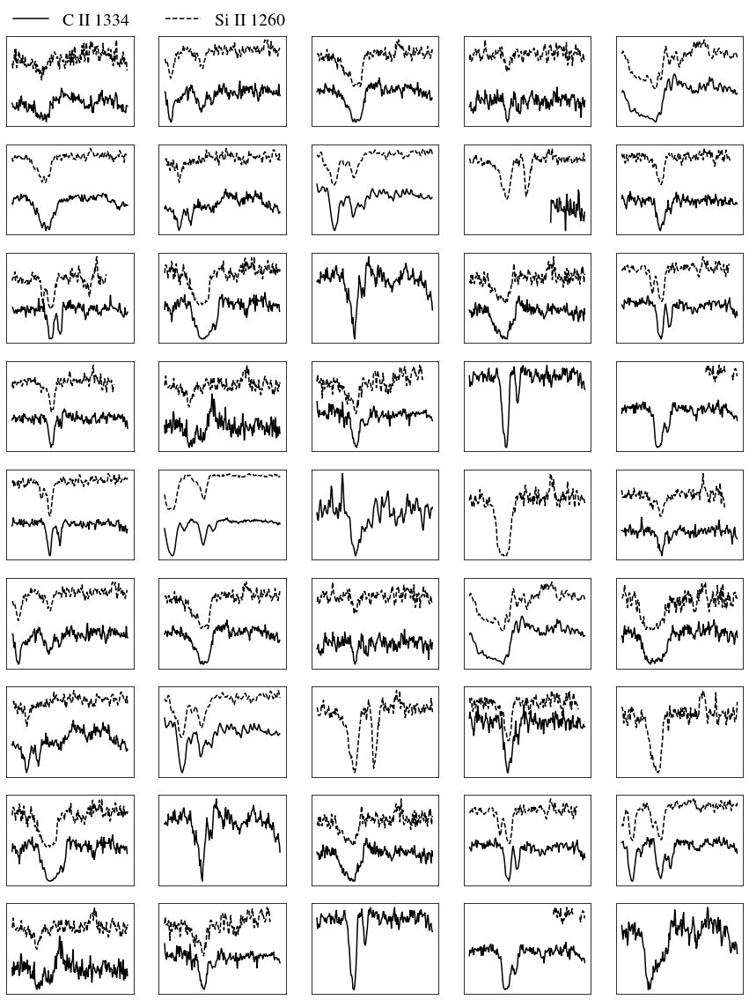

In [13]:
EWSi = np.zeros((45,2)) 
EWSi[EWSi == 0] = np.nan
EWC = np.zeros((45,2))
EWC[EWC == 0] = np.nan

FSi = np.zeros((45,2))
FSi[FSi == 0] = np.nan

FC = np.zeros((45,2))
FC[FC == 0] = np.nan

VSi = np.zeros((45,2))
VSi[VSi == 0] = np.nan

VC = np.zeros((45,2))
VC[VC == 0] = np.nan

fig, axs = plt.subplots(9,5,figsize=(15,20))

for j in range(5):
    for i in range(9):
        igal =j*5 +i
        spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[igal].replace("_", ""), label[igal])
        gal   = fits.open(spec)
    #     print(galaxy[i])
    #     if(galaxy[i] != 'J1323_0132'):
    #         continue
        print(galaxy[igal])
        HR    = gal[8].data  # Rest-frame, galactic extinction-corrected, co-added, high-resolution spectrum
        HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 

        wH, fH, eH, snrH  = HR['WAVE'],  HR['FLUX DENSITY'],  HR['ERROR'],  HR['SNR']
        wHB,fHB,eHB,snrHB = HRB['WAVE'], HRB['FLUX DENSITY'], HRB['ERROR'], HRB['SNR']

        hduin         = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[igal].replace("_", ""), label[igal].upper()))
        hdr           = hduin[1].header
        data          = hduin[1].data
        mask          = mask_all[igal]

        wave=data['wave']
        vcIId = (data['wave']/wcII1334 -1)*c
        vsiIId =  (data['wave']/wsiII1260 -1)*c

        flux = data['flux']

       # fit = gaussian_filter(data['fit'], sigma = 10)
        err = data['err']
       # absflux = gaussian_filter(data['flux']/fit,sigma = 1)
       # abserr = err/fit

        cutCIIall = (vcIId>-1000) & (vcIId<2000) 
        cutSiIIall = (vsiIId>-1000) & (vsiIId<2000)     

        maskCII  = mask[cutCIIall]
        maskSiII = mask[cutSiIIall]    

        fcII     = flux[cutCIIall]
        fsiII    = flux[cutSiIIall]
        ecII     = err[cutCIIall]
        esiII    = err[cutSiIIall]
        vcII     = vcIId[cutCIIall]
        vsiII    = vsiIId[cutSiIIall]

        rmedCII = ((vcII<-800) | ((vcII > 800) & (vcII < 1500))) & maskCII
        if(label[i] == 'j0808+3948'):
            rmedCII = ((vcII>-100) & (vcII < 100)) & maskCII
        fmedCII = np.nanmedian(fcII[rmedCII])
        fcII /= fmedCII

        rmedSiII = ((vsiII<-800) | ((vsiII > 300) & (vsiII < 500))| ((vsiII > 1600) & (vsiII < 2000))) & maskSiII
        if(label[i] == 'j0808+3948'):
            rmedSiII = ((vsiII>-200) & (vsiII < 100)) & maskSiII
    #     if(label[i] == 'j1323-1032'):
    #         rmedSiII = ((vsiII>1000) & (vsiII < 1600)) & maskSiII
        fmedSiII = np.nanmedian(fsiII[rmedSiII])
        fsiII /= fmedSiII



        axs[i,j].plot(vcII, fcII,  c='k', label = 'C II 1334')
#         axs[i,j].fill_between(vcII,fcII-ecII/fmedCII, fcII+ecII/fmedCII,  color= 'k', alpha = 0.1)
#         axs[i,j].set_title('C II 1334')
#         if(len(fcII[~maskCII])>0):
#             axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), 
#                             np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')  



        axs[i,j].plot(vsiII, fsiII+1,   c = 'k', linestyle = '--', label = 'Si II 1260' )
#         axs[i,j].plot(vsiII, fsiII,   c = 'gray' )
#         axs[i,j].fill_between(vsiII,fsiII-esiII/fmedSiII, fsiII+esiII/fmedSiII, color = 'k', alpha = 0.1)
#         axs[i,j].set_title('Si II 1260')

#         if(len(fsiII[~maskSiII])>0):
#             axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
#                             np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

        axs[i,j].set_xticks([])
        axs[i,j].set_yticks([])
axs[0,0].legend(loc= (0,1), ncol = 2, fontsize = 20, frameon = False)

### absorption properties

J0021_0052
-0.740947915677934 0.06354156450595412
-243.15730098364256 24.08826064524354
-0.7400516834016317 0.10249300216501883
-227.93013272670052 44.27238082096894


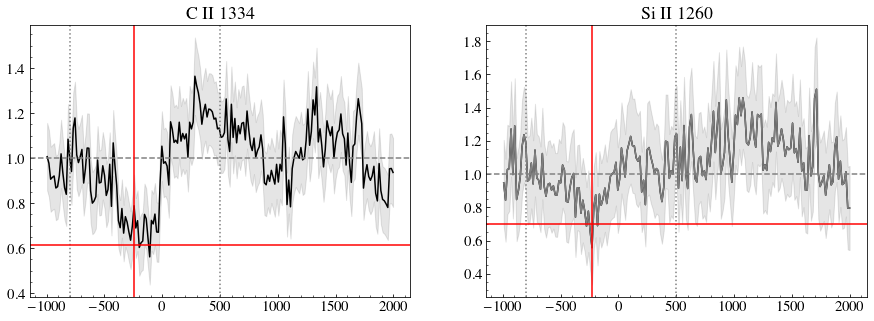

J0036_3333
-1.6383028767206071 0.03819860151043976
-114.93227814718261 5.707080698648469
-1.0596896517964696 0.029662753052427927
-201.03521533847024 8.715783554348608


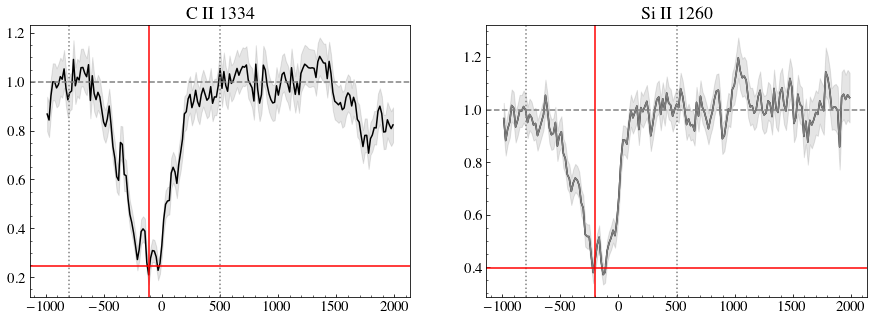

J0127_0619
-1.3738745024935795 0.08496633794421966
14.125598443073603 10.93850998604348
-1.3271807161591207 0.0673707364778627
-42.904133402952404 10.062346718093833


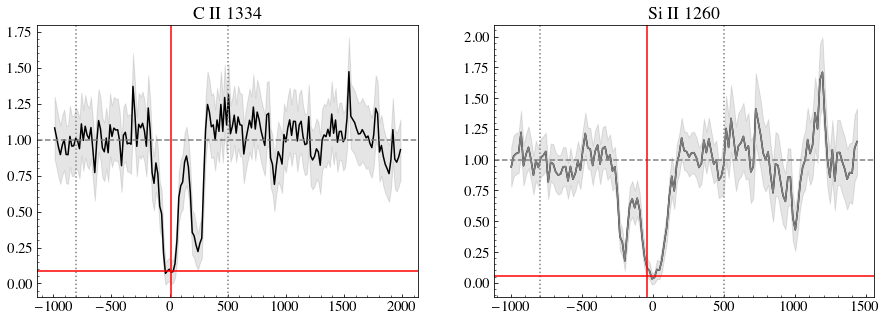

J0144_0453
-0.8539608587459957 0.0659575380086276
13.819822694827394 10.260417724984713
-0.7896487296639594 0.047409891875809296
3.20121560554123 9.21757657956314


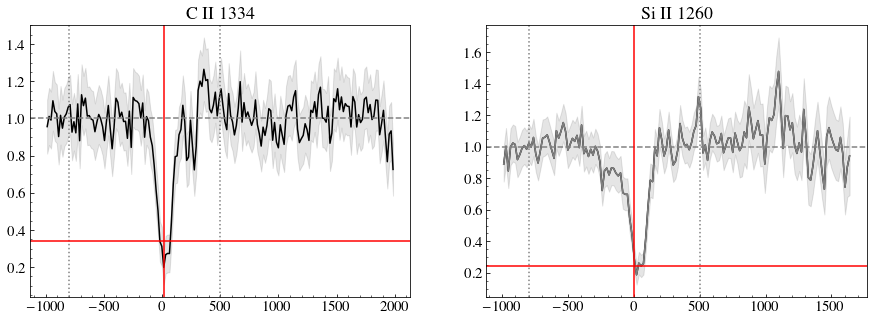

J0337_0502
-0.7795079696058282 0.03846901925853385
2.566666941022227 8.15216660441563
-0.905001668990624 0.034335943865590544
-56.32404651037276 8.029626585670167


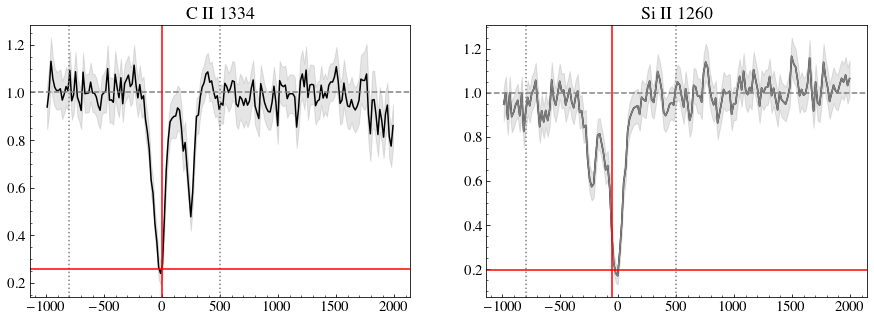

J0405_3648
-0.6498399880748074 0.06350572726835153
-18.698267776134312 20.54426086333702
-0.5649641542235435 0.0489628751783598
-38.99040880727958 14.662458553807864


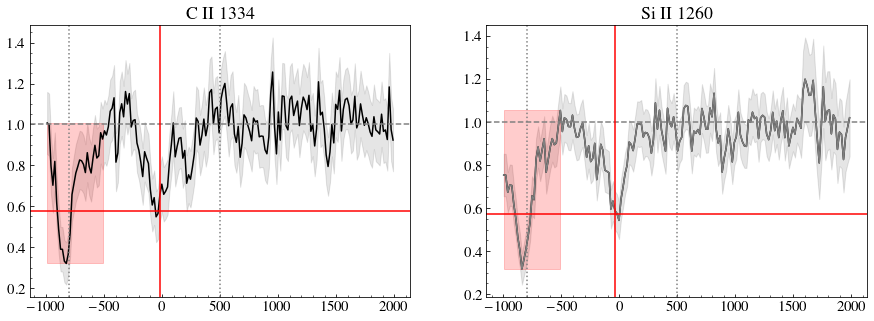

J0808_3948
-0.9358959792974251 0.048302757922670726
-544.9570780097006 22.358083193176782
-0.5709309146680768 0.053130256851376755
-553.3244408271728 20.836355758594586


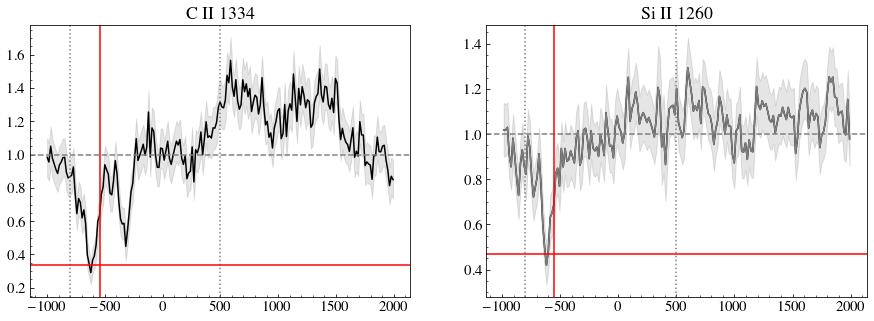

J0823_2806
-2.4564584096353173 0.058960313665655115
31.788341314068784 7.877577663004226
-2.4761707662384715 0.10391854855967823
-88.02247471149731 12.899752665148899


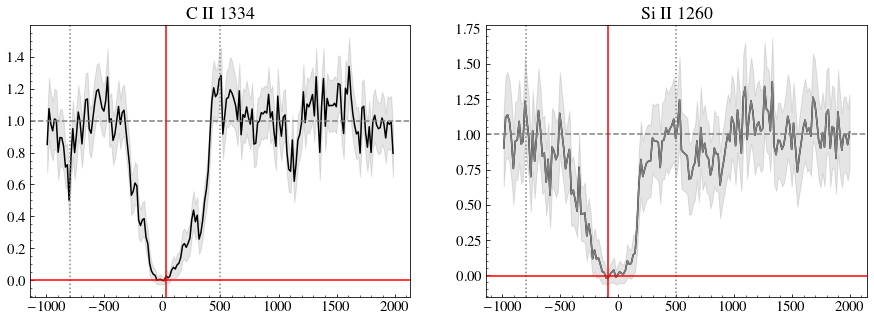

J0926_4427
-0.9033803322562013 0.09157846174014406
-268.4795742168836 26.108089766683285
-0.7645718440191298 0.06924839753935991
-339.45494981023563 19.174405140609856


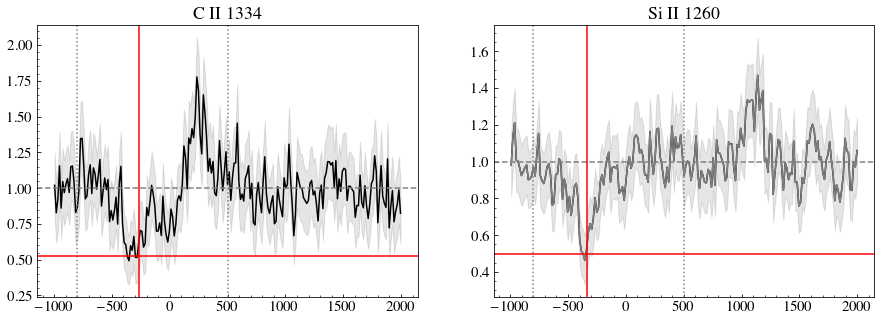

J0934_5514
-0.5821131314828343 0.02225822418907648
37.619199795625555 5.4727745430696535
-0.5015443810545199 0.015650915245701696
-6.377918578309145 2.512253630725054


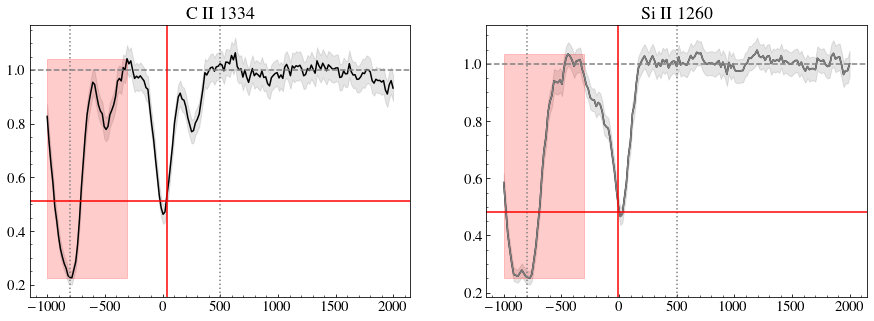

J0938_5428
-1.928414430735208 0.06277257117495307
-34.959188709787746 9.256181473470908
-2.0013371208968325 0.07890615844511198
-67.34412103281484 11.314115842536104


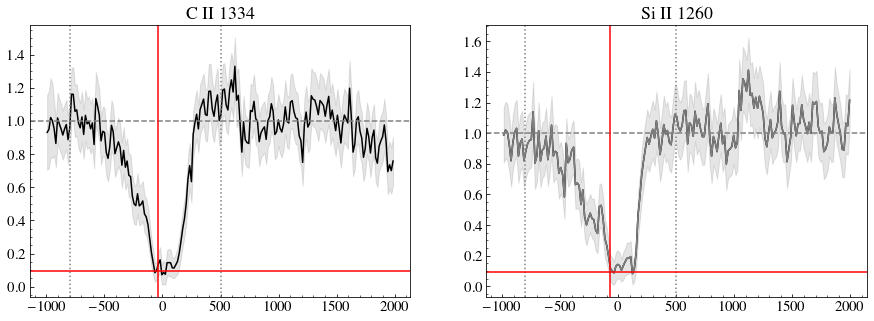

J0940_2935
-0.7475263087981661 0.06279188489829393
28.430278765563763 22.463495856377673
-0.729600254724986 0.045248729477016254
-8.553072260050453 10.378198663521095


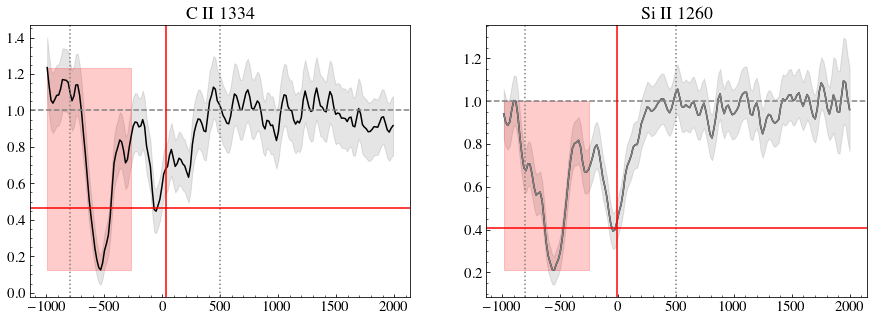

J0942_3547
-0.48724602704695735 0.026557454156428566
-41.40210125612482 8.370863973425386


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
<ipython-input-9-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-9-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


nocare


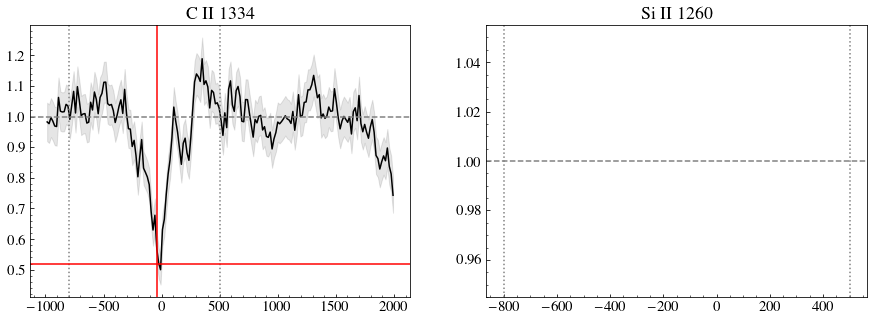

J0944_0038
-1.7334852144307806 0.1618719282551964
-18.620888334470056 21.972394473363952
-1.753637363072578 0.16286216890433886
-85.43002968854263 30.544216393575105


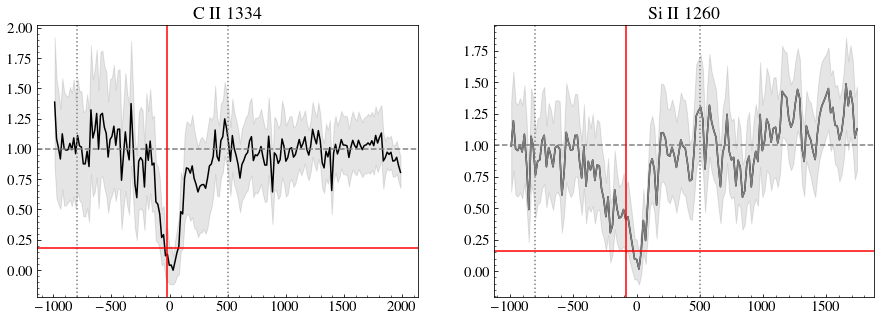

J0944_3442
-1.6471377164626453 0.18501806150755365
8.20484610442829 30.68371344188464
nocare


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-9-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-9-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


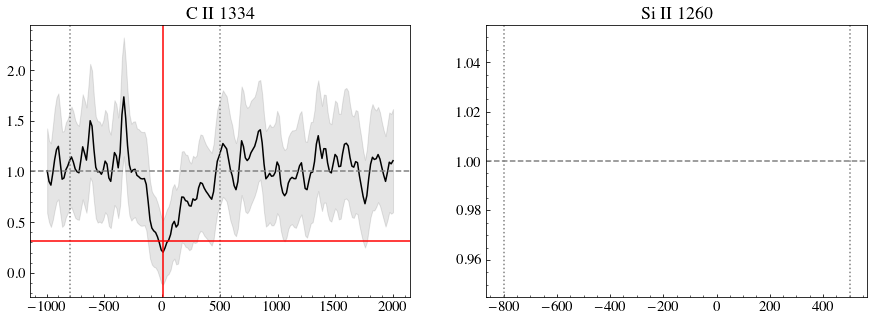

J1016_3754
-0.6078351814631474 0.07526535056468447
7.222932962444736 24.43262071426177
-0.5310817600539333 0.06305002512495064
-31.28337780678969 31.086201548400197


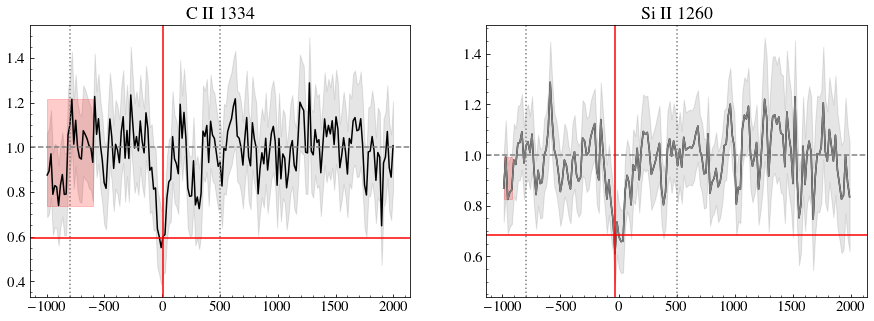

J1024_0524
nocare
-1.1665429054615355 0.04740714644258223
-81.72587004254996 9.690128735616817


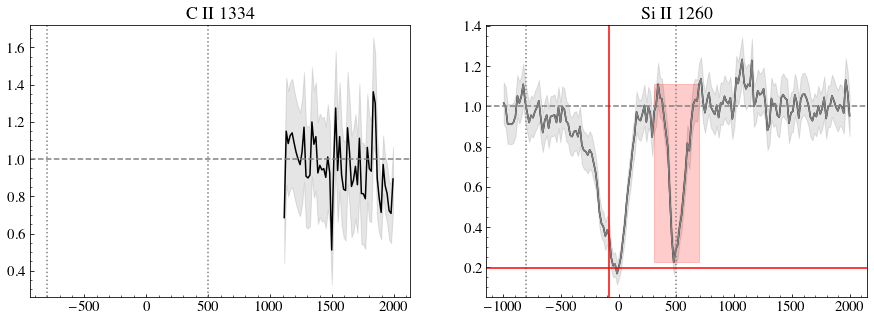

J1025_3622
-1.723053632898992 0.07229264755740956
-129.54087568312565 10.849876504511405
-1.6539762269730693 0.10800334137907716
-165.79710962613413 20.778754124435213


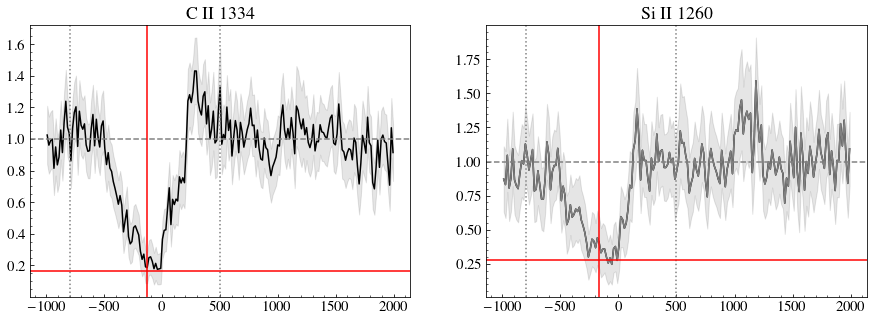

J1044_0353
-0.9788232776982286 0.0436412029561906
-69.7650918250854 8.0026683371231
nocare


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-9-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-9-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


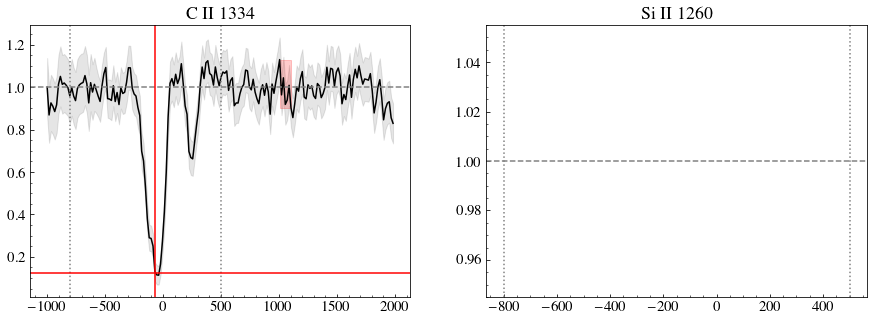

J1105_4444
nocare
-1.909878392138217 0.05582164366566513
-112.69189500631094 8.630467864617327


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-9-11fa085e0fcc>:85: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]),
<ipython-input-9-11fa085e0fcc>:86: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')


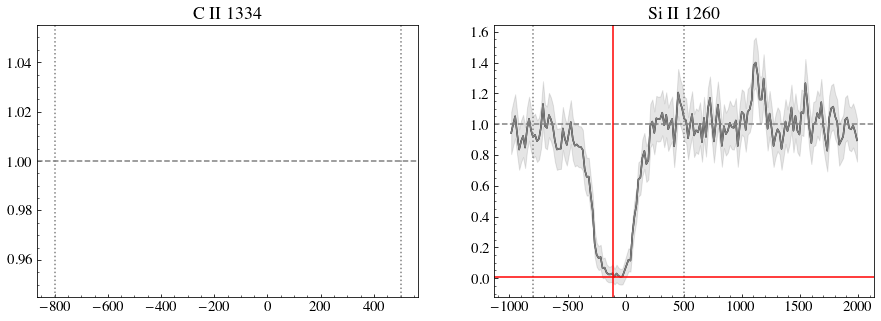

J1112_5503
-3.0133494216888357 0.06462620942186414
-329.21324963767734 10.110293086667344
-2.735495716450734 0.11161844465334902
-282.9566671171341 20.83764068152536


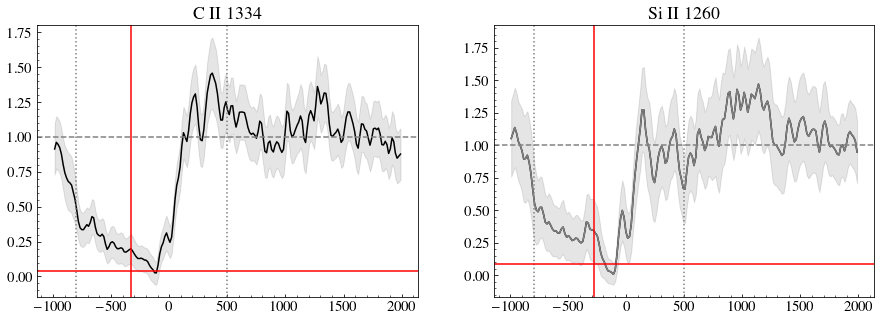

J1119_5130
-0.9973116025291459 0.060572506963811674
6.768299102853939 10.416278863440379
-0.7267332649736187 0.04041239473914808
-18.41436283479764 9.317552464896934


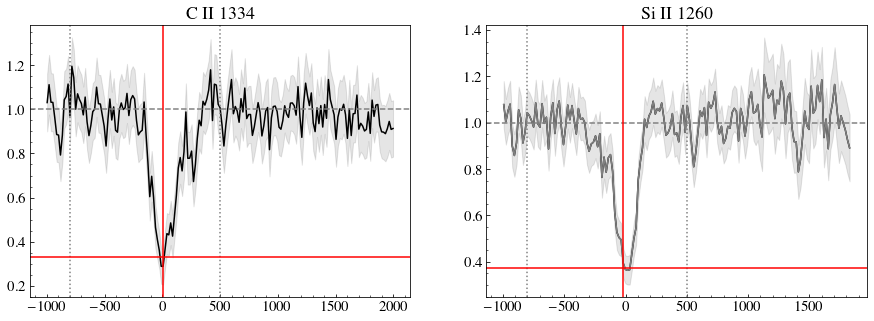

J1129_2034
-1.1759185351812396 0.05758139476661776
42.336347459709984 8.724810370724509
-1.1490820220605928 0.048066587122075996
-22.239799659419788 8.911981709918743


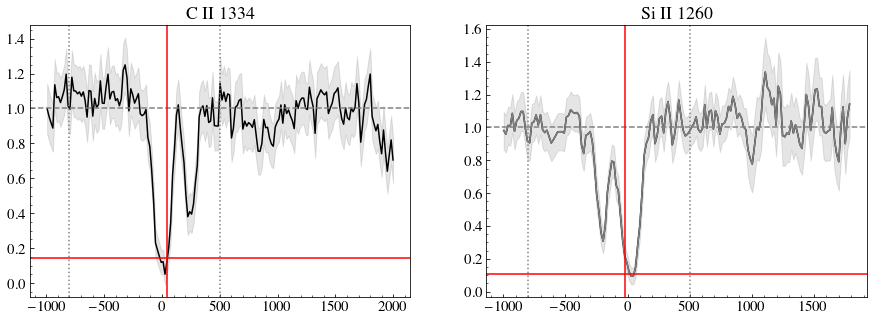

J1132_1411
-1.5866013023921857 0.06325358423185666
-23.93775327362522 8.765063650910397
nocare


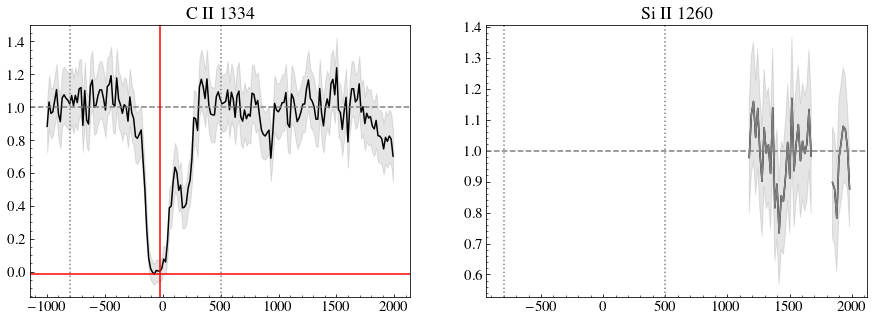

J1132_5722
-1.1117262716705034 0.12360573126130206
11.208424478709462 25.83485422001306
-0.888633374554572 0.0948077912769131
-31.86722285516426 30.235771130236106


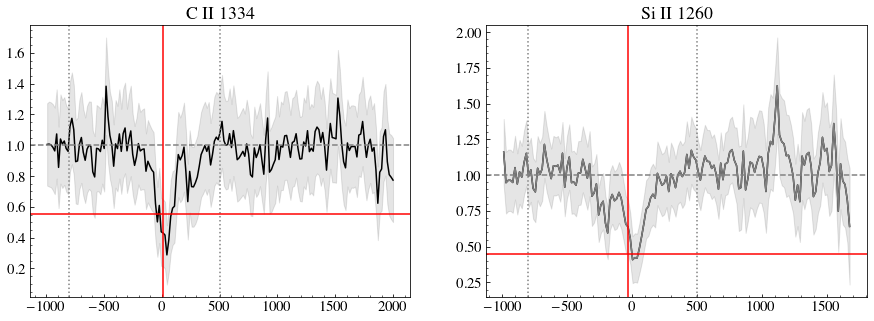

J1144_4012
-2.9052662728033907 0.09733817797642887
-145.6848627073394 12.06635868066406
-2.7553581059942296 0.12210300221862931
-193.99484357476533 17.711429694197218


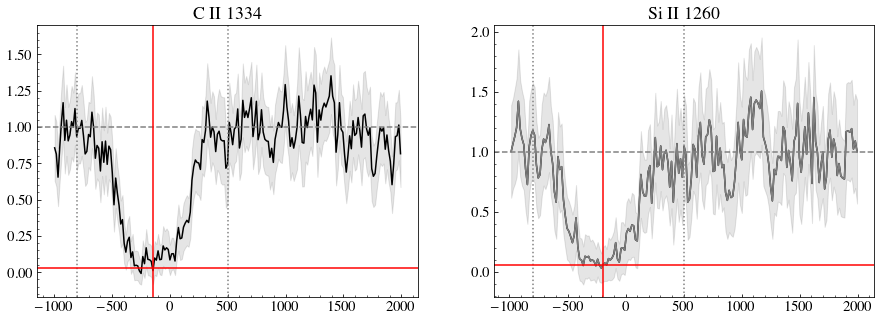

J1148_2546
nocare
-1.5444329658620797 0.07625737958916536
-116.75033304993516 10.678242685556839


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-9-11fa085e0fcc>:85: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]),
<ipython-input-9-11fa085e0fcc>:86: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')


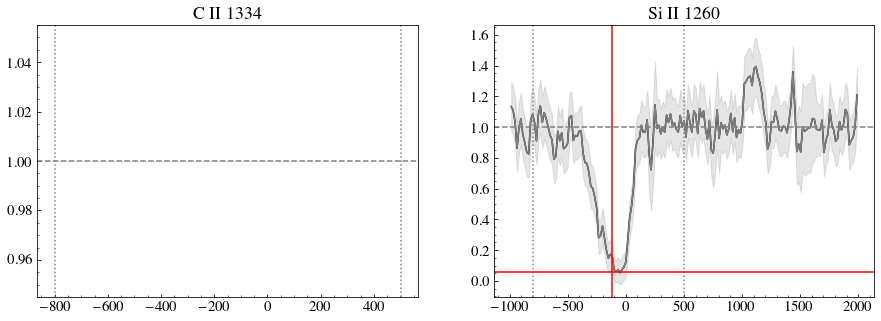

J1150_1501
-1.1832907688189251 0.04627819558206855
39.87483532835591 8.106540597130259
-1.0672005464458223 0.03237376230364038
-34.4370896702202 6.636807157748301


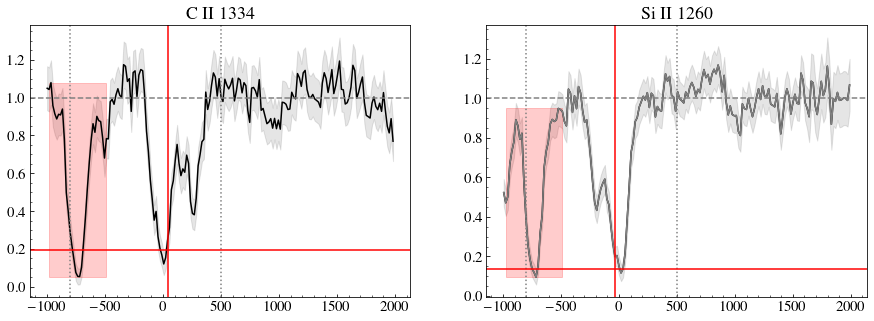

J1157_3220
-1.387366844086636 0.06323018056634487
-192.2659989635982 15.984884469045145
nocare


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-9-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-9-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


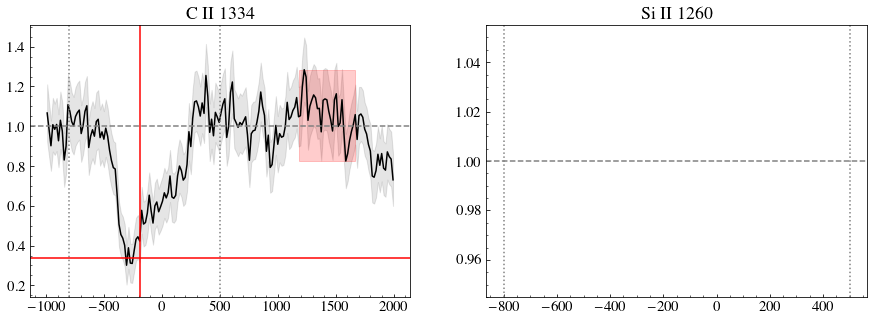

J1200_1343
nocare
-1.4404334757259933 0.07798360050737277
-136.0372538640194 11.590205935839204


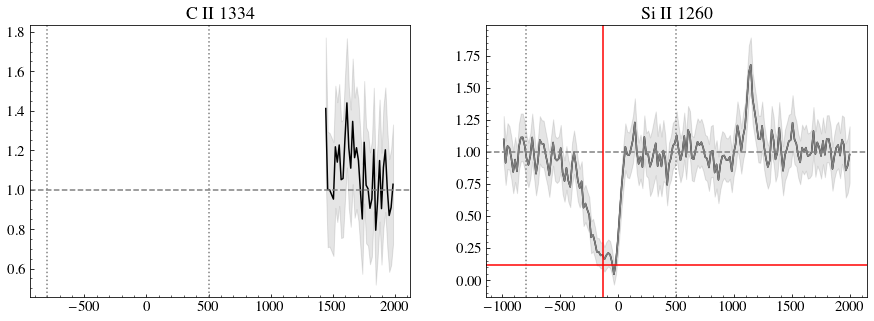

J1225_6109
-1.2817197873380186 0.05543258328822884
47.3833561957823 8.350000124377914
-1.1821862714749207 0.041860895252471414
-16.4264583152413 7.364046550326255


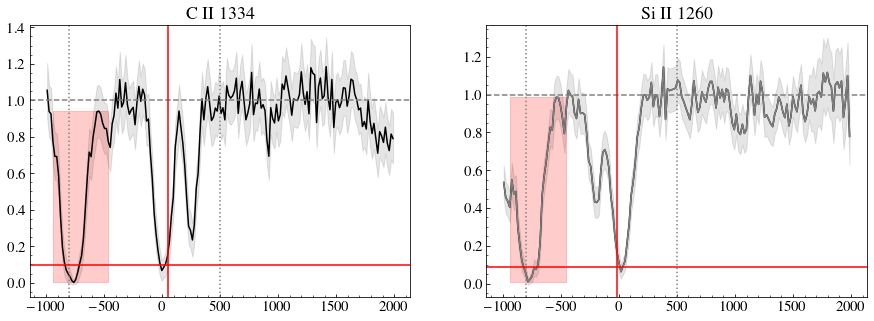

J1253_0312
-1.2994321722882691 0.048820189821642476
-51.920946844778726 8.507612112205848
nocare


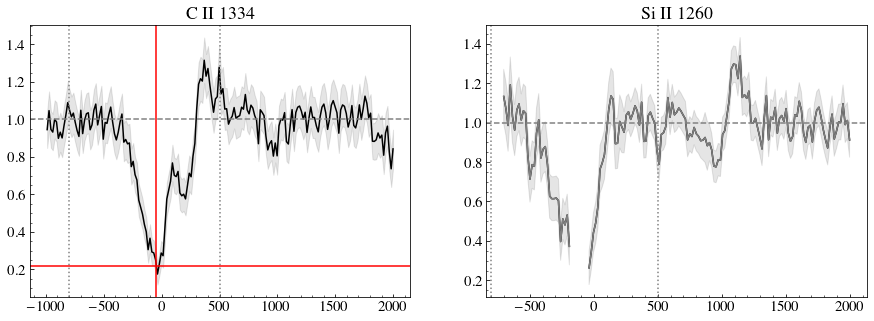

J1314_3452
-1.085509040671714 0.02465934571196958
-20.235223405204714 1.6386674181076883
-1.1249898659527942 0.023087360254707003
-75.52926352793516 5.958841935467617


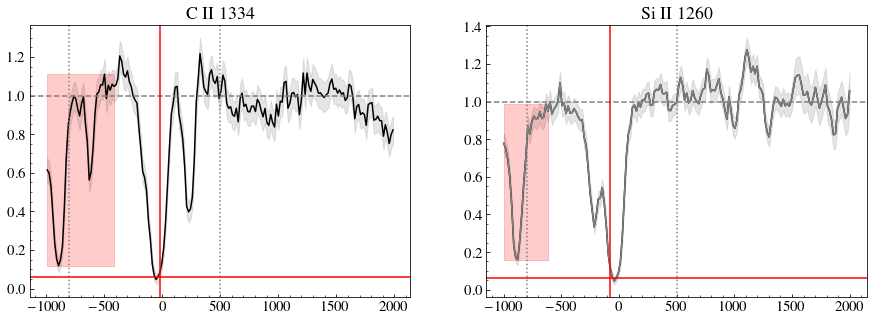

J1323_0132
-0.32346731034554094 0.0659411961452885
-290.8506492520752 82.75663706042063
nocare


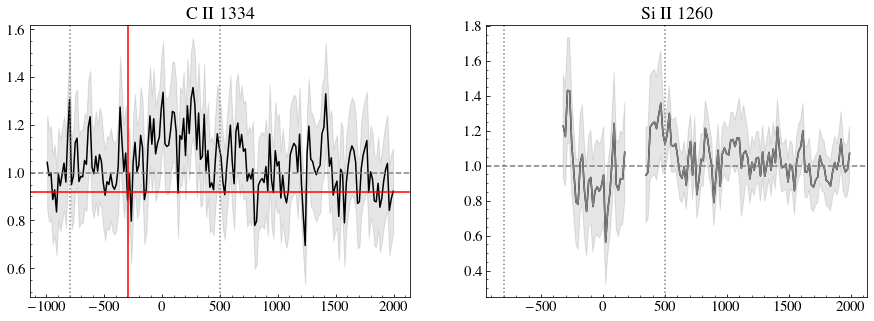

J1359_5726


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-9-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-9-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


-2.040315671501367 0.04905998171049438
-147.85787421482536 7.290779883546549
nocare


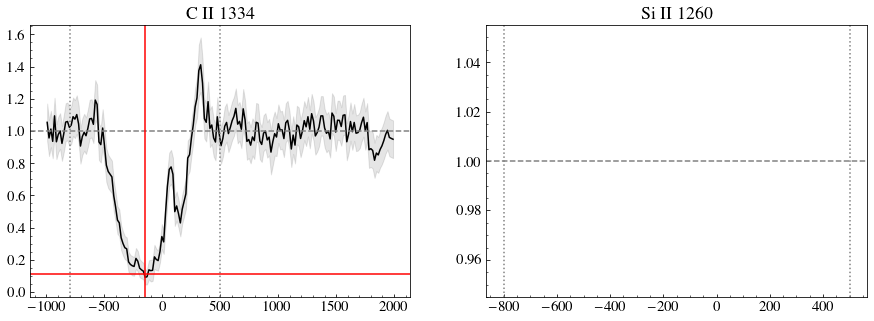

J1416_1223
-3.5101666854186684 0.06144440947827149
-103.96147954748366 8.441928942343967
-2.746672954217527 0.09453482421636296
-112.56542362652598 14.190656694673937


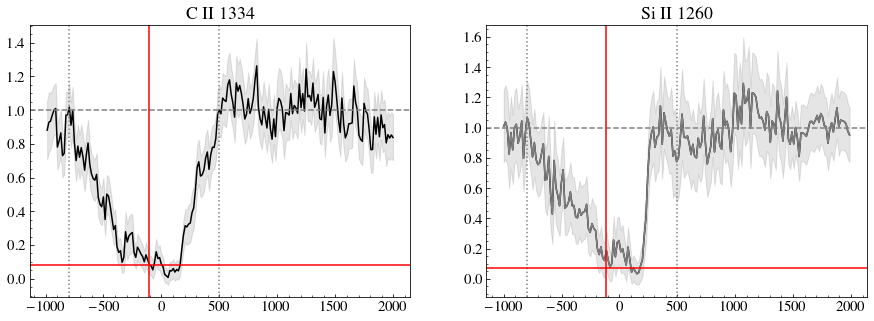

J1418_2102


<ipython-input-9-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-9-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


-0.9747549474318317 0.0768268370008102
23.385180734407488 12.556877160590954
-1.0977910326088507 0.09406364757802674
-7.071462081296075 14.485291093254622


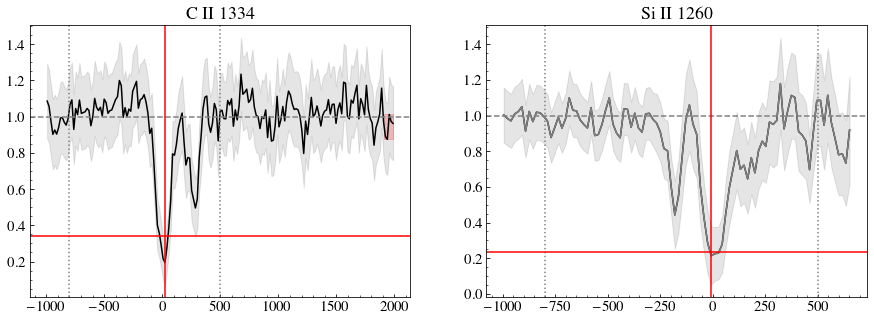

J1428_1653
-1.4779660822968985 0.11436814149300185
-141.62081695875352 17.94827187462526
-1.249350733817789 0.09269435082952819
-181.364253461435 20.686594083175592


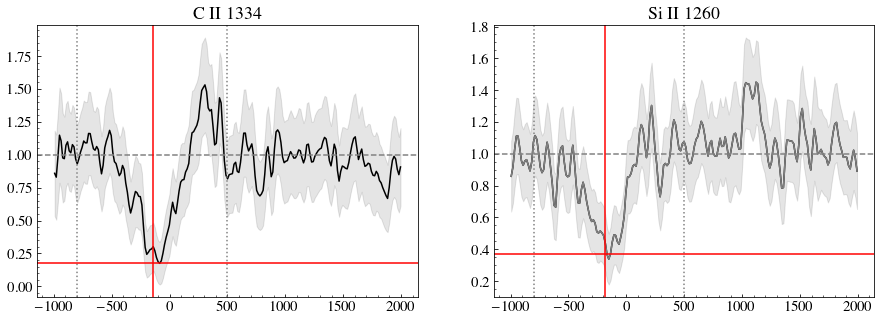

J1429_0643
-1.732236636725398 0.09313830886635692
-141.23820778424167 15.253014976450228
-1.5443860125927333 0.08731282402235868
-182.80928168510943 13.595835078173156


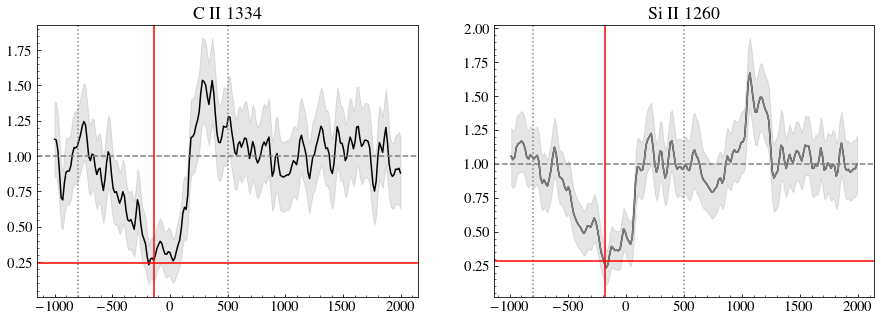

J1444_4237
-0.6748054318808829 0.0599997739654067
-41.239167116530396 10.619013541259065
-0.6942288102922668 0.04323345474813331
-65.88820198209392 8.808782018429213


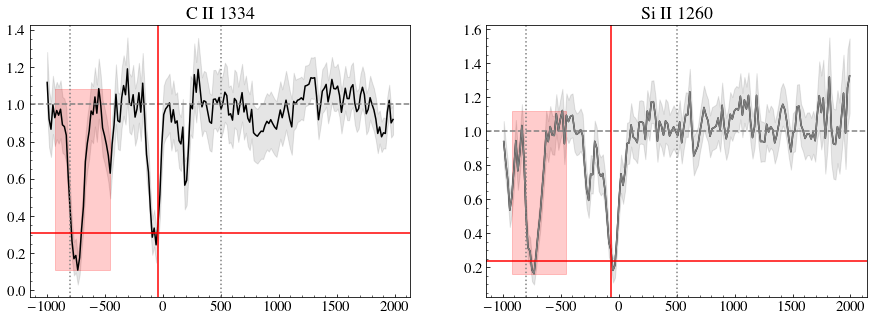

J1448_0110
nocare


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


-1.5961050214109753 0.05959963033296248
-56.27833730645339 9.296215811178106


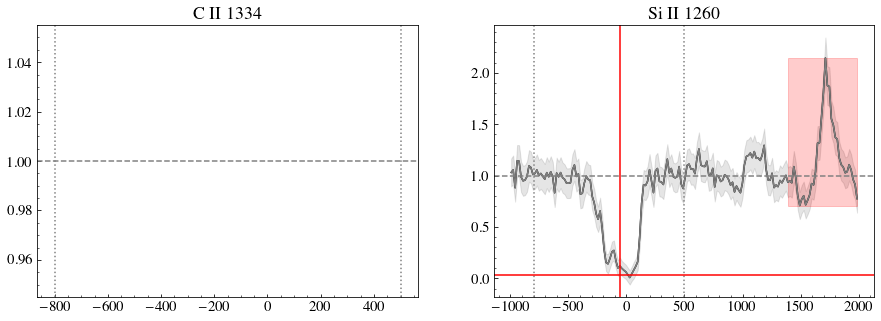

J1521_0759
-1.767570844862587 0.0554261303346077
-89.6963380843685 7.3740750832870825


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


nocare


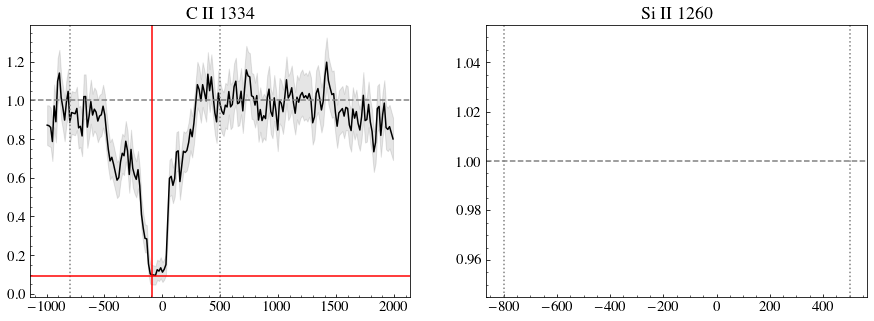

J1525_0757
-2.5537623052927265 0.07200524583940619
-327.9346039080769 10.28161657570909
-2.0319472325709755 0.12094304073040375
-346.24776414674704 25.552687396289183


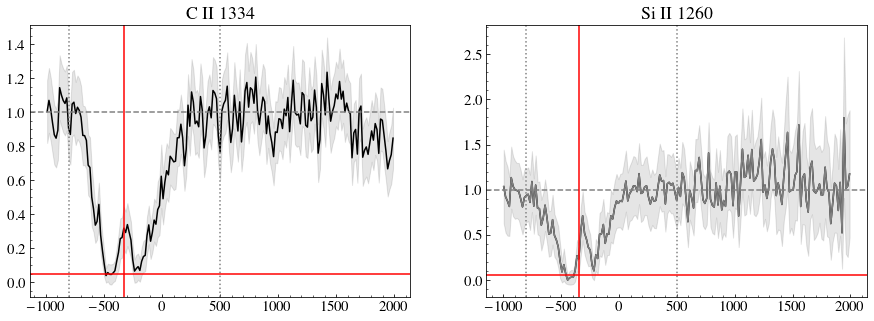

J1545_0858
nocare


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


-0.7934199269076829 0.06262860981232897
-37.3118620496284 10.474101770032455


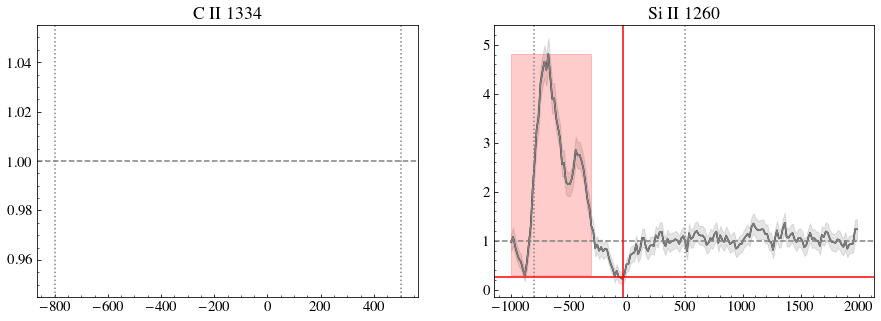

J1612_0817
-3.0187353105546544 0.0688487071540985
-366.00823269983783 8.6471072072765
-2.4288001737175717 0.06558479782490458
-368.4942439870164 10.230750752382802


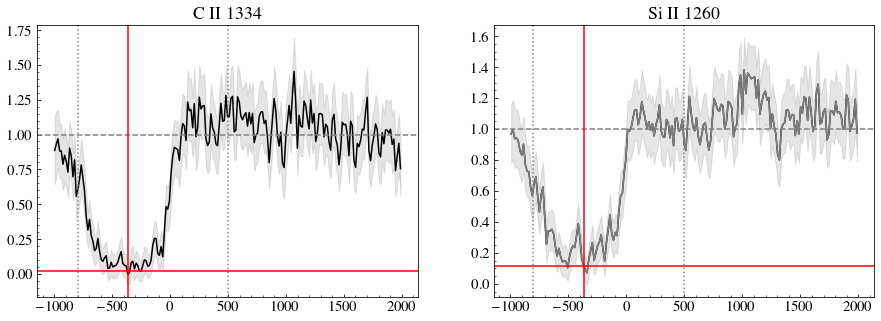

In [9]:
EWSi = np.zeros((45,2)) 
EWSi[EWSi == 0] = np.nan
EWC = np.zeros((45,2))
EWC[EWC == 0] = np.nan

FSi = np.zeros((45,2))
FSi[FSi == 0] = np.nan

FC = np.zeros((45,2))
FC[FC == 0] = np.nan

VSi = np.zeros((45,2))
VSi[VSi == 0] = np.nan

VC = np.zeros((45,2))
VC[VC == 0] = np.nan

for i in range(len(galaxy)):
   # i = 4
    spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[i].replace("_", ""), label[i])
    gal   = fits.open(spec)
#     print(galaxy[i])
#     if(galaxy[i] != 'J1323_0132'):
#         continue
    print(galaxy[i])
    HR    = gal[8].data  # Rest-frame, galactic extinction-corrected, co-added, high-resolution spectrum
    HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 

    wH, fH, eH, snrH  = HR['WAVE'],  HR['FLUX DENSITY'],  HR['ERROR'],  HR['SNR']
    wHB,fHB,eHB,snrHB = HRB['WAVE'], HRB['FLUX DENSITY'], HRB['ERROR'], HRB['SNR']

    hduin         = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    hdr           = hduin[1].header
    data          = hduin[1].data
    mask          = mask_all[i]

    wave=data['wave']
    vcIId = (data['wave']/wcII1334 -1)*c
    vsiIId =  (data['wave']/wsiII1260 -1)*c

    flux = data['flux']
    
   # fit = gaussian_filter(data['fit'], sigma = 10)
    err = data['err']
   # absflux = gaussian_filter(data['flux']/fit,sigma = 1)
   # abserr = err/fit
    
    cutCIIall = (vcIId>-1000) & (vcIId<2000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<2000)     
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-800) | ((vcII > 800) & (vcII < 1500))) & maskCII
    if(label[i] == 'j0808+3948'):
        rmedCII = ((vcII>-100) & (vcII < 100)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-800) | ((vsiII > 300) & (vsiII < 500))| ((vsiII > 1600) & (vsiII < 2000))) & maskSiII
    if(label[i] == 'j0808+3948'):
        rmedSiII = ((vsiII>-200) & (vsiII < 100)) & maskSiII
#     if(label[i] == 'j1323-1032'):
#         rmedSiII = ((vsiII>1000) & (vsiII < 1600)) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    
    
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    axs[0].plot(vcII, fcII,  c='k', label = 'Observed')
    axs[0].fill_between(vcII,fcII-ecII/fmedCII, fcII+ecII/fmedCII,  color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
    axs[0].axhline(1, linestyle = '--', c = 'gray')
    axs[0].axvline(-800, linestyle = ':', c = 'gray')
    axs[0].axvline(500, linestyle = ':', c = 'gray')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), 
                        np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')  
    

        
    axs[1].plot(vsiII, fsiII,   c = 'k' )
    axs[1].plot(vsiII, fsiII,   c = 'gray' )
    axs[1].fill_between(vsiII,fsiII-esiII/fmedSiII, fsiII+esiII/fmedSiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')
    axs[1].axhline(1, linestyle = '--', c = 'gray')
    axs[1].axvline(-800, linestyle = ':', c = 'gray')
    axs[1].axvline(500, linestyle = ':', c = 'gray')
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
    
#     if(~np.isnan(np.sum(absflux[cutCIIall]/medc))):
    try:
        EWC[i][0], EWC[i][1] = measureEWabs(wave[cutCIIall][maskCII], vcII[maskCII], fcII.copy()[maskCII],
                                            (ecII.copy()/fmedCII)[maskCII],
                                 -800, 500)

        #if(label[i] == 'J1525+0757'):
        VC[i][0], VC[i][1], FC[i][0] ,FC[i][1] = measureMinVel(vcII[maskCII], fcII.copy()[maskCII], 
                                                               (ecII.copy()/fmedCII)[maskCII], -800, 00)

        VC[i][0], VC[i][1]  = measureCenV(vcII[maskCII], fcII.copy()[maskCII],  (ecII.copy()/fmedCII)[maskCII], -800, 500)
        if(label[i] == 'j1525+0757'):
            VC[i][0], VC[i][1]  =measureCenV(vcII[maskCII], fcII.copy()[maskCII],  (ecII.copy()/fmedCII)[maskCII], -800, 00)
#             print()
        axs[0].axvline(VC[i][0], c= 'r')
        axs[0].axhline(FC[i][0], c= 'r')
        print(EWC[i][0],EWC[i][1])

        print(VC[i][0],VC[i][1])
#         print(FC[i][0],FC[i][1])
#     limup = 1400
#     if i == 2:
#         limup =1250
    except:
        print('nocare')
    try:
        EWSi[i][0], EWSi[i][1] = measureEWabs(wave[cutSiIIall][maskSiII], vsiII[maskSiII], fsiII.copy()[maskSiII],
                                              (esiII.copy()/fmedSiII)[maskSiII],    -800, 500)
        VSi[i][0], VSi[i][1], FSi[i][0],FSi[i][1] = measureMinVel(vsiII[maskSiII], fsiII.copy()[maskSiII],
                                                                  (esiII.copy()/fmedSiII)[maskSiII], -800, 500)

        VSi[i][0], VSi[i][1]  = measureCenV(vsiII[maskSiII], fsiII.copy()[maskSiII], (esiII.copy()/fmedSiII)[maskSiII], -800, 500)

        axs[1].axvline(VSi[i][0], c= 'r')
        axs[1].axhline(FSi[i][0], c= 'r')
        print(EWSi[i][0],EWSi[i][1])

        print(VSi[i][0],VSi[i][1])
#         print(FSi[i][0],FSi[i][1])
    except:
        print('nocare')
    plt.show()


#### Save Abs properties

In [ ]:
df = pd.DataFrame(np.vstack((galaxy,EWC[:,0],EWC[:,1], EWSi[:,0],EWSi[:,1], 
                   VC[:,0],VC[:,1], VSi[:,0],VSi[:,1],  
                   FC[:,0], FC[:,1],FSi[:,0],FSi[:,1])).T) # A is a numpy 2d array
C=['Galaxy','EWCII','ErrEWCII', 'EWSiII', 'ErrEWSiII', 'VcenCII', 'ErrVcenCII',
                   'VcenSiII', 'ErrVcenSiII', 'RCII', 'ErrRCII', 'RSiII', 'ErrRSiII']
df.to_csv("csv/Classy_Abs.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

### Emission properties

J0021_0052 0.6272
0.39231535722682526 0.06301551799423653
0.566589855911988 0.09998273159330918


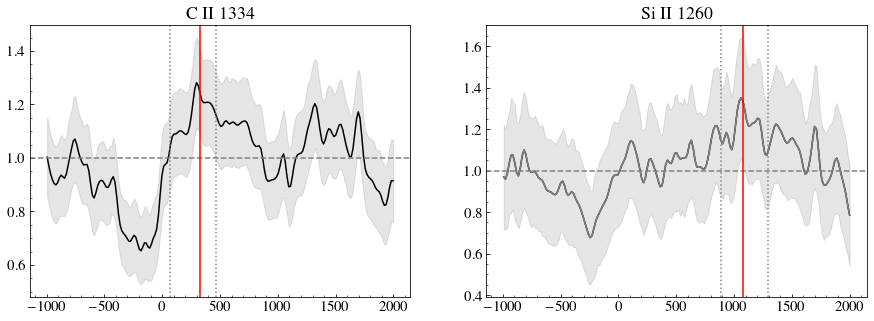

J0036_3333 2.2768
-0.002093527545604671 0.017752223545345985
0.129239452210695 0.02783808111289196


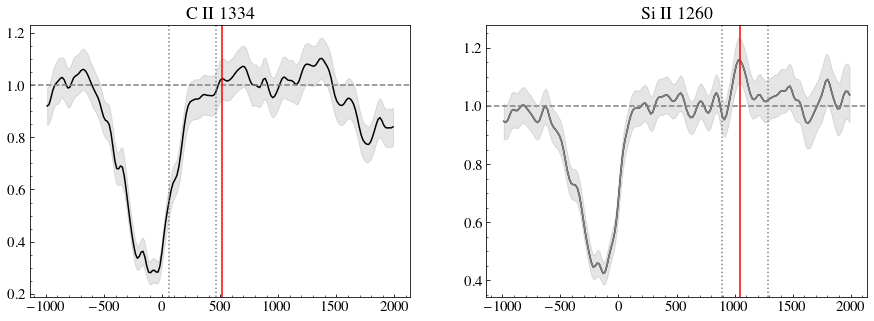

J0127_0619 1.8992
j0127-0619
0.1505719666047906 0.05728360404263336
no puedo


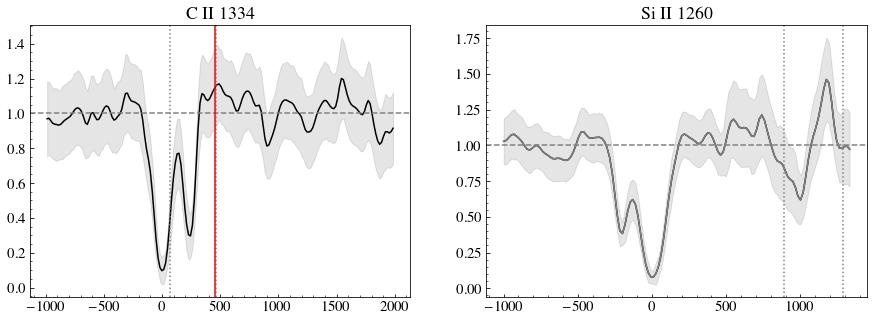

J0144_0453 2.2808
0.11127931560876077 0.04547221652968814
0.23411123589301974 0.0636060534497766


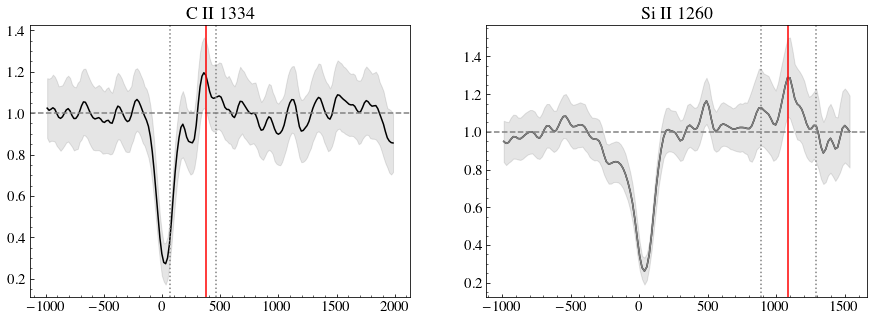

J0337_0502 1.1464
0.02591278602772074 0.020503353270053003
0.029550374720497666 0.027058885135752796


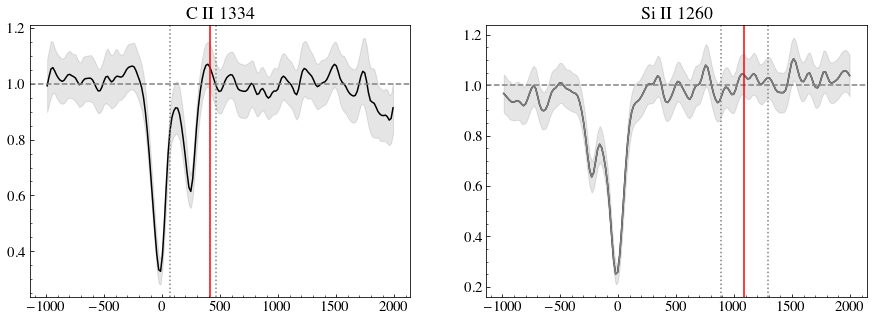

J0405_3648 2.8456
0.05113262203242107 0.03804744503945519
-0.002956775513334931 0.029923651105959514


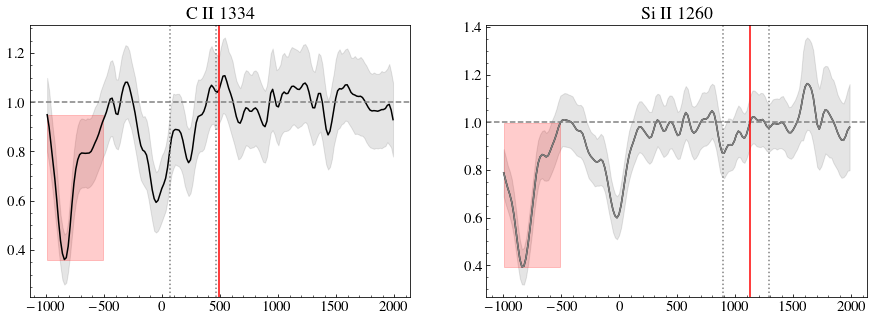

J0808_3948 0.8912
0.385574534653888 0.04605919482616882
0.21577824888495556 0.043612125452237735


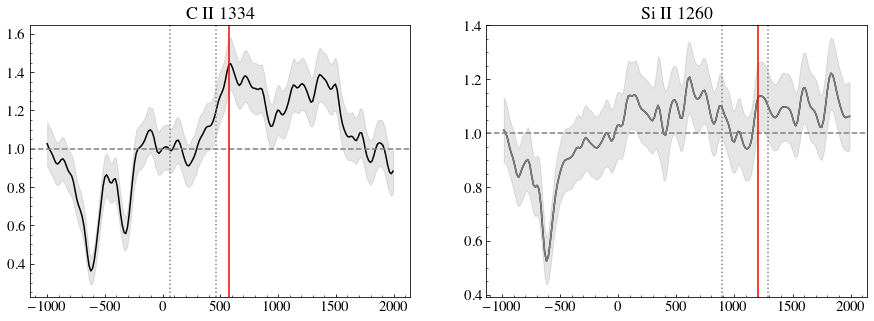

J0823_2806 1.7072
0.15537154898387437 0.04368170520422638
0.18127019146829665 0.08651636058878615


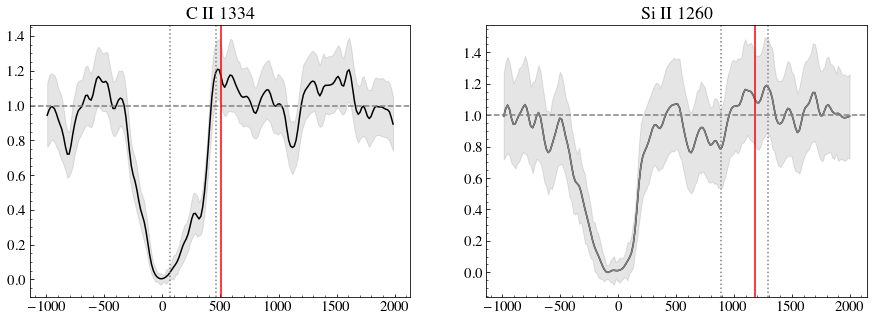

J0926_4427 0.712
0.5736683354177439 0.08821541006468538
0.32044490643498147 0.06382716171401216


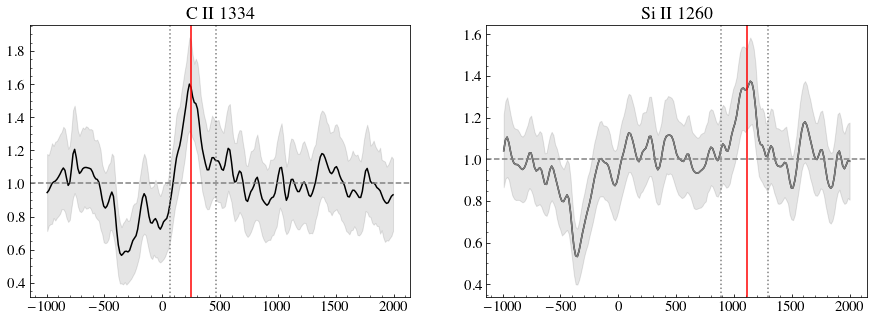

J0934_5514 2.0848
0.036668395269225336 0.014998374245688853
0.013992330402571888 0.016232780645564278


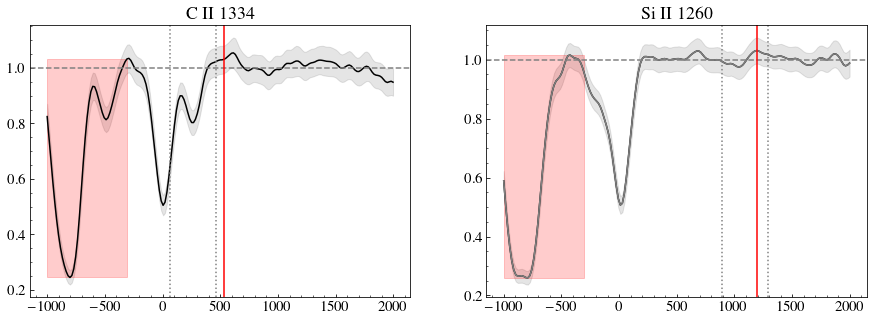

J0938_5428 0.876
0.22102336366530595 0.047371199216908924
0.2643845266358367 0.06844596222437788


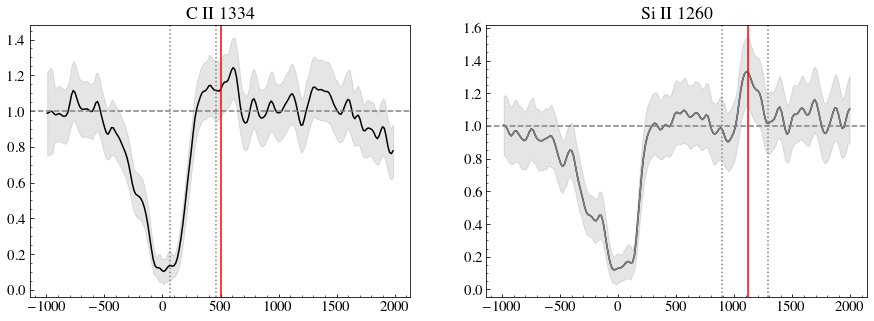

J0940_2935 4.1208
0.05469812103524907 0.040488895714734345
-0.03219066182927623 0.030233764518323884


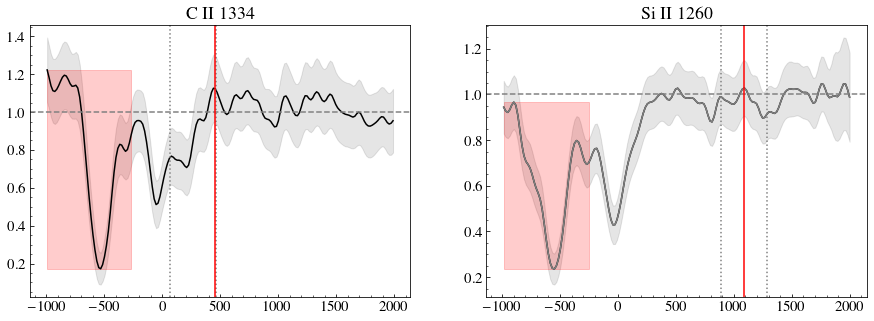

J0942_3547 1.0768
0.10465276749874018 0.021871807418860887


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/tmp/ipykernel_2123474/2311608274.py:102: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2123474/2311608274.py:103: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


no puedo


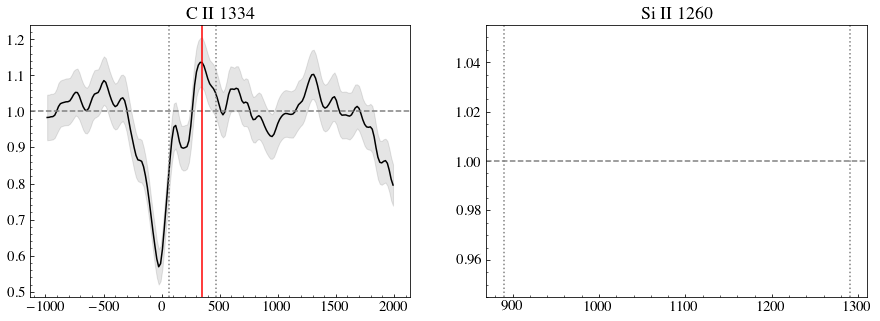

J0944_0038 0.7872
0.024185677357220412 0.06790640590260634
0.4582228227865649 0.11827753105991927


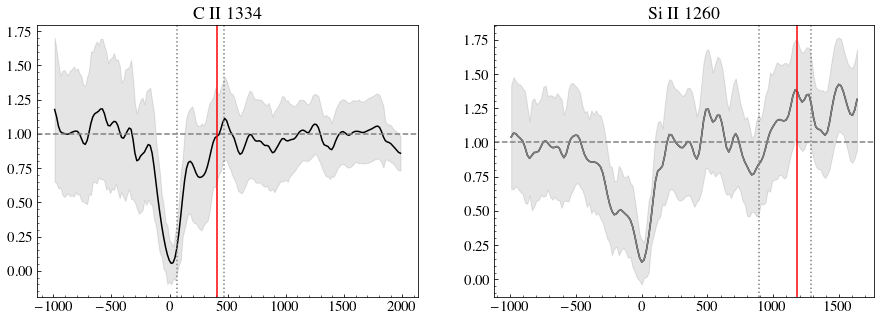

J0944_3442 1.9664
0.04376245151223693 0.09185779785315917
no puedo


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/tmp/ipykernel_2123474/2311608274.py:102: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2123474/2311608274.py:103: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


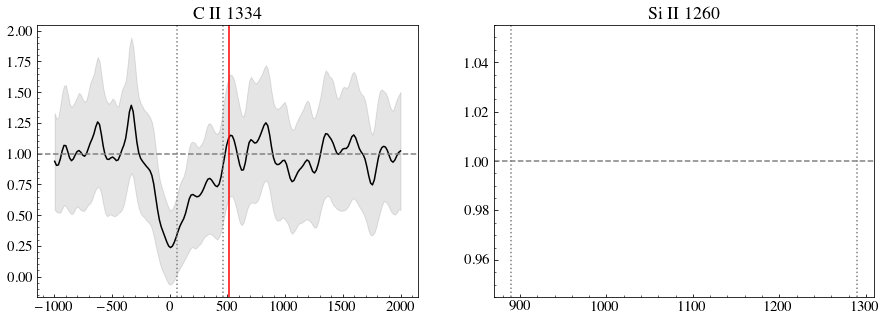

J1016_3754 1.468
0.056211565880205226 0.050780875444952495
0.1776378678556759 0.06261344651630475


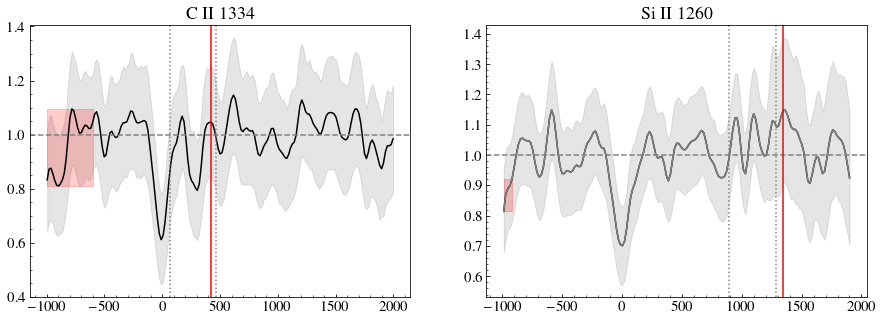

J1024_0524 1.06
no puedo
0.142344728703192 0.03619964273909458


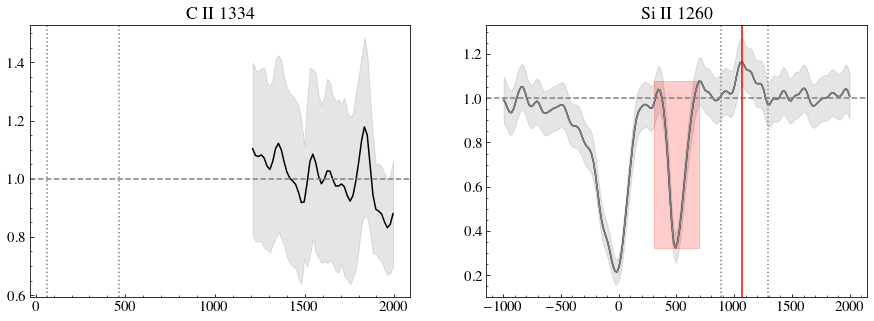

J1025_3622 0.6744
0.2594767318369833 0.06446534089974582
0.25768339563353454 0.09560346550500262


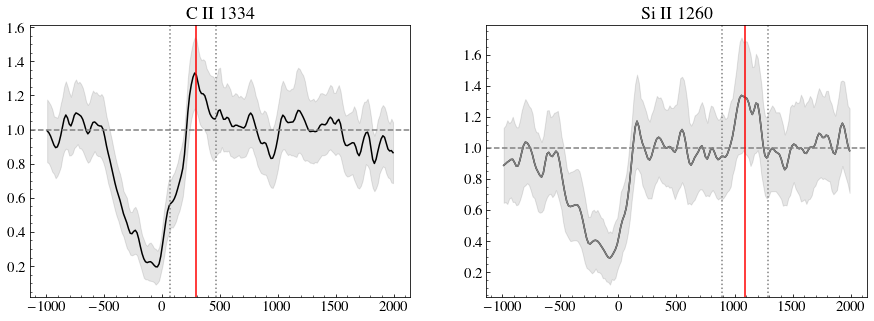

J1044_0353 0.9632
0.08194931987662236 0.029946023660641034
no puedo


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/tmp/ipykernel_2123474/2311608274.py:102: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2123474/2311608274.py:103: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


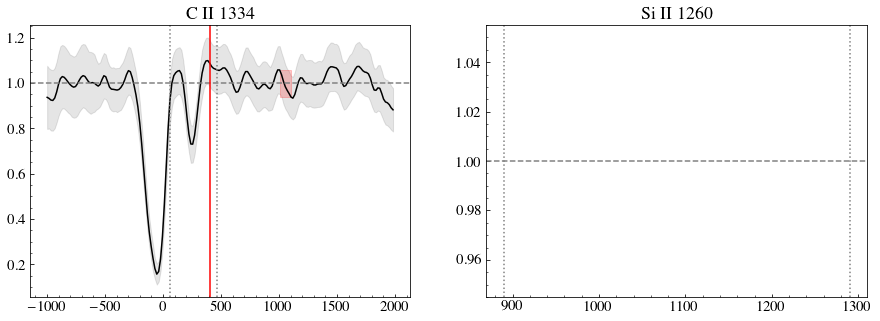

J1105_4444 2.1168
no puedo
0.1745294092686849 0.05255831975973808


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/tmp/ipykernel_2123474/2311608274.py:89: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]),
/tmp/ipykernel_2123474/2311608274.py:90: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')


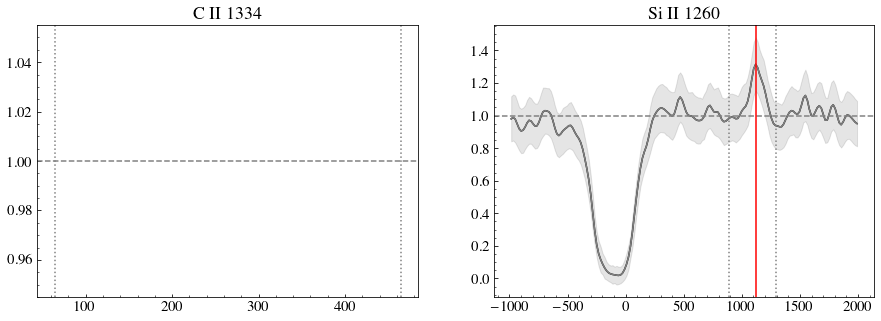

J1112_5503 0.736
0.4537861316825079 0.07315366729986643
0.4853365456734097 0.11148281409520215


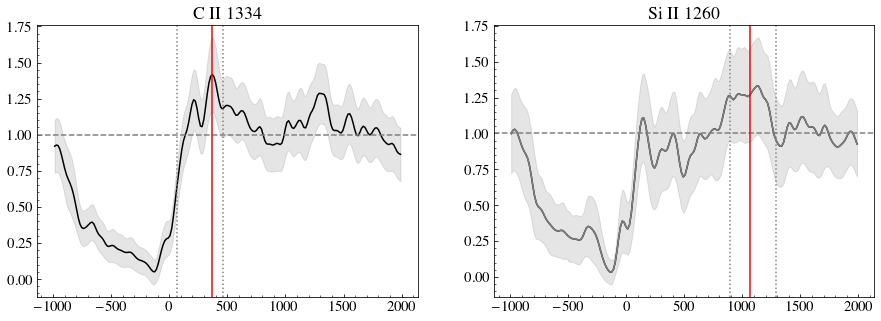

J1119_5130 1.496
0.06330673323984205 0.03205690324889076
0.1012132243350732 0.040577764461557315


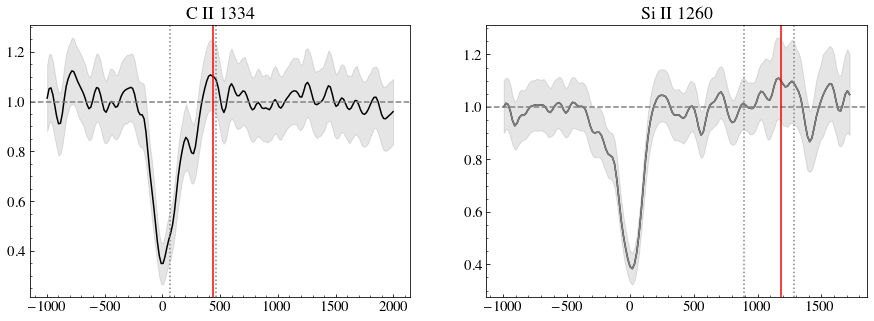

J1129_2034 2.4784
-0.006177366578176607 0.02777985238143497
0.1698242319160814 0.05379142958554915


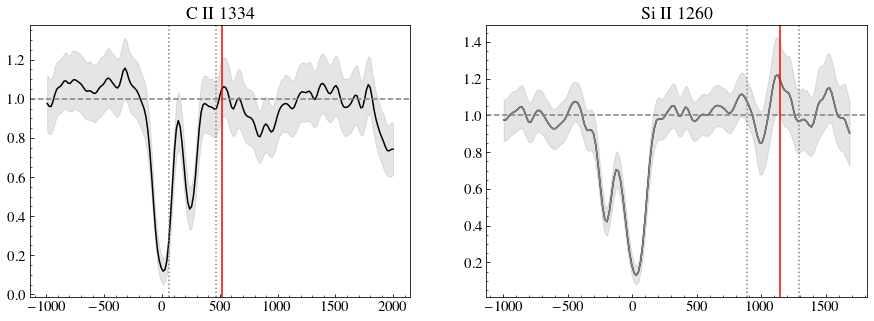

J1132_1411 1.7992
0.06681506934788875 0.041632149094419556
no puedo


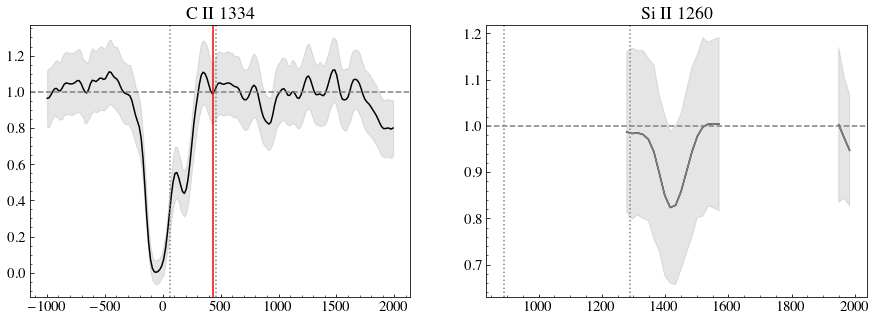

J1132_5722 3.024
j1132+5722
0.03343598807499201 0.06670518760569423
0.18267478539128354 0.08843259199061744


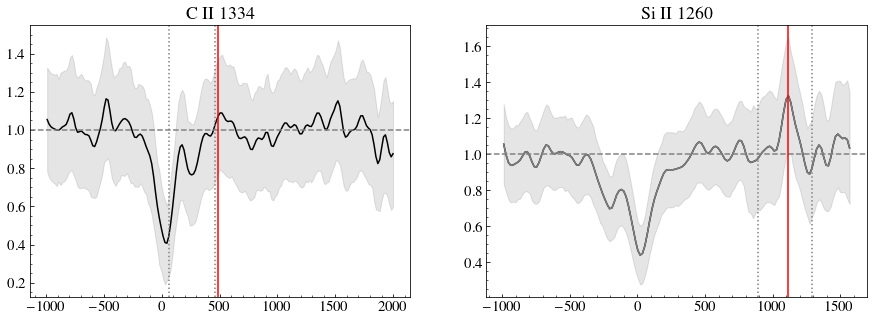

J1144_4012 0.9264
0.01983326185477577 0.05262331746509002
0.30710862935481714 0.1214417000816856


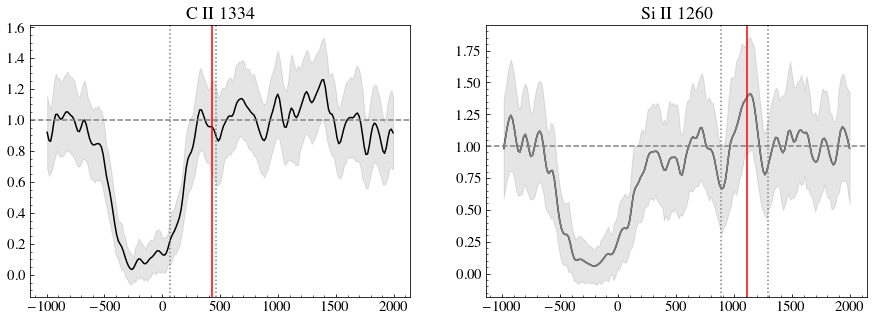

J1148_2546 0.6776
no puedo
0.2463382491549682 0.05942805243449058


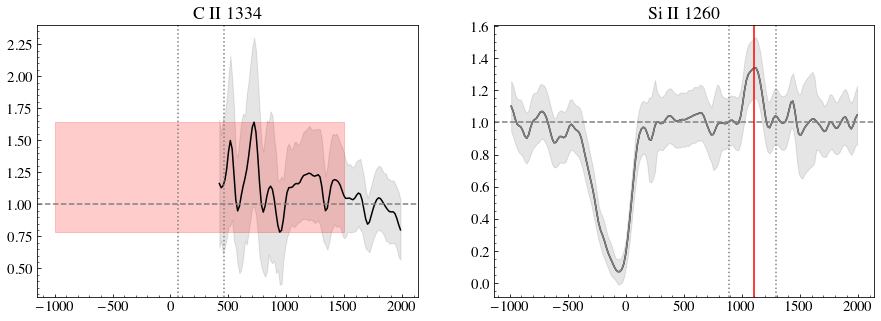

J1150_1501 1.408
0.051708966250438713 0.025119010948541166
0.06684961430860314 0.028290664235932086


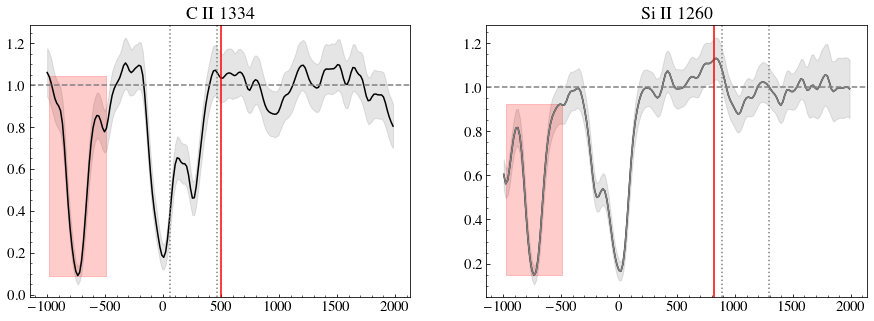

J1157_3220 2.3152
0.16242262214152725 0.04729595211240792
no puedo


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/tmp/ipykernel_2123474/2311608274.py:102: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2123474/2311608274.py:103: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


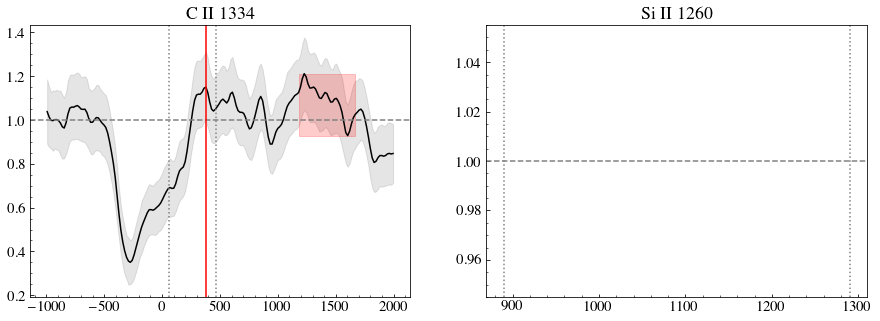

J1200_1343 0.7264
no puedo
0.2663488840056893 0.06446104722274598


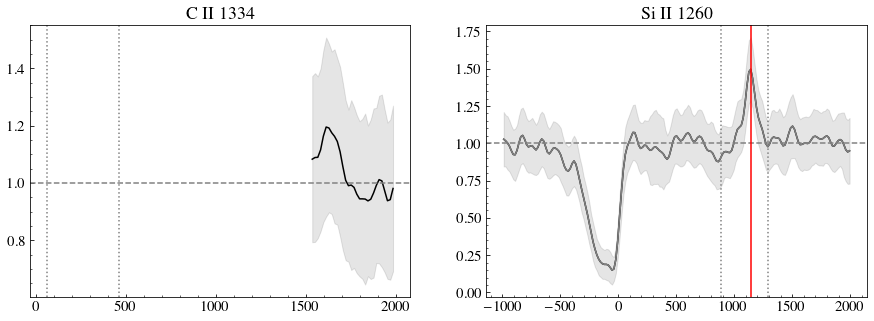

J1225_6109 2.0768
-0.003061647939517541 0.02822850878534877
0.005655159520183651 0.028282418018091324


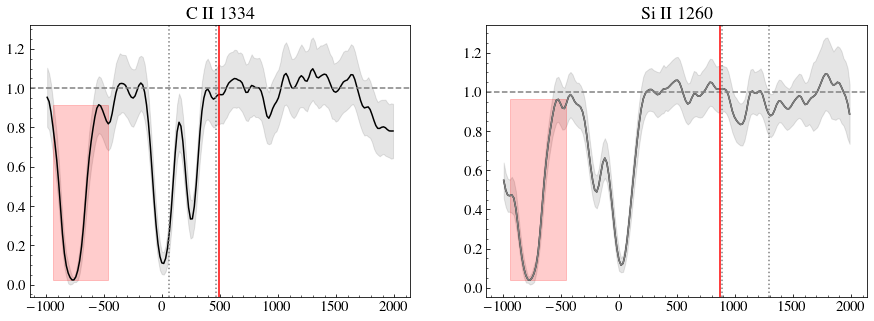

J1253_0312 0.8632
0.19375112299530622 0.03384074590741844
0.14208231019573853 0.03125907251568321


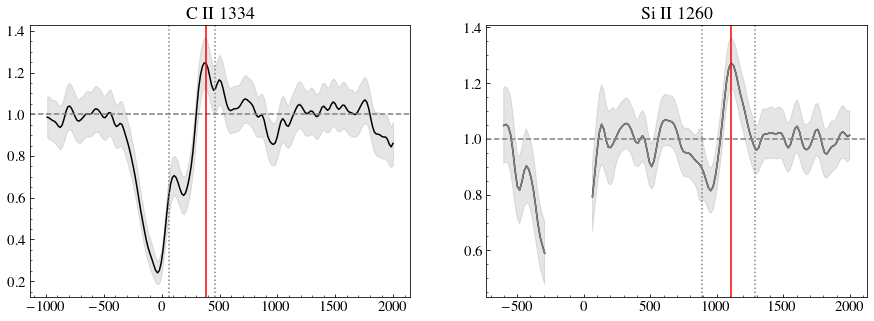

J1314_3452 1.412
0.10922705455457307 0.025810178388686954
0.13027009102749737 0.022273095140349468


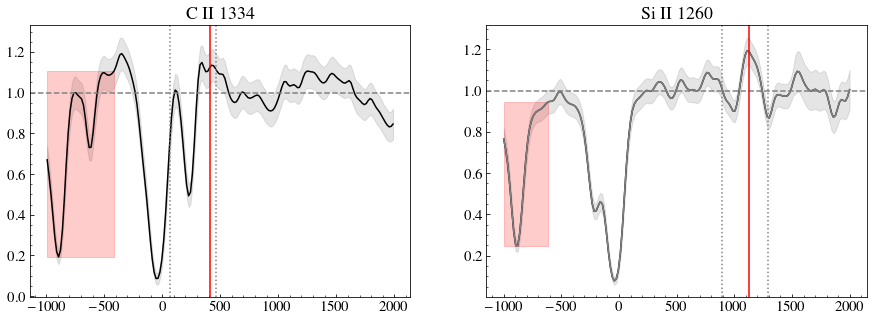

J1323_0132 0.5584
0.40355385329187493 0.0804106074464869
0.10320746712551661 0.049039342153930326


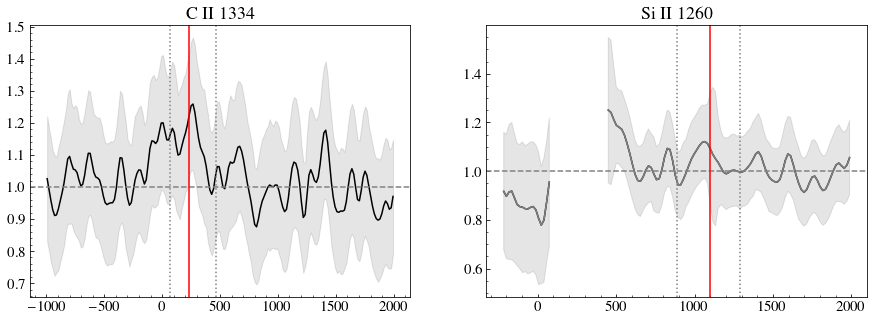

J1359_5726 1.116
0.12916177991703617 0.03365757844311117
no puedo


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/tmp/ipykernel_2123474/2311608274.py:102: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2123474/2311608274.py:103: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


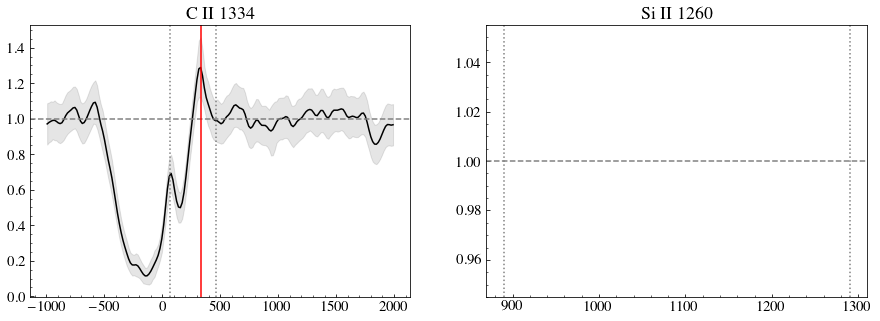

J1416_1223 0.788
0.09647526339789256 0.03304972119483296
0.2649589841968474 0.0878739929728702


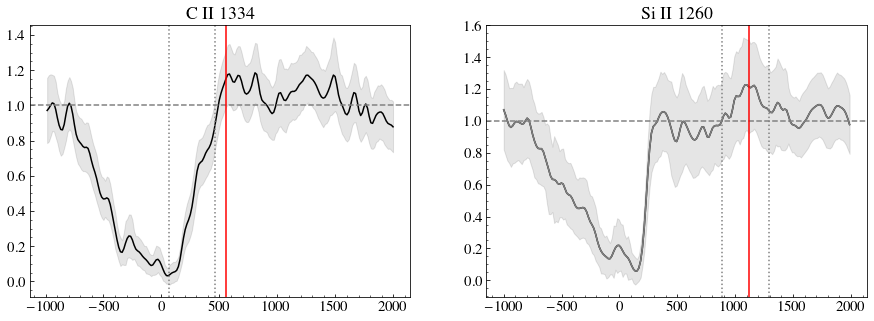

J1418_2102 0.904
-0.014836890291594549 0.04157378569384919


/tmp/ipykernel_2123474/2311608274.py:102: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2123474/2311608274.py:103: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


no puedo


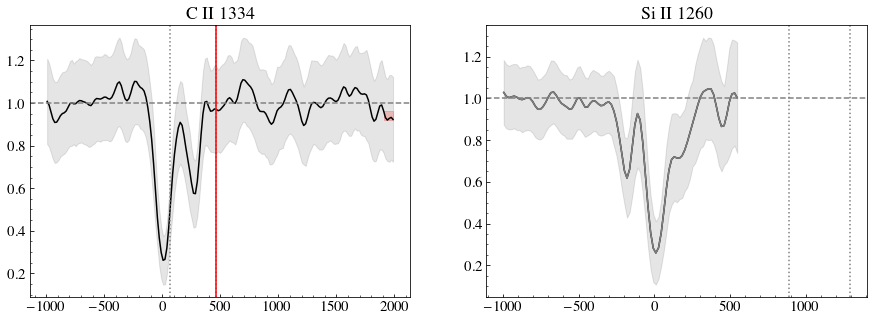

J1428_1653 0.7464
0.39101341289398295 0.09602153044408913
0.3693256042901913 0.08187635173746277


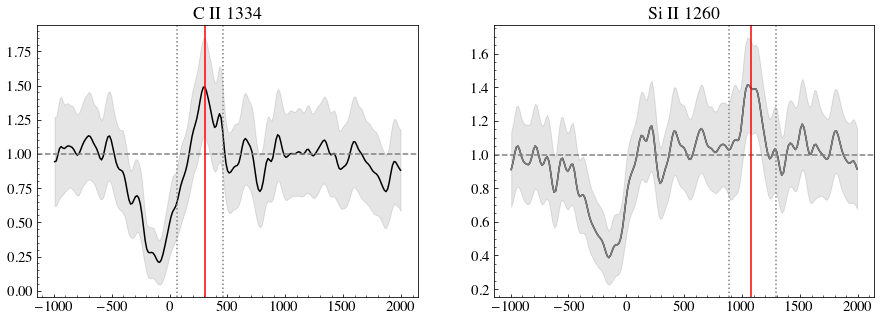

J1429_0643 0.6872
0.4841743727295768 0.08513749986225812
0.4373905402645163 0.07305609777835942


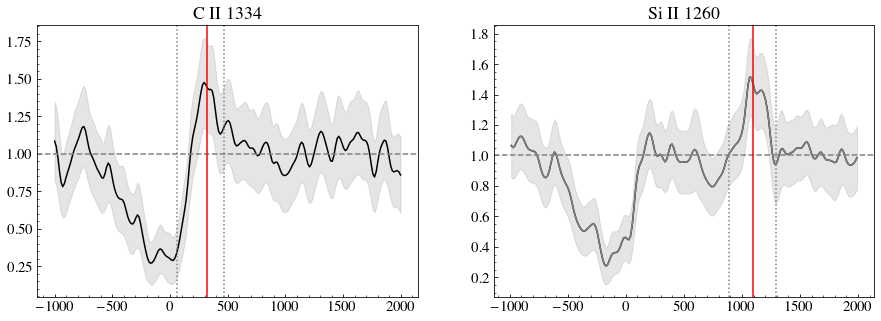

J1444_4237 2.208
0.01919305202705785 0.0389410163818116
0.09419599646530218 0.040471612971255636


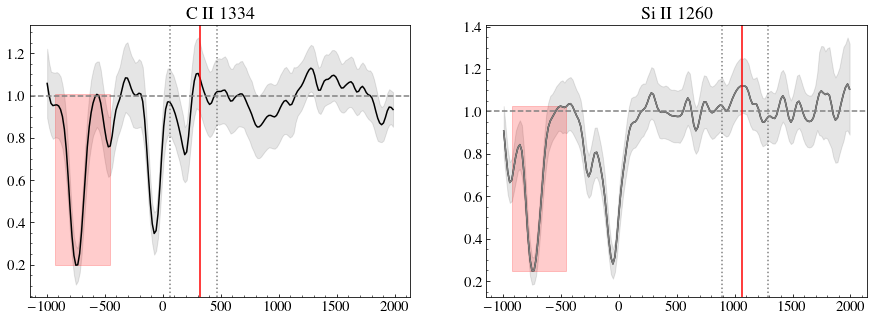

J1448_0110 0.856
no puedo


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


0.11180528948152495 0.045261135375718124


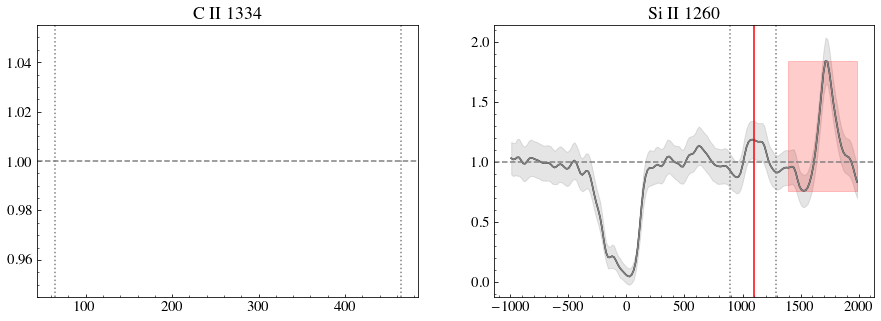

J1521_0759 0.7864
0.11494937723511135 0.03349013856697844


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


no puedo


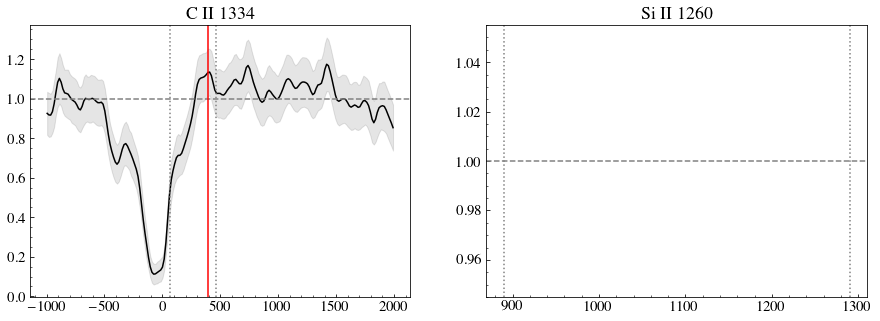

J1525_0757 1.0552
0.014894893253984525 0.04418857429403329
0.37793360068442367 0.1321971799639912


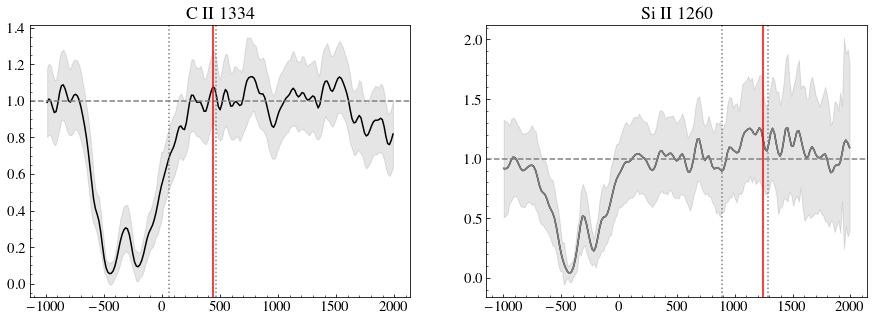

J1545_0858 0.86
no puedo


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


0.2680051555670268 0.06842191117137252


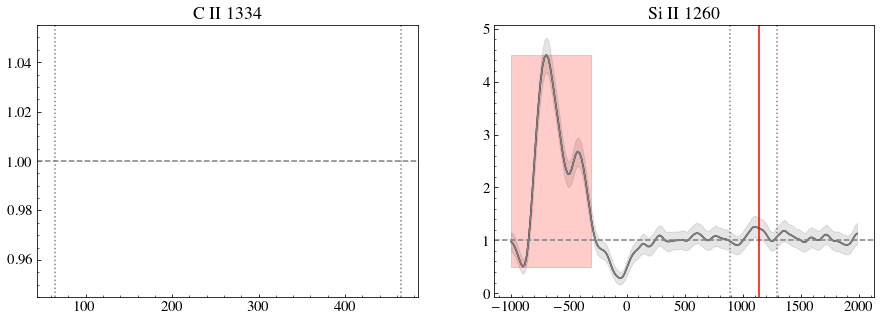

J1612_0817 0.7024
0.34017685441214207 0.07529418737888935
0.39207215338202916 0.07601972371500511


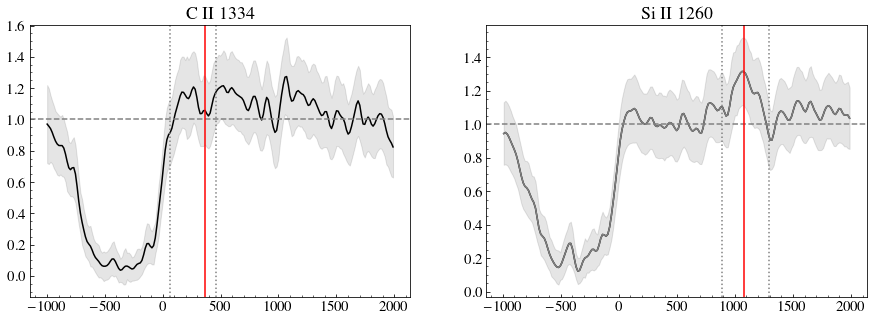

In [45]:
EWfluoSi = np.zeros((45,2)) 
EWfluoSi[EWfluoSi == 0] = np.nan
EWfluoC = np.zeros((45,2))
EWfluoC[EWfluoC == 0] = np.nan

FfluoSi = np.zeros((45,2))
FfluoSi[FfluoSi == 0] = np.nan

FfluoC = np.zeros((45,2))
FfluoC[FfluoC == 0] = np.nan

VfluoSi = np.zeros((45,2))
VfluoSi[VfluoSi == 0] = np.nan

VfluoC = np.zeros((45,2))
VfluoC[VfluoC == 0] = np.nan

for i in range(len(galaxy)):
    spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[i].replace("_", ""), label[i])
    gal   = fits.open(spec)
    print(galaxy[i], classy['fr50aper'][i])
    HR    = gal[8].data  # Rest-frame, galactic extinction-corrected, co-added, high-resolution spectrum
    HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 

    wH, fH, eH, snrH  = HR['WAVE'],  HR['FLUX DENSITY'],  HR['ERROR'],  HR['SNR']
    wHB,fHB,eHB,snrHB = HRB['WAVE'], HRB['FLUX DENSITY'], HRB['ERROR'], HRB['SNR']

    hduin         = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    hdr           = hduin[1].header
    data          = hduin[1].data
    mask          = mask_all[i]

    wave=data['wave']
    vcIId = (data['wave']/wcII1334 -1)*c
    vsiIId =  (data['wave']/wsiII1260 -1)*c

    flux = gaussian_filter(data['flux'],sigma = 1.5)
    
   # fit = gaussian_filter(data['fit'], sigma = 10)
    err = data['err']
   # absflux = gaussian_filter(data['flux']/fit,sigma = 1)
   # abserr = err/fit
    
    cutCIIall = (vcIId>-1000) & (vcIId<2000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<2000)     
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 700)) & maskCII
    if(label[i] == 'j0808+3948'):
        rmedCII = ((vcII>-100) & (vcII < 100)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)) | (vsiII > 1500)) & maskSiII
    if(label[i] == 'j0808+3948'):
        rmedSiII = ((vsiII>-200) & (vsiII < 100)) & maskSiII
    if(label[i] == 'j1112+5503'):
        rmedSiII = ((vsiII>1500)) & maskSiII
    if(label[i] == 'j1323-0132'):
        rmedSiII = ((vsiII>1200)& (vsiII < 1700)) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    limup = 1300
    if i == 2:
        limup =1250  
    
    limdown = 700
    if(label[i] == 'j1132+5722' or label[i] == 'j0127-0619' ):
        print(label[i])
        limdown = 900
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    axs[0].plot(vcII, fcII,  c='k', label = 'Observed')
    axs[0].fill_between(vcII,fcII-ecII/fmedCII, fcII+ecII/fmedCII,  color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
    axs[0].axhline(1, linestyle = '--', c = 'gray')
    axs[0].axvline(offcIIfluo1335-200, linestyle = ':', c = 'gray')
    axs[0].axvline(offcIIfluo1335+200, linestyle = ':', c = 'gray')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), 
                        np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')  
    

        
    axs[1].plot(vsiII, fsiII,   c = 'k' )
    axs[1].plot(vsiII, fsiII,   c = 'gray' )
    axs[1].fill_between(vsiII,fsiII-esiII/fmedSiII, fsiII+esiII/fmedSiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')
    axs[1].axhline(1, linestyle = '--', c = 'gray')
    axs[1].axvline(offsiIIfluo1265-200, linestyle = ':', c = 'gray')
    axs[1].axvline(offsiIIfluo1265+200, linestyle = ':', c = 'gray')
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
        
        
    try:
        EWfluoC[i][0], EWfluoC[i][1] = measureEWemi( wave[cutCIIall][maskCII], vcII[maskCII], fcII.copy()[maskCII],
                                            (ecII.copy()/fmedCII)[maskCII],      offcIIfluo1335-400, 
                                                    offcIIfluo1335+400)

        VfluoC[i][0], VfluoC[i][1], FfluoC[i][0],FfluoC[i][1] = measureMaxVel(vcII[maskCII], fcII.copy()[maskCII],
                                            (ecII.copy()/fmedCII)[maskCII],     00, 600)
        axs[0].axvline(VfluoC[i][0], c= 'r')
        print(EWfluoC[i][0], EWfluoC[i][1])
    except:
        print('no puedo')
        
    try:

        EWfluoSi[i][0], EWfluoSi[i][1] = measureEWemi(wave[cutSiIIall][maskSiII], vsiII[maskSiII], fsiII.copy()[maskSiII],
                                              (esiII.copy()/fmedSiII)[maskSiII], offsiIIfluo1265-400, offsiIIfluo1265+400)
        VfluoSi[i][0], VfluoSi[i][1], FfluoSi[i][0],FfluoSi[i][1] = measureMaxVel(vsiII[maskSiII], fsiII.copy()[maskSiII],
                                              (esiII.copy()/fmedSiII)[maskSiII],   offsiIIfluo1265-400, offsiIIfluo1265+400)
        axs[1].axvline(VfluoSi[i][0], c= 'r')
        print(EWfluoSi[i][0], EWfluoSi[i][1])
    except:
        print('no puedo')
        
    plt.show()

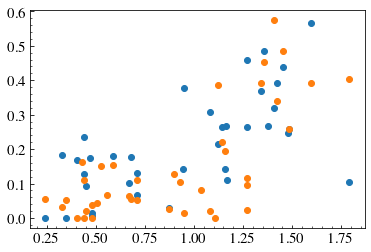

In [46]:
EWfluoSi[:,0][EWfluoSi[:,0]<0] = 0
EWfluoC[:,0][EWfluoC[:,0]<0] = 0

plt.scatter(1/classy['fr50aper'], EWfluoSi[:,0])
plt.scatter(1/classy['fr50aper'], EWfluoC[:,0])

#### Saving

In [47]:
import pandas as pd
df = pd.DataFrame(np.vstack((galaxy,EWfluoC[:,0],EWfluoC[:,1], EWfluoSi[:,0],EWfluoSi[:,1], 
                   VfluoC[:,0],VfluoC[:,1], VfluoSi[:,0],VfluoSi[:,1],  
                   FfluoC[:,0],FfluoSi[:,0])).T) # A is a numpy 2d array
C=['Galaxy','EWFluoCII','ErrEWFluoCII', 'EWFluoSiII', 'ErrEWFluoSiII', 'VFluoCII', 'ErrVFluoCII',
                   'VFluoSiII', 'ErrVFluoSiII', 'FmaxFluoCII', 'FmaxFluoSiII']
df.to_csv("csv/Classy_Fluo_V2.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

## Mock spectra


### 3 time steps, 1728 directions, fine struture, no depletion, vturb 20 km, SMC dust model

In [13]:
directions = np.zeros((1728,3))
for i in range(1728):
    directions[i,:] = hp.pix2vec(12,i)

# Function to read the binary files
def read_file(Dir,FileName,ndir):
    f = ff('%s/%s_spectrum'%(Dir,FileName))
    n = f.read_ints()[0]
    aperture,lmin,lmax = f.read_reals('d')
    spec = np.zeros((ndir,n))
    spec[0,:] = f.read_reals('d')
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        spec[j,:] = f.read_reals('d')
    f.close()

    return lmin,lmax,n,spec

# To get the spectra, in the appropriate units
def read_spectrum(output,spec,path_to_data):
    lum_per_packet = np.genfromtxt('%s/IC_photons_%s_%i'%(path_to_data,spec,output))
    lmin,lmax,npix,phot_packets = read_file(path_to_data,'output_%s_%i.out'%(spec,output),1728)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux

#### C II

In [ ]:
path_to_data = './CII_SiII_3TS/'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 164    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 


# velocity of the center of mass, to correct for the movement of the galaxy in the simulation box:
v_cm = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,output)) 
# l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
l, flux = read_spectrum(output,line,path_to_data) 

ndir = 1727 #(idir 0 and 1 in 148)
EWabsLR = np.zeros(ndir)
EWabsHR = np.zeros(ndir)
EWemiLR = np.zeros(ndir)
EWemiHR = np.zeros(ndir)
VabsLR = np.zeros(ndir)
VabsHR = np.zeros(ndir)
VemiLR = np.zeros(ndir)
VemiHR = np.zeros(ndir)
FabsLR = np.zeros(ndir)
FabsHR = np.zeros(ndir)
FemiLR = np.zeros(ndir)
FemiHR = np.zeros(ndir)


for idir in range(ndir):
    
    l_systemic = l + np.dot(directions[idir,:],v_cm)/c_cgs*1e5*np.mean(l) 

    vcII   = (l_systemic/1334.532 -1)*c
    sigma_pixel = 61 / ((vcII[50]-vcII[49]))

    
    fluxdir = flux[idir,:]
    model = gaussian_filter(fluxdir, sigma = sigma_pixel)
    fluxdir /= np.median(fluxdir)

    model = model/np.median(model)

    plt.plot(vcII,model/np.median(model))

    EWabsHR[idir], oo = measureEWabs(l_systemic, vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -800, 500)
    EWabsLR[idir], oo = measureEWabs(l_systemic, vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -800, 500)

    EWemiHR[idir], oo = measureEWemi(l_systemic, vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -200, 800)
    EWemiLR[idir], oo = measureEWemi(l_systemic, vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -200, 800)
    
    VabsHR[idir], oo, FabsHR[idir] = measureMinVel(vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -800, 500)
    VabsLR[idir], oo , FabsLR[idir] = measureMinVel(vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -800, 500)

    VemiHR[idir], oo, FemiHR[idir] = measureMaxVel(vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -200, 800)
    VemiLR[idir], oo, FemiLR[idir] = measureMaxVel(vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -200, 800)


In [ ]:
import pandas as pd
df = pd.DataFrame(np.vstack((np.linspace(0,1726,1727),EWabsHR,EWabsLR, EWemiHR, EWemiLR, VabsHR, VabsLR, VemiHR,
                   VemiLR, FabsHR, FabsLR, FemiHR, FemiLR)).T) # A is a numpy 2d array
C=['dir','EWabsHR','EWabsLR', 'EWemiHR', 'EWemiLR', 'VabsHR', 'VabsLR', 'VemiHR',
                   'VemiLR', 'FabsHR', 'FabsLR', 'FemiHR', 'FemiLR']
df.to_csv("CII_SiII_3TS/Si II C II Measurements/CII_164.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

#### Si II

In [ ]:
path_to_data = './CII_SiII_3TS/'   # To change if you move the data

line    = 'SiII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 156    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 


# velocity of the center of mass, to correct for the movement of the galaxy in the simulation box:
v_cm = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,output)) 
# l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
l, flux = read_spectrum(output,line,path_to_data) 

ndir = 1727 #(idir 0 and 1 in 148)
EWabsLR = np.zeros(ndir)
EWabsHR = np.zeros(ndir)
EWemiLR = np.zeros(ndir)
EWemiHR = np.zeros(ndir)
VabsLR = np.zeros(ndir)
VabsHR = np.zeros(ndir)
VemiLR = np.zeros(ndir)
VemiHR = np.zeros(ndir)
FabsLR = np.zeros(ndir)
FabsHR = np.zeros(ndir)
FemiLR = np.zeros(ndir)
FemiHR = np.zeros(ndir)

for idir in range(ndir):
    
    # To correct for the movement of the galaxy in the simulation box (not useful for the continuum):
    l_systemic = l + np.dot(directions[idir,:],v_cm)/c_cgs*1e5*np.mean(l) 

    # The flux drops down on the far-left and far-right sides, ignore this part
    vcII   = (l_systemic/1260.42 -1)*c
    sigma_pixel = 50 / ((vcII[50]-vcII[49]))
    fluxdir = flux[idir,:]
    model = gaussian_filter(fluxdir, sigma = sigma_pixel)
    fluxdir /= np.median(fluxdir)
#     mask=(vcII>1500) & (vcII < 2000)

    model = model/np.median(model)
    plt.plot(vcII,model)
    EWabsHR[idir], oo = measureEWabs(l_systemic, vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -1000, 500)
    EWabsLR[idir], oo = measureEWabs(l_systemic, vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -1000, 500)

    EWemiHR[idir], oo = measureEWemi(l_systemic, vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             600, 1400)
    EWemiLR[idir], oo = measureEWemi(l_systemic, vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             600, 1400)
    
    VabsHR[idir], oo, FabsHR[idir] = measureMinVel(vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -1000, 500)
    VabsLR[idir], oo , FabsLR[idir] = measureMinVel(vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -1000, 500)


    VemiHR[idir], oo, FemiHR[idir] = measureMaxVel(vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             600, 1400)
    VemiLR[idir], oo, FemiLR[idir] = measureMaxVel(vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             600, 1400)
plt.axhline(1)
plt.axvline(1400)
plt.axvline(600)



In [ ]:
import pandas as pd
df = pd.DataFrame(np.vstack((np.linspace(0,1726,1727),EWabsHR,EWabsLR, EWemiHR, EWemiLR, VabsHR, VabsLR, VemiHR,
                   VemiLR, FabsHR, FabsLR, FemiHR, FemiLR)).T) # A is a numpy 2d array
C=['dir','EWabsHR','EWabsLR', 'EWemiHR', 'EWemiLR', 'VabsHR', 'VabsLR', 'VemiHR',
                   'VemiLR', 'FabsHR', 'FabsLR', 'FemiHR', 'FemiLR']
df.to_csv('CII_SiII_3TS/Si II C II Measurements/SiII_148.csv', sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

### 75 time steps, 300 directions

In [16]:
n_halos = 75
n_phots = np.append(np.logspace(7,6,20), 1000000*np.ones(n_halos-20)).astype(int)

ndirections = 300
directions = np.zeros((ndirections,3))
for i in range(ndirections):
    directions[i,:] = hp.pix2vec(5,i)

path_to_data_arr=['CII_SiII_nofine/', 'CII_SiII_fine/', 'CII_SiII_ND/', 'CII_SiII_depletion/']
#0: no fs, 1: fs, 2: Katz dust, 3: depletion

Text(0, 0.5, 'flux [erg/s/A]')

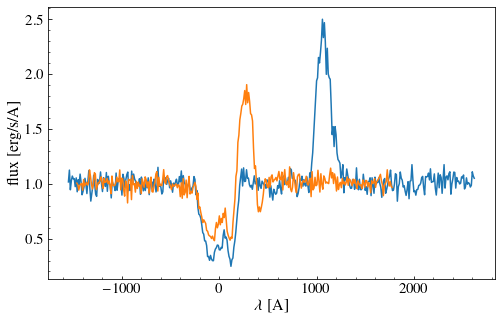

In [19]:
path_to_data = path_to_data_arr[2] # To change if you move the data
v_cm = np.genfromtxt('./dat_files/vcm_90_164.dat',unpack=True)

output  = 96    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 
idir = 113 # to choose a direction of observation, between 0 and ndirections-1


l, flux = read_spectrum_si(path_to_data,output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vsiII   = (l_systemic[1:]/wsiII1260 -1)*c

fig,ax = plt.subplots(figsize=(8,5))
plt.plot(vsiII,flux[idir,1:]/np.median(flux[idir,1:]))
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)

l, flux = read_spectrum_c(path_to_data,output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wcII1334 -1)*c
plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]))
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)



#### Measuring all and saving

In [27]:
path_to_data = path_to_data_arr[3]   # To change depending on which model is needed

nout = 75
ndir = 300 

EWabsLRC = np.zeros((nout,ndir))
EWabsHRC = np.zeros((nout,ndir))
RabsLRC  = np.zeros((nout,ndir))
RabsHRC  = np.zeros((nout,ndir))
VabsLRC = np.zeros((nout,ndir))
VabsHRC = np.zeros((nout,ndir))
VcenLRC = np.zeros((nout,ndir))
VcenHRC = np.zeros((nout,ndir))
EWemiLRC = np.zeros((nout,ndir))
EWemiHRC = np.zeros((nout,ndir))
VemiLRC = np.zeros((nout,ndir))
VemiHRC = np.zeros((nout,ndir))
FemiLRC = np.zeros((nout,ndir))
FemiHRC = np.zeros((nout,ndir))

EWabsLRSi = np.zeros((nout,ndir))
EWabsHRSi = np.zeros((nout,ndir))
RabsLRSi  = np.zeros((nout,ndir))
RabsHRSi  = np.zeros((nout,ndir))
VabsLRSi = np.zeros((nout,ndir))
VabsHRSi = np.zeros((nout,ndir))
VcenLRSi = np.zeros((nout,ndir))
VcenHRSi = np.zeros((nout,ndir))
EWemiLRSi = np.zeros((nout,ndir))
EWemiHRSi = np.zeros((nout,ndir))
VemiLRSi = np.zeros((nout,ndir))
VemiHRSi = np.zeros((nout,ndir))
FemiLRSi = np.zeros((nout,ndir))
FemiHRSi = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar

rMods = 61
v_cm = np.genfromtxt('./dat_files//vcm_90_164.dat',unpack=True)

for output in range(90,165,1):
    f.value += 1# output = 142
    l_c, flux_c = read_spectrum_c(path_to_data,output )
    l_si, flux_si = read_spectrum_si(path_to_data,output )
    vGal = v_cm[:,output-90]

    for idir in range(300):
        l_sys_c = l_c + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_c)
        l_sys_c =l_sys_c[1:]
        vcII   = (l_sys_c/wcII1334 -1)*c
        sigma_pixel = rMods / 2.355 / ((vcII[50]-vcII[49]))
        
        fluxdir = flux_c[idir,1:]
        
        fluxdir /= np.nanmedian(fluxdir[(vcII>1000)])
        
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1000)])
            
        EWabsHRC[output-90, idir], oo = measureEWabs(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     -800, 500)
        EWabsLRC[output-90,idir], oo = measureEWabs(l_sys_c, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                    -800, 500)

        EWemiHRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                    -200, 800)
        EWemiLRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                    -200, 800)

        VabsHRC[output-90,idir], oo, RabsHRC[output-90,idir], ooo = measureMinVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -800, 500)
        VabsLRC[output-90,idir], oo , RabsLRC[output-90,idir], ooo = measureMinVel(vcII, model.copy(), 
                                                                              np.zeros(len(fluxdir)), -800, 500)
        
        VcenHRC[output-90,idir],oo = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRC[output-90,idir],oo = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)

        
        VemiHRC[output-90,idir], oo, FemiHRC[output-90,idir], ooo = measureMaxVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
        VemiLRC[output-90,idir], oo, FemiLRC[output-90,idir], ooo = measureMaxVel(vcII, model.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
                
        l_sys_si = l_si + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_si) 
        l_sys_si =l_sys_si[1:]

        vcII   = (l_sys_si/1260.42 -1)*c
        sigma_pixel = rMods / 2.355/ ((vcII[50]-vcII[49]))
        
        fluxdir = flux_si[idir,1:]
        fluxdir/= np.nanmedian(fluxdir[(vcII>1500)])
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1500)])
        
        
        #if(output == 102):
       # axs[1].plot(vcII,model)

        EWabsHRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                     -800, 500)
        EWabsLRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                     -800, 500)

        EWemiHRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     600, 1400)
        EWemiLRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                     600, 1400)

        VabsHRSi[output-90,idir], oo, RabsHRSi[output-90,idir],ooo = measureMinVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), -800, 500)
        VabsLRSi[output-90,idir], oo , RabsLRSi[output-90,idir],ooo = measureMinVel(vcII, model.copy(), 
                                                                                np.zeros(len(fluxdir)), -800, 500)

        VcenHRSi[output-90,idir],oo = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRSi[output-90,idir],oo = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)
        
        
        VemiHRSi[output-90,idir], oo, FemiHRSi[output-90,idir],oooo = measureMaxVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        VemiLRSi[output-90,idir], oo, FemiLRSi[output-90,idir],ooo = measureMaxVel(vcII, model.copy(), 
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        if(FemiHRSi[output-90,idir]<1.15):
             VemiHRSi[output-90,idir] = np.nan
        if(FemiLRSi[output-90,idir]<1.15):
             VemiLRSi[output-90,idir] = np.nan       
        if(FemiHRC[output-90,idir]<1.15):
             VemiHRC[output-90,idir] = np.nan
        if(FemiLRC[output-90,idir]<1.15):
             VemiLRC[output-90,idir] = np.nan  


IntProgress(value=0, max=75)

In [28]:
for i in range(75):
    df = pd.DataFrame(np.vstack((np.linspace(0,299,300),  
                                 EWabsHRC[i,:], EWabsLRC[i,:], 
                                 EWemiHRC[i,:], EWemiLRC[i,:], 
                                 VabsHRC[i,:], VabsLRC[i,:], 
                                 VcenHRC[i,:], VcenLRC[i,:], 
                                 VemiHRC[i,:], VemiLRC[i,:],
                                 RabsHRC[i,:], RabsLRC[i,:], 
                                 FemiHRC[i,:], FemiLRC[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    df.to_csv(f"{path_to_data}/Measurements/CII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 
    
    dff = pd.DataFrame(np.vstack((np.linspace(0,299,300), 
                                  EWabsHRSi[i,:], EWabsLRSi[i,:], 
                                  EWemiHRSi[i,:], EWemiLRSi[i,:], 
                                  VabsHRSi[i,:], VabsLRSi[i,:],
                                  VcenHRSi[i,:], VcenLRSi[i,:], 
                                  VemiHRSi[i,:], VemiLRSi[i,:], 
                                  RabsHRSi[i,:], RabsLRSi[i,:], 
                                  FemiHRSi[i,:], FemiLRSi[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    dff.to_csv(f"{path_to_data}/Measurements/SiII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 

### 1 TS - 300 directions 

419 300 300


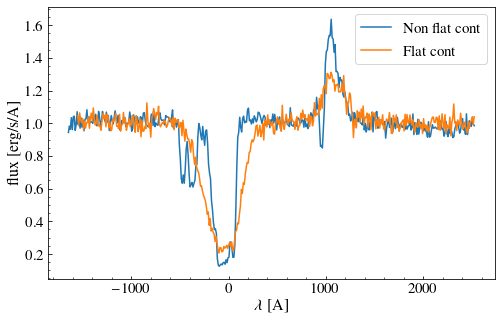

In [41]:
path_to_data = './TestOutPut148/non_flat_continuum_output_148/'   # To change if you move the data
output  = 148    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 
v_cm = np.genfromtxt('./dat_files/vcm_90_164.dat',unpack=True)

f = ff(f'{path_to_data}IC_photons_1000000_nphots')    
a = f.read_ints()
lum_per_packet = f.read_reals()
f.close()
lum_per_packet = lum_per_packet/a
lmin,lmax,npix,phot_packets = \
    read_file( path_to_data,'output.out', ndirections)
dl   = (lmax - lmin) / npix                  # [A] 
l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
flux = flux / dl                             # [erg / s / A / phot packet]
flux = flux * phot_packets                   # [erg / s/ A]
print(len(l), len(flux), len(phot_packets))
idir = 200 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1260.42 -1)*c

fig,ax = plt.subplots(figsize=(8,5))
plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]), label='Non flat cont')
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)


path_to_data = './CII_SiII_depletion/'   # To change if you move the data

l, flux = read_spectrum_si(path_to_data,output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wsiII1260 -1)*c

plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]), label='Flat cont')
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)
plt.legend()


In [45]:
path_to_data = './TestOutPut148/non_flat_continuum_output_148/'   # To change if you move the data

nout = 1
ndir = 300 

EWabsLRC = np.zeros((nout,ndir))
EWabsHRC = np.zeros((nout,ndir))
RabsLRC  = np.zeros((nout,ndir))
RabsHRC  = np.zeros((nout,ndir))
VabsLRC = np.zeros((nout,ndir))
VabsHRC = np.zeros((nout,ndir))
VcenLRC = np.zeros((nout,ndir))
VcenHRC = np.zeros((nout,ndir))
EWemiLRC = np.zeros((nout,ndir))
EWemiHRC = np.zeros((nout,ndir))
VemiLRC = np.zeros((nout,ndir))
VemiHRC = np.zeros((nout,ndir))
FemiLRC = np.zeros((nout,ndir))
FemiHRC = np.zeros((nout,ndir))

EWabsLRSi = np.zeros((nout,ndir))
EWabsHRSi = np.zeros((nout,ndir))
RabsLRSi  = np.zeros((nout,ndir))
RabsHRSi  = np.zeros((nout,ndir))
VabsLRSi = np.zeros((nout,ndir))
VabsHRSi = np.zeros((nout,ndir))
VcenLRSi = np.zeros((nout,ndir))
VcenHRSi = np.zeros((nout,ndir))
EWemiLRSi = np.zeros((nout,ndir))
EWemiHRSi = np.zeros((nout,ndir))
VemiLRSi = np.zeros((nout,ndir))
VemiHRSi = np.zeros((nout,ndir))
FemiLRSi = np.zeros((nout,ndir))
FemiHRSi = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar

rMods = 61
v_cm = np.genfromtxt('./dat_files//vcm_90_164.dat',unpack=True)

for output in range(148,149,1):
    f.value += 1# output = 142

    file = ff(f'{path_to_data}IC_photons_1000000_nphots')    
    a = file.read_ints()
    lum_per_packet = file.read_reals()
    file.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file( path_to_data,'output.out', ndir)
    dl   = (lmax - lmin) / npix                  # [A] 
    l_si    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux_si = h_cgs*c_cgs/(l_si*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux_si = flux_si / dl                             # [erg / s / A / phot packet]
    flux_si = flux_si * phot_packets                   # [erg / s/ A]

    #l_si, flux_si = read_spectrum_si(path_to_data,output )
    vGal = v_cm[:,output-90]

    for idir in range(300):
       
        l_sys_si = l_si + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_si) 
        l_sys_si =l_sys_si[1:]

        vcII   = (l_sys_si/1260.42 -1)*c
        sigma_pixel = rMods / 2.355/ ((vcII[50]-vcII[49]))
        
        fluxdir = flux_si[idir,1:]
        fluxdir/= np.nanmedian(fluxdir[(vcII>1500)])
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1500)])
        
        
        #if(output == 102):
       # axs[1].plot(vcII,model)

        EWabsHRSi[0,idir], oo = measureEWabs(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                     -800, 500)
        EWabsLRSi[0,idir], oo = measureEWabs(l_sys_si, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                     -800, 500)

        EWemiHRSi[0,idir], oo = measureEWemi(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     600, 1400)
        EWemiLRSi[0,idir], oo = measureEWemi(l_sys_si, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                     600, 1400)

        VabsHRSi[0,idir], oo, RabsHRSi[0,idir],ooo = measureMinVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), -800, 500)
        VabsLRSi[0,idir], oo , RabsLRSi[0,idir],ooo = measureMinVel(vcII, model.copy(), 
                                                                                np.zeros(len(fluxdir)), -800, 500)

        VcenHRSi[0,idir],oo = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRSi[0,idir],oo = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)
        
        
        VemiHRSi[0,idir], oo, FemiHRSi[0,idir],oooo = measureMaxVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        VemiLRSi[0,idir], oo, FemiLRSi[0,idir],ooo = measureMaxVel(vcII, model.copy(), 
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        if(FemiHRSi[0,idir]<1.15):
             VemiHRSi[0,idir] = np.nan
        if(FemiLRSi[0,idir]<1.15):
             VemiLRSi[0,idir] = np.nan       
        if(FemiHRC[0,idir]<1.15):
             VemiHRC[0,idir] = np.nan
        if(FemiLRC[0,idir]<1.15):
             VemiLRC[0,idir] = np.nan  


IntProgress(value=0, max=1)

In [46]:
for i in range(1):
#     df = pd.DataFrame(np.vstack((np.linspace(0,299,300),  
#                                  EWabsHRC[i,:], EWabsLRC[i,:], 
#                                  EWemiHRC[i,:], EWemiLRC[i,:], 
#                                  VabsHRC[i,:], VabsLRC[i,:], 
#                                  VcenHRC[i,:], VcenLRC[i,:], 
#                                  VemiHRC[i,:], VemiLRC[i,:],
#                                  RabsHRC[i,:], RabsLRC[i,:], 
#                                  FemiHRC[i,:], FemiLRC[i,:])).T) # A is a numpy 2d array
#     C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
#        'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
#        'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
#     df.to_csv("CII_SiII_fine/CII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 
    
    dff = pd.DataFrame(np.vstack((np.linspace(0,299,300), 
                                  EWabsHRSi[i,:], EWabsLRSi[i,:], 
                                  EWemiHRSi[i,:], EWemiLRSi[i,:], 
                                  VabsHRSi[i,:], VabsLRSi[i,:],
                                  VcenHRSi[i,:], VcenLRSi[i,:], 
                                  VemiHRSi[i,:], VemiLRSi[i,:], 
                                  RabsHRSi[i,:], RabsLRSi[i,:], 
                                  FemiHRSi[i,:], FemiLRSi[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    dff.to_csv(f"{path_to_data}/SiII_%d_300.csv"%(i+148), sep=',', header= C, index=False) 

## Cube measurements

In [5]:
nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII_dep/',300)
print(nxy)
nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII_dep/',300)

64


### Line properties as fnction of radii

In [ ]:
## Light curves + spectra in increasing rings
EWabsCII = np.zeros((300,64))
RabsCII  = np.zeros((300,64))
VcenCII  = np.zeros((300,64))
EWemiCII = np.zeros((300,64))
VemiCII = np.zeros((300,64))
FemiCII = np.zeros((300,64))
ContMedCII = np.zeros((300,64))
EWabsSiII = np.zeros((300,64))
RabsSiII  = np.zeros((300,64))
VcenSiII  = np.zeros((300,64))
EWemiSiII = np.zeros((300,64))
VemiSiII = np.zeros((300,64))
FemiSiII = np.zeros((300,64))
ContMedSiII = np.zeros((300,64))

for idir in range(300):


#     spec = np.sum(cube[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
    lsyscII    = lcubecII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII[1:]) 
    vcII_s  = (lsyscII/wcII1334-1)*c
    
    lsyssiII    = lcubeSiII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiII[1:]) 
    vsiII_s  = (lsyssiII/wsiII1260-1)*c
    
    imagecontcII = np.sum(cubecII[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 
#     imagecontsiII = np.sum(cubeSiII[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 

    y,x = np.where(imagecontcII == np.max(imagecontcII))
    sigma_pixelcII = 70 / 2.355 / ((vcII_s[50]-vcII_s[49]))
    sigma_pixelsiII = 70 / 2.355 / ((vsiII_s[50]-vsiII_s[49]))

    for rad in range(1,64):
        
        aperture = CircularAperture([x[0],y[0]], r=rad) 
        aperture_masks = aperture.to_mask(method='center') # create mask
        fimageoricII = cubecII[idir,:,:,1:].copy()
        fimagecII = []
        for i in range(fimageoricII.shape[-1]):
            fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,i]))
 
        fimageorisiII = cubeSiII[idir,:,:,1:].copy()
        fimagesiII = []
        for i in range(fimageorisiII.shape[-1]):
            fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,i]))
            
        spec_centercII = np.sum(np.asarray(fimagecII)[:,:,:],axis=(1,2))
        spec_centersiII = np.sum(np.asarray(fimagesiII)[:,:,:],axis=(1,2))

        rmedCII = ((vcII_s<-500) | (vcII_s > 700)) 
        fmedCII = np.nanmedian(spec_centercII[rmedCII])
        spec_centercII /= fmedCII
        ContMedCII[idir, rad] =  fmedCII
        
        rmedSiII =  ((vsiII_s<-500) | (vsiII_s > 1500)) 
        fmedSiII = np.nanmedian(spec_centersiII[rmedSiII])
        spec_centersiII /= fmedSiII
        ContMedSiII[idir, rad] =  fmedSiII
        
        
        modelcii = gaussian_filter(spec_centercII, sigma = sigma_pixelcII)
        modelsiii = gaussian_filter(spec_centersiII, sigma = sigma_pixelsiII)

       # #if(rad <= 15):
        #    plt.plot(vcII_s,spec_center)
        EWabsCII[idir, rad], oo = measureEWabs(lsyscII, vcII_s, modelcii.copy(), np.zeros(len(modelcii)),
                                                     -800, 500)
        EWabsSiII[idir, rad], oo = measureEWabs(lsyssiII, vsiII_s, modelsiii.copy(), np.zeros(len(modelsiii)),
                                                     -800, 500)
        
        EWemiCII[idir, rad], oo = measureEWemi(lsyscII, vcII_s, modelcii.copy(), np.zeros(len(modelcii)), 
                                                    -200, 800)
        EWemiSiII[idir, rad], oo = measureEWemi(lsyssiII, vsiII_s, modelsiii.copy(), np.zeros(len(modelsiii)), 
                                                    600, 1400)
        
        aa, oo, RabsCII[idir, rad], ooo = measureMinVel(vcII_s, modelcii.copy(), 
                                                                             np.zeros(len(modelcii)), -800, 500)
        aa, oo , RabsSiII[idir, rad], ooo = measureMinVel(vsiII_s, modelsiii.copy(), 
                                                                              np.zeros(len(modelsiii)), -800, 500)
        
        VcenCII[idir,rad], oo = measureCenV(vcII_s, modelcii.copy(), np.zeros(len(modelcii)), -800, 500)
        VcenSiII[idir,rad], oo = measureCenV(vsiII_s, modelsiii.copy(), np.zeros(len(modelsiii)), -800, 500)
        
#         if(RabsCII[idir, rad] < 0.05):
#             plt.plot(vsiII_s,modelsiii )
# #             plt.show()
#             break
        VemiCII[idir, rad], oo, FemiCII[idir, rad], ooo = measureMaxVel(vcII_s, modelcii.copy(), 
                                                                np.zeros(len(modelcii)), -200, 800)
  
        VemiSiII[idir, rad], oo, FemiSiII[idir, rad], ooo = measureMaxVel(vsiII_s, modelsiii.copy(), 
                                                                np.zeros(len(modelsiii)), 600, 1400)
          
        
#         VemiHRSi[output-90,idir], oo, FemiHRSi[output-90,idir],oooo = measureMaxVel(vcII, fluxdir.copy(),
#                                                                                np.zeros(len(fluxdir)), 600, 1400)
#         VemiLRSi[output-90,idir], oo, FemiLRSi[output-90,idir],ooo = measureMaxVel(vcII, model.copy(), 
#                                                                                np.zeros(len(fluxdir)), 600, 1400)

In [ ]:
for i in range(300):
    df = pd.DataFrame(np.vstack((np.arange(1,64,1),  
                                 EWabsCII[i,1:], EWemiCII[i,1:], 
                                 VcenCII[i,1:], VemiCII[i,1:], 
                                 RabsCII[i,1:], FemiCII[i,1:], ContMedCII[i,1:])).T) # A is a numpy 2d array
    C=['r', 'EWabs', 'EWemi',  'Vcen', 'Vemi', 'Rabs', 'Femi', 'Cont']
    df.to_csv("data_cubes_output_148/Image_Measurements_dep/CII_image_%d.csv"%(i), sep=',', header= C, index=False) 
    

    df = pd.DataFrame(np.vstack((np.arange(1,64,1),  
                                 EWabsSiII[i,1:], EWemiSiII[i,1:], 
                                 VcenSiII[i,1:], VemiSiII[i,1:], 
                                 RabsSiII[i,1:], FemiSiII[i,1:], ContMedSiII[i,1:])).T) # A is a numpy 2d array
    C=['r', 'EWabs', 'EWemi',  'Vcen', 'Vemi', 'Rabs', 'Femi', 'Cont']
    df.to_csv("data_cubes_output_148/Image_Measurements_dep/SiII_image_%d.csv"%(i), sep=',', header= C, index=False) 
    

### Light curves

#### Integrating over small interval

In [ ]:
## Light curves + spectra in increasing rings
nrad = 50
rrad  = np.zeros(nrad)

ndir = 300

rfluxcontcii = np.zeros((ndir,nrad))
totalcontcii= np.zeros((ndir,nrad))
rfluxfluocii = np.zeros((ndir,nrad))
totalfluocii = np.zeros((ndir,nrad))
rfluxcontsiii = np.zeros((ndir,nrad))
totalcontsiii= np.zeros((ndir,nrad))
rfluxfluosiii = np.zeros((ndir,nrad))
totalfluosiii = np.zeros((ndir,nrad))

for idir in range(ndir):


#     spec = np.sum(cube[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
    lsyscII    = lcubecII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII[1:]) 
    vcII_s  = (lsyscII/wcII1334-1)*c
    
    lsyssiII    = lcubeSiII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiII[1:]) 
    vsiII_s  = (lsyssiII/wsiII1260-1)*c
    
    imagecontcII = np.sum(cubecII[idir,:,:,40:50],axis=(2))#/ (imsize/nxy)**2 
#     imagecontsiII = np.sum(cubeSiII[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 

    y,x = np.where(imagecontcII == np.max(imagecontcII))


    fimageoricII = cubecII[idir,:,:,1:].copy()
    fimageorisiII = cubeSiII[idir,:,:,1:].copy()

    
    aperture = CircularAperture([x[0],y[0]], r=1) 
    aperture_masks = aperture.to_mask(method='center') # create mask
    fimagecII = []
    for i in range(fimageoricII.shape[-1]):
        fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,i]))
 
    fimagesiII = []
    for i in range(fimageorisiII.shape[-1]):
        fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,i]))

    fimagecII = np.asarray(fimagecII)
    fimagesiII = np.asarray(fimagesiII)
    
#     maskcII = (vcII_s>234)  & (vcII_s < 294)
    maskcII = (vcII_s>250)  & (vcII_s < 310)
#     print(np.arange(0,len(maskcII),1)[maskcII][0])
    fcontcII =  np.nansum(fimagecII[10:10+sum(maskcII==1),:,:], axis = 0)
    ffluocII =  np.nansum(fimagecII[maskcII,:,:], axis = 0) - fcontcII

    masksiII = (vsiII_s>1070)  & (vsiII_s < 1130)
    
    fcontsiII =  np.nansum(fimagesiII[10:10+sum(masksiII==1),:,:], axis = 0)
    ffluosiII =  np.nansum(fimagesiII[masksiII,:,:], axis = 0) - fcontsiII
#     plt.imshow(np.log(fcontcII))
#     plt.figure()
#     plt.imshow(np.log(ffluocII))
    
#     plt.figure()
#     plt.plot(vcII_s, np.sum(fimagecII[:,:,:], axis = (1,2)))
#     plt.axvline(vcII_s[174])
#     plt.axvline(vcII_s[174])
#     plt.axvline(310)

    rrad[0]      = 0.5

    rfluxcontcii[idir, 0] = np.sum(fcontcII)
    totalcontcii[idir, 0] = rfluxcontcii[idir,0]
    rfluxfluocii[idir, 0] = np.sum(ffluocII[ffluocII>0])#[ffluocII>0]
    totalfluocii[idir, 0] = rfluxfluocii[idir,0]
    
    rfluxcontsiii[idir, 0] = np.sum(fcontsiII)
    totalcontsiii[idir, 0] = rfluxcontsiii[idir,0]
    rfluxfluosiii[idir, 0] = np.sum(ffluosiII[ffluosiII>0]) #[ffluosiII>0]
    totalfluosiii[idir, 0] = rfluxfluosiii[idir,0]
    
    # plt.imshow(fimage2)
    for kk in range(1,nrad):
        ppix1 = kk 
        ppix2 = (kk+1) 
        aperture2 = CircularAnnulus([x[0],y[0]], r_in=ppix1, r_out=ppix2) 
        aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask
        fimagecII = []
        for i in range(fimageoricII.shape[-1]):
            fimagecII.append(aperture_masks2.multiply(fimageoricII[:,:,i]))

        fimagesiII = []
        for i in range(fimageorisiII.shape[-1]):
            fimagesiII.append(aperture_masks2.multiply(fimageorisiII[:,:,i]))

        fimagecII = np.asarray(fimagecII)
        fimagesiII = np.asarray(fimagesiII)

#         maskcII = (vcII_s>214)  & (vcII_s < 314)

        fcontcII =  np.nansum(fimagecII[10:10+sum(maskcII==1),:,:], axis = 0)
        ffluocII =  np.nansum(fimagecII[maskcII,:,:], axis = 0) - fcontcII

        
#         masksiII = (vsiII_s>1040)  & (vsiII_s < 1140)
    
        fcontsiII =  np.nansum(fimagesiII[10:10+sum(masksiII==1),:,:], axis = 0)
        ffluosiII =  np.nansum(fimagesiII[masksiII,:,:], axis = 0) - fcontsiII
        rrad[kk]  = kk + 1
        rfluxcontcii[idir,kk] = np.nansum(fcontcII)
        totalcontcii[idir,kk] = totalcontcii[idir,kk-1] + rfluxcontcii[idir,kk]
        rfluxfluocii[idir,kk] = np.nansum(ffluocII[ffluocII>0]) #[ffluocII>0]
        totalfluocii[idir,kk] = totalfluocii[idir,kk-1] + rfluxfluocii[idir,kk]    
 
        rfluxcontsiii[idir,kk] = np.nansum(fcontsiII)
        totalcontsiii[idir,kk] = totalcontsiii[idir,kk-1] + rfluxcontsiii[idir,kk]
        rfluxfluosiii[idir,kk] = np.nansum(ffluosiII[ffluosiII>0]) #[ffluosiII>0]
        totalfluosiii[idir,kk] = totalfluosiii[idir,kk-1] + rfluxfluosiii[idir,kk]  
        


In [ ]:
#Ploting

meanrfluxcII = np.nanmean(rfluxcontcii, axis = 0)
stdrfluxcII = np.nanstd(rfluxcontcii, axis = 0)
stdrfluxcII[(meanrfluxcII-stdrfluxcII)< 0] = stdrfluxcII[(meanrfluxcII-stdrfluxcII)< 0]*0.6
stdrfluxcII = gaussian_filter(stdrfluxcII,sigma = 1)
meantotfcII = np.mean(totalcontcii, axis = 0)

meanrfluxsiII = np.nanmean(rfluxcontsiii, axis = 0)
stdrfluxsiII = np.nanstd(rfluxcontsiii, axis = 0)
stdrfluxsiII[(meanrfluxsiII-stdrfluxsiII)< 0] = stdrfluxsiII[(meanrfluxsiII-stdrfluxsiII)< 0]*0.6
# stdrfluxsiII = gaussian_filter(stdrfluxsiII,sigma = 1)


meantotfsiII = np.mean(totalcontsiii, axis = 0)
r50cii = np.zeros(300)
r50siii = np.zeros(300)

for i in range(300):
    
    xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

    f  = interpolate.interp1d(rrad, rfluxcontcii[i])
    ft = interpolate.interp1d(rrad, totalcontcii[i])
    ynewcii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewcii = ft(xnew) 
#     print(len(rrad), len(rfluxcontcii[i]))
    f  = interpolate.interp1d(rrad, rfluxcontsiii[i])
    ft = interpolate.interp1d(rrad, totalcontsiii[i])
    ynewsiii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewsiii = ft(xnew) 

    half_fluxcii = np.max(ytnewcii)/2.0
    half_fluxsiii = np.max(ytnewsiii)/2.0

#     print(half_fluxcii,half_fluxsiii)
    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewcii,1) >= half_fluxcii)])
#     r50cii = r50s
    if len(r50s > 1): r50cii[i] = r50s[0]
    else: r50cii[i] = r50s

    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewsiii,1) >= half_fluxsiii)])
#     r50siii = r50s
    if len(r50s > 1): r50siii[i] = r50s[0]
    else: r50siii[i] = r50s

plt.figure(figsize = (7,5))
plt.plot(rrad*(imsize/nxy),meanrfluxsiII,label='Continuum', c = 'k', linewidth = 2)
plt.fill_between(rrad*(imsize/nxy),meanrfluxsiII+stdrfluxsiII,
                 meanrfluxsiII - stdrfluxsiII, color= 'k', alpha = 0.2)
plt.plot(rrad*(imsize/nxy),np.nanmean(rfluxfluocii, axis = 0),label='C II* $-$ continuum', color = cFS, linewidth = 2)
plt.fill_between(rrad*(imsize/nxy),np.nanmean(rfluxfluocii, axis = 0)+np.nanstd(rfluxfluocii, axis = 0),
                 np.nanmean(rfluxfluocii, axis = 0)- np.nanstd(rfluxfluocii, axis = 0),
                 color = cFS, alpha = 0.2)

plt.plot(rrad*(imsize/nxy),np.nanmean(rfluxfluosiii, axis = 0),label='Si II* $-$ continuum',color = cnoFS, linewidth = 2)
plt.fill_between(rrad*(imsize/nxy),np.nanmean(rfluxfluosiii, axis = 0)+np.nanstd(rfluxfluosiii, axis = 0),
                 np.nanmean(rfluxfluosiii, axis = 0) - np.nanstd(rfluxfluosiii, axis = 0),
                                                                 color = cnoFS, alpha = 0.2)

plt.axvline(np.nanmean(r50cii), label = r'$r_{50}^{\rm UV}$', color = 'mediumseagreen', linestyle = ':', linewidth = 2 )

plt.axvspan(np.nanmean(r50cii)-np.nanstd(r50cii), np.nanmean(r50cii)+np.nanstd(r50cii),color = 'mediumseagreen',
           alpha = 0.1)
# plt.axvline(np.mean(r50siii))
plt.yscale('log')
# plt.axvline((imsize/nxy)*r100)

plt.xlabel('Radius (parsec)', fontsize = 18)
plt.ylabel('Surface brightness (erg s$^{-1}$)', fontsize = 18)
plt.legend(frameon=False, ncol=2)
plt.xlim(-0,5500)
# plt.savefig('Plots/lightcurves.pdf', bbox_inches = 'tight')

In [ ]:
df = pd.DataFrame(np.vstack((rrad, meanrfluxcII, stdrfluxcII ,
                             np.nanmean(rfluxfluocii, axis = 0), np.nanstd(rfluxfluocii, axis = 0) ,
                            meanrfluxsiII, stdrfluxsiII ,
                             np.nanmean(rfluxfluosiii, axis = 0), np.nanstd(rfluxfluosiii, axis = 0))).T) # A is a numpy 2d array
C= ['rrad', 'meanrcontcII', 'stdrcontcII', 'meanrfluocII', 'stdrfluocII',
    'meanrcontsiII', 'stdrcontsiII', 'meanrfluosiII', 'stdrfluosiII',]
df.to_csv("csv/UVimage_lightcurve64_interval.csv", sep=',', header= C, index=False) 

#### Integrating a single pixel

In [18]:
## Light curves + spectra in increasing rings
# nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII3/',300)
# print(nxy)
# nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII3/',300)
nrad = 50
rrad  = np.zeros(nrad)
v_cm = np.genfromtxt('./dat_files/vcm_90_164.dat',unpack=True)

ndir = 300

rfluxcontcii = np.zeros((ndir,nrad))
totalcontcii= np.zeros((ndir,nrad))
rfluxfluocii = np.zeros((ndir,nrad))
totalfluocii = np.zeros((ndir,nrad))
rfluxcontsiii = np.zeros((ndir,nrad))
totalcontsiii= np.zeros((ndir,nrad))
rfluxfluosiii = np.zeros((ndir,nrad))
totalfluosiii = np.zeros((ndir,nrad))

for idir in range(ndir):


#     spec = np.sum(cube[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
    lsyscII    = lcubecII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII[1:]) 
    vcII_s  = (lsyscII/wcII1334-1)*c
    
    lsyssiII    = lcubeSiII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiII[1:]) 
    vsiII_s  = (lsyssiII/wsiII1260-1)*c
    
    imagecontcII = np.sum(cubecII[idir,:,:,40:50],axis=(2))#/ (imsize/nxy)**2 
#     imagecontsiII = np.sum(cubeSiII[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 

    y,x = np.where(imagecontcII == np.max(imagecontcII))


    fimageoricII = cubecII[idir,:,:,1:].copy()
    fimageorisiII = cubeSiII[idir,:,:,1:].copy()

    
    aperture = CircularAperture([x[0],y[0]], r=1) 
    aperture_masks = aperture.to_mask(method='center') # create mask
    fimagecII = []
    for i in range(fimageoricII.shape[-1]):
        fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,i]))
 
    fimagesiII = []
    for i in range(fimageorisiII.shape[-1]):
        fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,i]))

    fimagecII = np.asarray(fimagecII)
    fimagesiII = np.asarray(fimagesiII)
    
#     maskcII = (vcII_s>234)  & (vcII_s < 294)
    maskcII = (vcII_s>260)  #& (vcII_s < 310)
    idxcII = np.arange(0,len(maskcII),1)[maskcII][0]
#     print(np.arange(0,len(maskcII),1)[maskcII][0])
    fcontcII =  fimagecII[20,:,:]
    ffluocII =  fimagecII[idxcII,:,:] - fcontcII

    #masksiII = (vsiII_s>1060)  & (vsiII_s < 1120)
    masksiII = (vsiII_s>1088)  #& (vsiII_s < 1120)
    idxsiII = np.arange(0,len(masksiII),1)[masksiII][0]

    fcontsiII =  fimagesiII[20,:,:]
    ffluosiII =  fimagesiII[idxsiII,:,:] - fcontsiII
#     plt.imshow(np.log(fcontcII))
#     plt.figure()
#     plt.imshow(np.log(ffluocII))
    
#     plt.figure()
#     plt.plot(vcII_s, np.sum(fimagecII[:,:,:], axis = (1,2)))
#     plt.axvline(vcII_s[174])
#     plt.axvline(vcII_s[174])
#     plt.axvline(310)

    rrad[0]      = 0.5

    rfluxcontcii[idir, 0] = np.sum(fcontcII)
    totalcontcii[idir, 0] = rfluxcontcii[idir,0]
    rfluxfluocii[idir, 0] = np.sum(ffluocII[ffluocII>0])#[ffluocII>0]
    totalfluocii[idir, 0] = rfluxfluocii[idir,0]
    
    rfluxcontsiii[idir, 0] = np.sum(fcontsiII)
    totalcontsiii[idir, 0] = rfluxcontsiii[idir,0]
    rfluxfluosiii[idir, 0] = np.sum(ffluosiII[ffluosiII>0]) #[ffluosiII>0]
    totalfluosiii[idir, 0] = rfluxfluosiii[idir,0]
    
    # plt.imshow(fimage2)
    for kk in range(1,nrad):
        ppix1 = kk 
        ppix2 = (kk+1) 
        aperture2 = CircularAnnulus([x[0],y[0]], r_in=ppix1, r_out=ppix2) 
        aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask
        fimagecII = []
        for i in range(fimageoricII.shape[-1]):
            fimagecII.append(aperture_masks2.multiply(fimageoricII[:,:,i]))

        fimagesiII = []
        for i in range(fimageorisiII.shape[-1]):
            fimagesiII.append(aperture_masks2.multiply(fimageorisiII[:,:,i]))

        fimagecII = np.asarray(fimagecII)
        fimagesiII = np.asarray(fimagesiII)

#         maskcII = (vcII_s>214)  & (vcII_s < 314)

        fcontcII =  fimagecII[20,:,:]
        ffluocII =  fimagecII[idxcII,:,:] - fcontcII

        
#         masksiII = (vsiII_s>1040)  & (vsiII_s < 1140)
    
        fcontsiII =  fimagesiII[20,:,:]
        ffluosiII =  fimagesiII[idxsiII,:,:] - fcontsiII
        rrad[kk]  = kk + 1
        rfluxcontcii[idir,kk] = np.nansum(fcontcII)
        totalcontcii[idir,kk] = totalcontcii[idir,kk-1] + rfluxcontcii[idir,kk]
        rfluxfluocii[idir,kk] = np.nansum(ffluocII[ffluocII>0]) #[ffluocII>0]
        totalfluocii[idir,kk] = totalfluocii[idir,kk-1] + rfluxfluocii[idir,kk]    
 
        rfluxcontsiii[idir,kk] = np.nansum(fcontsiII)
        totalcontsiii[idir,kk] = totalcontsiii[idir,kk-1] + rfluxcontsiii[idir,kk]
        rfluxfluosiii[idir,kk] = np.nansum(ffluosiII[ffluosiII>0]) #[ffluosiII>0]
        totalfluosiii[idir,kk] = totalfluosiii[idir,kk-1] + rfluxfluosiii[idir,kk]  
        


(0.0, 5500.0)

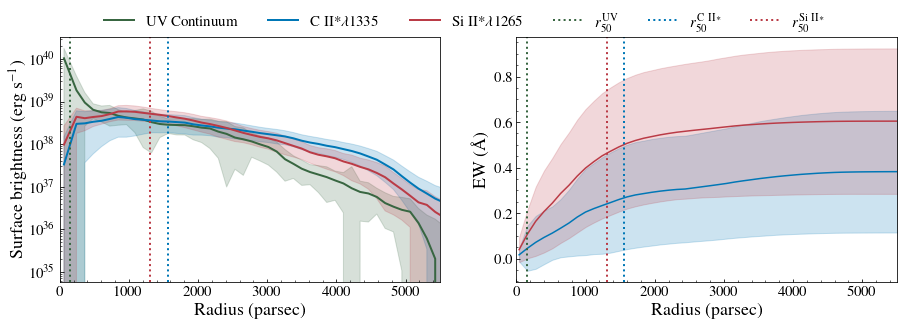

In [19]:


meanrfluxcII = np.nanmedian(rfluxcontcii, axis = 0)
stdrfluxcII = np.nanstd(rfluxcontcii, axis = 0)
stdrfluxcII[(meanrfluxcII-stdrfluxcII)< 0] = stdrfluxcII[(meanrfluxcII-stdrfluxcII)< 0]*0.6
stdrfluxcII = gaussian_filter(stdrfluxcII,sigma = 1)
meantotfcII = np.mean(totalcontcii, axis = 0)

meanrfluxsiII = np.nanmedian(rfluxcontsiii, axis = 0)
stdrfluxsiII = np.nanstd(rfluxcontsiii, axis = 0)
stdrfluxsiII[(meanrfluxsiII-stdrfluxsiII)< 0] = stdrfluxsiII[(meanrfluxsiII-stdrfluxsiII)< 0]*0.6
# stdrfluxsiII = gaussian_filter(stdrfluxsiII,sigma = 1)


meantotfsiII = np.median(totalcontsiii, axis = 0)
r50cii = np.zeros(300)
r50siii = np.zeros(300)
r50fluocii = np.zeros(300)
r50fluosiii = np.zeros(300)


for i in range(300):
    
    xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

    f  = interpolate.interp1d(rrad, rfluxcontcii[i])
    ft = interpolate.interp1d(rrad, totalcontcii[i])
    ynewcii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewcii = ft(xnew) 

    
    f  = interpolate.interp1d(rrad, rfluxcontsiii[i])
    ft = interpolate.interp1d(rrad, totalcontsiii[i])
    ynewsiii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewsiii = ft(xnew) 

    half_fluxcii = np.max(ytnewcii)/2.0
    half_fluxsiii = np.max(ytnewsiii)/2.0

#     print(half_fluxcii,half_fluxsiii)
    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewcii,1) >= half_fluxcii)])
#     r50cii = r50s
    if len(r50s > 1): r50cii[i] = r50s[0]
    else: r50cii[i] = r50s

    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewsiii,1) >= half_fluxsiii)])
#     r50siii = r50s
    if len(r50s > 1): r50siii[i] = r50s[0]
    else: r50siii[i] = r50s
        
        
# FLUO TIME
    xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

    f  = interpolate.interp1d(rrad, rfluxfluocii[i])
    ft = interpolate.interp1d(rrad, totalfluocii[i])
    ynewcii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewcii = ft(xnew) 

    
    f  = interpolate.interp1d(rrad, rfluxfluosiii[i])
    ft = interpolate.interp1d(rrad, totalfluosiii[i])
    ynewsiii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewsiii = ft(xnew) 

    half_fluxcii = np.max(ytnewcii)/2.0
    half_fluxsiii = np.max(ytnewsiii)/2.0

#     print(half_fluxcii,half_fluxsiii)
    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewcii,1) >= half_fluxcii)])
#     r50cii = r50s
    if len(r50s > 1): r50fluocii[i] = r50s[0]
    else: r50fluocii[i] = r50s

    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewsiii,1) >= half_fluxsiii)])
#     r50siii = r50s
    if len(r50s > 1): r50fluosiii[i] = r50s[0]
    else: r50fluosiii[i] = r50s

        

fig, (ax1, ax2) = plt.subplots(1,2,figsize = (15,4.5))
ax1.plot(rrad*(imsize/nxy),meanrfluxsiII,label='UV Continuum', c = '#386641', linewidth = 2)
ax1.fill_between(rrad*(imsize/nxy),meanrfluxsiII+stdrfluxsiII,
                 meanrfluxsiII - stdrfluxsiII, color= '#386641', alpha = 0.2)
ax1.plot(rrad*(imsize/nxy),np.nanmean(rfluxfluocii, axis = 0),label='C II*$\lambda$1335', color = "#0077B6",
         linewidth = 2)
ax1.fill_between(rrad*(imsize/nxy),np.nanmean(rfluxfluocii, axis = 0)+np.nanstd(rfluxfluocii, axis = 0),
                 np.nanmean(rfluxfluocii, axis = 0)- np.nanstd(rfluxfluocii, axis = 0),
                 color = '#0077B6', alpha = 0.2)

ax1.plot(rrad*(imsize/nxy),np.nanmean(rfluxfluosiii, axis = 0),label='Si II*$\lambda$1265',color = "#BA3B46", 
         linewidth = 2)
ax1.fill_between(rrad*(imsize/nxy),np.nanmean(rfluxfluosiii, axis = 0)+np.nanstd(rfluxfluosiii, axis = 0),
                 np.nanmean(rfluxfluosiii, axis = 0) - np.nanstd(rfluxfluosiii, axis = 0),
                                                                 color = '#BA3B46', alpha = 0.2)

ax1.axvline(np.nanmedian(r50siii), label = r'$r_{50}^{\rm UV}$', color = '#386641', linestyle = ':', linewidth = 2 )
ax1.axvline(np.nanmedian(r50fluocii), label = r'$r_{50}^{\rm C\ II*}$', color = '#0077B6', linestyle = ':', linewidth = 2 )
ax1.axvline(np.nanmedian(r50fluosiii), label = r'$r_{50}^{\rm Si\ II*}$', color = '#BA3B46', linestyle = ':', linewidth = 2 )


ax2.plot(np.arange(1,64,1)*120-80, np.mean(EWemiCIIim[:,:], axis =0), color = '#0077B6', label = 'C II* 1335')
# plt.plot(np.arange(1,64,1)*120, np.mean(EWabs[:10,1:], axis =0))
ax2.fill_between(np.arange(1,64,1)*120-80,np.mean(EWemiCIIim[:,:], axis =0)-np.std(EWemiCIIim[:,:], axis =0),
                 np.mean(EWemiCIIim[:,:], axis =0)+np.std(EWemiCIIim[:,:], axis =0), alpha = 0.2, color = '#0077B6')
ax2.plot(np.arange(1,64,1)*120-80, np.mean(EWemiSiIIim[:,:], axis =0), color = '#BA3B46', label = 'Si II* 1265' )
# plt.plot(np.arange(1,64,1)*120, np.mean(EWabs[:10,1:], axis =0))
ax2.fill_between(np.arange(1,64,1)*120-80,np.mean(EWemiSiIIim[:,:], axis =0)-np.std(EWemiSiIIim[:,:], axis =0),
                 np.mean(EWemiSiIIim[:,:], axis =0)+np.std(EWemiSiIIim[:,:], axis =0), alpha = 0.2, color = '#BA3B46')
# plt.subplots_adjust(hspace = 0.1)
# plt.axvline(160, label = r'$r_{50}^{\rm UV}$', color = '#386641', linestyle = ':', linewidth = 2 )
# plt.axvline(1589.5335068817576, label = r'$r_{50}^{\rm C\ II*}$', color = '#0077B6', linestyle = ':', linewidth = 2 )
# plt.axvline(1262, label = r'$r_{50}^{\rm Si\ II*}$', color = '#BA3B46', linestyle = ':', linewidth = 2 )
ax2.axvline(160,  color = '#386641', linestyle = ':', linewidth = 2 )
ax2.axvline(1560, color = '#0077B6', linestyle = ':', linewidth = 2 )
ax2.axvline(1305,color = '#BA3B46', linestyle = ':', linewidth = 2 )

# plt.axvspan(269-297, 269+297,color = 'k',
#            alpha = 0.1)

ax2.set_xlim(0,5500)
ax2.set_xlabel(r'Radius (parsec)', fontsize = 18)
ax2.set_ylabel(r'EW ($\rm \AA$)', fontsize = 18)
# ax2.legend(frameon=False, fontsize = 18, ncol = 1, loc = (0,1))

# plt.axvspan(np.nanmean(r50cii)-np.nanstd(r50cii), np.nanmean(r50cii)+np.nanstd(r50cii),color = 'k',
#            alpha = 0.1)
# plt.axvspan(np.nanmean(r50fluocii)-np.nanstd(r50fluocii), np.nanmean(r50fluocii)+np.nanstd(r50fluocii),color = 'k',
#            alpha = 0.1)
# plt.axvspan(np.nanmean(r50fluosiii)-np.nanstd(r50fluosiii), np.nanmean(r50fluosiii)+np.nanstd(r50fluosiii),color = 'k',
#            alpha = 0.1)
# plt.axvline(np.nanmean(r50opt), label = r'$r_{50}^{\rm Opt}$', color = 'purple', linestyle = ':', linewidth = 2 )

# plt.axvspan(np.nanmean(r50opt)-np.nanstd(r50opt), np.nanmean(r50opt)+np.nanstd(r50opt),color = 'purple',
#            alpha = 0.1)
# plt.axvline(np.mean(r50siii))
ax1.set_yscale('log')
# plt.axvline((imsize/nxy)*r100)

ax1.set_xlabel('Radius (parsec)', fontsize = 18)
ax1.set_ylabel('Surface brightness (erg s$^{-1}$)', fontsize = 18)
ax1.legend(frameon=False, ncol=6, loc = (0.1,1))
ax1.set_xlim(-0,5500)
# plt.savefig('Plots/lightcurves_EWs_dep.pdf', bbox_inches = 'tight')

#### Continuum - 1 pixel

In [12]:
f = ff('./CII_cube_3500A//output.out_cube','r')
nlbda,nxyopt = f.read_ints()
lmin,lmax,imsizeopt = f.read_reals('d')
center = f.read_reals('d')
cubeopt = np.zeros((300 ,nxyopt,nxyopt,nlbda))
cube1 = f.read_reals('d')
cubeopt[0] = cube1.reshape(nxyopt,nxyopt,nlbda)
for j in range(1,300):
    f.read_ints()
    f.read_reals('d')
    f.read_reals('d')
    cube1 = f.read_reals('d')
    cubeopt[j] = cube1.reshape((nxyopt,nxyopt,nlbda))
f.close()

f = ff('./CII_cube_3500A/IC_photons_1000000_nphots','r')
nphot = f.read_ints()[0]
total_lum = f.read_reals()
f.close()

l = np.linspace(lmin,lmax,nlbda)

cubeopt = cubeopt*total_lum/nphot
cubeopt =cubeopt*h_cgs*c_cgs / (l*1e-8)
cubeopt = cubeopt/((lmax-lmin)/nlbda)   


# nxy,imsize,lcubeSiII,cubeSiII = read_cube('./cube_3500A/',300)
print(nxy,nxyopt,imsize,imsizeopt )

64 512 7718.5238573924435 0.00109


In [13]:
## Light curves + spectra in increasing rings
nrad = 50
rrad  = np.zeros(nrad)

rfluxcont = np.zeros((300,nrad))
totalcont= np.zeros((300,nrad))

for idir in range(300):

    imagecontcII = cubeopt[idir,:,:,0]#/ (imsize/nxy)**2 
    y,x = np.where(imagecontcII == np.max(imagecontcII))
    fimagecont = cubeopt[idir,:,:,0].copy()

#     plt.imshow(imagecontcII)
#     plt.scatter(x[0],y[0], c = 'r', s = 100, marker = 'x')
    aperture = CircularAperture([x[0],y[0]], r=8) 
    aperture_masks = aperture.to_mask(method='center') # create mask
    fimagecontap = aperture_masks.multiply(fimagecont)
 
    rrad[0]      = 0.5

    rfluxcont[idir, 0] = np.sum(fimagecontap)
    totalcont[idir, 0] = rfluxcont[idir,0]
#     plt.figure()
#     plt.imshow(fimagecontap)
    # plt.imshow(fimage2)
    for kk in range(1,nrad):
        ppix1 = 8*kk 
        ppix2 = (8*kk+1) 
        aperture2 = CircularAnnulus([x[0],y[0]], r_in=ppix1, r_out=ppix2) 
        aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask
        fimagecontap = aperture_masks2.multiply(fimagecont)
        
        rrad[kk]  = kk + 1
        rfluxcont[idir,kk] = np.sum(fimagecontap)
        totalcont[idir,kk] = totalcont[idir,kk-1] + rfluxcont[idir,kk]



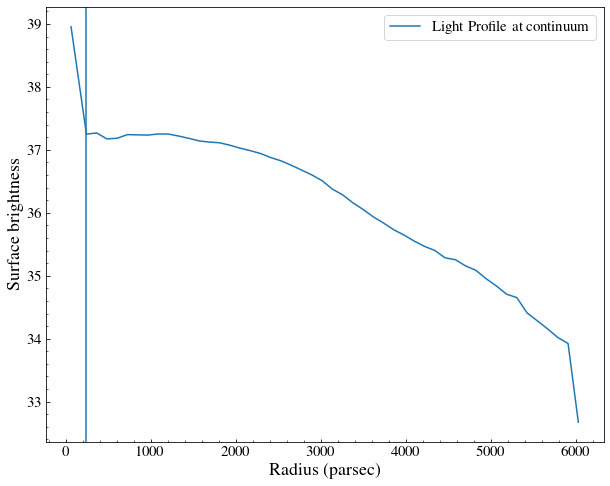

In [14]:
meanrflux = np.nanmedian(rfluxcont, axis = 0)
stdrflux = np.nanstd(rfluxcont, axis = 0)
meantotf = np.nanmedian(totalcont, axis = 0)

xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

f  = interpolate.interp1d(rrad, meanrflux)
ft = interpolate.interp1d(rrad, meantotf)
ynew  = f(xnew)   # use interpolation function returned by `interp1d`
ytnew = ft(xnew)

r50opt = np.zeros(300)

for i in range(300):
    
    xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

    f  = interpolate.interp1d(rrad, rfluxcont[i])
    ft = interpolate.interp1d(rrad, totalcont[i])
    ynew  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnew = ft(xnew) 


    half_fluxopt = (0.95*np.max(ytnew))/2.0

#     print(half_fluxcii,half_fluxsiii)
    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnew,1) >= 0.95*half_fluxopt)])
#     r50cii = r50s
    if len(r50s > 1): r50opt[i] = r50s[0]
    else: r50opt[i] = r50s


# half_fluxopt = np.max(ytnew)/2.0
# print(half_fluxopt)

# r50s = (imsize/nxy)*(xnew[(np.round(ytnew,1) >= half_fluxopt)])
# r50opt = r50s
# if len(r50s > 1): r50opt = r50s[0]

plt.figure(figsize = (10,8))
plt.plot(rrad*(imsize/nxy),np.log10(meanrflux),label='Light Profile at continuum')
plt.axvline(np.mean(r50opt))

# plt.axvline((imsize/nxy)*r100)

plt.xlabel('Radius (parsec)', fontsize = 18)
plt.ylabel('Surface brightness', fontsize = 18)
plt.legend()
# plt.xlim(-10,5500)

In [ ]:
# df = pd.DataFrame(np.vstack((rrad, meanrflux, stdrflux , meantotf)).T) # A is a numpy 2d array
# C=['rrad', 'meanrflux', 'stdrflux',  'meantotf',]
# df.to_csv("csv/Optimage_lightcurve64.csv", sep=',', header= C, index=False) 

df = pd.DataFrame(np.vstack((rrad, meanrflux, stdrflux , meantotf)).T) # A is a numpy 2d array
C=['rrad', 'meanrflux', 'stdrflux',  'meantotf',]
df.to_csv("csv/Optimage_lightcurve512.csv", sep=',', header= C, index=False) 


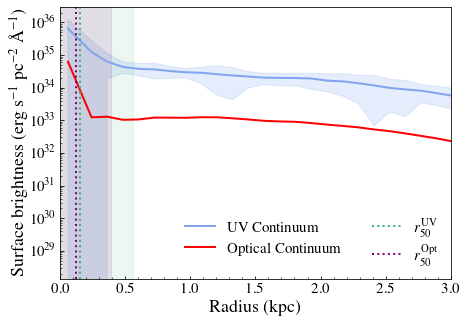

In [26]:
plt.figure(figsize = (7,5))

# df = pd.read_csv('csv/UVimage_lightcurve64_interval.csv')
# meanrfluxsiII = df['meanrcontsiII']
# stdrfluxsiII = df['stdrcontsiII']/(120*120)
plt.plot(rrad*(imsize/nxy)/1000,meanrfluxcII/(120*120),label='UV Continuum', c = cFS, linewidth = 2)
plt.fill_between(rrad*(imsize/nxy)/1000,meanrfluxsiII/(120*120)+stdrfluxsiII/(120*120),
                 meanrfluxsiII/(120*120) - stdrfluxsiII/(120*120), color= cFS, alpha = 0.2)

plt.plot(rrad*(imsize/nxy)/1000,meanrflux/(120*120),label='Optical Continuum', c = 'r', linewidth = 2)
plt.fill_between(rrad*(imsize/nxy),meanrflux/(120*120)+stdrflux/(120*120),
                 meanrflux/(120*120) - stdrflux/(120*120), color= cnoFS, alpha = 0.2)

plt.axvline(np.nanmedian(r50cii)/1000, label = r'$r_{50}^{\rm UV}$', color = 'mediumseagreen', linestyle = ':', linewidth = 2 )

plt.axvspan(np.nanmedian(r50cii)/1000-np.nanstd(r50cii)/1000, np.nanmedian(r50cii)/1000+np.nanstd(r50cii)/1000,color = 'mediumseagreen',
           alpha = 0.1)

plt.axvline(np.nanmedian(r50opt)/1000, label = r'$r_{50}^{\rm Opt}$', color = 'purple', linestyle = ':', linewidth = 2 )

plt.axvspan(np.nanmedian(r50opt)/1000-np.nanstd(r50opt)/1000, np.nanmedian(r50opt)/1000+np.nanstd(r50opt)/1000,color = 'purple',
           alpha = 0.1)
# plt.axvline(np.mean(r50siii))
plt.yscale('log')
# plt.axvline((imsize/nxy)*r100)

plt.xlabel('Radius (kpc)', fontsize = 18)
plt.ylabel('Surface brightness (erg s$^{-1}$ pc$^{-2}$ \AA$^{-1}$)', fontsize = 18)
plt.legend(frameon=False, ncol=2)
plt.xlim(-0,3)
plt.savefig('Plots/compUV_opt.pdf', bbox_inches = 'tight')

# Fitting the classy Spectra

## Fitting single best mock spectra

CII_SiII_depletion/
0 j0021+0052


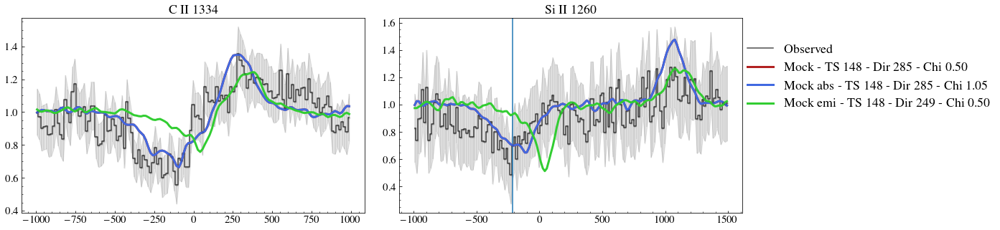

1 j0036-3333


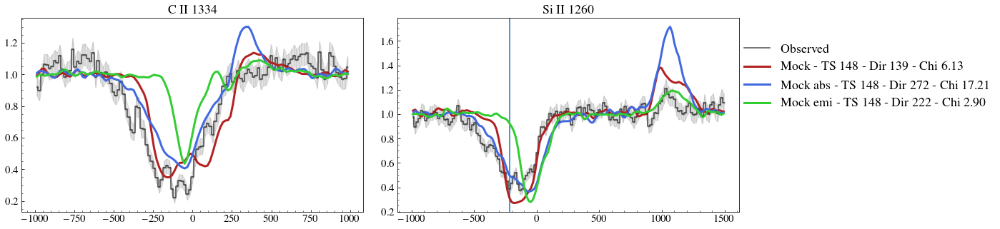

2 j0127-0619


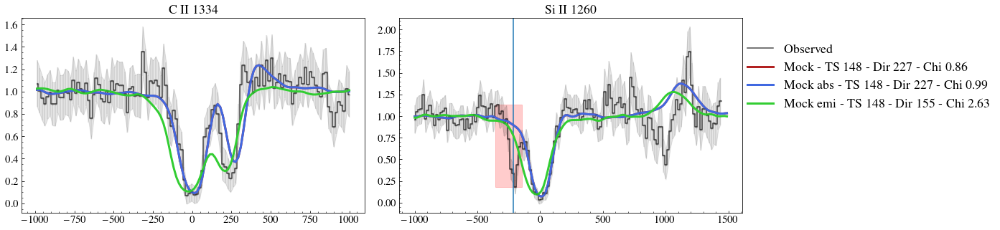

3 j0144+0453


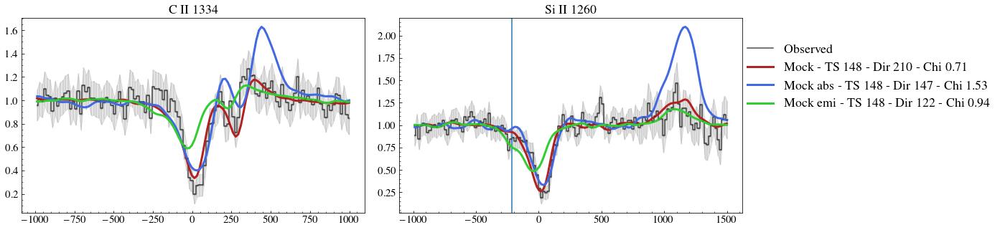

4 j0337-0502


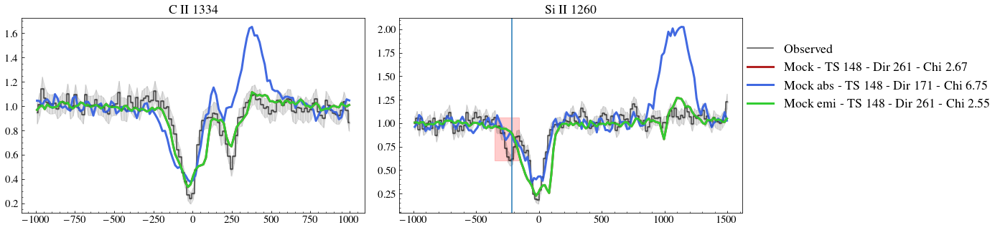

5 j0405-3648


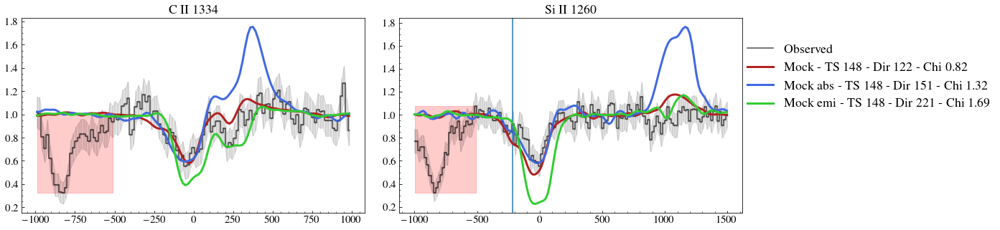

6 j0808+3948


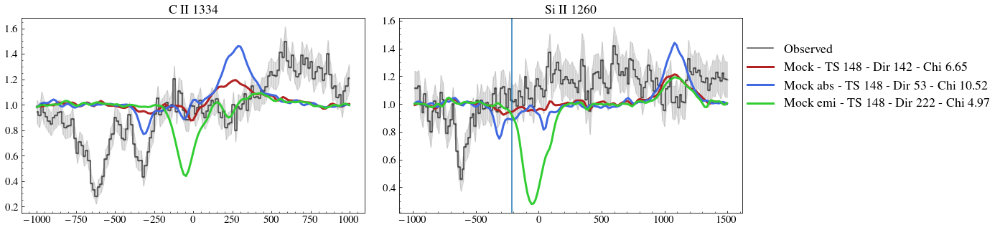

7 j0823+2806


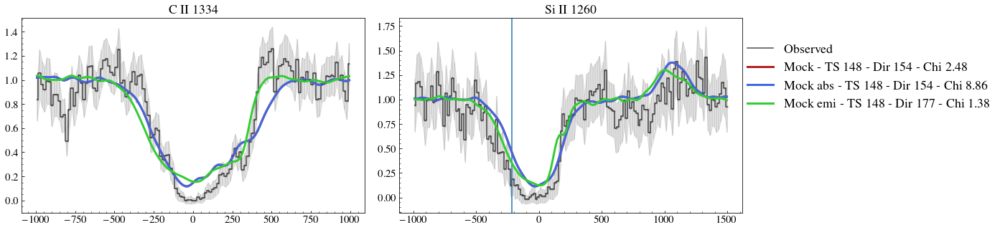

8 j0926+4427


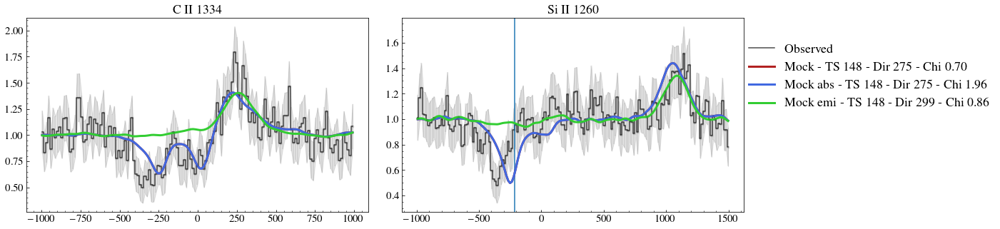

9 j0934+5514


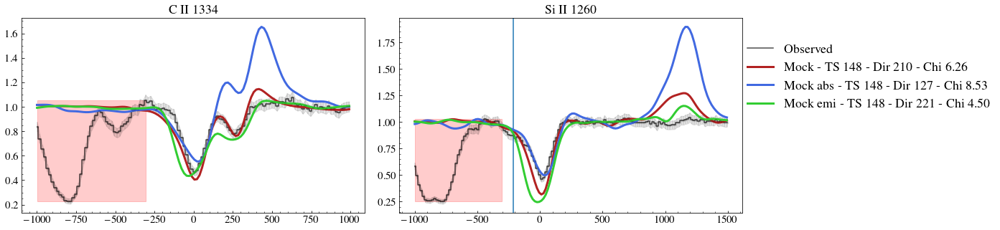

10 j0938+5428


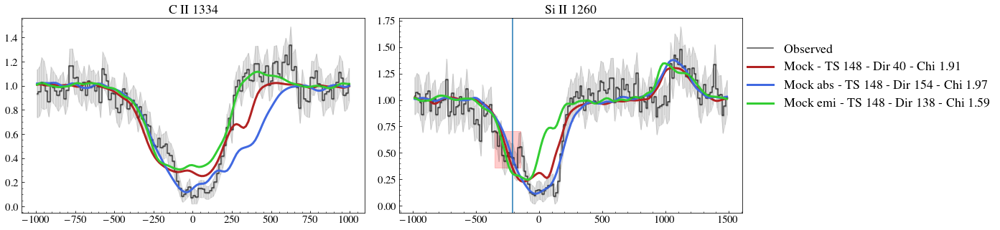

11 j0940+2935


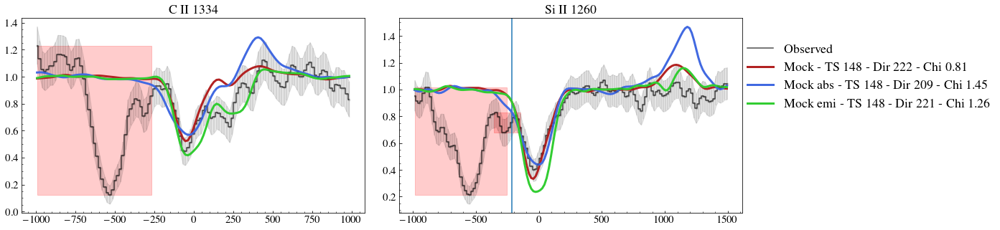

12 j0942+3547


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/1262095042.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/1262095042.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


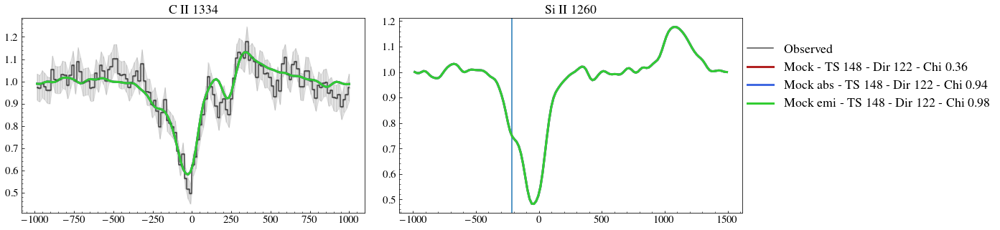

13 j0944-0038


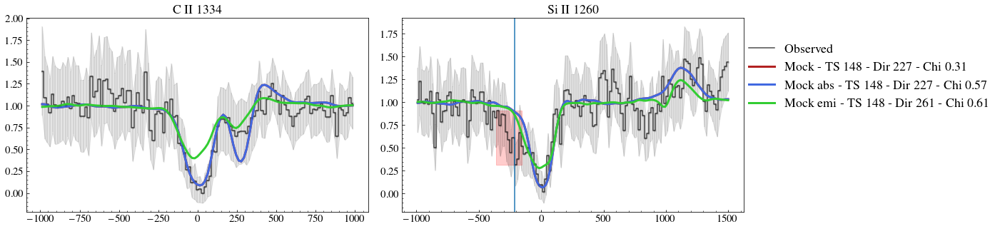

14 j0944+3442


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/1262095042.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/1262095042.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


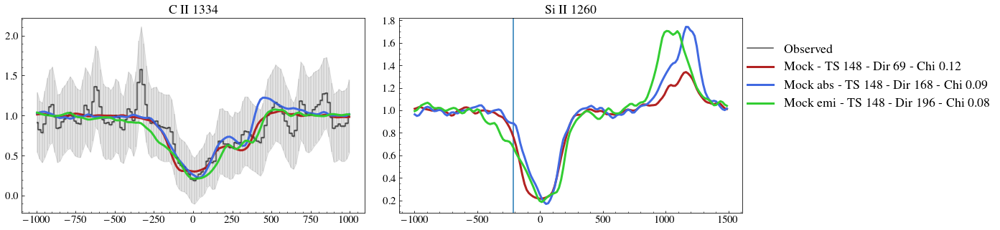

15 j1016+3754


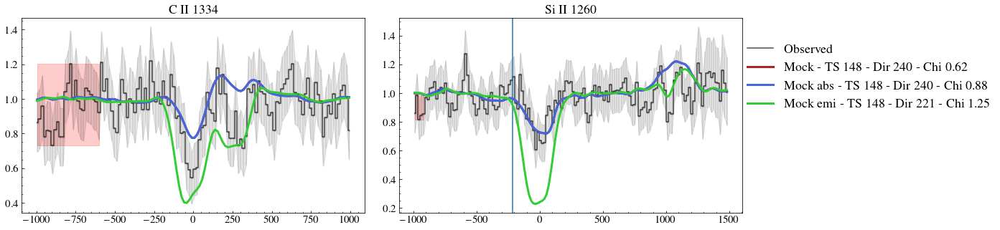

16 j1024+0524


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


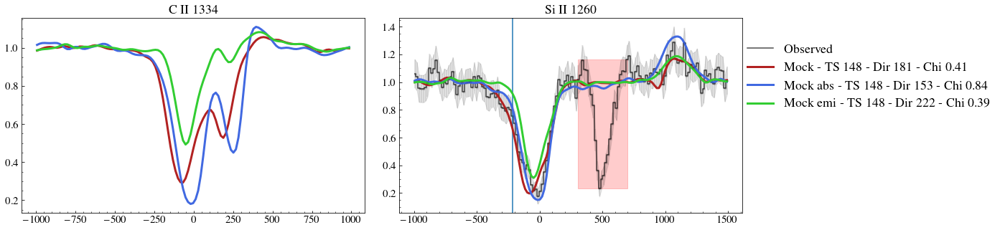

17 j1025+3622


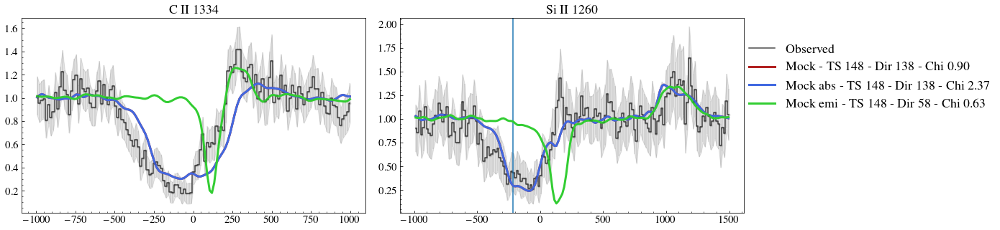

18 j1044+0353


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/1262095042.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/1262095042.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


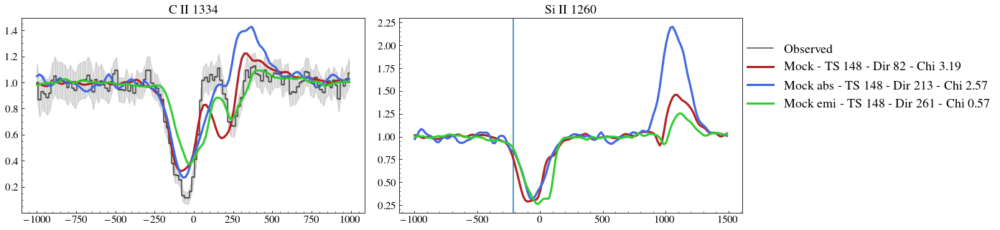

19 j1105+4444


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/1262095042.py:91: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


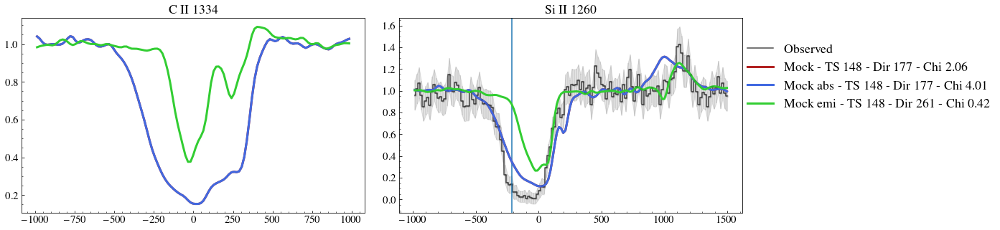

20 j1112+5503


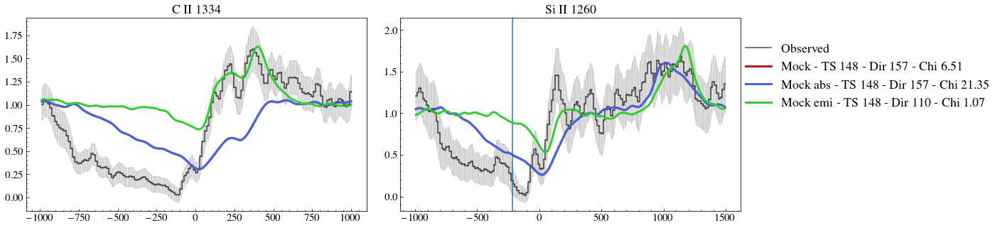

21 j1119+5130


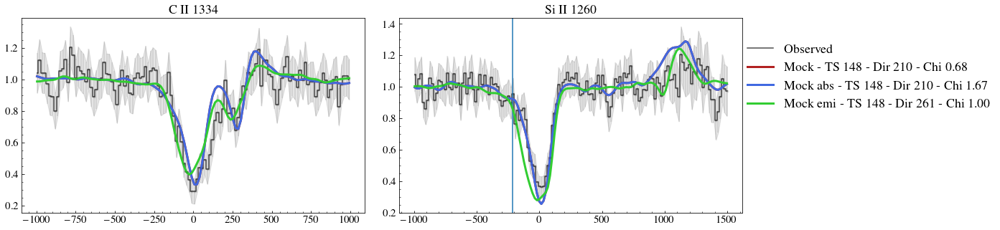

22 j1129+2034


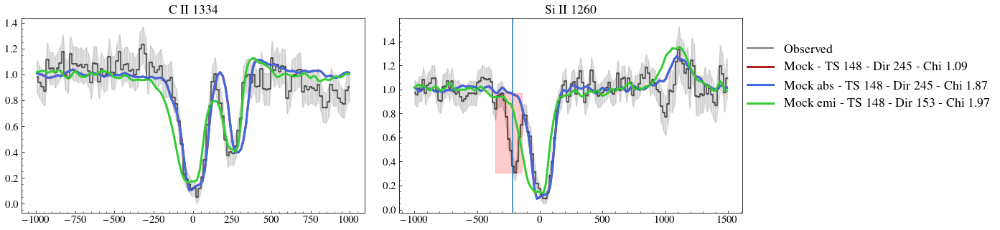

23 j1132+1411


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


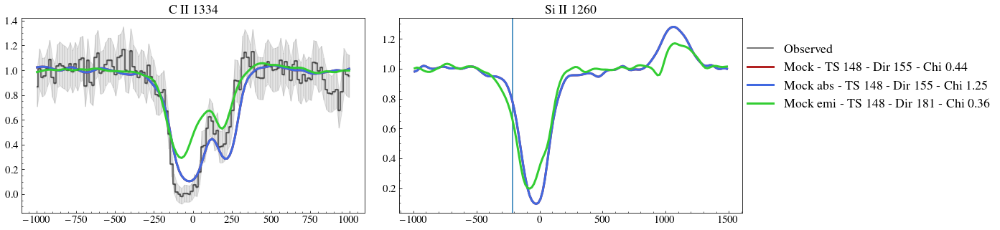

24 j1132+5722


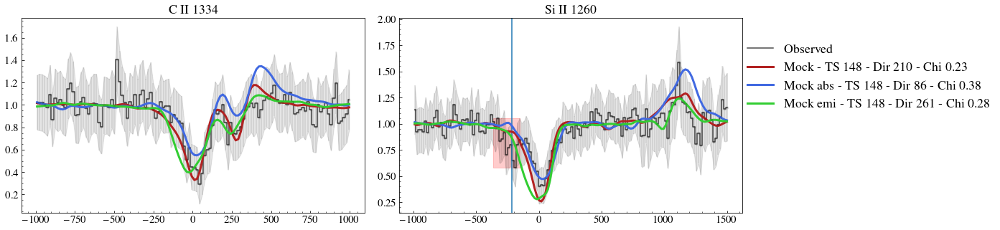

25 j1144+4012


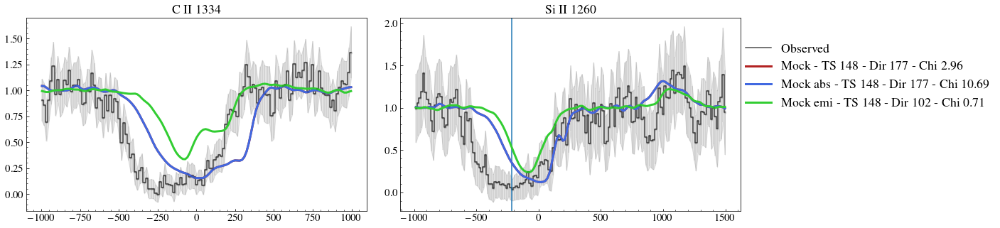

26 j1148+2546


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/1262095042.py:91: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


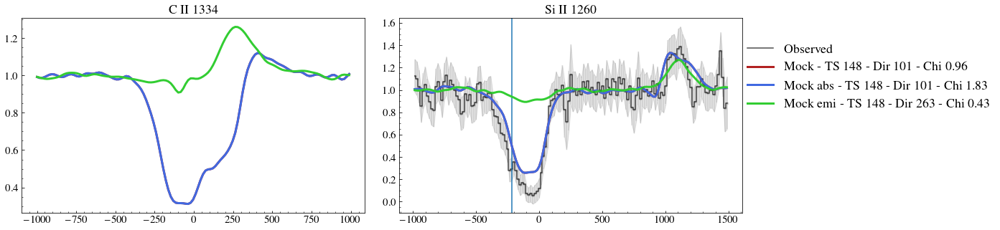

27 j1150+1501


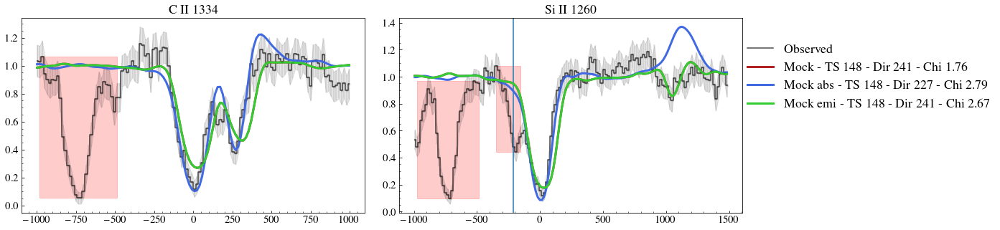

28 j1157+3220


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/1262095042.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/1262095042.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


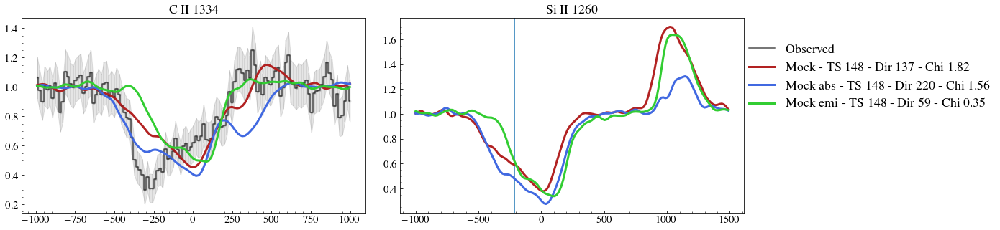

29 j1200+1343


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


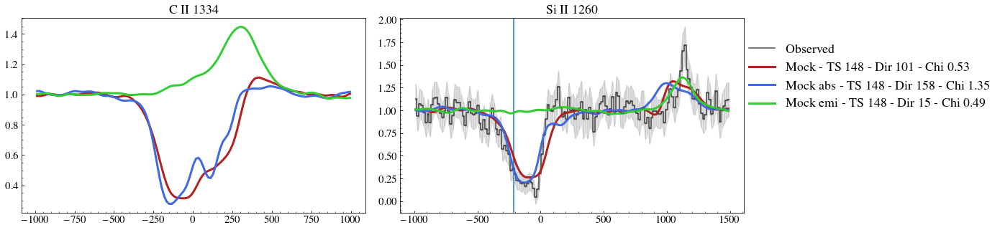

30 j1225+6109


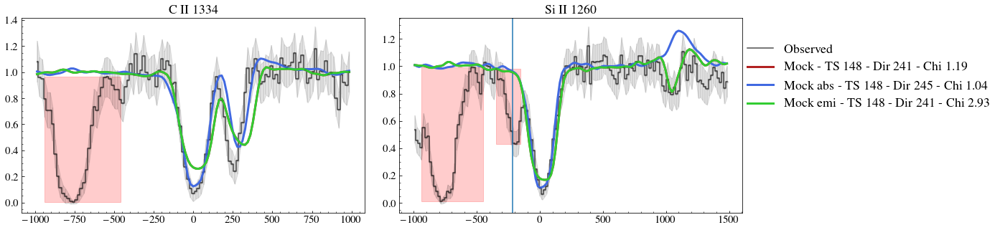

31 j1253-0312


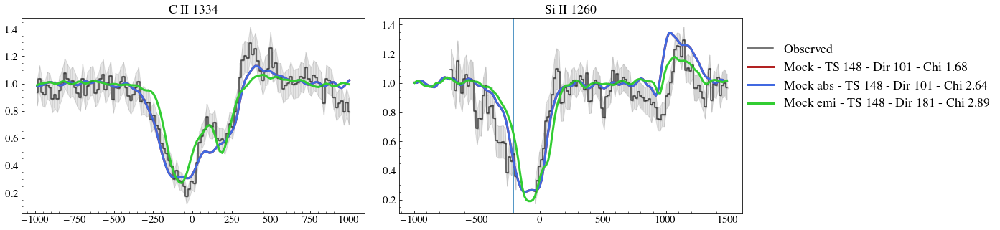

32 j1314+3452


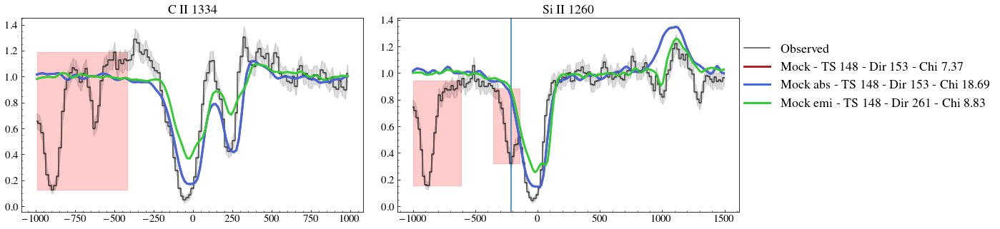

33 j1323-0132


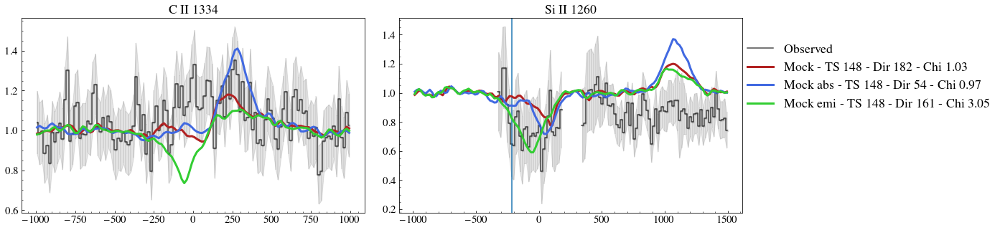

34 j1359+5726


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/1262095042.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/1262095042.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


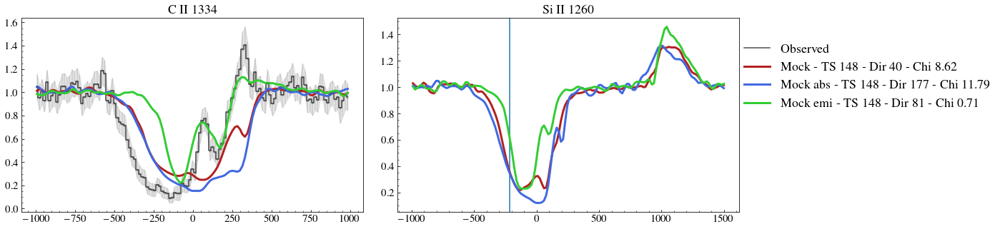

35 j1416+1223


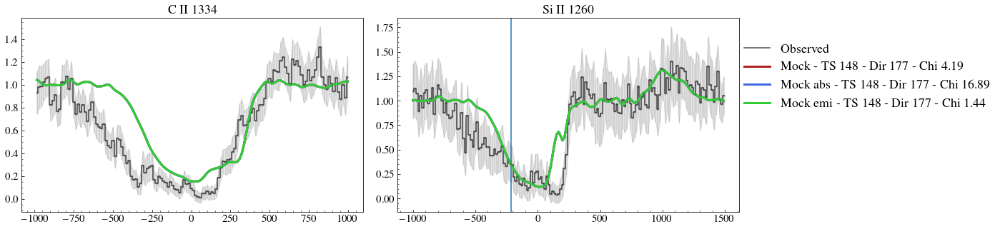

36 j1418+2102


/tmp/ipykernel_1152971/1262095042.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/1262095042.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


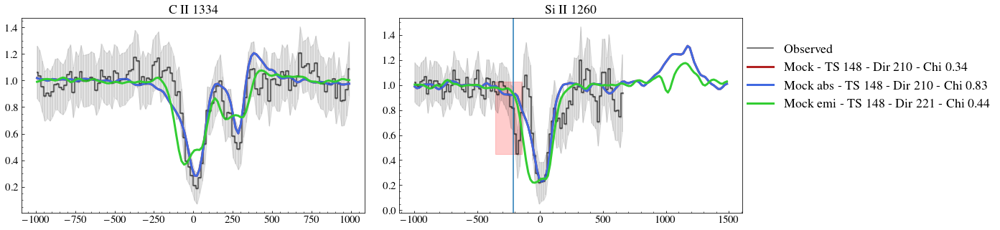

37 j1428+1653


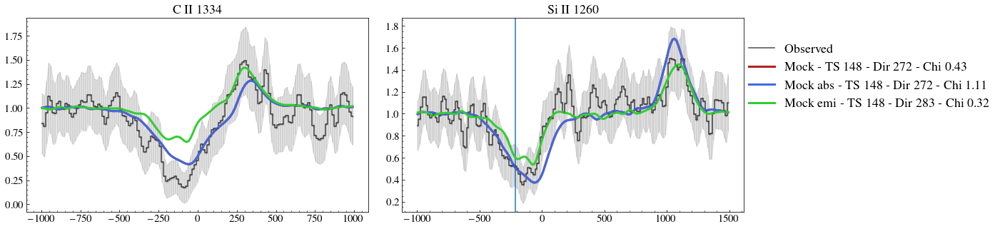

38 j1429+0643


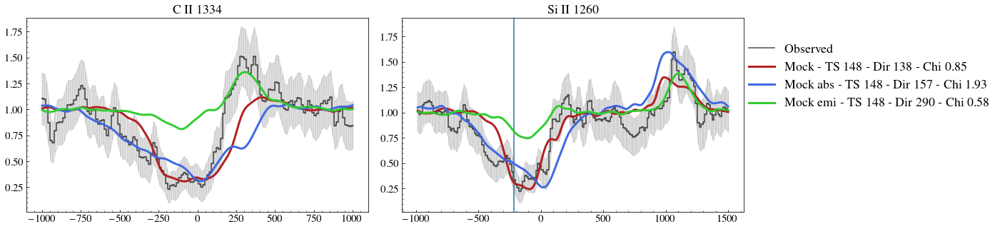

39 j1444+4237


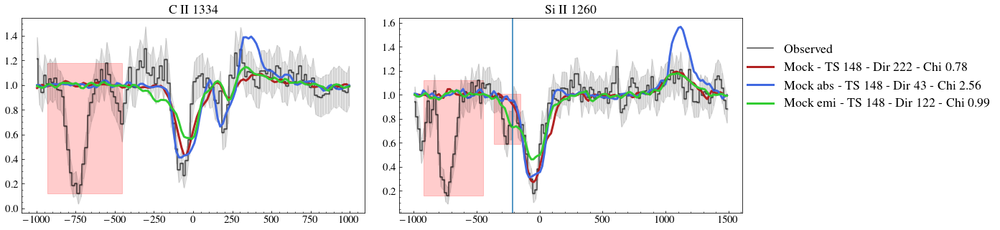

40 j1448-0110


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


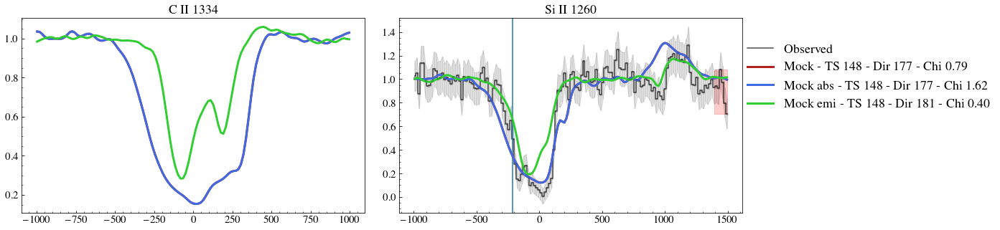

41 j1521+0759


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


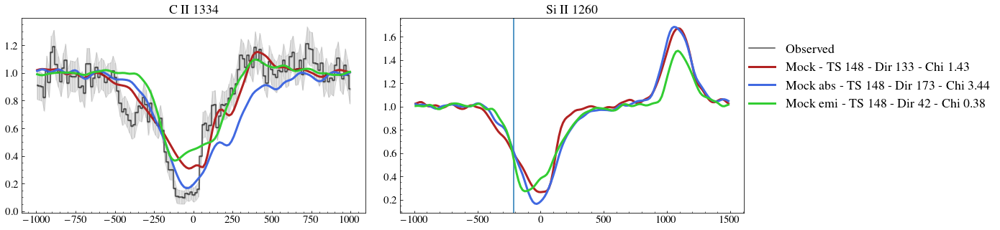

42 j1525+0757


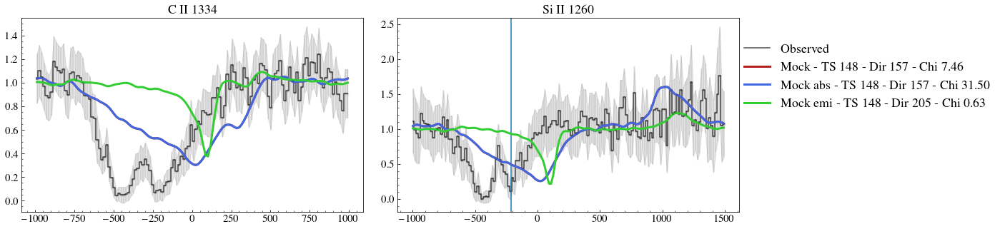

43 j1545+0858


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


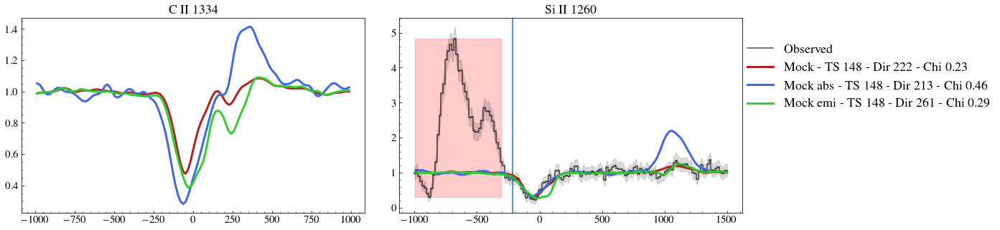

44 j1612+0817


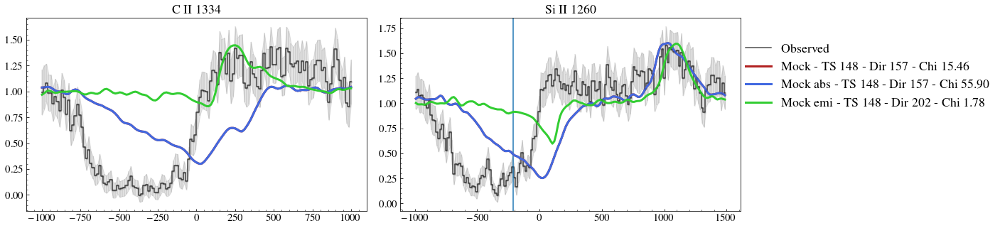

In [6]:
nGal = len(galaxy)
nmocks         = 1
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1

sIIExclude = [2,4,10,11,13,22,24,27,30,32,36,39]
v_cm = np.genfromtxt('./dat_files/vcm_90_164.dat',unpack=True)
path_to_data = path_to_data_arr[3]   # To change if you move the data
print(path_to_data)
for i in range(nGal):
    print(i,label[i])

    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    #fit = gaussian_filter(data['fit'], sigma = 10)
    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

#    absflux = gaussian_filter(data['flux']/data['fit'],sigma = 1)
#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    #absflux /= np.median(absflux[cutSiIIall])
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 500)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])

    if(i == 1):      
        fmedCII /=1.05
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,2,figsize=(18,5))
    #/np.nanmedian(flux[cutCIIall])
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    if(i in sIIExclude):
        axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    axs[1].axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')



    bestfluxsiall = []
    bestfluxciiall = []
    bestfluxsiabs = []
    bestfluxciiabs = []
    bestfluxsiemi = []
    bestfluxciiemi = []
    for output in range(148,149,1):
    
        lcII,  fluxcII  = read_spectrum_c(path_to_data,output) 
        lsiII, fluxsiII = read_spectrum_si(path_to_data,output) 
        
        for idir in range(300):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lcII) 
            lcII_systemic = lcII_systemic[1:]
            vcII_s    = (lcII_systemic/wcII1334 -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lsiII) 
            lsiII_systemic = lsiII_systemic[1:]
            vsiII_s  = (lsiII_systemic/wsiII1260 -1)*c

            sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
            sigma_pixelsiII = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50]- vsiII_s[49]))

            modelcII    = gaussian_filter(fluxcII[idir,1:], sigma = sigma_pixelcII)
            f           = interpolate.interp1d(vcII_s, modelcII)
            modelNewcII = f(vcII)

            modelsiII   = gaussian_filter(fluxsiII[idir,1:], sigma = sigma_pixelsiII)
            f           = interpolate.interp1d(vsiII_s, modelsiII)
            modelNewsiII= f(vsiII)

#             alpha = np.nansum((modelNewcII[maskCII]*fcII[maskCII]/(ecII[maskCII]**2)))/ \
#                     np.nansum(modelNewcII[maskCII]**2/ecII[maskCII]**2)
#             modelNewcII *= alpha
            
#             alpha = np.nansum((modelNewsiII[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsiII[maskSiII]**2/esiII[maskSiII]**2)
# #             print(alpha)
#             modelNewsiII *= alpha
            
            rmedCII = ((vcII<-500) | (vcII > 700)) 
            fmedCII = np.nanmedian(modelNewcII[rmedCII])
            modelNewcII /= fmedCII

            rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
            fmedSiII = np.nanmedian(modelNewsiII[rmedSiII])
            modelNewsiII /= fmedSiII
            
            maskCII = maskCII & (vcII >-700) & (vcII < 700)
            maskSiII = maskSiII & (vsiII > - 700)  & (vsiII < 1500)
            if(i in sIIExclude):
                maskSiII = maskSiII & (~((vsiII >-364) & (vsiII <-144)))
            if(len(ecII[maskCII]) > 0):
                lnlikecII  =  np.nansum(((fcII[maskCII]-modelNewcII[maskCII])**2)/ecII[maskCII]**2) #/len(ecII[maskCII])
                ncII = len(fcII[maskCII])
            else:
                lnlikecII = 0
                ncII = 0
            if(len(esiII[maskSiII]) > 0):
                lnlikesiII =  np.nansum(((fsiII[maskSiII] - modelNewsiII[maskSiII])**2)/esiII[maskSiII]**2)#/len(esiII[maskSiII])
                nsiII = len(fsiII[maskSiII])               
            else:
                lnlikesiII = 0
                nsiII = 0
#             print(lnlikesiII)
            if(np.isnan(lnlikesiII)):
                lnlikesiII = 0
                nsiII = 0
            if(np.isnan(lnlikecII)):
                lnlikecII = 0
                ncII = 0
            lnlikeall  = (lnlikecII + lnlikesiII)/(ncII + nsiII)
                   
#             if lnlikecII < Chi2cII[i][0] :
#                 Chi2cII[i][0] = lnlikecII
#                 dircII[i][0]  = idir
#                 outcII[i][0]  = output
            
#             if lnlikesiII < Chi2siII[i][0] :
#                 Chi2siII[i][0] = lnlikesiII
#                 dirsiII[i][0]  = idir
#                 outsiII[i][0]  = output
                
            if(lnlikeall < Chi2all[i][0]):
                dirall[i][0] = idir
                Chi2all[i][0] = lnlikeall
                outall[i][0] = output
                bestfluxsiall = modelNewsiII
                bestfluxciiall = modelNewcII
                
            absMaskCII = (vcII > -600) & (vcII < 200) & maskCII
            absMaskSiII =  (vsiII > -600) & (vsiII < 200) & maskSiII
            if(len(ecII[absMaskCII]) > 0):
                lnlikecII  =  np.nansum(((fcII[absMaskCII]-modelNewcII[absMaskCII])**2)/ecII[absMaskCII]**2) /len(ecII[absMaskCII])
            else:
                lnlikecII = 0
            if(len(esiII[absMaskSiII]) > 0):
                lnlikesiII =  np.nansum(((fsiII[absMaskSiII] - modelNewsiII[absMaskSiII])**2)/esiII[absMaskSiII]**2)/len(esiII[absMaskSiII])
            else:
                lnlikesiII = 0
            lnlikeall  = lnlikecII + lnlikesiII
                   

                
            if(lnlikeall < Chi2allabs[i][0]):
                dirallabs[i][0] = idir
                Chi2allabs[i][0] = lnlikeall
                outallabs[i][0] = output
                bestfluxsiabs = modelNewsiII
                bestfluxciiabs = modelNewcII
                
            emiMaskCII = (vcII > 150 ) & maskCII & (vcII <700)
            emiMaskSiII = (vsiII > 700) & maskSiII & (vsiII <1500)
            if(len(ecII[emiMaskCII]) > 0):
                lnlikecII  =  np.nansum(((fcII[emiMaskCII]-modelNewcII[emiMaskCII])**2)/ecII[emiMaskCII]**2) /len(ecII[emiMaskCII])

            else:
                lnlikecII = 0
            if(len(esiII[emiMaskSiII]) > 0):
                lnlikesiII =  np.nansum(((fsiII[emiMaskSiII] - modelNewsiII[emiMaskSiII])**2)/esiII[emiMaskSiII]**2)/len(esiII[emiMaskSiII])

            else:
                lnlikesiII = 0

            lnlikeall  = lnlikecII + lnlikesiII
                   
#             if lnlikecII < Chi2cIIemi[i][0] :
#                 Chi2cIIemi[i][0] = lnlikecII
#                 dircIIemi[i][0]  = idir
#                 outcIIemi[i][0]  = output
            
#             if lnlikesiII < Chi2siIIemi[i][0] :
#                 Chi2siIIemi[i][0] = lnlikesiII
#                 dirsiIIemi[i][0]  = idir
#                 outsiIIemi[i][0]  = output
                
            if(lnlikeall < Chi2allemi[i][0]):
#                 print(lnlikeall,lnlikecII,lnlikesiII)
                dirallemi[i][0] = idir
                Chi2allemi[i][0] = lnlikeall
                outallemi[i][0] = output
                bestfluxsiemi = modelNewsiII
                bestfluxciiemi = modelNewcII

    axs[0].plot(vcII, bestfluxciiall,
                label = 'Mock  - TS %d - Dir %d - Chi %.2f'%(outall[i][0], dirall[i][0], 
                                                             Chi2all[i][0]),
                c ='Firebrick', lw = 3)
    axs[0].plot(vcII, bestfluxciiabs, 
                label = 'Mock abs - TS %d - Dir %d - Chi %.2f'%(outallabs[i][0], dirallabs[i][0],
                                                                Chi2allabs[i][0]), 
                c ='Royalblue', lw = 3)
    axs[0].plot(vcII, bestfluxciiemi, 
                label = 'Mock emi  - TS %d - Dir %d - Chi %.2f'%(outallemi[i][0], dirallemi[i][0],
                                                                 Chi2allemi[i][0]),
                c ='limegreen', lw = 3)
#     print(fesc[148-90,int(dirall[i][0])])
    
    axs[1].plot(vsiII, bestfluxsiall, c ='Firebrick', lw = 3)
    axs[1].plot(vsiII, bestfluxsiabs, c ='Royalblue', lw = 3)
    axs[1].plot(vsiII, bestfluxsiemi, c ='limegreen', lw = 3)
#     axs[1].yticks
    axs[0].legend(frameon=False, ncol = 1, loc =(2.1,0.5), fontsize = 18)
    plt.subplots_adjust(wspace = 0.1)
#     plt.suptitle(label[i])
#     plt.show()
#     plt.savefig('Plots/'+galaxy[i]+'matchdepletion.pdf', bbox_inches = 'tight')
    plt.show()

In [7]:
df = pd.DataFrame(np.vstack((galaxy,outall[:,0].astype(int), dirall[:,0].astype(int),Chi2all[:,0],
                            outallabs[:,0].astype(int), dirallabs[:,0].astype(int) ,Chi2allabs[:,0],
                            outallemi[:,0].astype(int), dirallemi[:,0].astype(int) ,Chi2allemi[:,0])).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputAbs','DirAbs', 'x2Abs','OutputEmi','DirEmi', 'x2Emi']
# noFS, FS, ND, dep
df.to_csv(f"csv/Classy_dep_fit_148.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

## Fitting 10 best spectra

j0021+0052


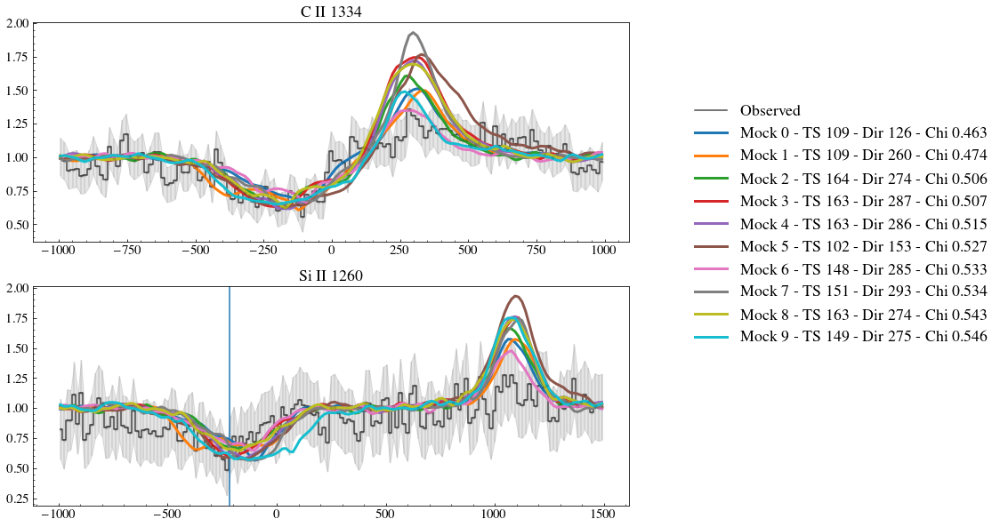

j0036-3333


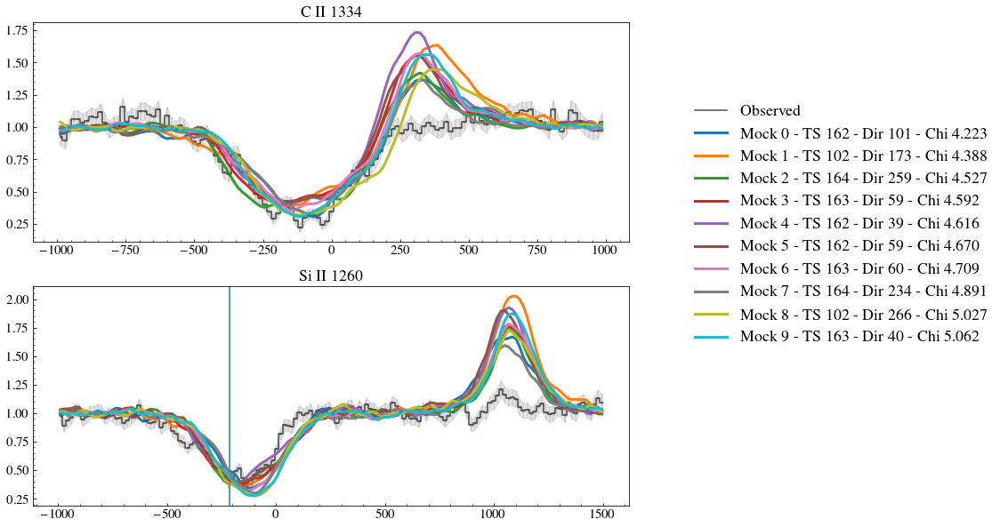

j0127-0619


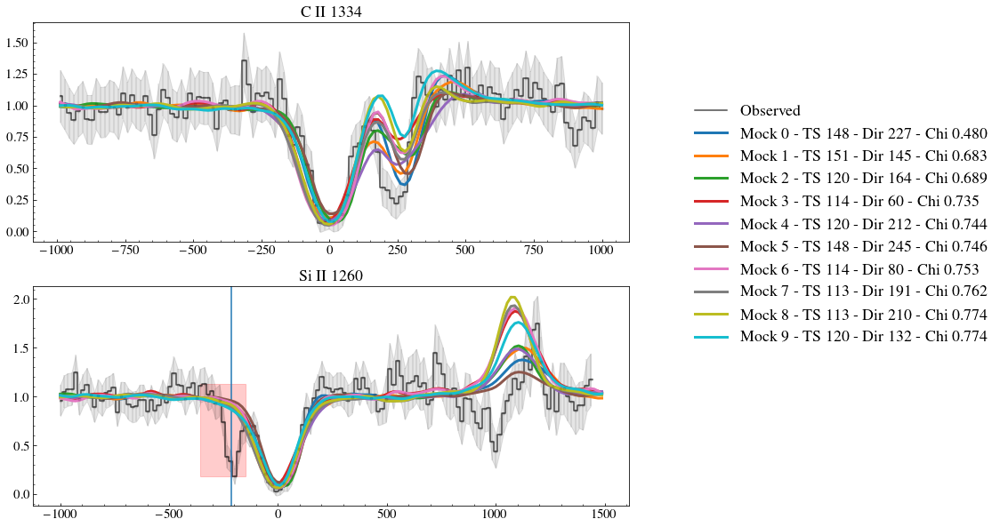

j0144+0453


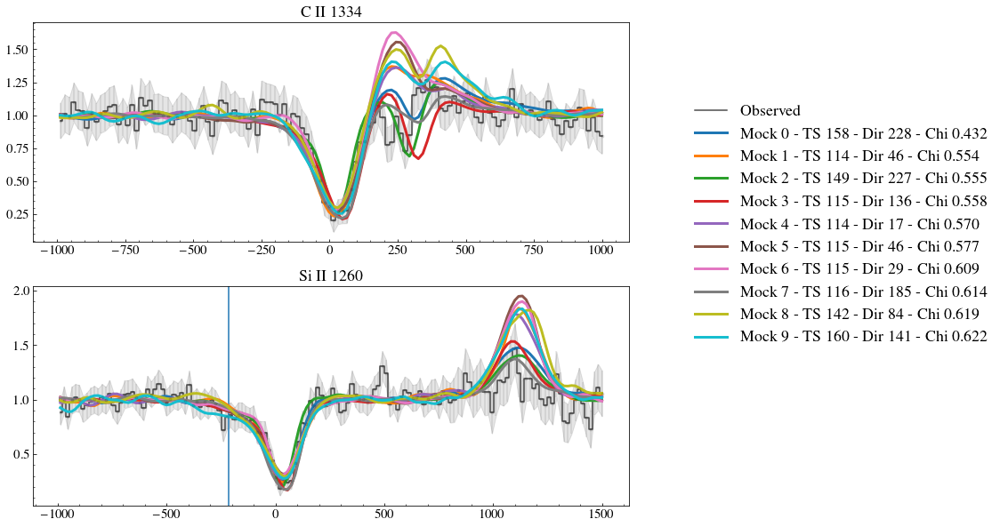

j0337-0502


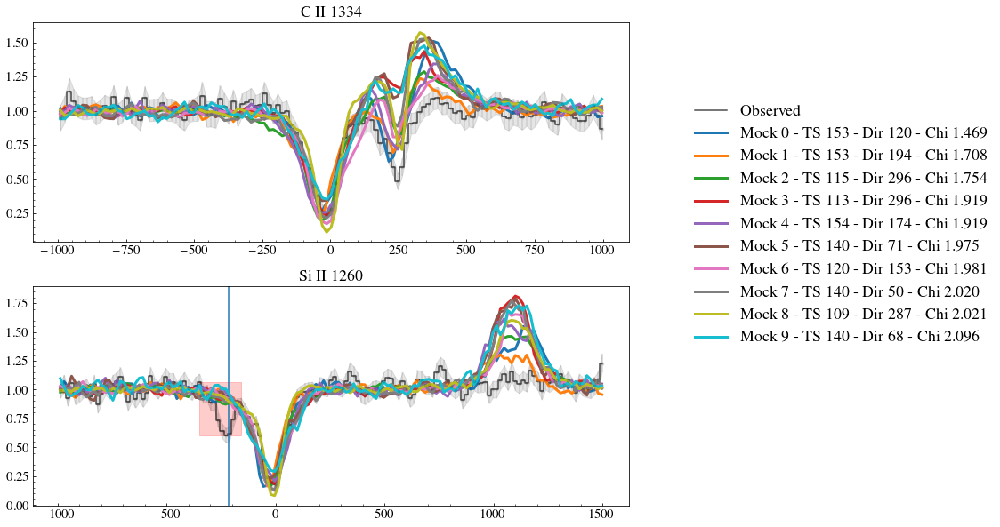

j0405-3648


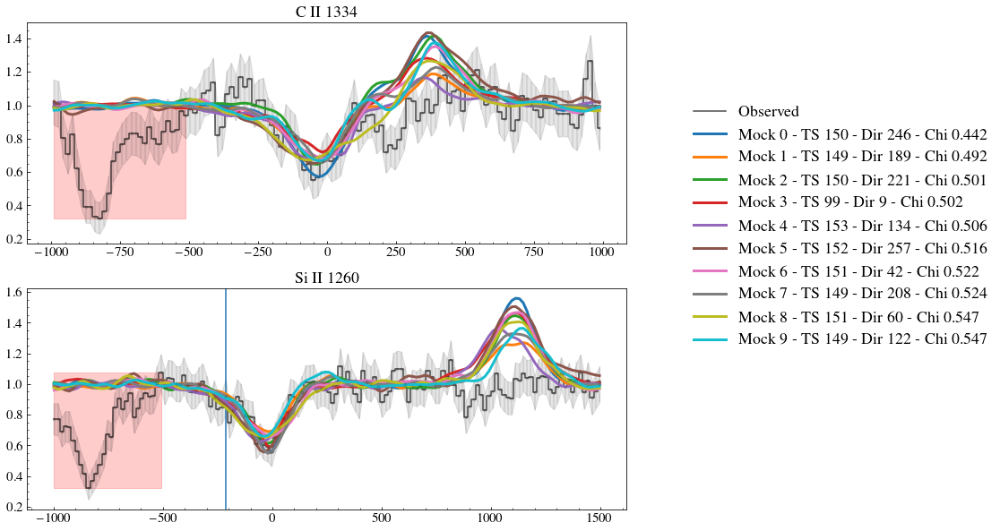

j0808+3948


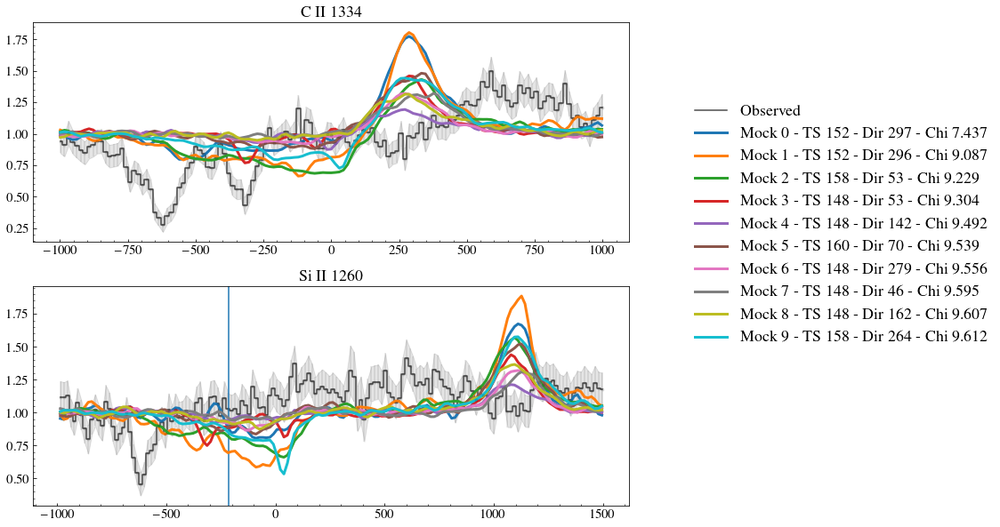

j0823+2806


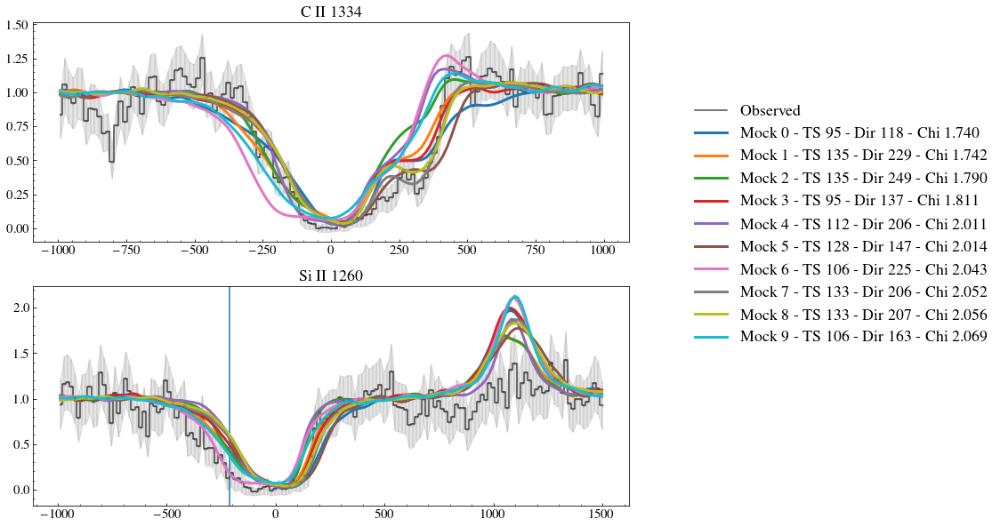

j0926+4427


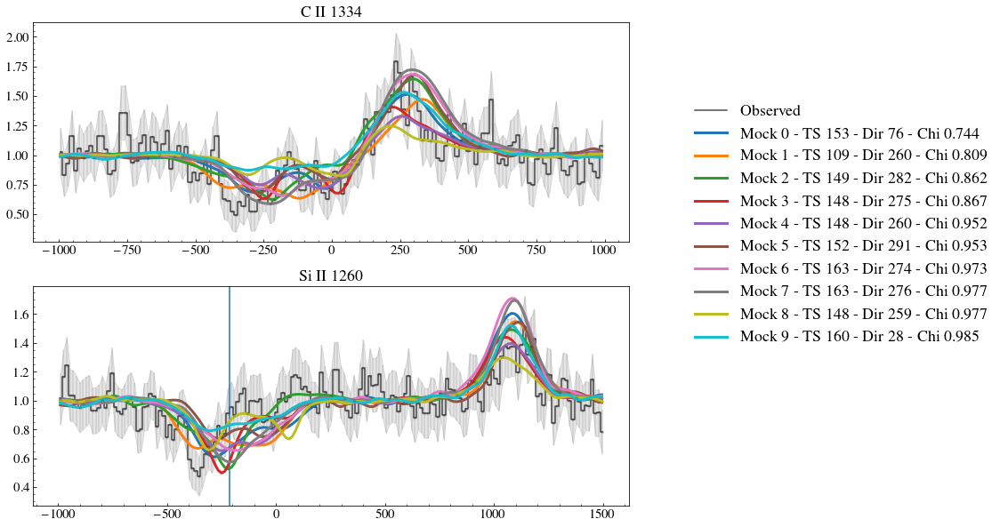

j0934+5514


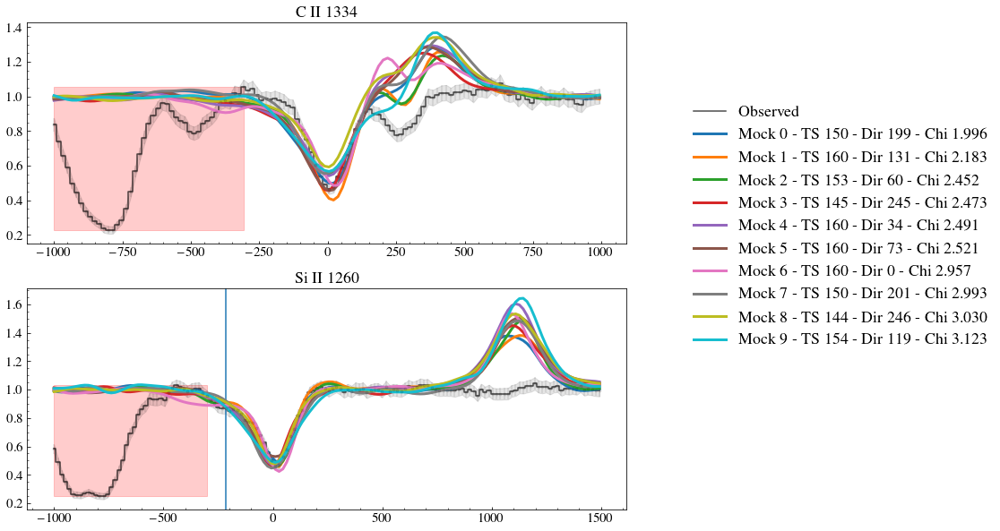

j0938+5428


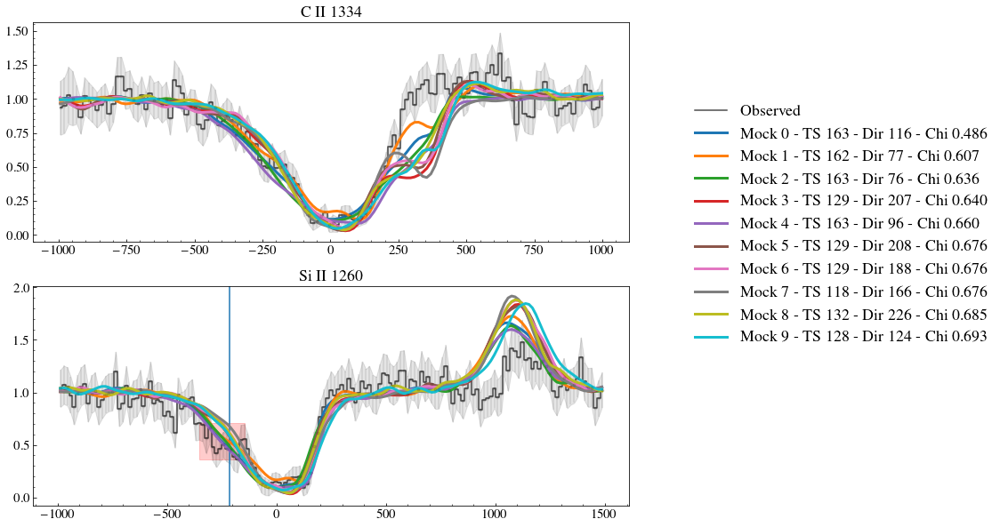

j0940+2935


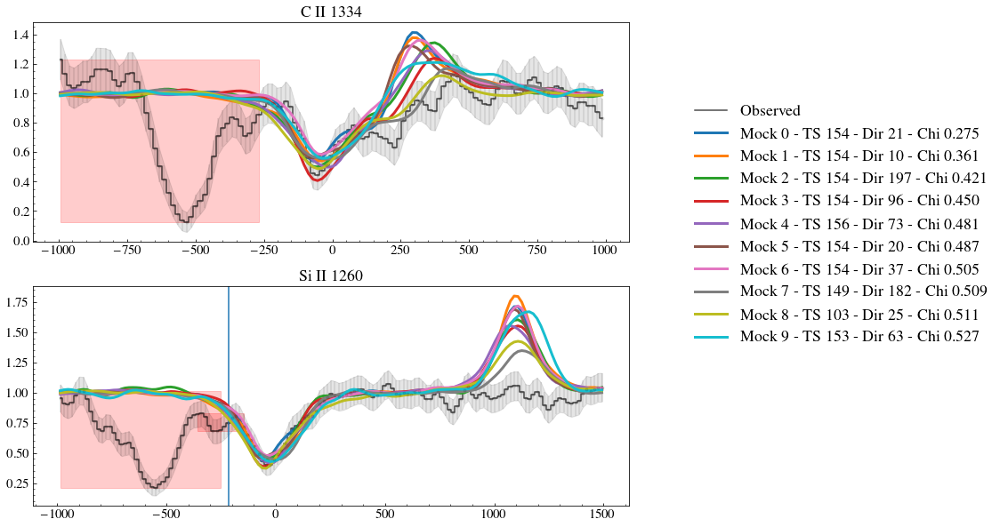

j0942+3547


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/3977829443.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/3977829443.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


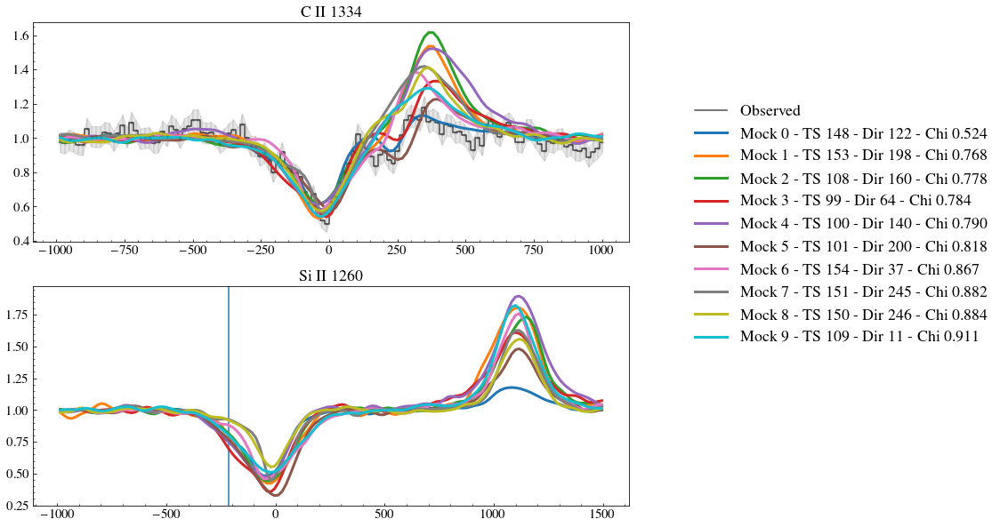

j0944-0038


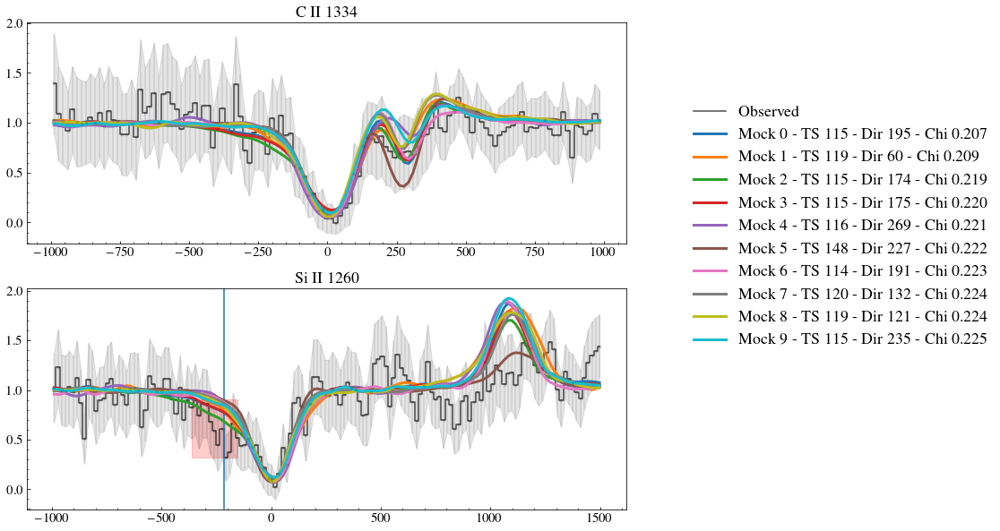

j0944+3442


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/3977829443.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/3977829443.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


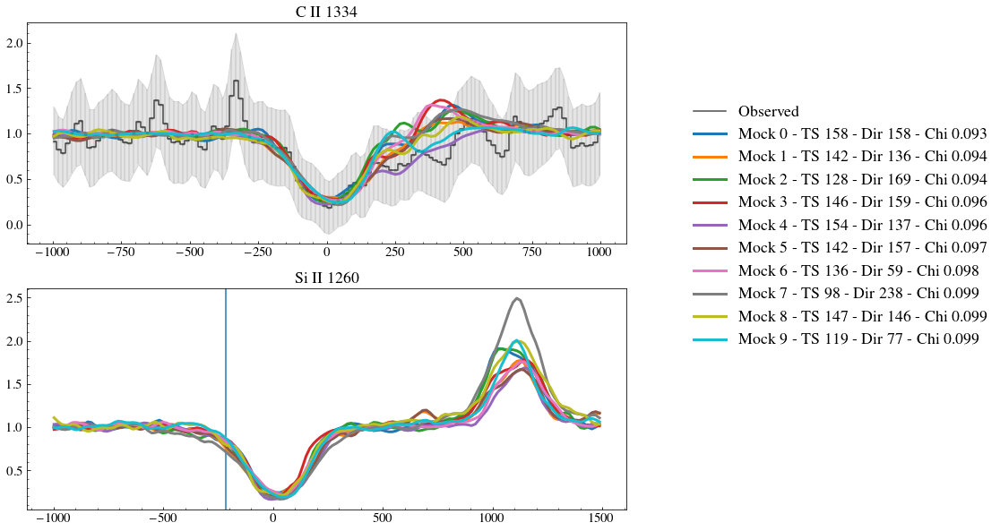

j1016+3754


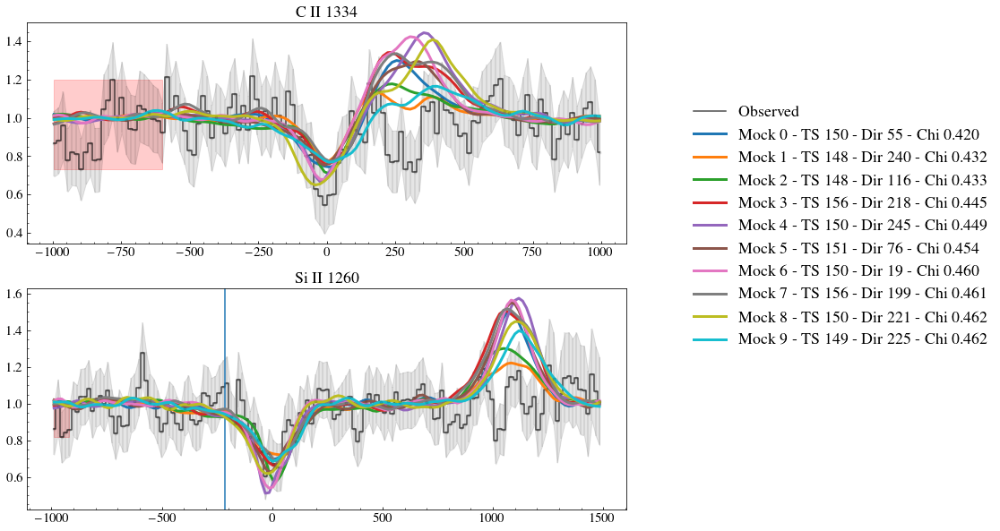

j1024+0524


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


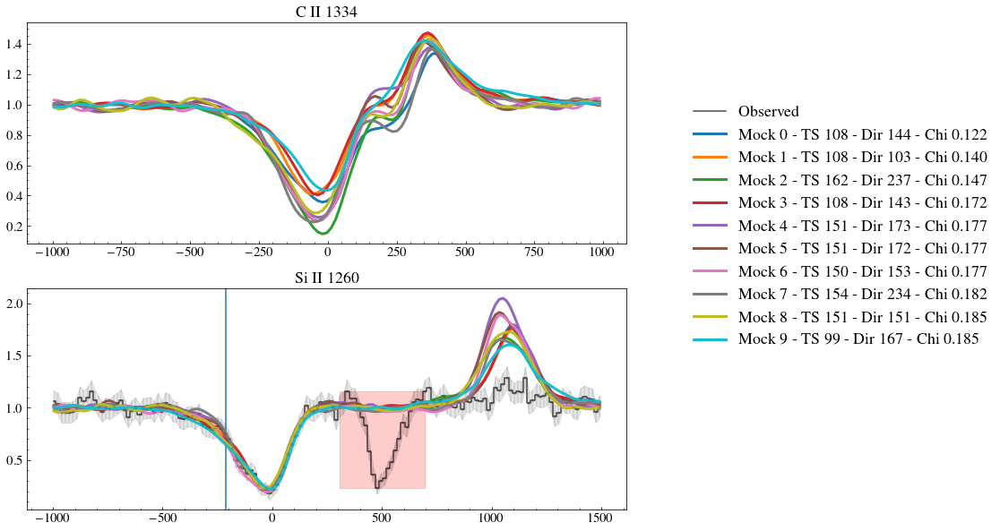

j1025+3622


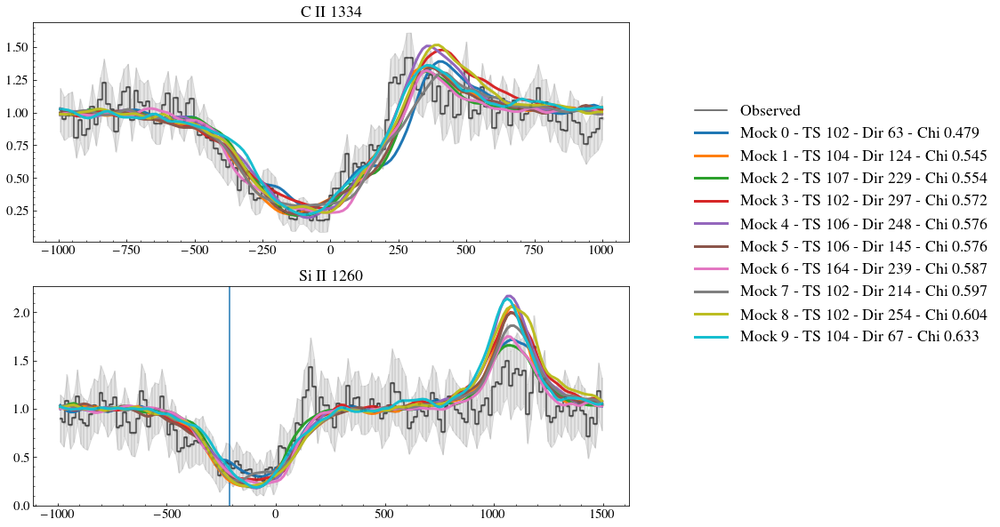

j1044+0353


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/3977829443.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/3977829443.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


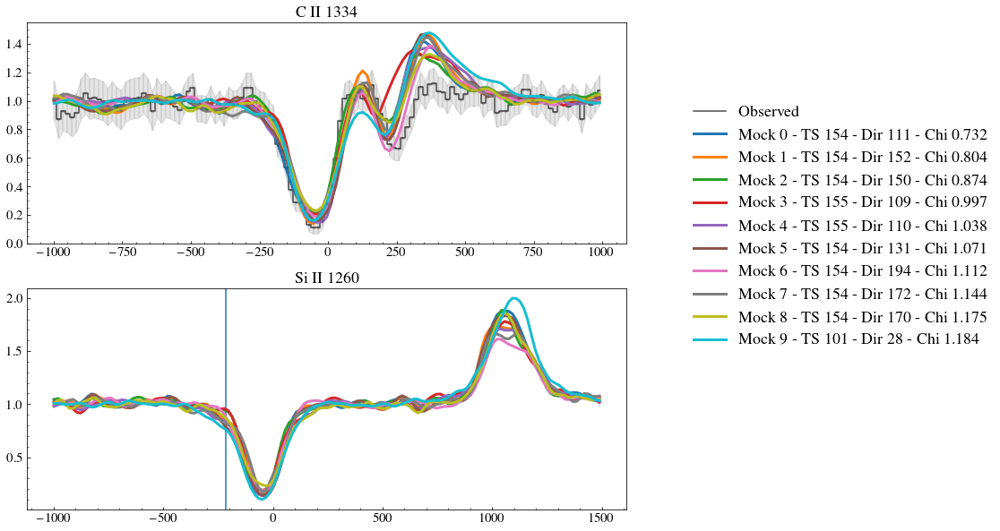

j1105+4444


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/3977829443.py:91: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


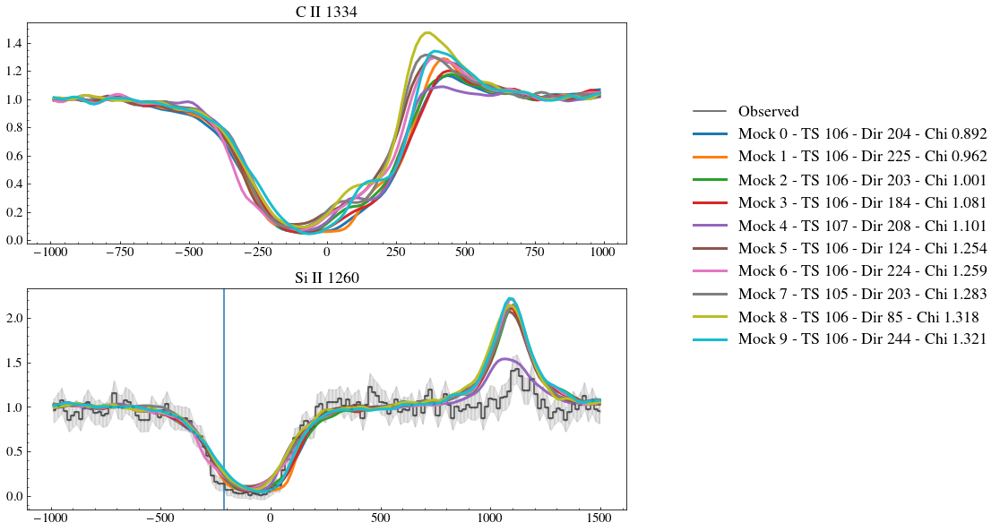

j1112+5503


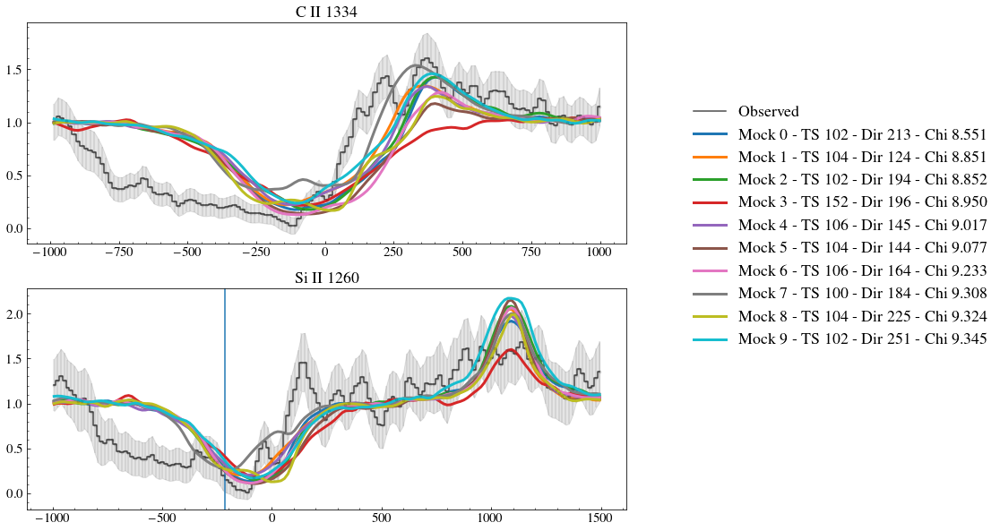

j1119+5130


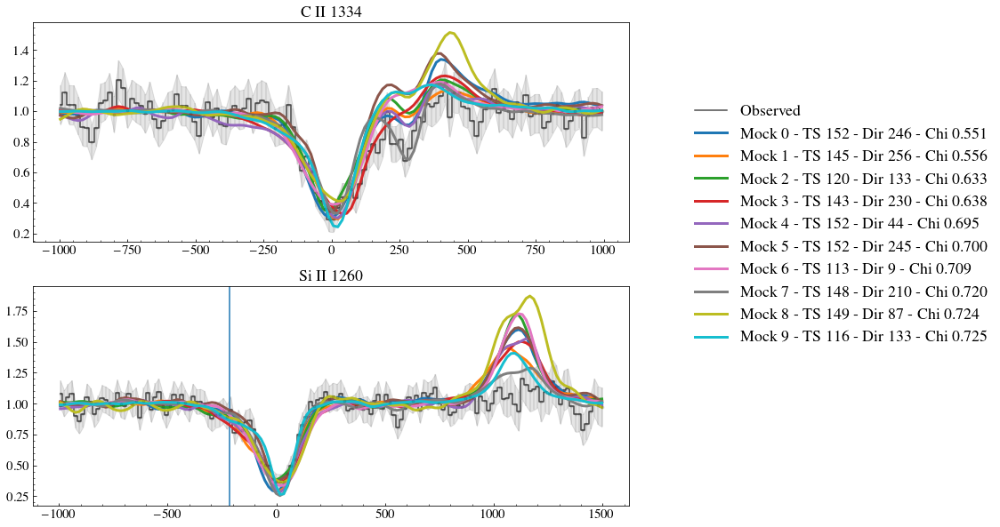

j1129+2034


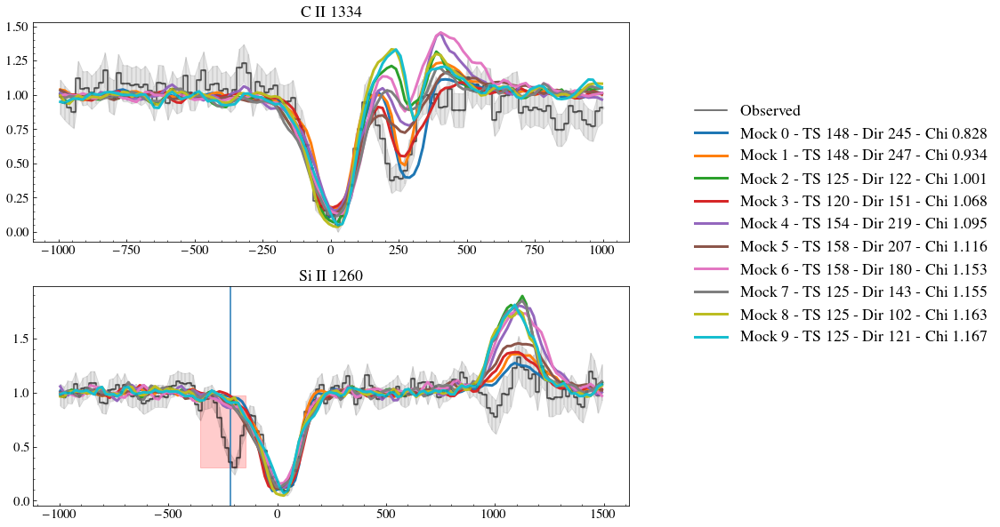

j1132+1411


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


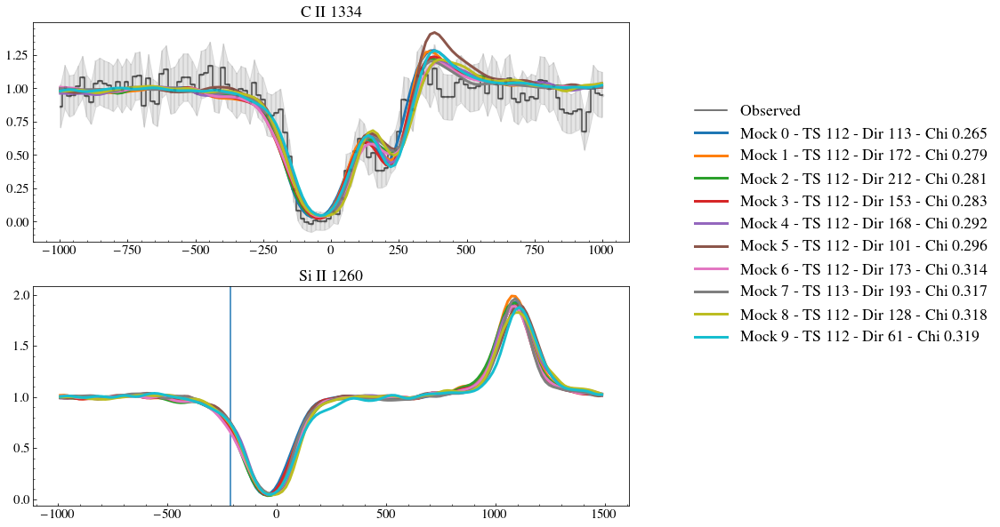

j1132+5722


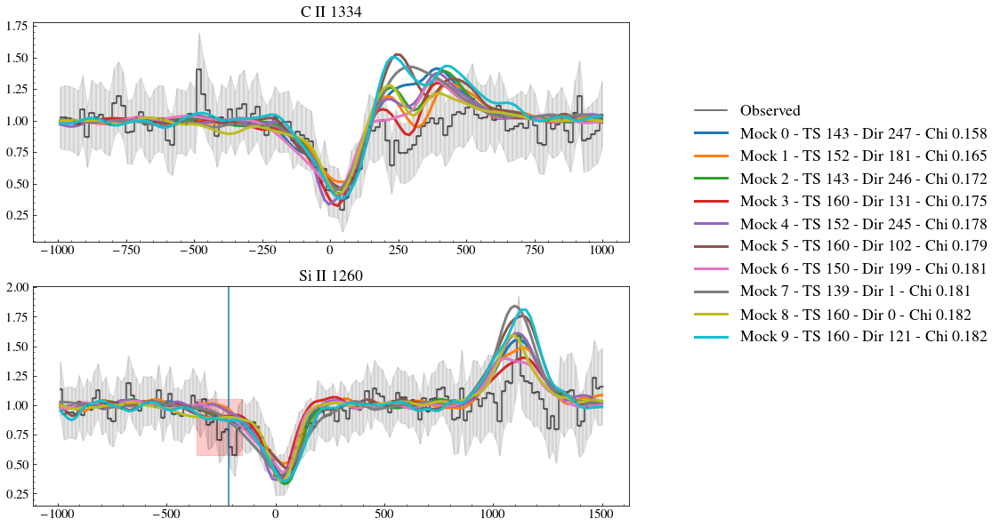

j1144+4012


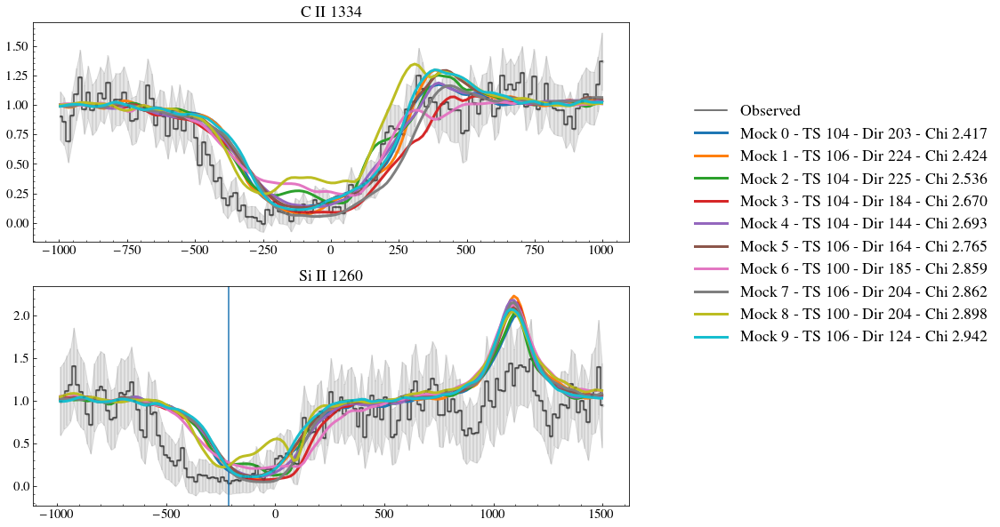

j1148+2546


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/3977829443.py:91: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


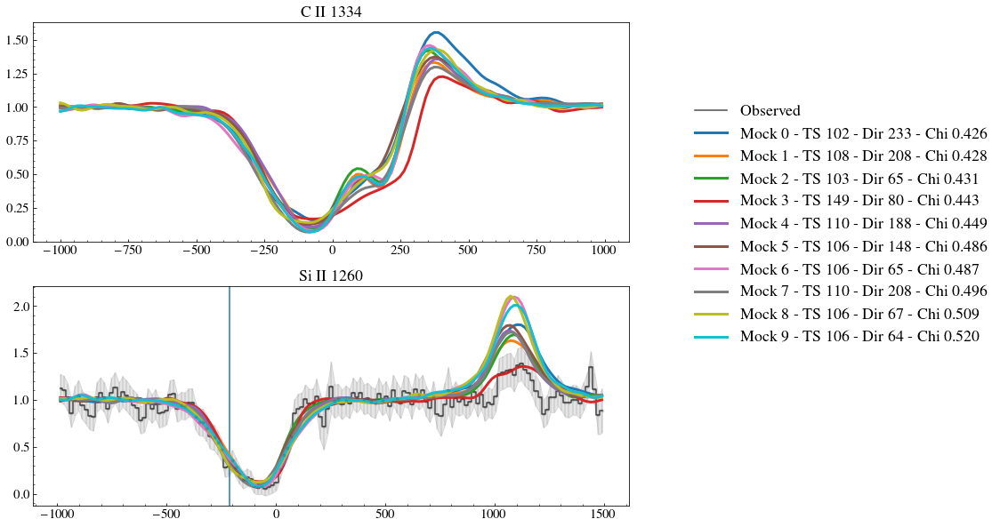

j1150+1501


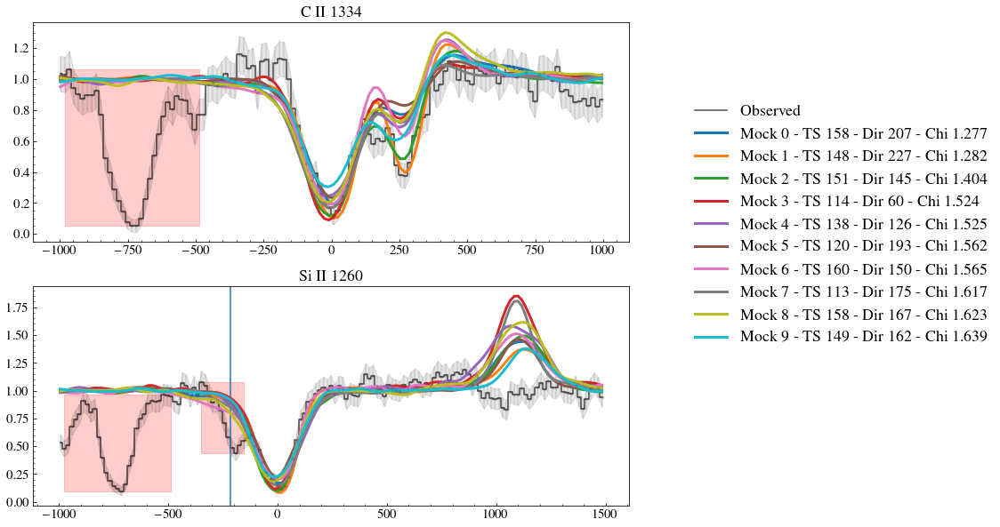

j1157+3220


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/3977829443.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/3977829443.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


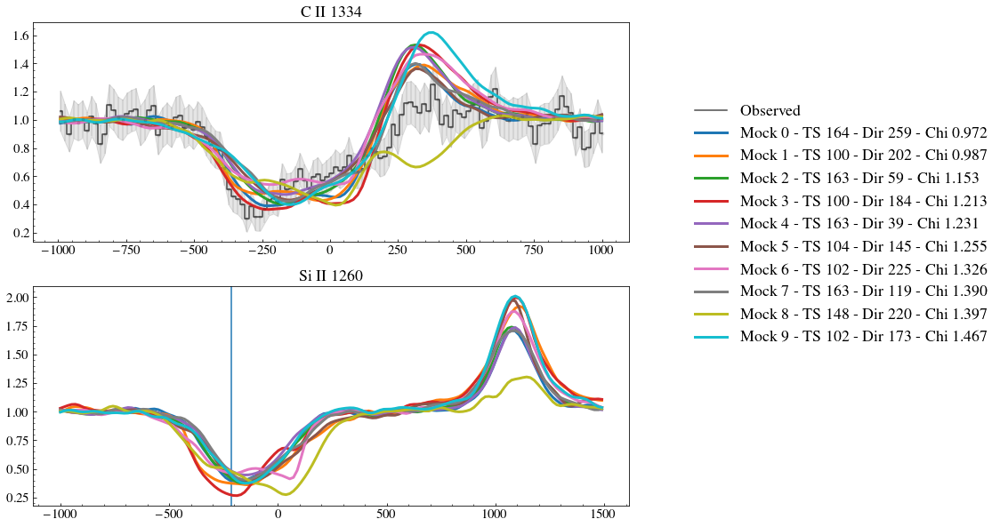

j1200+1343


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


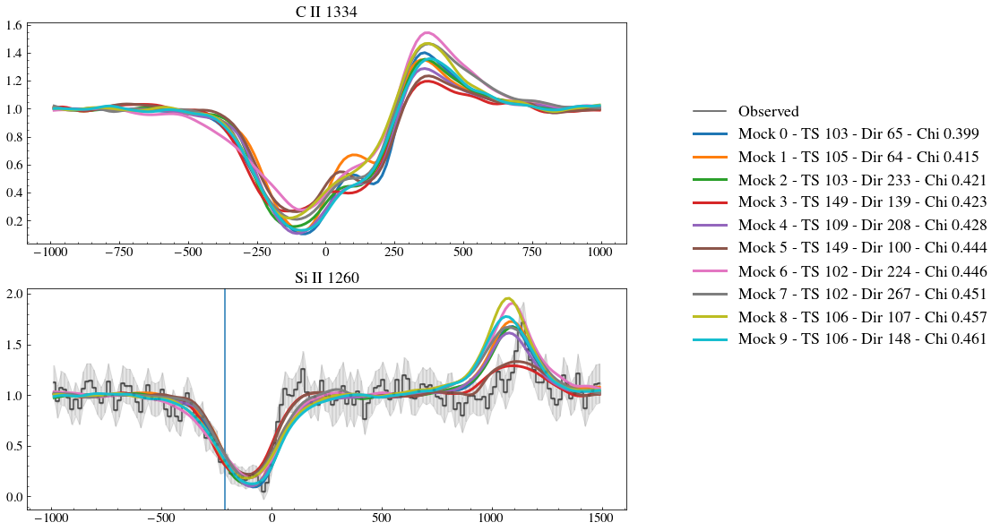

j1225+6109


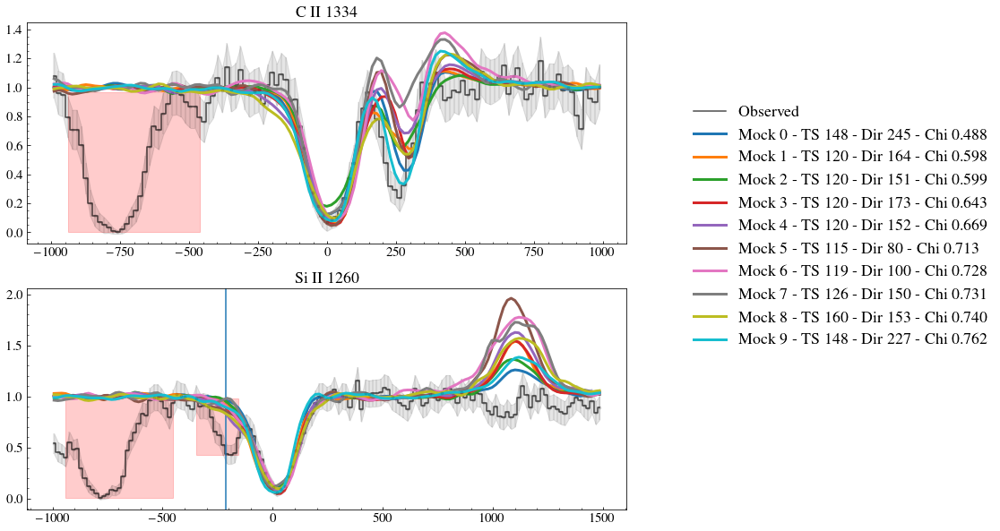

j1253-0312


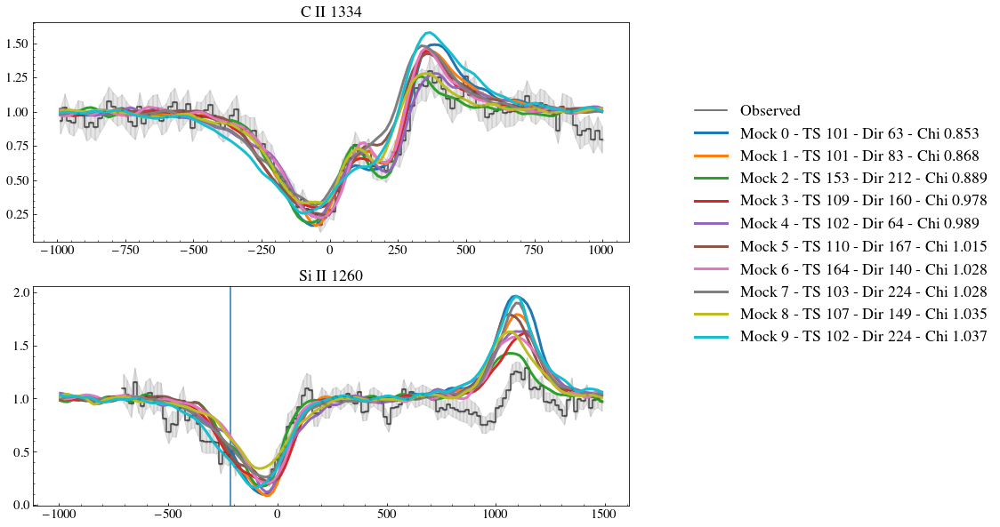

j1314+3452


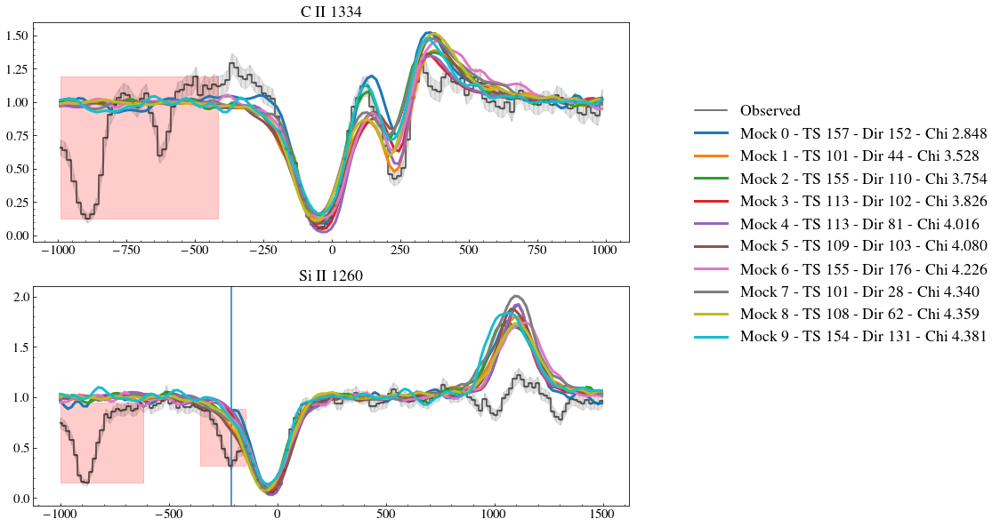

j1323-0132


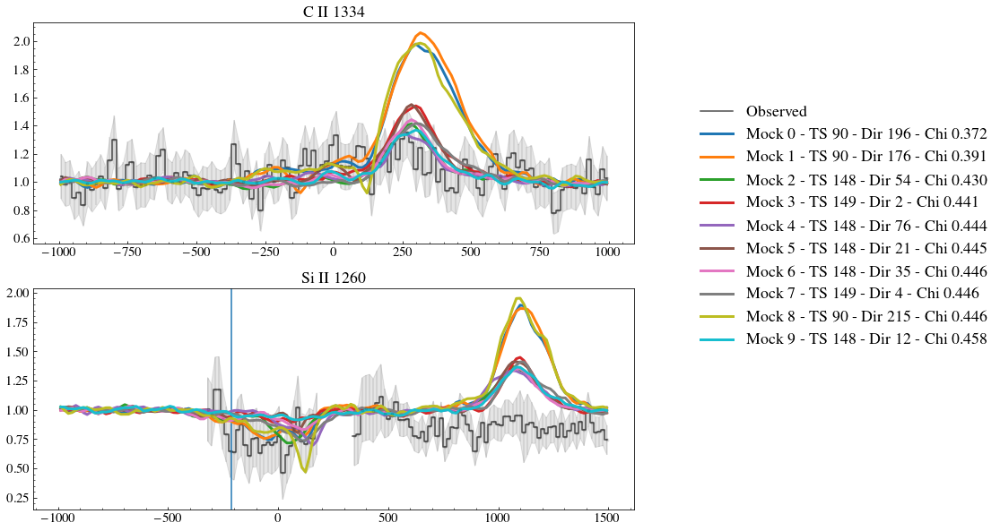

j1359+5726


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_1152971/3977829443.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/3977829443.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


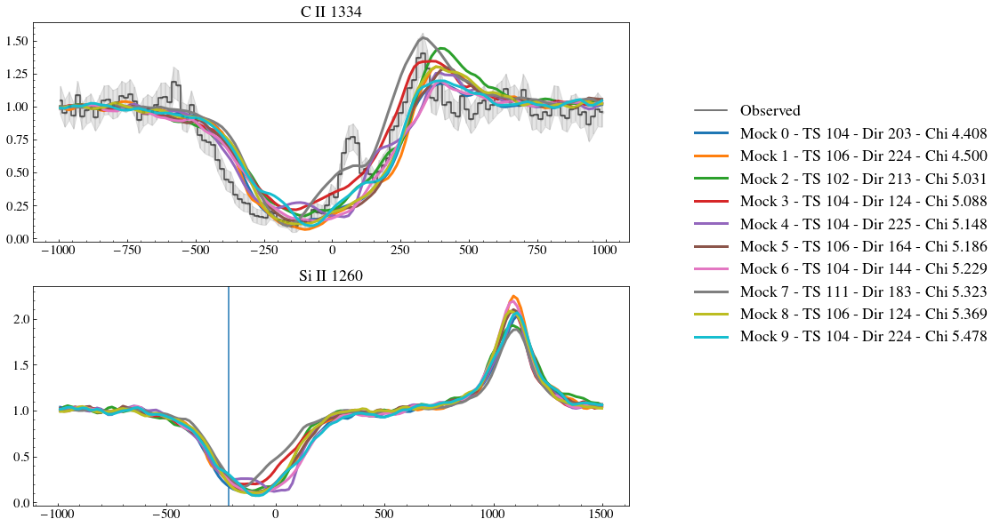

j1416+1223


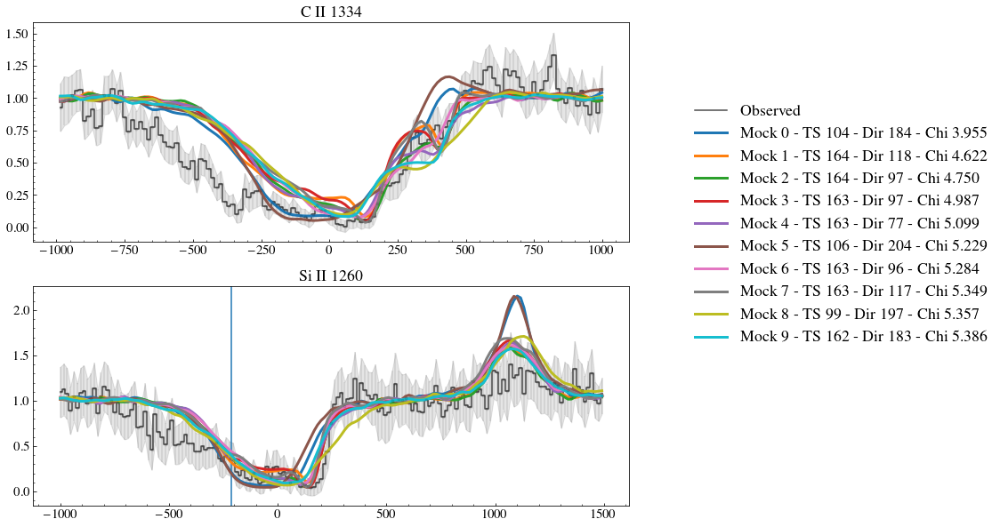

j1418+2102


/tmp/ipykernel_1152971/3977829443.py:104: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_1152971/3977829443.py:105: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


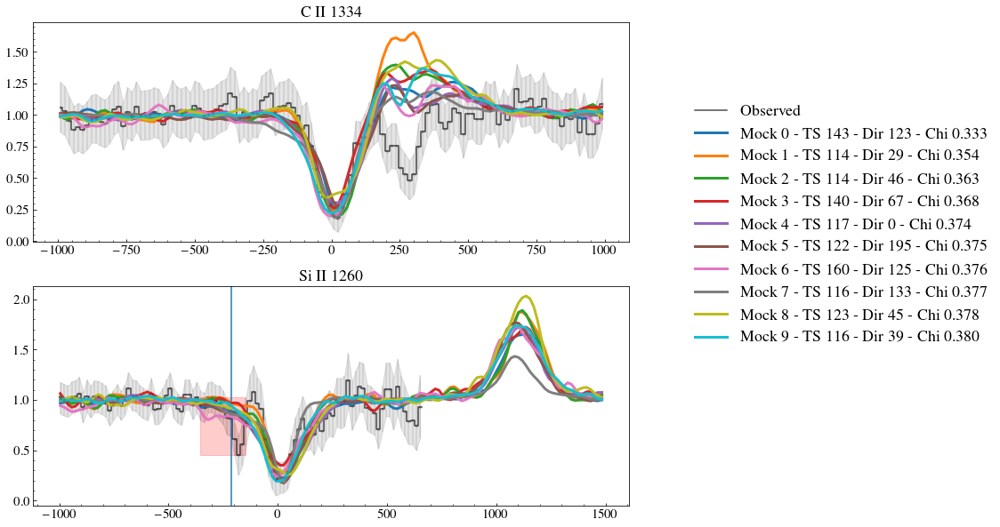

j1428+1653


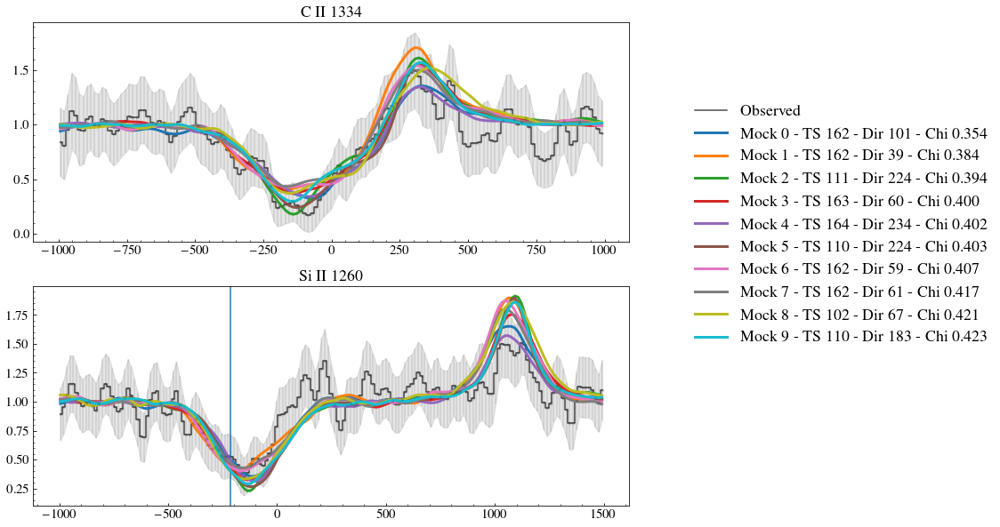

j1429+0643


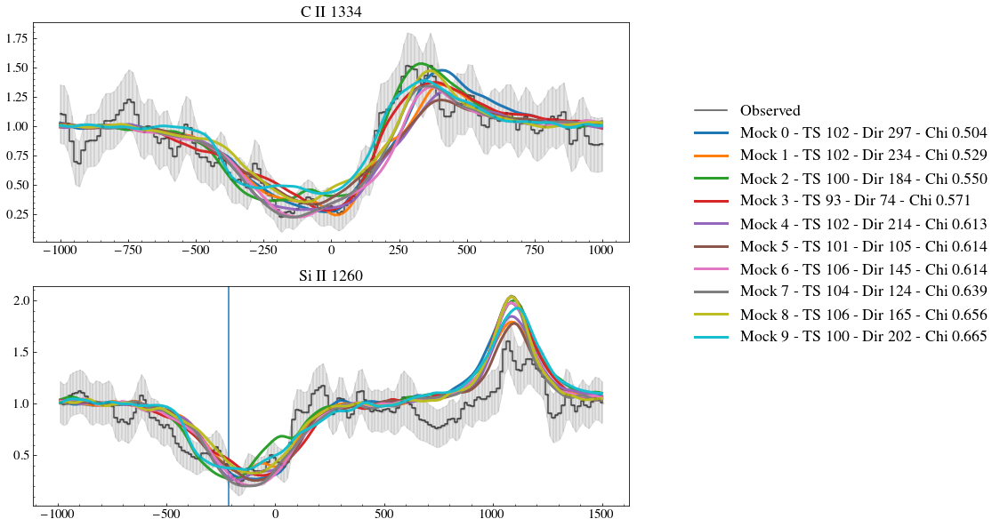

j1444+4237


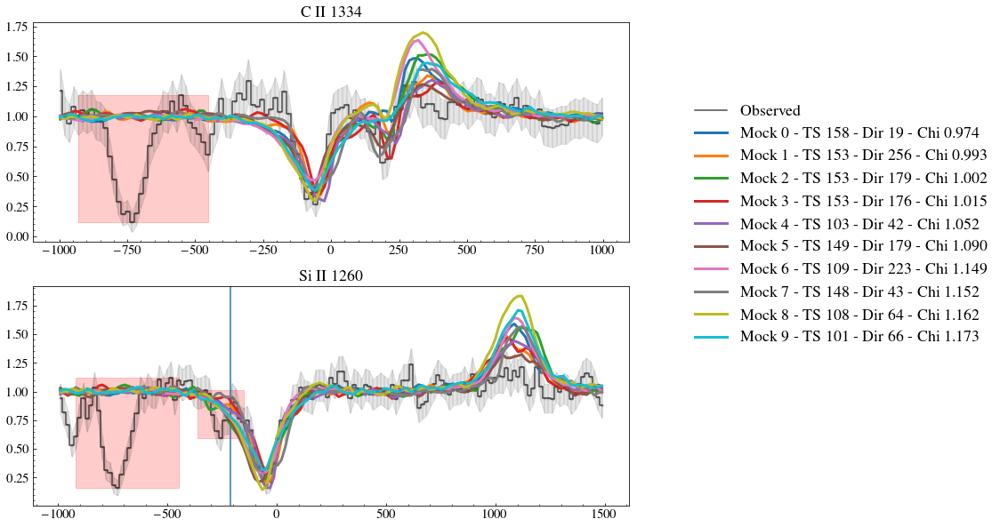

j1448-0110


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


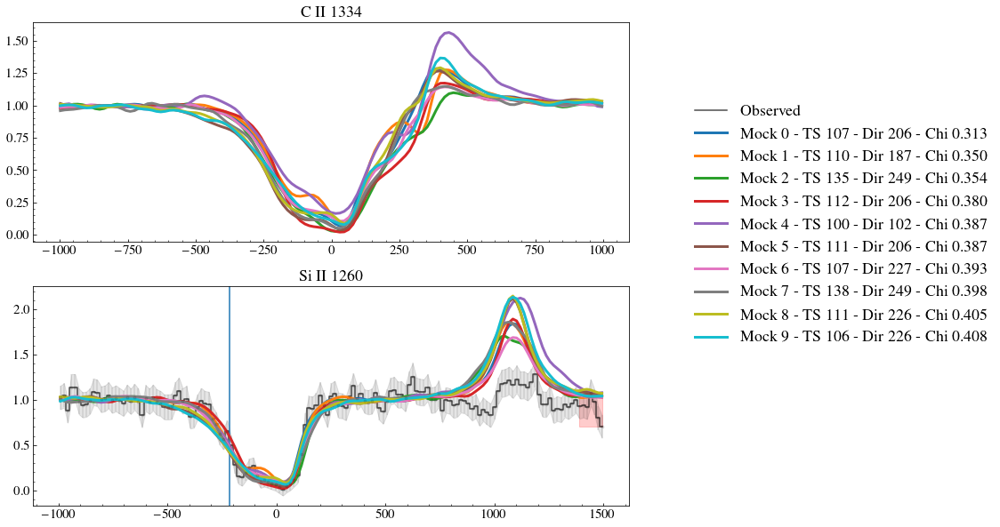

j1521+0759


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


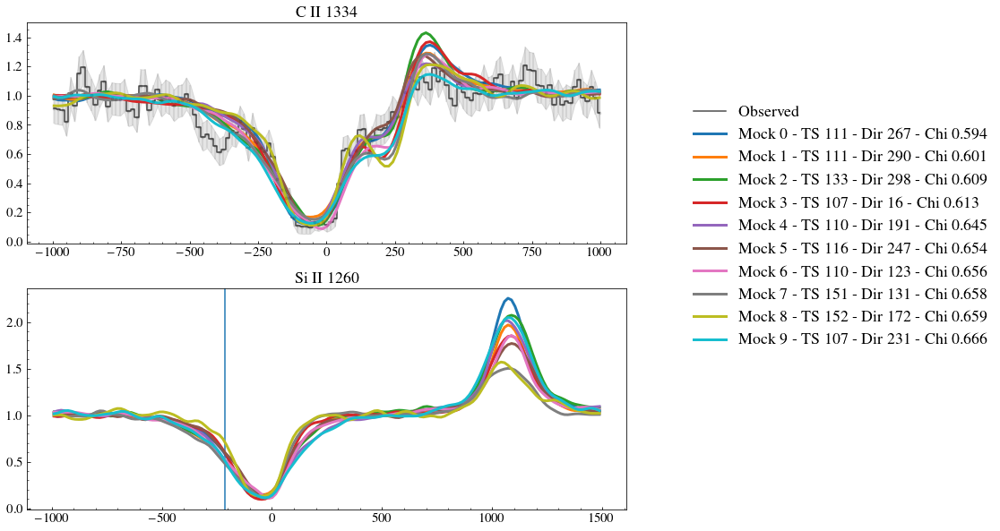

j1525+0757


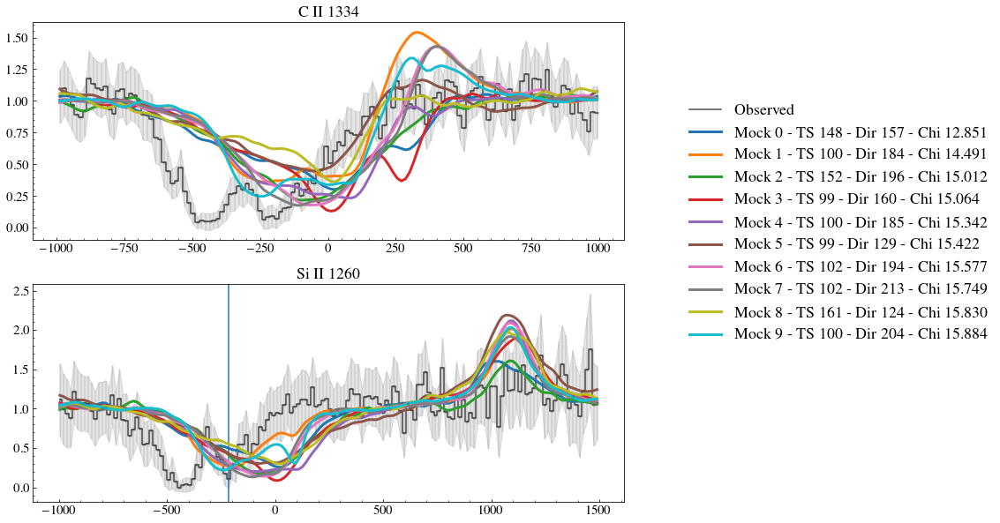

j1545+0858


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


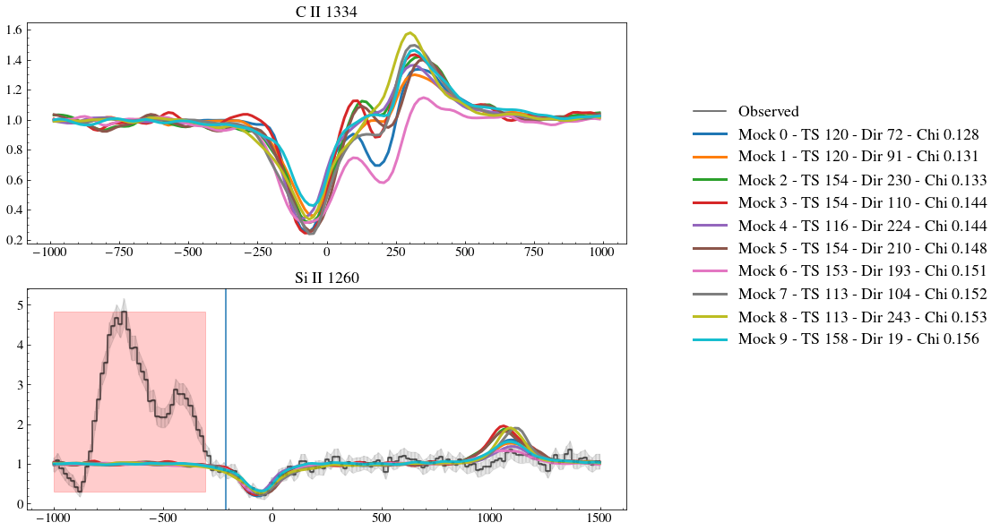

j1612+0817


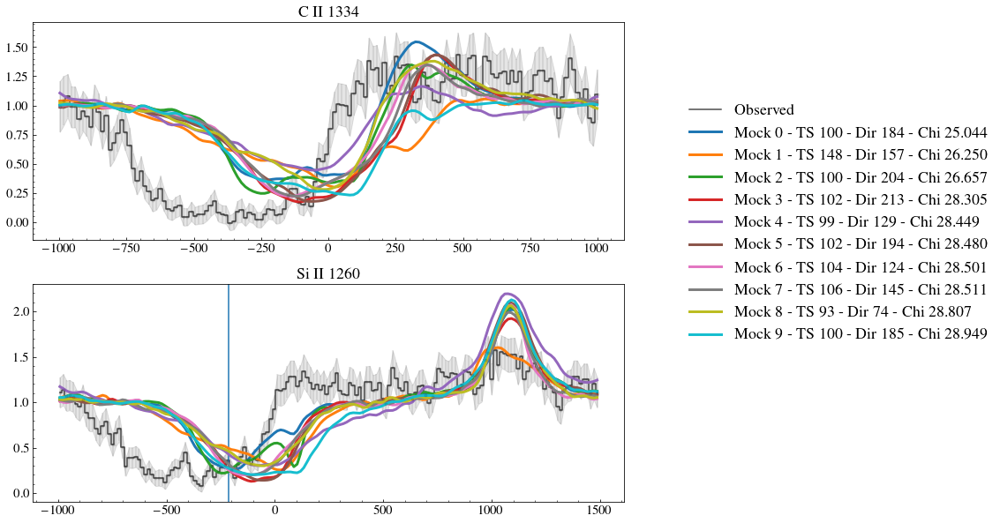

In [9]:
nGal = len(galaxy)
nmocks         = 10
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1

sIIExclude = [2,4,10,11,13,22,24,27,30,32,36,39]
v_cm = np.genfromtxt('./dat_files/vcm_90_164.dat',unpack=True)
path_to_data = path_to_data_arr[3]   # To change if you move the data

for i in range(nGal):
    print(label[i])

    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    #fit = gaussian_filter(data['fit'], sigma = 10)
    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

#    absflux = gaussian_filter(data['flux']/data['fit'],sigma = 1)
#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    #absflux /= np.median(absflux[cutSiIIall])
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 500)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])

    if(i == 1):      
        fmedCII /=1.05
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(2,1,figsize=(12,10))
    #/np.nanmedian(flux[cutCIIall])
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    if(i in sIIExclude):
        axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    axs[1].axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')



    bestfluxsiall = np.zeros((nmocks, len(vsiII)))
    bestfluxciiall = np.zeros((nmocks, len(vcII)))
#     bestfluxsiabs = np.zeros((nmocks, len(vsiII_s)))
#     bestfluxciiabs = np.zeros((nmocks, len(vcII)))
#     bestfluxsiemi = np.zeros((nmocks, len(vsiII_s)))
#     bestfluxciiemi = np.zeros((nmocks, len(vcII)))
    for output in range(90,165,1):
    
        lcII,  fluxcII  = read_spectrum_c(path_to_data,output) 
        lsiII, fluxsiII = read_spectrum_si(path_to_data,output) 
        
        for idir in range(300):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lcII) 
            lcII_systemic = lcII_systemic[1:]
            vcII_s    = (lcII_systemic/wcII1334 -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lsiII) 
            lsiII_systemic = lsiII_systemic[1:]
            vsiII_s  = (lsiII_systemic/wsiII1260 -1)*c

            sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
            sigma_pixelsiII = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50]- vsiII_s[49]))

            modelcII    = gaussian_filter(fluxcII[idir,1:], sigma = sigma_pixelcII)
            f           = interpolate.interp1d(vcII_s, modelcII)
            modelNewcII = f(vcII)

            modelsiII   = gaussian_filter(fluxsiII[idir,1:], sigma = sigma_pixelsiII)
            f           = interpolate.interp1d(vsiII_s, modelsiII)
            modelNewsiII= f(vsiII)

#             alpha = np.nansum((modelNewcII[maskCII]*fcII[maskCII]/(ecII[maskCII]**2)))/ \
#                     np.nansum(modelNewcII[maskCII]**2/ecII[maskCII]**2)
#             modelNewcII *= alpha
            
#             alpha = np.nansum((modelNewsiII[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsiII[maskSiII]**2/esiII[maskSiII]**2)
# #             print(alpha)
#             modelNewsiII *= alpha
            
            rmedCII = ((vcII<-500) | (vcII > 700)) 
            fmedCII = np.nanmedian(modelNewcII[rmedCII])
            modelNewcII /= fmedCII

            rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
            fmedSiII = np.nanmedian(modelNewsiII[rmedSiII])
            modelNewsiII /= fmedSiII
            
            maskCII = maskCII & (vcII >-700) & (vcII < 200)
            maskSiII = maskSiII & (vsiII > - 700)  & (vsiII < 400)
            if(i in sIIExclude):
                maskSiII = maskSiII & (~((vsiII >-364) & (vsiII <-144)))
            if(len(ecII[maskCII]) > 0):
                lnlikecII  =  np.nansum(((fcII[maskCII]-modelNewcII[maskCII])**2)/ecII[maskCII]**2) #/len(ecII[maskCII])
                ncII = len(fcII[maskCII])
            else:
                lnlikecII = 0
                ncII = 0
            if(len(esiII[maskSiII]) > 0):
                lnlikesiII =  np.nansum(((fsiII[maskSiII] - modelNewsiII[maskSiII])**2)/esiII[maskSiII]**2)#/len(esiII[maskSiII])
                nsiII = len(fsiII[maskSiII])               
            else:
                lnlikesiII = 0
                nsiII = 0
#             print(lnlikesiII)
            if(np.isnan(lnlikesiII)):
                lnlikesiII = 0
                nsiII = 0
            if(np.isnan(lnlikecII)):
                lnlikecII = 0
                ncII = 0
            lnlikeall  = (lnlikecII + lnlikesiII)/(ncII + nsiII)
            #print(lnlikeall)
            for j in range(nmocks):
                #print(lnlikeall,bestvalall[i][j])
                            
                if(lnlikeall < Chi2all[i][j]):
#                     bestdirall[i][j] = idir
#                     bestvalall[i][j] = lnlikeall
#                     bestoutall[i][j] = output
                    b = dirall[i].copy()
                    b = np.insert(b, j, idir)
                    b = b[:-1]
                    dirall[i] = b
                    
                    b = Chi2all[i].copy()
                    b = np.insert(b, j, lnlikeall)
                    b = b[:-1]
                    Chi2all[i] = b
                    
                    b = outall[i].copy()
                    b = np.insert(b,j, output)
                    b = b[:-1]
                    outall[i] = b
#                     print(bestfluxsiall.shape)
#                     print(len(bestfluxsiall[0]), len(modelNewsiII))

#                     bestfluxsiall[i].copy()
                    bestfluxsiall = np.insert(bestfluxsiall,j, modelNewsiII,0)
                    bestfluxsiall = bestfluxsiall[:-1, :]
#                     bestfluxsiall[i] = b
#                     print(bestfluxsiall.shape)
          
                    bestfluxciiall = np.insert(bestfluxciiall,j, modelNewcII,0)
                    bestfluxciiall = bestfluxciiall[:-1]                   
#                     b = bestfluxciiall[i].copy()
#                     b = np.insert(b,j, modelNewcII)
#                     b = b[:-1]
#                     bestfluxciiall[i] = b                              
                              
                    break
                


    for k in range(nmocks):
        axs[0].plot(vcII, bestfluxciiall[k],
                label = 'Mock %d - TS %d - Dir %d - Chi %.3f'%(k, outall[i][k], dirall[i][k], 
                                                             Chi2all[i][k]), lw = 3)


        axs[1].plot(vsiII, bestfluxsiall[k],  lw = 3)

#     axs[1].yticks
    axs[0].legend(frameon=False, ncol = 1, loc =(1.1,-0.5), fontsize = 18)
    plt.subplots_adjust(wspace = 0.1)
#     plt.suptitle(label[i])
#     plt.savefig('Plots/'+galaxy[i]+'matchdepletion.pdf', bbox_inches = 'tight')
    plt.show()

In [10]:
totCol = np.vstack((galaxy,outall[:,0].astype(int), dirall[:,0].astype(int),Chi2all[:,0]))
C=['Galaxy','OutputAll0','DirAll0', 'x2All0']

for k in range(1,nmocks):
    totCol = np.vstack((totCol,outall[:,k].astype(int), dirall[:,k].astype(int),Chi2all[:,k]))
    C.extend([f'OutputAll{k}',f'DirAll{k}',f'x2All{k}'])
    
# print(C)
# print(totCol)
df = pd.DataFrame(totCol.T) # A is a numpy 2d array
df.to_csv(f"csv/Classy_dep_10fits_abs.csv", sep=',', header= C, index=False) 

## Fitting with the cube

In [11]:
nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII_dep/',300)
print(nxy)
nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII_dep/',300)


64


0 j0021+0052
19.5
285
148


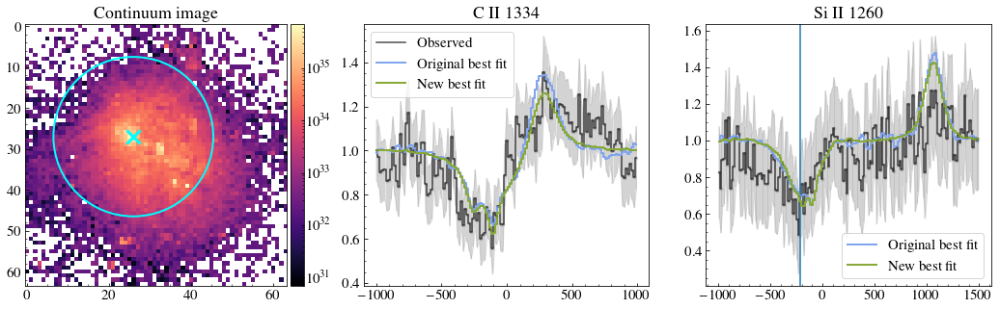

1 j0036-3333
4.5
284
148


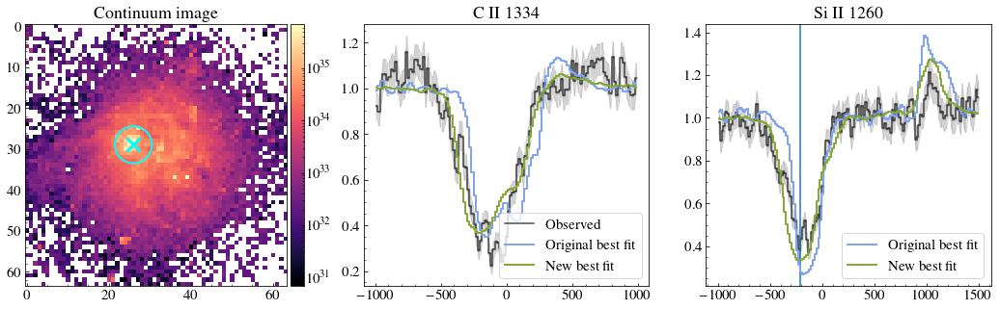

2 j0127-0619
1.5
261
148


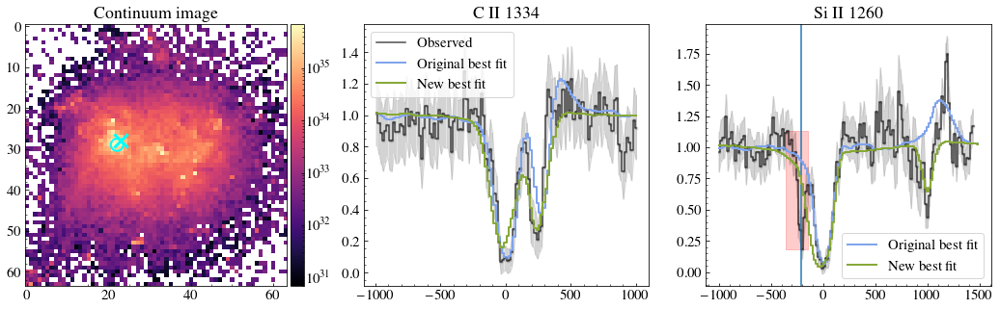

3 j0144+0453
1.5
244
149


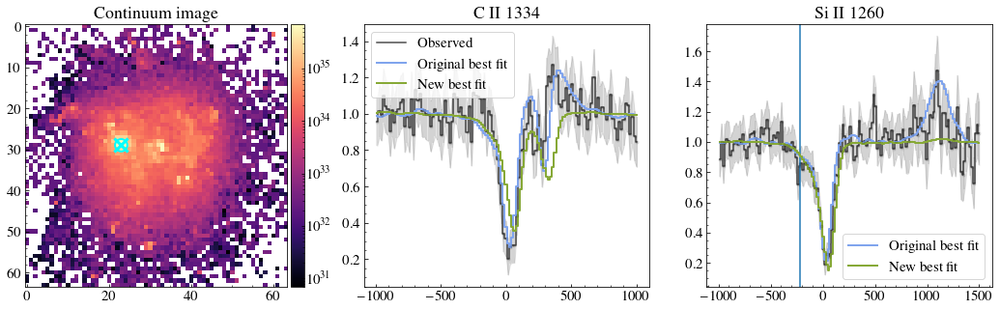

4 j0337-0502
3.0
222
153


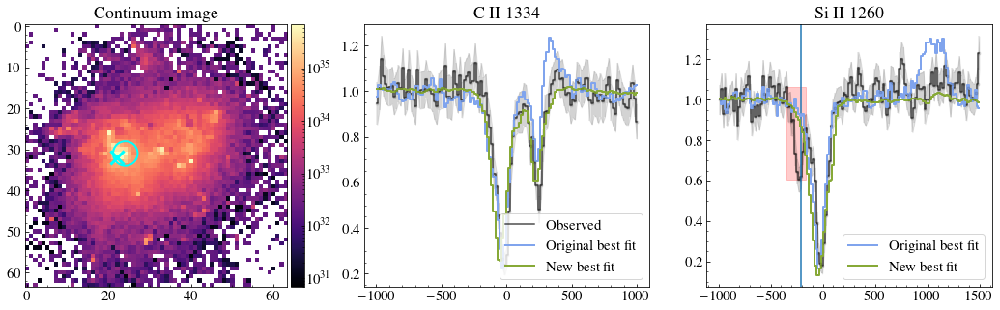

5 j0405-3648
1.0
267
148


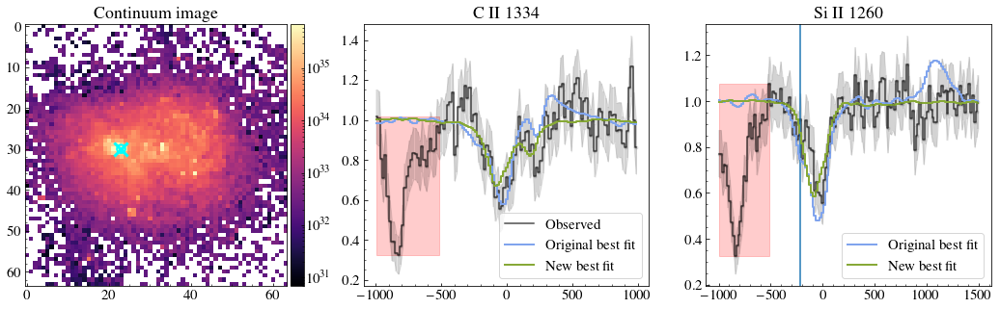

6 j0808+3948
18.5
140
148


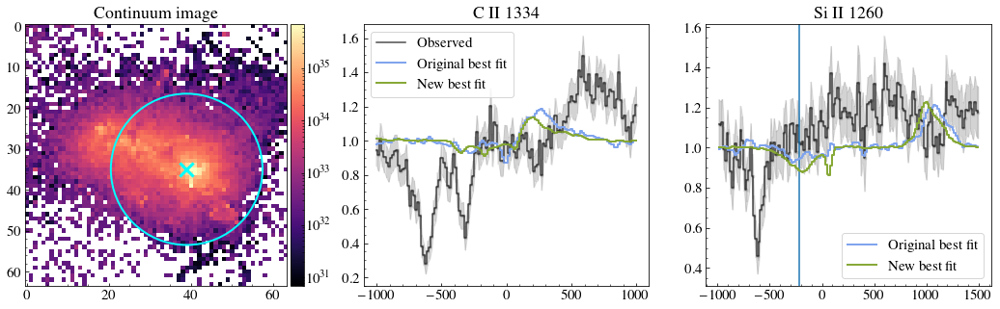

7 j0823+2806
10.0
173
135


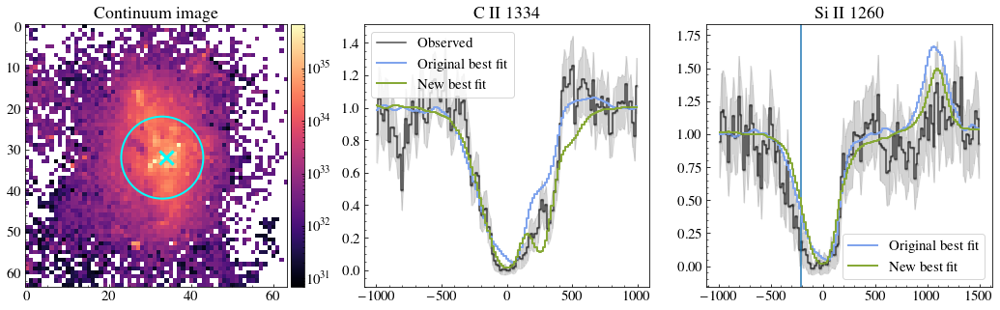

8 j0926+4427
33.0
275
153


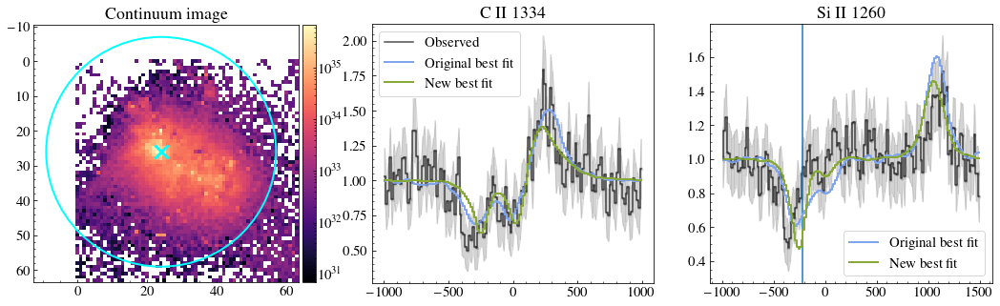

9 j0934+5514
1.0
110
148


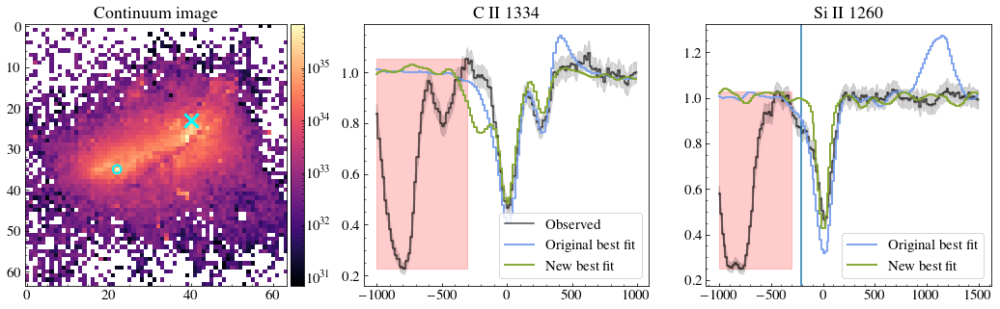

10 j0938+5428
20.5
40
160


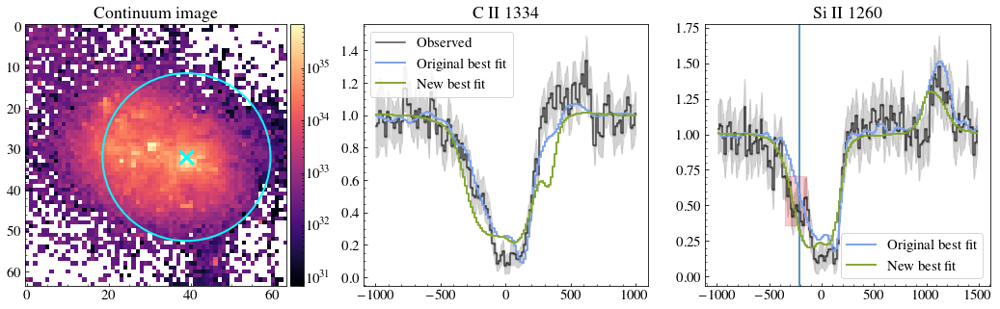

11 j0940+2935
0.5
222
148


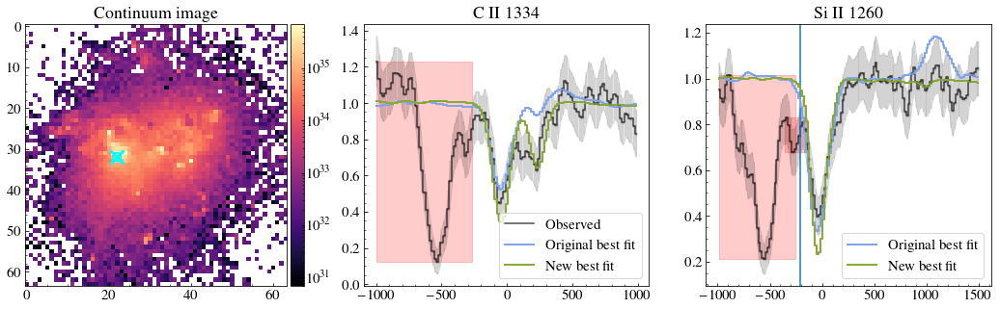

12 j0942+3547
3.5
122
148


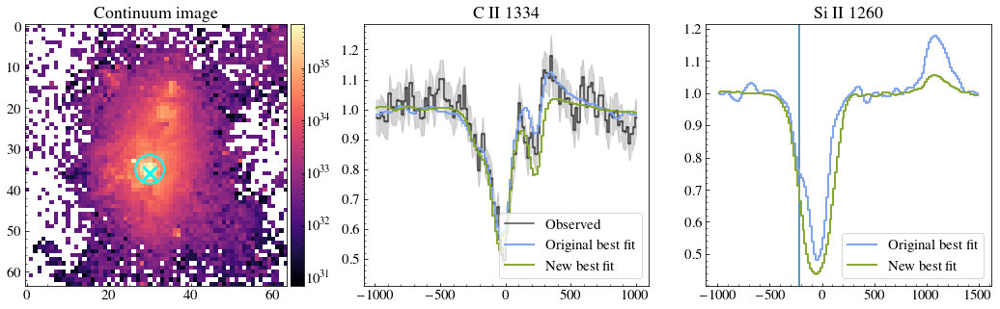

13 j0944-0038
1.5
208
158


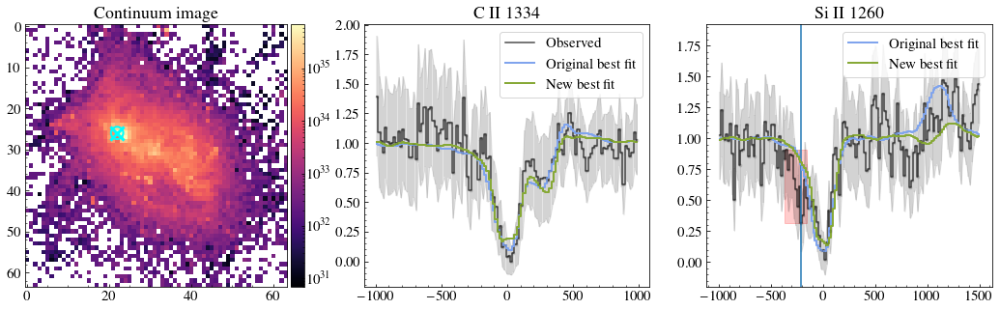

14 j0944+3442
4.5
221
154


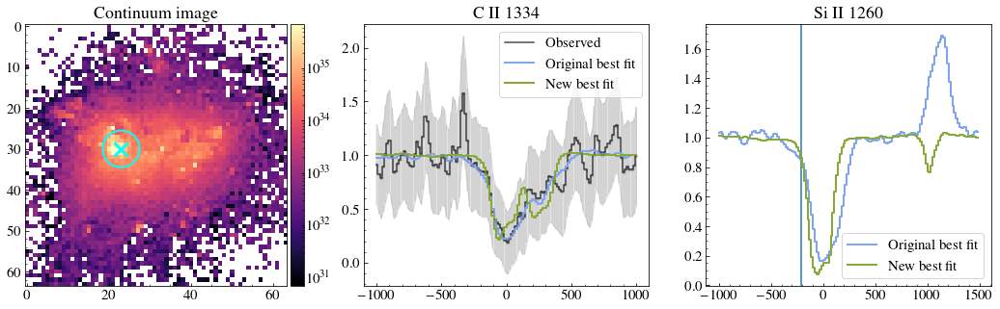

15 j1016+3754
1.0
230
148


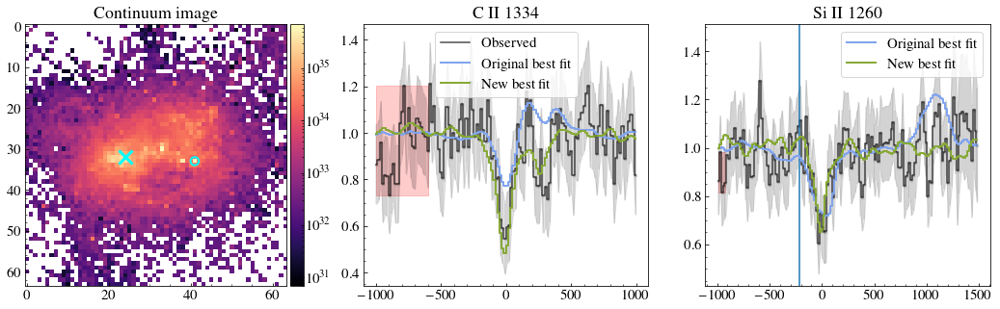

16 j1024+0524
7.5
222
148


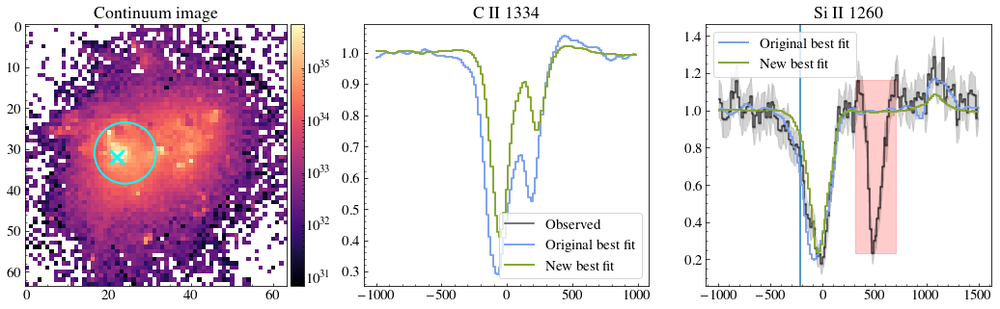

17 j1025+3622
24.5
138
164


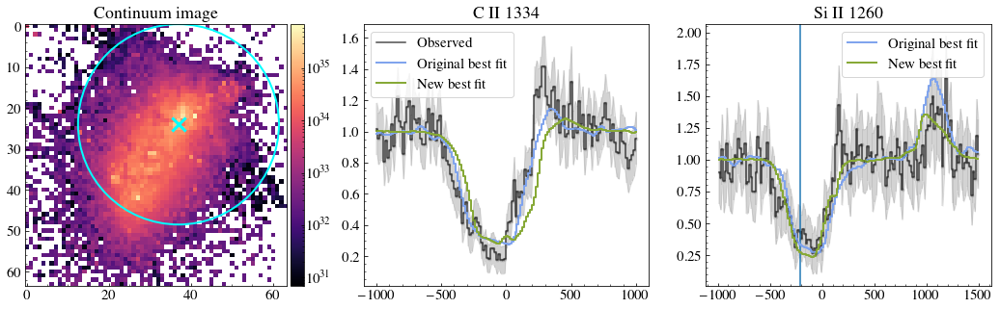

18 j1044+0353
3.0
232
154


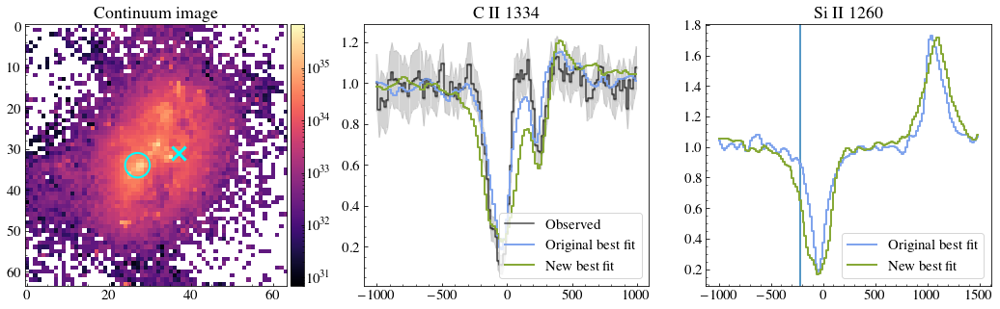

19 j1105+4444
5.0
177
107


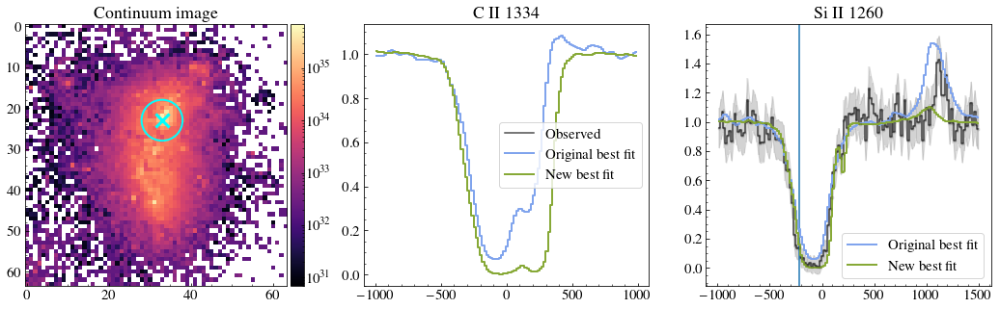

20 j1112+5503
25.5
157
102


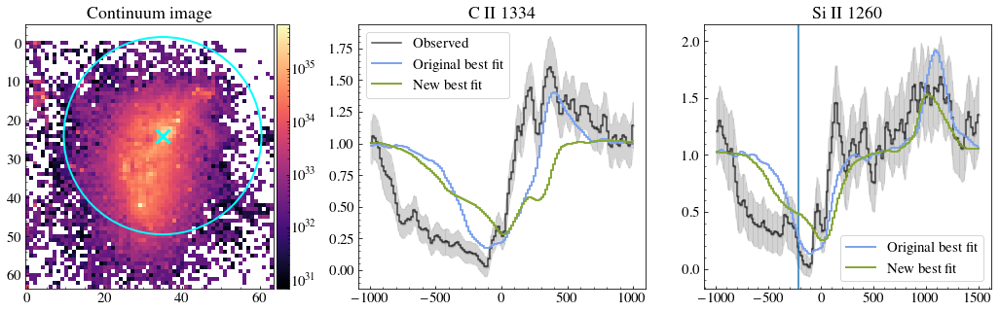

21 j1119+5130
1.0
231
148


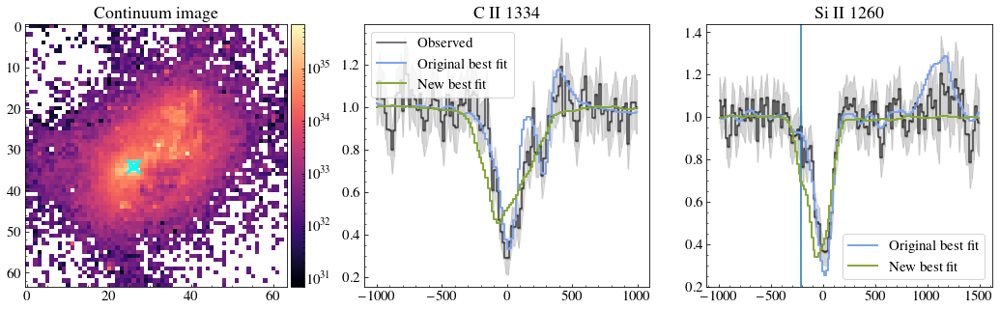

22 j1129+2034
1.5
247
148


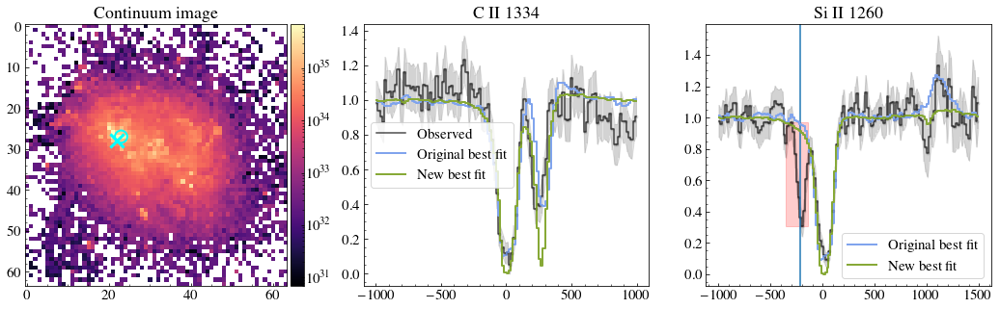

23 j1132+1411
4.0
271
112


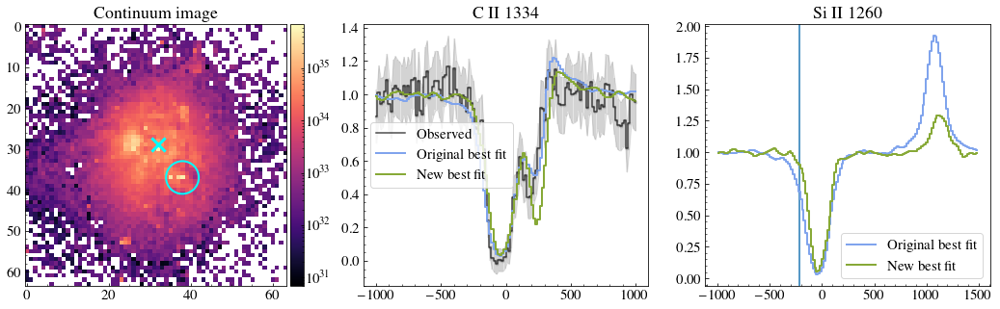

24 j1132+5722
1.5
126
148


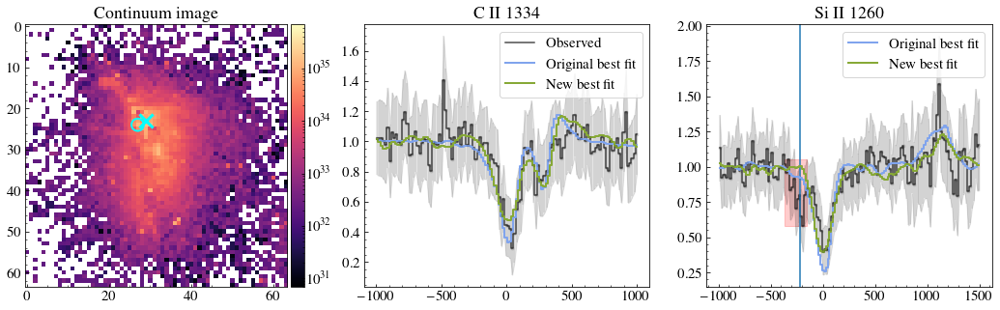

25 j1144+4012
24.5
40
104


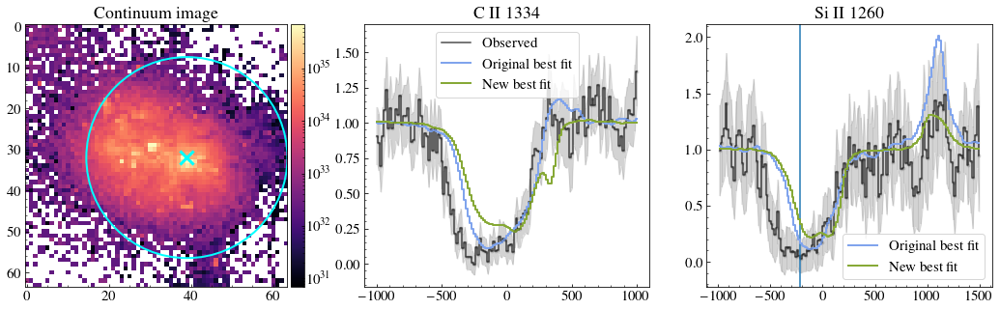

26 j1148+2546
9.5
101
149


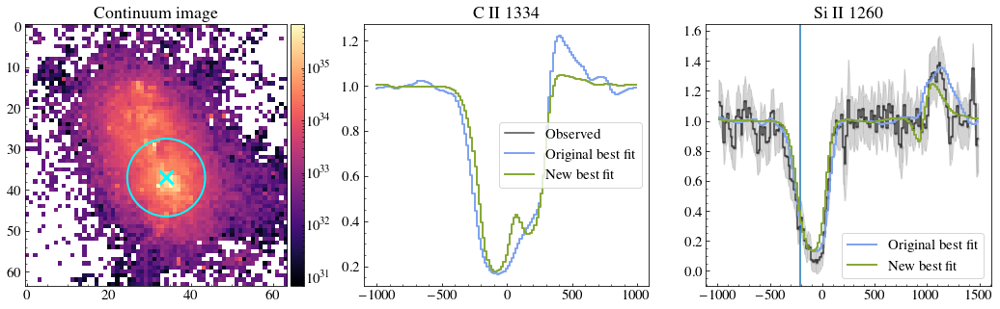

27 j1150+1501
1.0
228
148


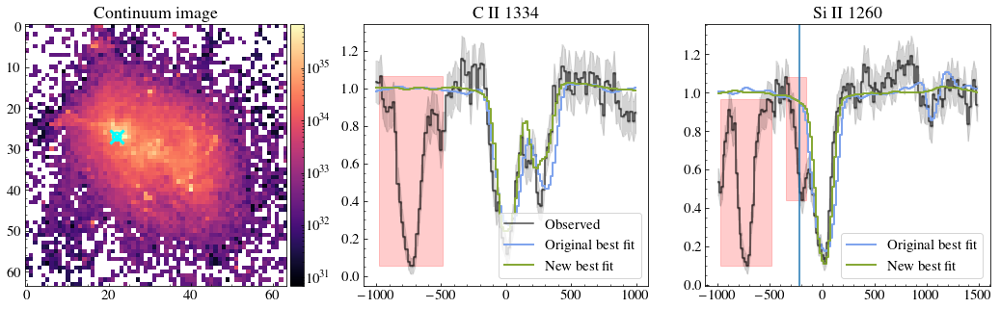

28 j1157+3220
2.5
284
100


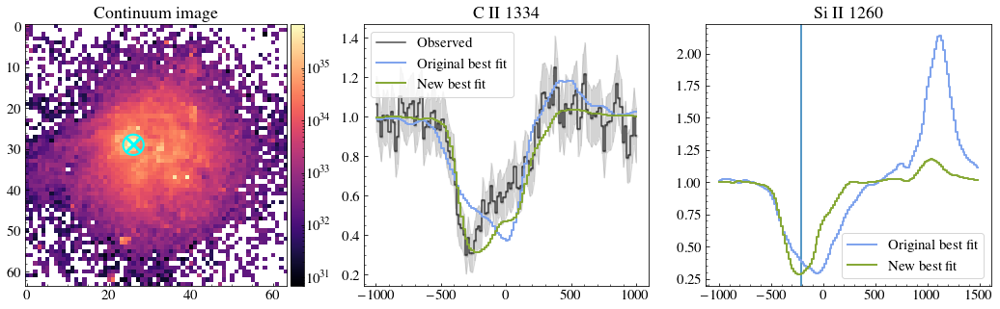

29 j1200+1343
14.0
101
149


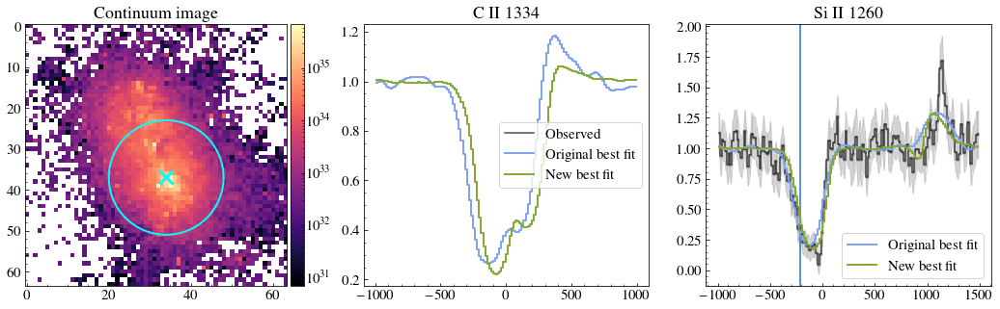

30 j1225+6109
1.0
247
148


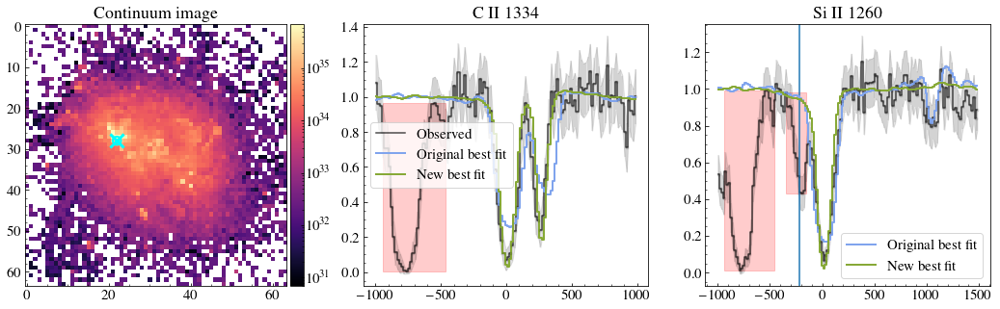

31 j1253-0312
5.0
102
148


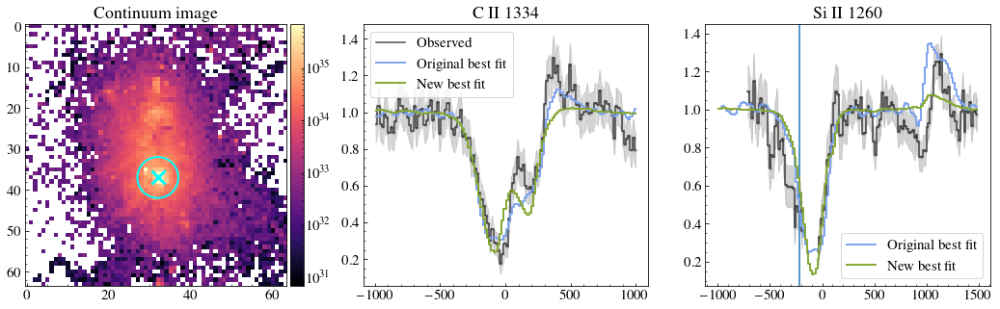

32 j1314+3452
1.0
122
153


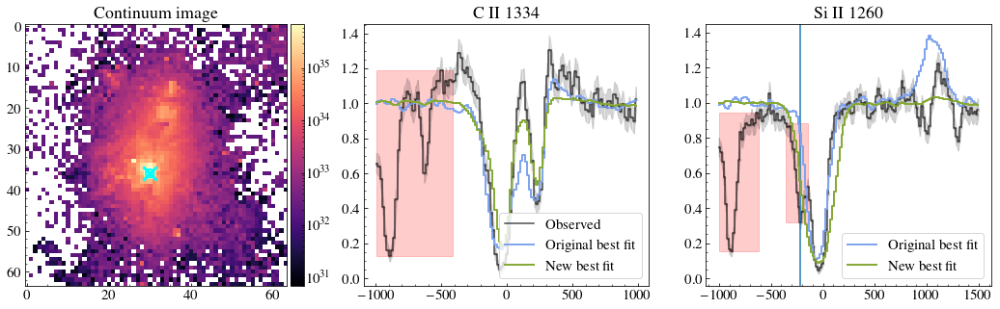

33 j1323-0132
5.0
19
148


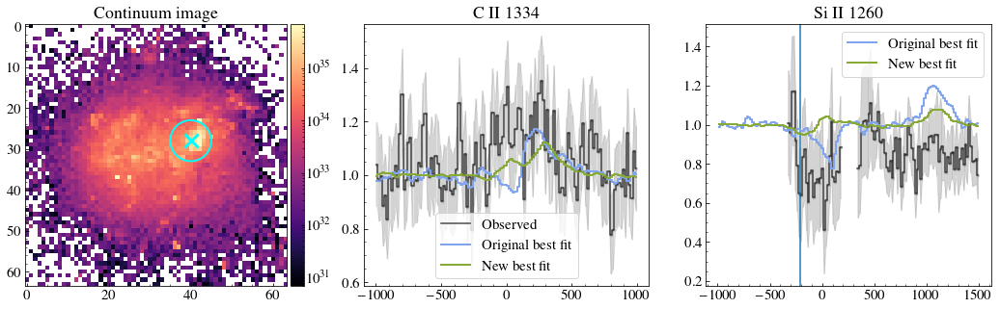

34 j1359+5726
7.5
137
104


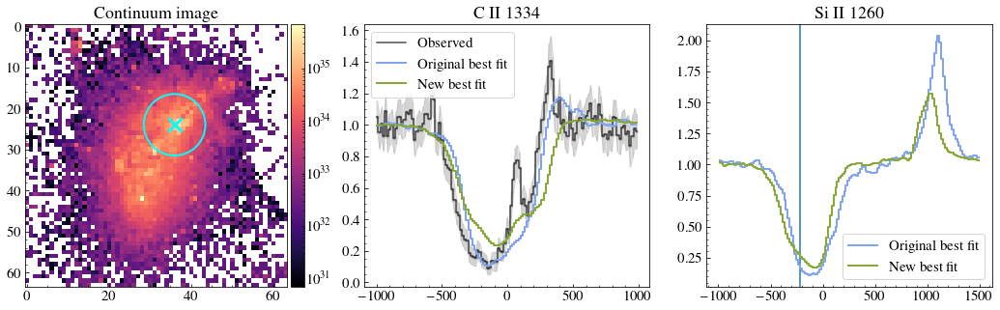

35 j1416+1223
24.0
154
104


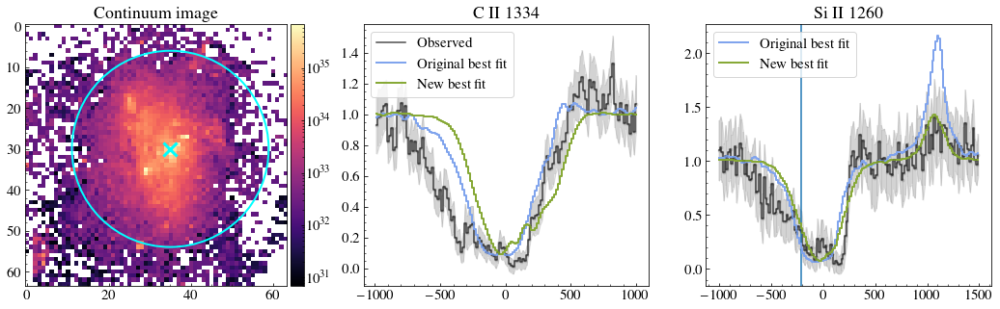

36 j1418+2102
2.0
126
148


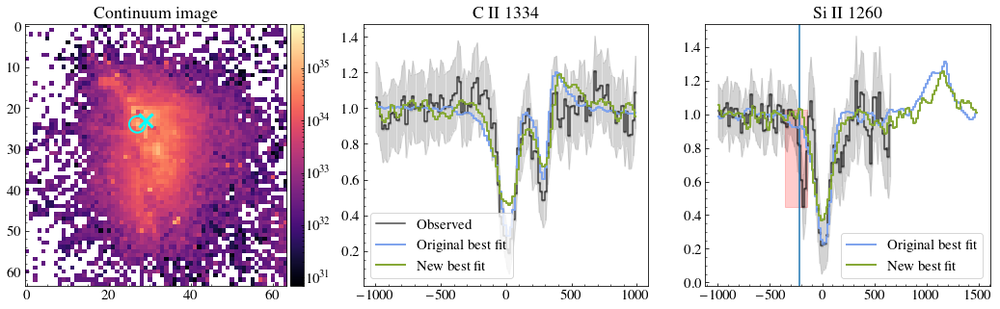

37 j1428+1653
33.0
272
164


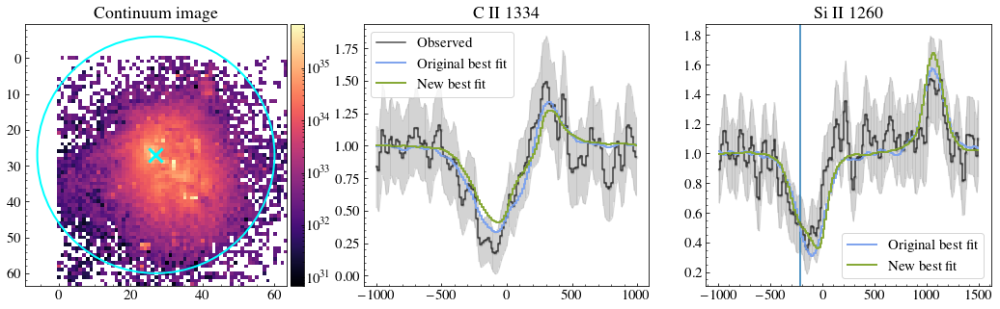

38 j1429+0643
31.5
138
164


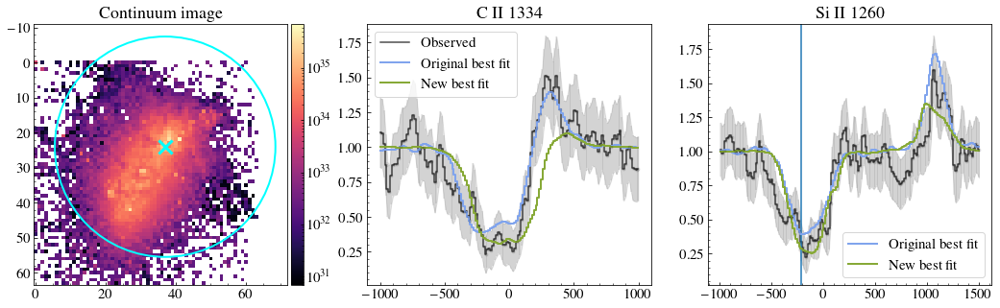

39 j1444+4237
1.0
266
148


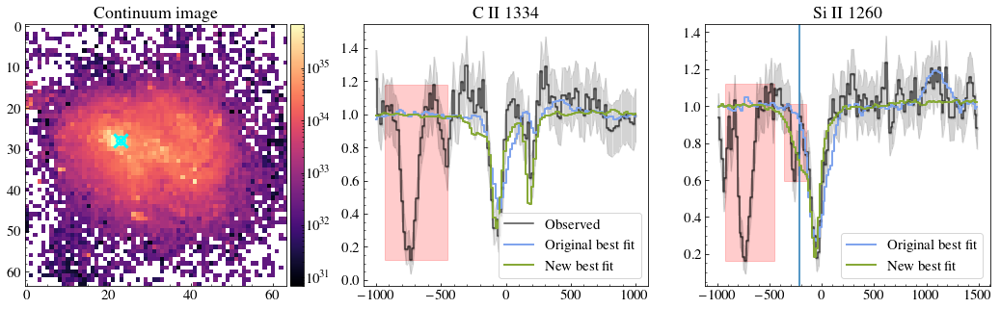

40 j1448-0110
6.0
200
120


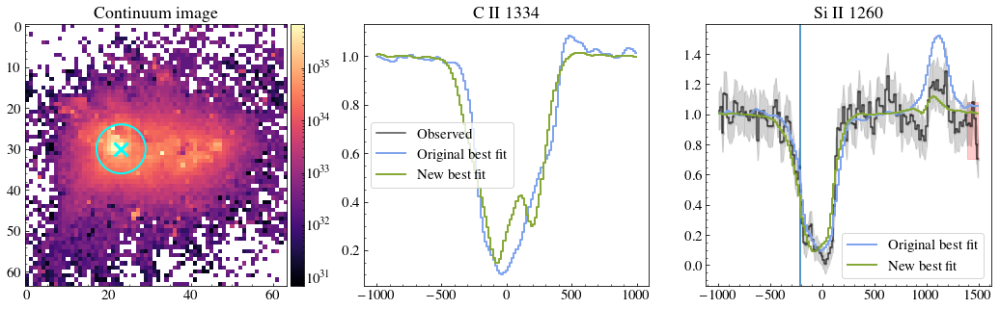

41 j1521+0759
19.0
193
110


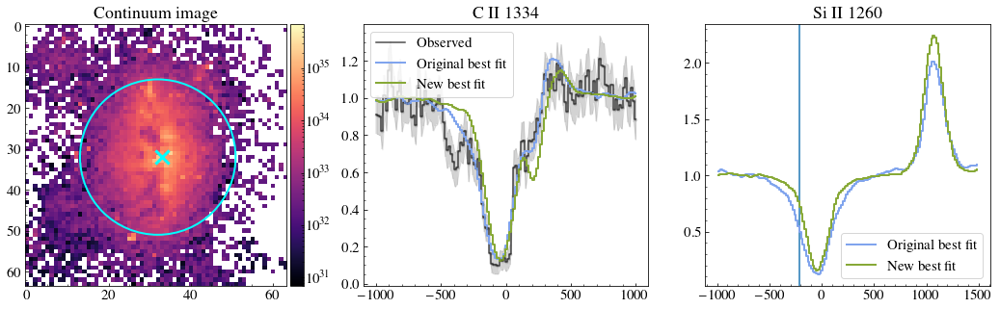

42 j1525+0757
15.5
157
148


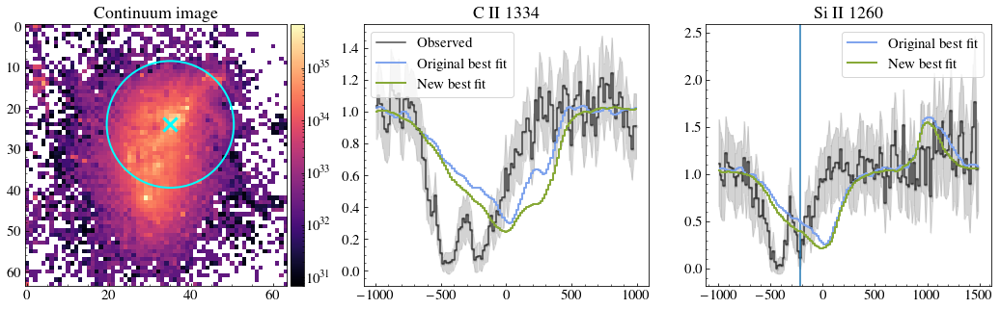

43 j1545+0858
8.5
165
148


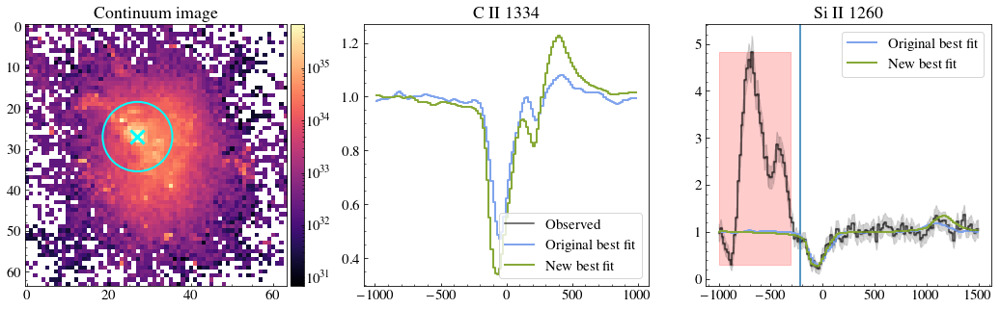

44 j1612+0817
28.0
157
100


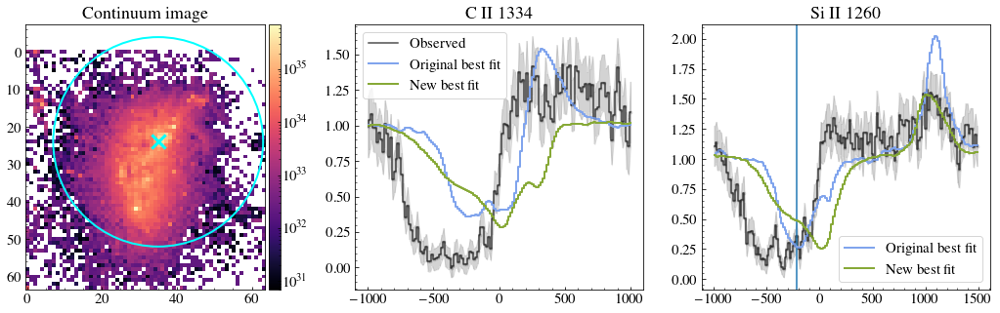

In [46]:
#FITS
import warnings
warnings.filterwarnings('ignore')
from skimage.feature import peak_local_max
import math
# nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII3/',300)
# print(nxy)
# nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII3/',300)

nGal = len(galaxy)
nmocks         = 1
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1

coordX         = np.zeros((45, nmocks)) - 1
coordY         = np.zeros((45, nmocks)) - 1

dfnoFS = pd.read_csv('csv/Classy_noFS_fit.csv')
dfFS   = pd.read_csv('csv/Classy_FS_fit.csv')
dfdust = pd.read_csv('csv/Classy_ND_fit.csv')
dfdep = pd.read_csv('csv/Classy_dep_fit_V2.csv')

sIIExclude = [2,4,10,11,13,22,24,27,30,32,36,39]
v_cm = np.genfromtxt('./dat_files/vcm_90_164.dat',unpack=True)


for i in range(nGal):
    print(i,label[i])
    
#     if(label[i] not in ['j0934+5514']):
#        continue
    
  #  if(classy.loc[classy.Galaxy == label[i].upper(), 'fr50aper'].values < 1):
  #      continue
        
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    rcos = classy.loc[classy.Galaxy == label[i].upper(), 'rcoskpc'].values*1000
    npix = rcos/(imsize/nxy)
    #if(npix > 10):
#     if(classy.loc[classy.Galaxy == label[i].upper(), 'fr50aper'].values <= 1):
#         continue
#     if(dfdep['OutputAll'][i] != 148):
#         continue
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c


    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    

    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 500)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])

    if(i == 1):      
        fmedCII /=1.05
    fcII /= fmedCII
    if (i == 2):
        fcII/=1.06
        esiII[vsiII>1000]/=2
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII

    fig, axs = plt.subplots(1,3,figsize=(18,5))
    ax1, ax2, ax3 = axs
    #/np.nanmedian(flux[cutCIIall])
    axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[1].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[1].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[1].set_title('C II 1334')
   
    
    axs[2].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[2].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    if(i in sIIExclude):
        axs[2].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    axs[2].axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        axs[2].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[2].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[2].set_title('Si II 1260')


             
    ## Find new best fit locally
#     Chi2all        =  1e10

    bestmodelcII = 0
    bestmodelsiII = 0
    print(math.ceil(npix * 2) / 2)
    pixels_around_center =max(math.ceil(npix * 2) / 2,1)#max(int(np.ceil(npix)),1)#1.5#int(np.ceil(npix))# max(int(np.ceil(npix)),2)#
    dpeak = 0
    for dd in np.arange(0,300,1):
        fimageoricII = cubecII[dd,:,:,40:-40].copy()
        fimageorisiII= cubeSiII[dd,:,:,40:-10].copy()
        fcont = cubecII[dd,:,:,40:70].copy()
        if(label[i] not in ['j0934+5514','j1016+3754']):
           #continue
            coordinates = peak_local_max(np.sum(fcont,axis = 2), min_distance=0,threshold_rel=0.5)
        else:
            coordinates = peak_local_max(np.sum(fcont,axis = 2), min_distance=0,threshold_rel=0.5)

       # coordinates = peak_local_max(im, min_distance=2,threshold_rel=0.005)
       # print(coordinates.shape)
        for yy, xx in coordinates[:]:#np.arange(10,50,2):
#             for addy in range(2):
#                 if(pixels_around_center == 1):
#                     addy = 0
#                 yy = yyy+addy
                
#                 for addx in range(2) :
#                     if(pixels_around_center == 1):
#                         addx = 0
#                     xx = xxx + addx
#                     if(xx<10 or xx >54):
#                         continue
# # #             for yy in coordinates[:,0]: #np.arange(10,50,2):
#                     if(yy<10 or yy >54):
#                         continue
                    dpeak+= 1

            
                    aperture = CircularAperture([xx,yy], r=pixels_around_center) 
                    aperture_masks = aperture.to_mask(method='center') # create mask
                    #fimagecont = aperture_masks.multiply(imagecont) # apply mask to data
                    fimagecII = []#cube[dd,:,:,:].copy()
                    fimagesiII = []#cube[dd,:,:,:].copy()

                    for ii in range(fimageoricII.shape[-1]):
                        fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,ii]))
                    for ii in range(fimageorisiII.shape[-1]):
                        fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,ii]))
                    #yy-pixels_around_center:yy+pixels_around_center,\
                    #                       xx-pixels_around_center:xx+pixels_around_center    
                    spec_centercII = np.sum(np.asarray(fimagecII)[:,:,:],axis=(1,2))
                    spec_centersiII = np.sum(np.asarray(fimagesiII)[:,:,:],axis=(1,2))


                    lsyscII    = lcubecII + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII) 
                    lsyssiII   = lcubeSiII + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiII) 

                    vcII_s  = (lsyscII[40:-40]/wcII1334-1)*c
                    vsiII_s  = (lsyssiII[40:-10]/wsiII1260-1)*c

                    sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
                    sigma_pixelsiII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50] - vsiII_s[49]))

                    spec_centercII    = gaussian_filter(spec_centercII, sigma = sigma_pixelcII)
                    spec_centersiII    = gaussian_filter(spec_centersiII, sigma = sigma_pixelsiII)

                    f                 = interpolate.interp1d(vcII_s, spec_centercII)
                    spec_centercII    = f(vcII)

                    f                 = interpolate.interp1d(vsiII_s, spec_centersiII)
                    spec_centersiII    = f(vsiII)       

                    rmedCII = ((vcII<-500) | (vcII > 700)) 
                    fmedCII = np.nanmedian(spec_centercII[rmedCII])
                    spec_centercII /= fmedCII

                    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
                    fmedSiII = np.nanmedian(spec_centersiII[rmedSiII])
                    spec_centersiII /= fmedSiII

            
                    maskCII = maskCII & (vcII >-700) & (vcII < 700)
                    maskSiII = maskSiII & (vsiII > - 700)  & (vsiII < 1500)
                    if(i in sIIExclude):
                        maskSiII = maskSiII & (~((vsiII >-364) & (vsiII <-144)))
                        
                    if(len(ecII[maskCII]) > 0):
                        lnlikecII  =  np.nansum(((fcII[maskCII]-spec_centercII[maskCII])**2)/ecII[maskCII]**2) #/len(ecII[maskCII])
                        ncII = len(fcII[maskCII])
                    else:
                        lnlikecII = 0
                        ncII = 0
                    if(len(esiII[maskSiII]) > 0):
                        lnlikesiII =  np.nansum(((fsiII[maskSiII] - spec_centersiII[maskSiII])**2)/esiII[maskSiII]**2)#/len(esiII[maskSiII])
                        nsiII = len(fsiII[maskSiII])               
                    else:
                        lnlikesiII = 0
                        nsiII = 0
        #             print(lnlikesiII)
                    if(np.isnan(lnlikesiII)):
                        lnlikesiII = 0
                        nsiII = 0
                    if(np.isnan(lnlikecII)):
                        lnlikecII = 0
                        ncII = 0
                    lnlikeall  = (lnlikecII + lnlikesiII)/(ncII + nsiII)
                    
#                     maskCII = maskCII & (abs(vcII <550))
                    
#                     maskSiII = maskSiII & (vsiII > - 550)
#                     if i != 5:
#                         maskSiII = maskSiII & (~((vsiII >-364) & (vsiII <-144)))

#         #             if(np.isnan(np.nanmedian(spec_center[rmedCII])) or np.nanmedian(spec_center[rmedCII]) ==0):
#         #                 continue
#         #             spec_center    /= np.nanmedian(spec_center[rmedCII])
#                     lnlikecII  =  np.nansum(((fcII[maskCII]-spec_centercII[maskCII])**2)/(ecII[maskCII]**2))/len(ecII[maskCII])
#                     lnlikesiII  =  np.nansum(((fsiII[maskSiII]-spec_centersiII[maskSiII])**2)/(esiII[maskSiII]**2))/len(esiII[maskSiII])
#                     if(len(esiII[maskSiII]) ==0):
#                         lnlikesiII = 0
#                     if(len(ecII[maskCII])==0):
#                         lnlikecII = 0
#                     lnlikeall = lnlikecII + lnlikesiII
#                     print(lnlikesiII)
                    if(lnlikeall<=Chi2all[i][0] and lnlikeall !=0):
                        bestmodelcII = spec_centercII
                        bestmodelsiII = spec_centersiII

                        xb = xx
                        yb = yy
                        bestdir = dd
                        Chi2all[i][0] = lnlikeall
                        dirall[i][0] = dd
                        coordX[i][0] = xx
                        coordY[i][0] = yy

    
    
  #  try:


    imagecont2 = np.sum(cubecII[bestdir,:,:,40:70],axis=(2))#/ (imsize/nxy)**2 
    cx,cy = np.where(imagecont2 == np.max(imagecont2))

    im1 = ax1.imshow(imagecont2/(120*120), norm=LogNorm(vmin=1e35/(120*120),vmax=1e40/(120*120)), cmap = 'magma')#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.

    divider = make_axes_locatable(ax1)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(im1, cax=cax, orientation='vertical')
    ax1.set_title('Continuum image')
    ax1.scatter(cy,cx, s = 200, color = 'cyan', marker = 'x', linewidths=3 )
    circle1 = plt.Circle((xb, yb), pixels_around_center, color='cyan', fill=False , linewidth=2,)
    ax1.add_patch(circle1)


    #######################################################


    bestChi2dust    = dfdep['x2All'][i]
    print(bestdir)
#         if(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 0):


#             labels= 'Best simu is without FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2NF)
#         elif(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 1):
#         bestDir         = dfFS['DirAll'][i]
#         bestOut         = dfFS['OutputAll'][i]
#         labels= 'Best simu is with FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2FS)
#         path_to_data = './CII_SiII_fine/' 

#         else:
    bestDir         = dfdep['DirAll'][i]
    bestOut         = dfdep['OutputAll'][i]    
    labels= 'Best simu is with FS and ND and dep - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2dust)
    path_to_data = './CII_SiII_depletion/' 

    print(bestOut)

    lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] / 2.355/((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)

    rmedCII = ((vcII<-500) | (vcII > 500)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
#     axs[0].plot(vcII, modelNewcii, c =cFS, lw = 3)

  #  ax2.errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
  #  ax2.plot(vcII, fcII,  c='k', alpha = 0.7, drawstyle='steps-mid' , label = 'Observed')
    ax2.plot(vcII, modelNewcii, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
    ax2.plot(vcII, bestmodelcII, drawstyle='steps-mid', label='New best fit' , c = cnoFS, linewidth = 2) 
    ax2.legend()

    ### Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i]  /2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)

    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII
    ax3.plot(vsiII, modelNewsi, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
    ax3.plot(vsiII, bestmodelsiII, drawstyle='steps-mid', label='New best fit' , c = cnoFS, linewidth = 2) 
    ax3.legend()
#     plt.savefig('Plots/'+galaxy[i]+'matchcube.pdf', bbox_inches = 'tight')
    plt.show()
#     except:
#         print('didnwork')
        
        



In [47]:
df = pd.DataFrame(np.vstack((galaxy, 
                             dirall[:,0].astype(int), Chi2all[:,0], 
                             coordX[:,0].astype(int), coordY[:,0].astype(int))).T) # A is a numpy 2d array
C=['Galaxy','DirAll', 'x2All','x','y']
df.to_csv("csv/Classy_cubedep_peakfit_V3.csv", sep=',', header= C, index=False) 


# Cube measurements

In [6]:
nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII_dep/',300)
# print(nxy)
nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII_dep/',300)
print(nxy)

64


## Image analysis

### Simples images per direction

(-1500.0, 1500.0)

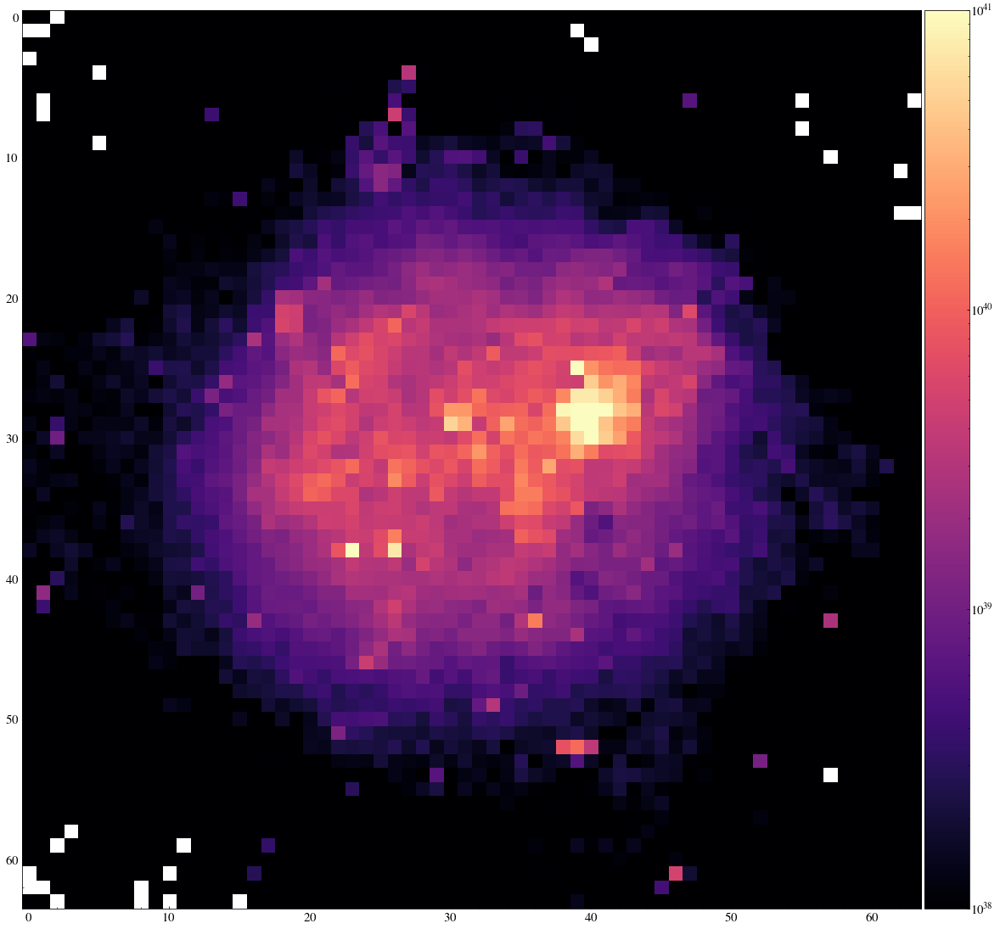

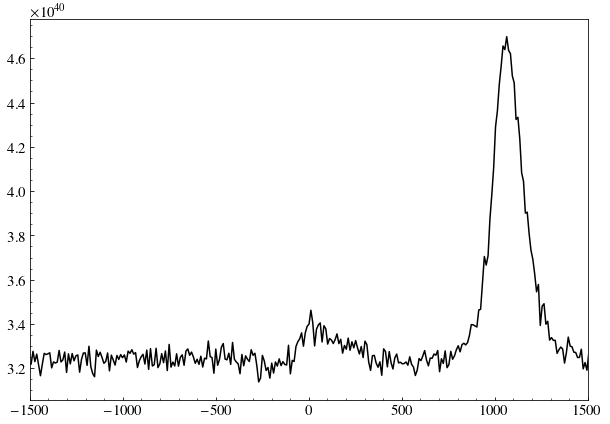

In [84]:
idir = 0
spec = np.sum(cubeSiII[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1

vcII  = (lcubeSiII[1:]/wsiII1260-1)*c
fig,ax = plt.subplots(1,1,figsize=(20,20))

cmap = 'magma'

imagecont = np.sum(cubeSiII[idir,:,:,:],axis=(2))#/ (imsize/nxy)**2 
# ax1 = axs[0]
im1 = ax.imshow(imagecont, norm=LogNorm(vmin=1e38,vmax=1e41), cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im1, cax=cax, orientation='vertical')
# ax2 = axs[1]
plt.figure(figsize=(10,7))
plt.plot(vcII, spec, c= 'k')
plt.xlim(-1500,1500)

### Different components

[34]


<ipython-input-52-59f3e5517928>:34: RuntimeWarning: divide by zero encountered in true_divide
  im3 = ax3.imshow(imageabs/imagecont, vmin = 0, vmax = 3., cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
<ipython-input-52-59f3e5517928>:34: RuntimeWarning: invalid value encountered in true_divide
  im3 = ax3.imshow(imageabs/imagecont, vmin = 0, vmax = 3., cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
<ipython-input-52-59f3e5517928>:50: RuntimeWarning: divide by zero encountered in true_divide
  im5 = ax5.imshow(imageemi/imagecont,  vmin = 0, vmax = 3., cmap = cmap) #norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
<ipython-input-52-59f3e5517928>:50: RuntimeWarning: invalid value encountered in true_divide
  im5 = ax5.imshow(imageemi/imagecont,  vmin = 0, vmax = 3., cmap = cmap) #norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.


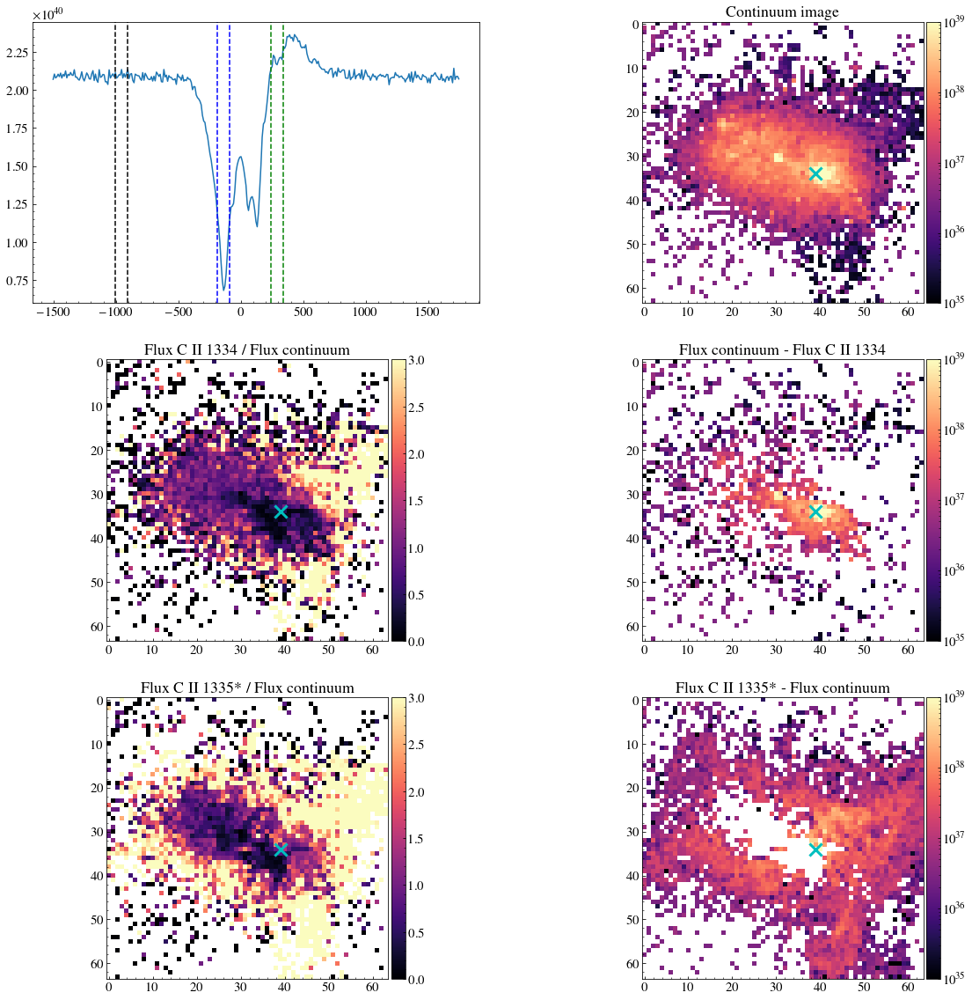

In [52]:
# #### plotting a spectrum
from matplotlib.colors import LogNorm
cmap = 'magma'
idir = 100
spec = np.sum(cubecII[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1

vcII  = (lcubecII[1:]/wcII1334-1)*c
fig,((ax1, ax2), (ax3, ax4), (ax5, ax6)) = plt.subplots(3,2,figsize=(20,20))
ax1.plot(vcII,spec) 
ax1.axvline(vcII[50], c = 'k', linestyle = '--')
ax1.axvline(vcII[60], c= 'k', linestyle = '--')

ax1.axvline(vcII[132], c = 'b', linestyle = '--')
ax1.axvline(vcII[142], c= 'b', linestyle = '--')

ax1.axvline(vcII[175], c = 'g', linestyle = '--')
ax1.axvline(vcII[185], c = 'g', linestyle = '--')


imagecont = np.sum(cubecII[idir,:,:,50:60],axis=(2))#/ (imsize/nxy)**2 
imageabs  = np.sum(cubecII[idir,:,:,132:142],axis=(2))#/ (imsize/nxy)**2 
imageemi  = np.sum(cubecII[idir,:,:,175:185],axis=(2))#/ (imsize/nxy)**2  #/ (imsize/nxy)**2  # imsize is around 7.7 kpc, the side of the square
print(np.where(imagecont == np.max(imagecont))[0])
# ax1 = axs[0]
im1 = ax2.imshow(imagecont, norm=LogNorm(vmin=1e35,vmax=1e39), cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax2.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax2)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im1, cax=cax, orientation='vertical')
ax2.set_title('Continuum image')
# ax2 = axs[1]

im3 = ax3.imshow(imageabs/imagecont, vmin = 0, vmax = 3., cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im3, cax=cax, orientation='vertical')
ax3.set_title('Flux C II 1334 / Flux continuum')
ax3.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
# ax3 = axs[2]
im4 = ax4.imshow(imagecont-imageabs,norm=LogNorm(vmin=1e35,vmax=1e39), cmap = cmap) #norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax4.set_title('Flux continuum - Flux C II 1334')
ax4.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax4)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im4, cax=cax, orientation='vertical')

im5 = ax5.imshow(imageemi/imagecont,  vmin = 0, vmax = 3., cmap = cmap) #norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax5.set_title('Flux C II 1335* / Flux continuum')
ax5.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax5)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im5, cax=cax, orientation='vertical')


im6 = ax6.imshow(imageemi- imagecont, norm=LogNorm(vmin=1e35,vmax=1e39), cmap = cmap) #norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax6.set_title('Flux C II 1335* - Flux continuum')
ax6.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax6)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im6, cax=cax, orientation='vertical')





## Contour analysis

In [ ]:
# #### plotting a spectrum
from matplotlib.colors import LogNorm
from matplotlib.lines import Line2D

idir = 260
print(fesc[148-90,idir])
# nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII2/',300)
fig,(ax2, ax1,ax3,ax4) = plt.subplots(1,4,figsize=(20,5))

cmap = 'jet'
cmap = plt.cm.jet_r
cmaplist = [cmap(i) for i in range(cmap.N)]

for i in range(len(cmaplist)):
    cmaplist[i] = (1-cmaplist[i][0], 1-cmaplist[i][1],1-cmaplist[i][2], 1.)

cmap = matplotlib.colors.LinearSegmentedColormap.from_list('mcm',cmaplist, cmap.N)


spec = np.sum(cubeSiII[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1

vcII  = (lcubeSiII[1:]/wsiII1260-1)*c
fig,ax = plt.subplots(figsize=(8,6))
ax.plot(vcII,spec) 

idres = np.argmin(spec) -8# 120
idres2 = np.argmin(spec) +25

ax.axvline(vcII[idres], c = 'b', linestyle = '--')
ax.axvline(vcII[idres2], c= 'b', linestyle = '--')

idflu = np.argmax(spec)-10
idflu2 =  np.argmax(spec)+10

ax.axvline(vcII[idflu], c = 'g', linestyle = '--')
ax.axvline(vcII[idflu2], c = 'g', linestyle = '--')
ax.axvline(vcII[idflu+70], c = 'k', linestyle = '--')
ax.axvline(vcII[idflu2+70], c= 'k', linestyle = '--')
ax.set_xlim(-1000,2000)
imageall = np.sum(cubeSiII[idir,:,:,:],axis=(2))#/ (imsize/nxy)**2 

imagecont = np.sum(cubeSiII[idir,:,:,idflu+70:idflu2+70],axis=(2))#/ (imsize/nxy)**2 
imageabs  = np.sum(cubeSiII[idir,:,:,idres:idres2],axis=(2))#/ (imsize/nxy)**2 
imageemi  = np.sum(cubeSiII[idir,:,:,idflu:idflu2],axis=(2))#/

cx,cy = np.where(imagecont == np.max(imagecont))
cx = int(cx)
cy = int(cy)


#fig,(ax1, ax2, ax3,ax4) = plt.subplots(1,4,figsize=(20,14))

ax2.imshow(imageall, norm=LogNorm(vmin=1e35,vmax=1e41), cmap='Blues_r', interpolation="nearest",origin = 'lower',
          aspect = 'auto')
dd = imagecont.copy()
dd = np.sort(dd.flatten())[::-1]
cumdd = np.cumsum(dd)

lvl = 0.5
idx = np.linspace(0,len(cumdd)-1,len(cumdd))
gidx = int(idx[cumdd>=lvl*cumdd[-1]][0])
aa = dd[gidx]

pp = imagecont.copy()
pp[pp<aa] = 0

axins = zoomed_inset_axes(ax2, 2, loc=1) # zoom = 6
axins.imshow(imageall, interpolation="nearest",
            norm=LogNorm(vmin=1e35,vmax=1e41), cmap='Blues_r')


axins.set_xlim(cy-6, cy+6)
axins.set_ylim(cx-6, cx+6)
axins.set_xticks([])
axins.set_yticks([])



ax2.contour( pp, levels=[aa], colors='purple',  linewidths=3, zorder = 10)
axins.contour( pp, levels=[dd[gidx]], colors='purple', alpha=1, linewidths=2, zorder = 10)

nsp = cubeSiII[idir,:,:,:].copy()
nsp[imagecont<dd[gidx]] = 0
spec_cont_in = np.sum(nsp[:,:,1:],axis=(0,1))
ax1.plot(vcII, spec_cont_in/1e40, color = 'purple', linestyle = ':')
nsp = cubeSiII[idir,:,:,:].copy()
nsp[imagecont>=dd[gidx]] = 0
spec_cont_out = np.sum(nsp[:,:,1:],axis=(0,1))
ax1.plot(vcII, spec_cont_out/1e40, color = 'purple', linestyle = '--')
ax1.plot(vcII, spec/1e40, color = 'k')


# ax2.scatter(cy,cx, s = 200, color = 'red', marker = '+', linewidths=3 )
# axins.scatter(cy,cx, s = 200, color = 'red', marker = '+', linewidths=2 )

########## ABS

dd = abs(imageabs.copy())#.copy() 
dd = np.sort(dd.flatten())[::-1]
cumdd = np.cumsum(dd)
idx = np.linspace(0,len(cumdd)-1,len(cumdd))
print(cumdd[-1], cumdd[0])

gidx = int(idx[cumdd>=lvl*cumdd[-1]][0])
aa = dd[gidx]
# ax2.imshow(imageabs, norm=LogNorm(vmin=1e35,vmax=1e39), cmap = 'magma')
# ax2.scatter(cy,cx, s = 200, color = 'cyan', marker = 'x', linewidths=3 )
pp = abs(imageabs).copy()
pp[pp<aa] = 0
aa2 = aa

ax2.contour( pp, levels=[dd[gidx]], colors=cnoFS, alpha=1, linewidths=3)
axins.contour( pp, levels=[dd[gidx]], colors=cnoFS, alpha=1, linewidths=2)

nsp1 = cubeSiII[idir,:,:,:].copy()
nsp1[imageabs<dd[gidx]] = 0
spec_abs_in = np.sum(nsp1[:,:,1:],axis=(0,1))
ax3.plot(vcII, spec_abs_in/1e40, color = cnoFS, linestyle = ':')

nsp2 = cubeSiII[idir,:,:,:].copy()
nsp2[imageabs>=dd[gidx]] = 0
spec_abs_out = np.sum(nsp2[:,:,1:],axis=(0,1))
ax3.plot(vcII, spec_abs_out/1e40, color = cnoFS, linestyle = '--')
ax3.plot(vcII, spec/1e40, color = 'k')

dd = (imageemi-imagecont).copy()
dd = np.sort(dd.flatten())[::-1]
cumdd = np.cumsum(dd)

idx = np.linspace(0,len(cumdd)-1,len(cumdd))
gidx = int(idx[cumdd>=lvl*cumdd[-1]][0])
aa = dd[gidx]

# ax3.imshow((imageemi-imagecont), norm=LogNorm(vmin=1e35,vmax=1e39), cmap = 'magma')
pp = (imageemi-imagecont).copy()
pp[pp<aa] = 0
ax2.contour( pp, levels=[dd[gidx]], colors='mediumseagreen', alpha=1, linewidths=3)
axins.contour( pp, levels=[dd[gidx]], colors='mediumseagreen', alpha=1, linewidths=2)

nsp3 = cubeSiII[idir,:,:,:].copy()
nsp3[((imageemi-imagecont))<dd[gidx]] = 0
# nsp3[nsp1 == 0] = 0

spec_emi_in = np.sum(nsp3[:,:,1:],axis=(0,1))
ax4.plot(vcII, spec_emi_in/1e40, color ='mediumseagreen', linestyle = ':')

nsp4 = cubeSiII[idir,:,:,:].copy()
nsp4[((imageemi-imagecont))>=dd[gidx]] = 0
# nsp4[nsp2 == 0] = 0
spec_emi_out = np.sum(nsp4[:,:,1:],axis=(0,1))
ax4.plot(vcII, spec_emi_out/1e40, linestyle = '--', color = 'mediumseagreen', linewidth = 2)
ax4.plot(vcII, spec/1e40, color = 'k')

colors = ['black', 'black', 'black']
line1 = Line2D([0], [0], color='k', linewidth=3)
line2 = Line2D([0], [0], color='k', linewidth=3, linestyle=':')
line3 = Line2D([0], [0], color='k', linewidth=3, linestyle='--')

labels = ['Full spectrum', 'Spectrum inside contour', 'Spectrum outside contour']
ax3.legend([line1,line2,line3], labels, loc = (-1,1.01), ncol = 3, fontsize = 18)


# for ax, color in zip([ax1, ax3, ax4], ['red', 'orange', 'mediumseagreen']):

#    plt.setp(ax.spines.values(), color=color)
#    ax.plot([8, 3], c=color)
#    plt.setp([ax.get_xticklines(), ax.get_yticklines()], color=color)
ax2.set_xticks([])
ax2.set_yticks([])






## Light curve in one dir

In [ ]:
## Light curves + spectra in increasing rings

idir = 129
spec = np.sum(cube[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
vcII  = (l[1:]/wcII1334-1)*c
fig,ax = plt.subplots(figsize=(8,6))
plt.plot(vcII,spec) 
plt.axvline(vcII[51], c = 'k', linestyle = '--')
plt.axvline(vcII[150], c= 'b', linestyle = '--')
plt.axvline(vcII[191], c = 'g', linestyle = '--')

imagecont = np.sum(cube[idir,:,:,50:52],axis=(2))#/ (imsize/nxy)**2 
imagecii = np.sum(cube[idir,:,:,149:151],axis=(2))#/ (imsize/nxy)**2 
imagefluo = np.sum(cube[idir,:,:,190:192],axis=(2))#/ (imsize/nxy)**2 

fig,(ax1, ax2,ax3) = plt.subplots(1,3,figsize=(20,20))

# ax1 = axs[0]
im1 = ax1.imshow(imagecont, norm=LogNorm(vmin=1e35,vmax=1e39), cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax1.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax1)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im1, cax=cax, orientation='vertical')
ax1.set_title('Continuum image')
# ax2 = axs[1]

im2 = ax2.imshow(imagecii, norm=LogNorm(vmin=1e35,vmax=1e39),  cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
divider = make_axes_locatable(ax2)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im2, cax=cax, orientation='vertical')
ax2.set_title('Flux C II 1334 ')
ax2.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
# ax3 = axs[2]
im3 = ax3.imshow(imagefluo, norm=LogNorm(vmin=1e35,vmax=1e39),  cmap = cmap) #norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax3.set_title('Flux C II 1335*')
ax3.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im3, cax=cax, orientation='vertical')




y,x = np.where(imagecont == np.max(imagecont))

rfluxcont = np.zeros([71])
rrad  = np.zeros([71])
totalcont = np.zeros([71])
rfluxcii = np.zeros([71])
totalcii = np.zeros([71])
rfluxfluo = np.zeros([71])
totalfluo = np.zeros([71])

aperture = CircularAperture([x[0],y[0]], r=1) 
aperture_masks = aperture.to_mask(method='center') # create mask
fimagecont = aperture_masks.multiply(imagecont) # apply mask to data
fimagecii = aperture_masks.multiply(imagecii) # apply mask to data
fimagefluo = aperture_masks.multiply(imagefluo) # apply mask to data

rfluxcont[0] = np.sum(fimagecont)
rrad[0]  = 1
totalcont[0] = rfluxcont[0]
rfluxcii[0] = np.sum(fimagecii)
totalcii[0] = rfluxcii[0]
rfluxfluo[0] = np.sum(fimagefluo)
totalfluo[0] = rfluxfluo[0]
# plt.imshow(fimage2)
for kk in range(1,71):
    ppix1 = kk 
    ppix2 = (kk+1) 
    aperture2 = CircularAnnulus([x[0],y[0]], r_in=ppix1, r_out=ppix2) 
    aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask
    fimagecont = aperture_masks2.multiply(imagecont)
    fimagecii = aperture_masks2.multiply(imagecii) # apply mask to data
    fimagefluo = aperture_masks2.multiply(imagefluo) # apply mask to data
    
    rrad[kk]  = kk + 1
    rfluxcont[kk] = np.sum(fimagecont)
    totalcont[kk] = totalcont[kk-1] + rfluxcont[kk]
    rfluxcii[kk] = np.sum(fimagecii)
    totalcii[kk] = totalcii[kk-1] + rfluxcii[kk]
    rfluxfluo[kk] = np.sum(fimagefluo)
    totalfluo[kk] = totalfluo[kk-1] + rfluxfluo[kk]

plt.figure(figsize = (10,8))
plt.plot(rrad*(imsize/nxy),np.log10(rfluxcont),label='Light Profile at continuum')
plt.plot(rrad*(imsize/nxy),np.log10(rfluxcii),label='Light Profile at ~1334A')
plt.plot(rrad*(imsize/nxy),np.log10(rfluxfluo),label='Light Profile at ~1335*')
plt.xlabel('Radius (parsec)', fontsize = 18)
plt.ylabel('Surface brightness', fontsize = 18)
plt.legend()



## Spectra in different annulus

In [ ]:
## Light curves + spectra in increasing rings
from regions import PixCoord, CircleSkyRegion, CirclePixelRegion, RectangleSkyRegion, RectanglePixelRegion
import photutils
from photutils import CircularAperture, CircularAnnulus

idir = 129
spec = np.sum(cube[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
vcII  = (l[1:]/wcII1334-1)*c
fig,ax = plt.subplots(figsize=(8,6))
plt.plot(vcII,spec) 
cx = 149
plt.axvline(vcII[55], c = 'k', linestyle = '--')
plt.axvline(vcII[cx], c= 'b', linestyle = '--')
plt.axvline(vcII[180], c = 'g', linestyle = '--')

imagecont = np.sum(cube[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 
imagecii = np.sum(cube[idir,:,:,cx-1:cx+1],axis=(2))#/ (imsize/nxy)**2 
imagefluo = np.sum(cube[idir,:,:,180:182],axis=(2))#/ (imsize/nxy)**2 

fig,(ax1, ax2,ax3) = plt.subplots(1,3,figsize=(20,20))

# ax1 = axs[0]
im1 = ax1.imshow(imagecont, norm=LogNorm(vmin=1e35,vmax=1e39), cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax1.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax1)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im1, cax=cax, orientation='vertical')
ax1.set_title('Continuum image')
# ax2 = axs[1]

im2 = ax2.imshow(imagecii, norm=LogNorm(vmin=1e35,vmax=1e39),  cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
divider = make_axes_locatable(ax2)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im2, cax=cax, orientation='vertical')
ax2.set_title('Flux C II 1334 / Flux continuum')
ax2.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
# ax3 = axs[2]
im3 = ax3.imshow(imagefluo, norm=LogNorm(vmin=1e35,vmax=1e39),  cmap = cmap) #norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax3.set_title('Flux C II 1335* / Flux continuum')
ax3.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im3, cax=cax, orientation='vertical')


y,x = np.where(imagecont == np.max(imagecont))


aperture = CircularAperture([x[0],y[0]], r=1) 
aperture_masks = aperture.to_mask(method='center') # create mask
fimageori = cube[idir,:,:,:].copy()
fimage = []

for i in range(cube.shape[-1]):
    fimage.append(aperture_masks.multiply(fimageori[:,:,i]))
    
# print(fimage)
spec_center = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))



aperture2 = CircularAnnulus([x[0],y[0]], r_in=1, r_out=5) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_center2 = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))


aperture2 = CircularAnnulus([x[0],y[0]], r_in=5, r_out=10) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_center3 = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))


aperture2 = CircularAnnulus([x[0],y[0]], r_in=10, r_out=20) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_center4 = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))

aperture2 = CircularAnnulus([x[0],y[0]], r_in=20, r_out=50) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_center5 = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))


aperture2 = CircularAperture([x[0],y[0]], r=50) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_all = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))


fig, (ax1, ax2) = plt.subplots(2,1,figsize = (20,15))
ax1.plot(vcII,spec_center[1:],drawstyle='steps-mid', label = f'r $<$ {120} pc') 
ax1.plot(vcII,spec_center2[1:],drawstyle='steps-mid', label = f'{120} $<$ r $<$ {5*120} pc') 
ax1.plot(vcII,spec_center3[1:],drawstyle='steps-mid', label = f'{5*120} $<$ r $<$ {10*120} pc') 
# plt.plot(vcII,spec_center4[1:],drawstyle='steps-mid') 
ax1.plot(vcII,spec_center5[1:],drawstyle='steps-mid', label = f'{20*120} $<$ r $<$ {50*120} pc') 
ax1.plot(vcII,spec_all[1:],drawstyle='steps-mid', label = f'Full spectra', c = 'k') 
ax1.legend(frameon = False, fontsize = 20)
# ax1.set_yscale('log')
ax2.plot(vcII,spec_center[1:]/np.median(spec_center),drawstyle='steps-mid', label = f'r $<$ {120} pc') 
ax2.plot(vcII,spec_center2[1:]/np.median(spec_center2),drawstyle='steps-mid', label = f'{120} $<$ r $<$ {5*120} pc') 
ax2.plot(vcII,spec_center3[1:]/np.median(spec_center3),drawstyle='steps-mid', label = f'{5*120} $<$ r $<$ {10*120} pc') 
# plt.plot(vcII,spec_center4[1:],drawstyle='steps-mid') 
ax2.plot(vcII,spec_center5[1:]/np.median(spec_center5),drawstyle='steps-mid', label = f'{20*120} $<$ r $<$ {50*120} pc') 
ax2.plot(vcII,spec_all[1:]/np.median(spec_all),drawstyle='steps-mid', label = f'Full spectra', c = 'k') 
ax2.legend(frameon = False, fontsize = 20)


## Spectra in increasing radii

In [ ]:
## Light curves + spectra in increasing rings
from regions import PixCoord, CircleSkyRegion, CirclePixelRegion, RectangleSkyRegion, RectanglePixelRegion
import photutils
from photutils import CircularAperture, CircularAnnulus

idir = 129
spec = np.sum(cube[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
vcII  = (lcube[1:]/wcII1334-1)*c
fig,ax = plt.subplots(figsize=(8,6))
plt.plot(vcII,spec) 
cx = 149
plt.axvline(vcII[55], c = 'k', linestyle = '--')
plt.axvline(vcII[cx], c= 'b', linestyle = '--')
plt.axvline(vcII[180], c = 'g', linestyle = '--')

imagecont = np.sum(cube[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 
imagecii = np.sum(cube[idir,:,:,cx-1:cx+1],axis=(2))#/ (imsize/nxy)**2 
imagefluo = np.sum(cube[idir,:,:,180:182],axis=(2))#/ (imsize/nxy)**2 

fig,(ax1, ax2,ax3) = plt.subplots(1,3,figsize=(20,20))

# ax1 = axs[0]
im1 = ax1.imshow(imagecont, norm=LogNorm(vmin=1e35,vmax=1e39), cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax1.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax1)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im1, cax=cax, orientation='vertical')
ax1.set_title('Continuum image')
# ax2 = axs[1]

im2 = ax2.imshow(imagecii, norm=LogNorm(vmin=1e35,vmax=1e39),  cmap = cmap)#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
divider = make_axes_locatable(ax2)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im2, cax=cax, orientation='vertical')
ax2.set_title('Flux C II 1334 / Flux continuum')
ax2.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
# ax3 = axs[2]
im3 = ax3.imshow(imagefluo, norm=LogNorm(vmin=1e35,vmax=1e39),  cmap = cmap) #norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.
ax3.set_title('Flux C II 1335* / Flux continuum')
ax3.scatter(np.where(imagecont == np.max(imagecont))[1],np.where(imagecont == np.max(imagecont))[0], 
            s= 200, linewidth = 3, color = 'c', marker = 'x')
divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im3, cax=cax, orientation='vertical')


y,x = np.where(imagecont == np.max(imagecont))


aperture = CircularAperture([x[0],y[0]], r=1) 
aperture_masks = aperture.to_mask(method='center') # create mask
fimageori = cube[idir,:,:,:].copy()
fimage = []

for i in range(cube.shape[-1]):
    fimage.append(aperture_masks.multiply(fimageori[:,:,i]))
    
# print(fimage)
spec_center = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))



aperture2 = CircularAperture([x[0],y[0]], r = 2) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_center2 = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))


aperture2 = CircularAperture([x[0],y[0]], r = 3) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_center3 = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))


aperture2 = CircularAperture([x[0],y[0]], r = 5) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_center4 = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))

aperture2 = CircularAperture([x[0],y[0]], r = 10) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_center5 = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))


aperture2 = CircularAperture([x[0],y[0]], r=50) 
aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask

fimage = []
for i in range(cube.shape[-1]):
    fimage.append(aperture_masks2.multiply(fimageori[:,:,i]))

spec_all = np.sum(np.asarray(fimage)[:,:,:],axis=(1,2))


fig, (ax1, ax2) = plt.subplots(2,1,figsize = (20,15))
ax1.plot(vcII,spec_center[1:],drawstyle='steps-mid', label = f'r $<$ {120} pc') 
ax1.plot(vcII,spec_center2[1:],drawstyle='steps-mid', label = f'{120} $<$ r $<$ {5*120} pc') 
ax1.plot(vcII,spec_center3[1:],drawstyle='steps-mid', label = f'{5*120} $<$ r $<$ {10*120} pc') 
# plt.plot(vcII,spec_center4[1:],drawstyle='steps-mid') 
ax1.plot(vcII,spec_center5[1:],drawstyle='steps-mid', label = f'{20*120} $<$ r $<$ {50*120} pc') 
ax1.plot(vcII,spec_all[1:],drawstyle='steps-mid', label = f'Full spectra', c = 'k') 
ax1.legend(frameon = False, fontsize = 20)
# ax1.set_yscale('log')
ax2.plot(vcII,spec_center[1:]/np.median(spec_center),drawstyle='steps-mid', label = f'r $<$ {120} pc') 
ax2.plot(vcII,spec_center2[1:]/np.median(spec_center2),drawstyle='steps-mid', label = f'{120} $<$ r $<$ {5*120} pc') 
ax2.plot(vcII,spec_center3[1:]/np.median(spec_center3),drawstyle='steps-mid', label = f'{5*120} $<$ r $<$ {10*120} pc') 
# plt.plot(vcII,spec_center4[1:],drawstyle='steps-mid') 
ax2.plot(vcII,spec_center5[1:]/np.median(spec_center5),drawstyle='steps-mid', label = f'{20*120} $<$ r $<$ {50*120} pc') 
ax2.plot(vcII,spec_all[1:]/np.median(spec_all),drawstyle='steps-mid', label = f'Full spectra', c = 'k') 
ax2.legend(frameon = False, fontsize = 20)


Text(0, 0.5, 'Flux (erg/s/$\\lambda$)')

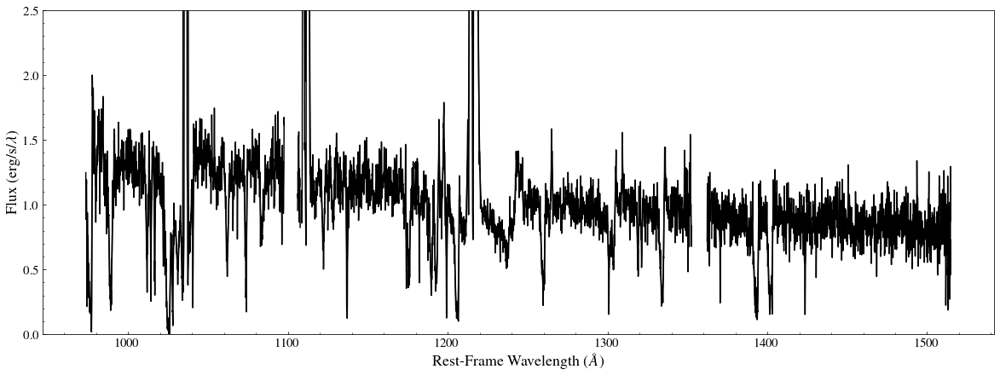

In [36]:

    spec = '../Classy/J14290643/J1429+0643_SB99fit.fits'
    hduin         = fits.open(spec)
    hdr           = hduin[1].header
    data          = hduin[1].data
    mask          = mask_all[i]

    wave=data['wave']

    flux = gaussian_filter(data['flux'], sigma = 6)
    err = data['err']

    
    fig, axs = plt.subplots(1,1,figsize=(20,7))
    axs.plot(wave, data['flux'],  c='k', label = 'Observed')

    axs.plot(wave, flux,  c='k', label = 'Observed')
    plt.ylim(0,2.5)
    plt.xlabel(r'Rest-Frame Wavelength ($\AA$)', fontsize = 18)
    plt.ylabel(r'Flux (erg/s/$\lambda$)', fontsize = 18)

#     axs[0].set_title('C II 1334')


In [47]:
from IPython.display import display, Latex

Latex(r"$F_{\rm obs}^\star (\lambda)  = (F_{\rm int}^\star (\lambda) + F^{\rm nebulae} (\lambda) ) \times e^{-\tau(\lambda)} $ " )

<IPython.core.display.Latex object>

In [66]:
Latex(r"$I(\lambda) = I_0 \times (Cfe^{-\tau(\lambda)} + (1-Cf))$" )
# Latex(r"$\tau_\nu$" )

<IPython.core.display.Latex object>

In [64]:
Latex(r"$F^{\rm H\ II\ region} (\lambda)$" )

<IPython.core.display.Latex object>

In [55]:
Latex(r"$10^{-0.4 A(\lambda)} $" )

<IPython.core.display.Latex object>

J0021_0052


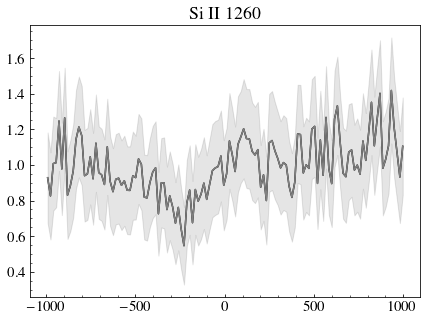

J0036_3333


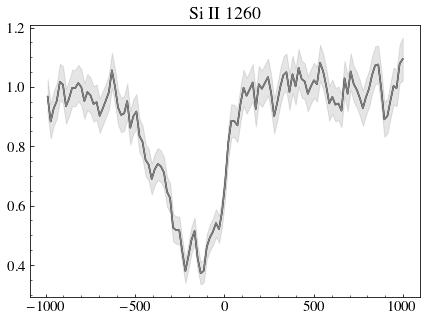

J0127_0619


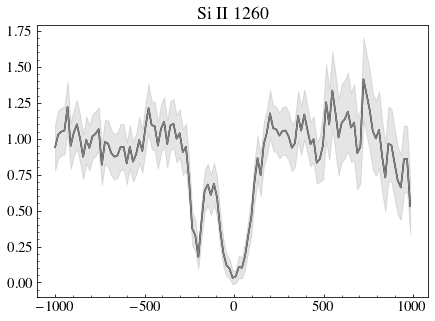

J0144_0453


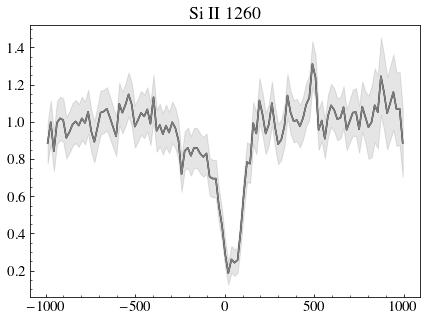

J0337_0502


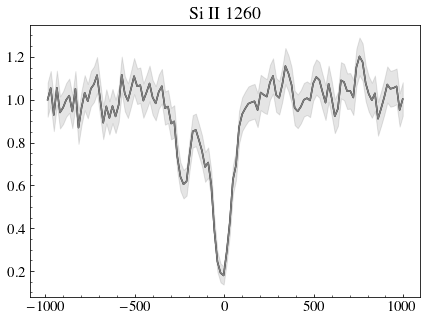

J0405_3648


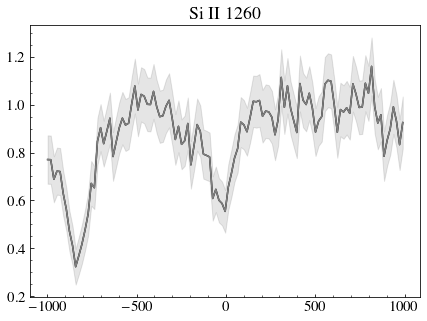

J0808_3948


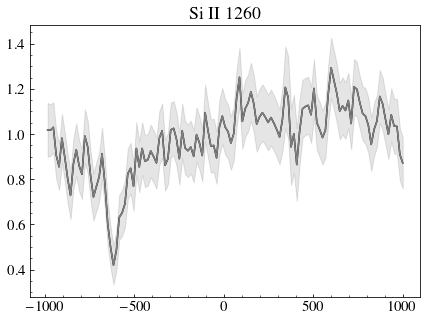

J0823_2806


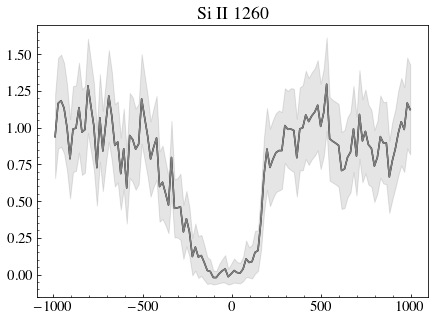

J0926_4427


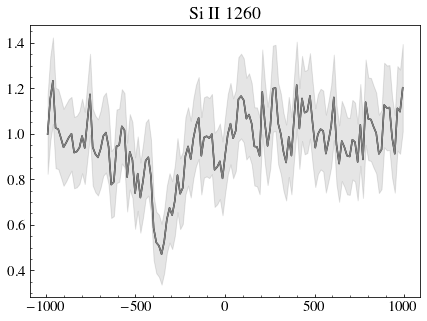

J0934_5514


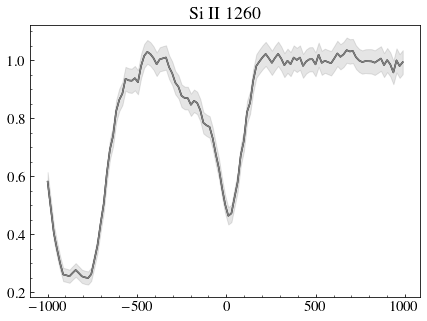

J0938_5428


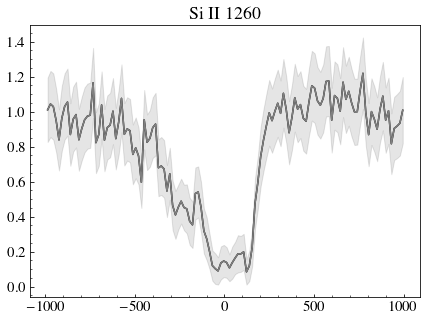

J0940_2935


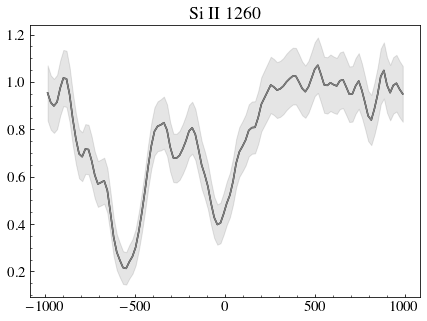

J0942_3547


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


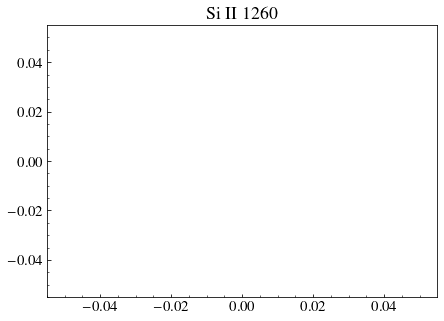

J0944_0038


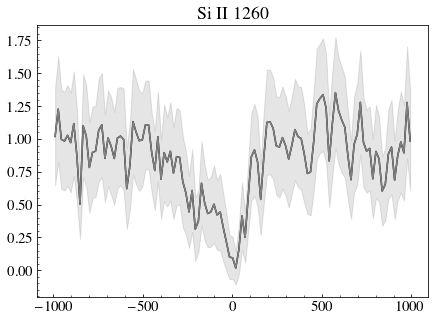

J0944_3442


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


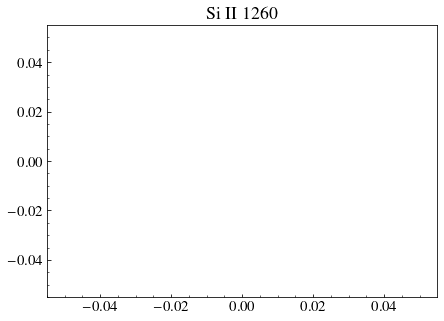

J1016_3754


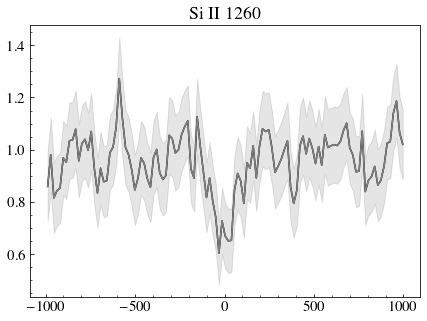

J1024_0524


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


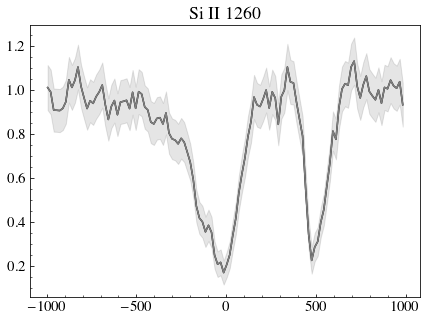

J1025_3622


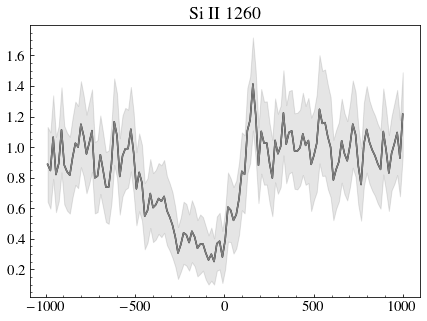

J1044_0353


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


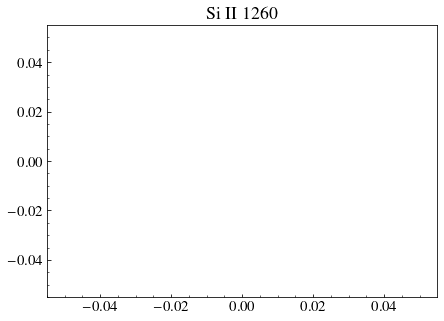

J1105_4444


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


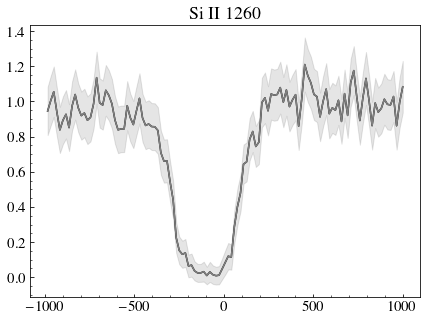

J1112_5503


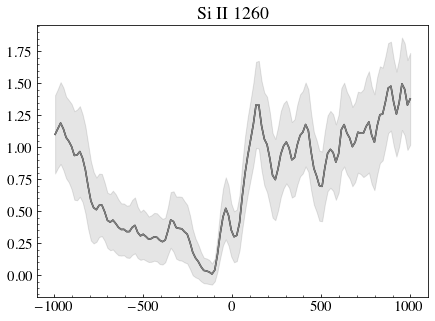

J1119_5130


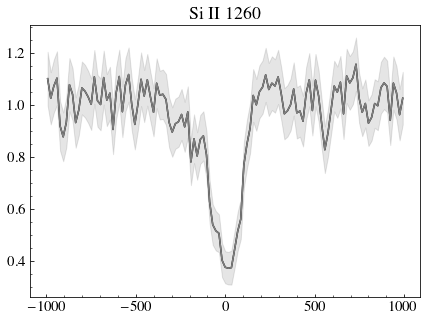

J1129_2034


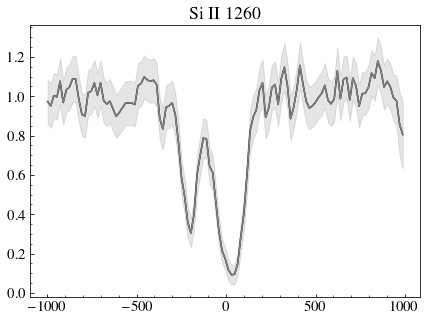

J1132_1411


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


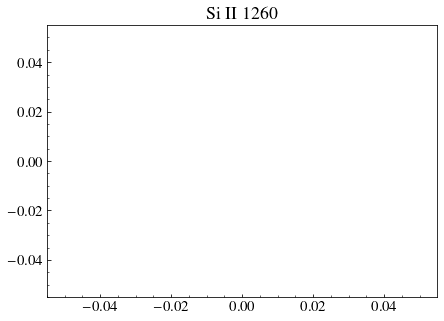

J1132_5722


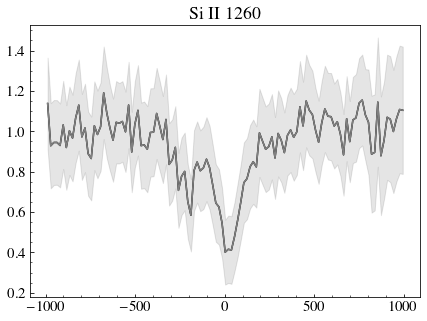

J1144_4012


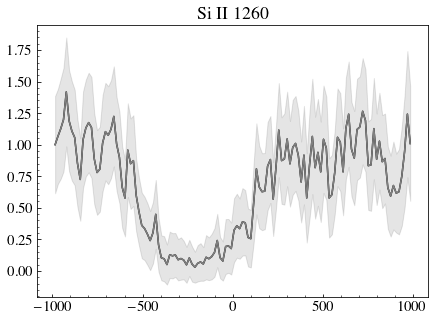

J1148_2546


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


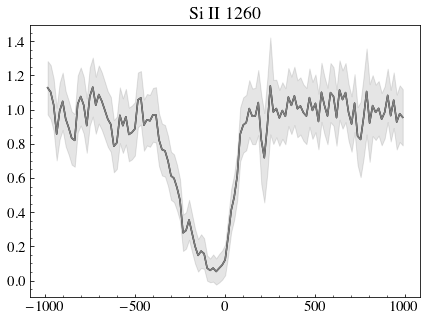

J1150_1501


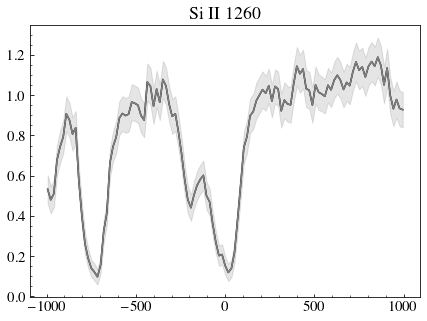

J1157_3220


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


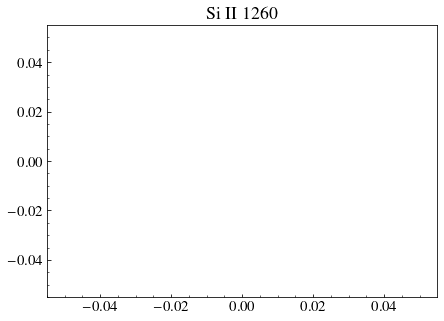

J1200_1343


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


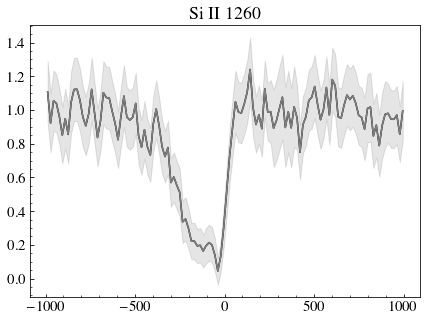

J1225_6109


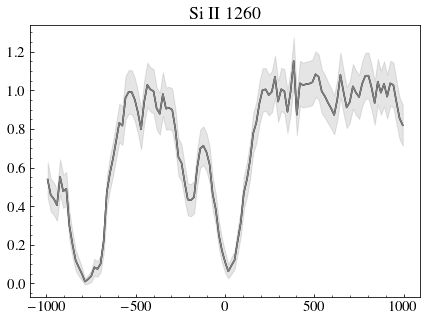

J1253_0312


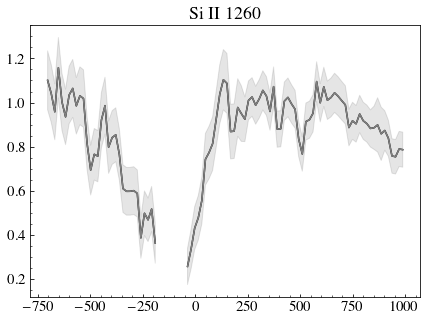

J1314_3452


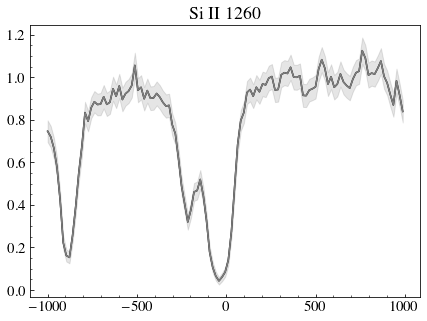

J1323_0132


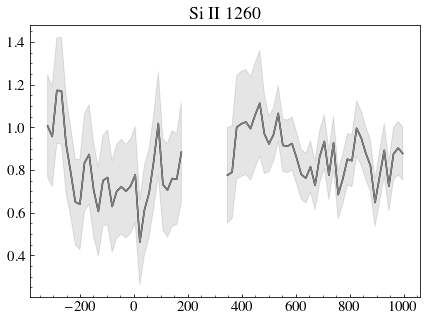

J1359_5726


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


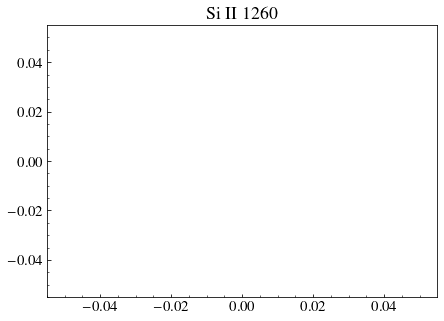

J1416_1223


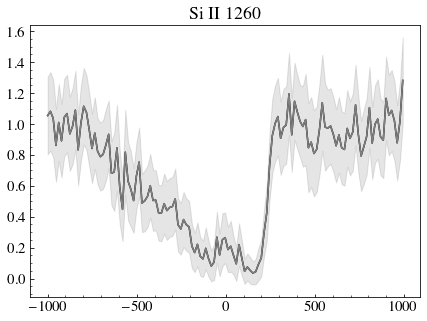

J1418_2102


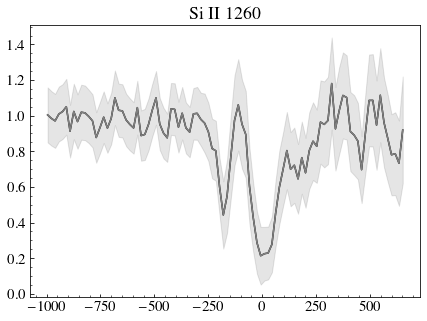

J1428_1653


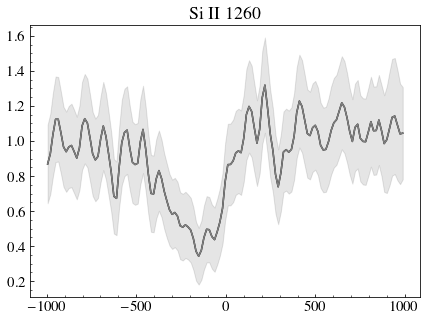

J1429_0643


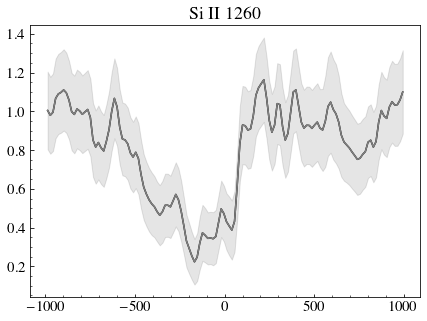

J1444_4237


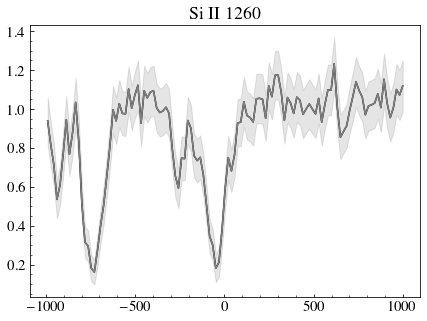

J1448_0110


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


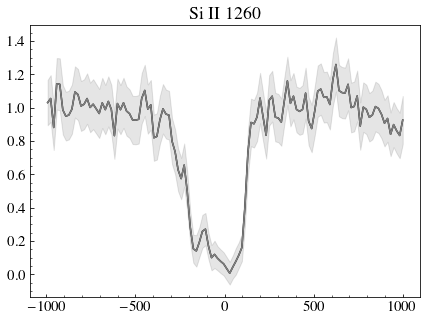

J1521_0759


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


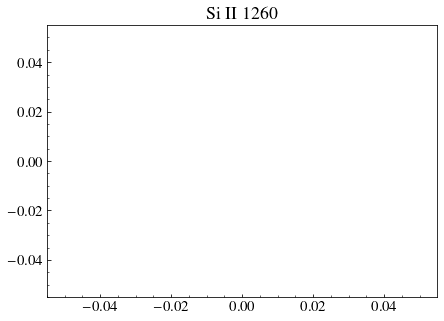

J1525_0757


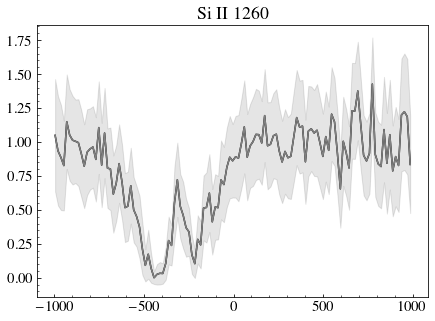

J1545_0858


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


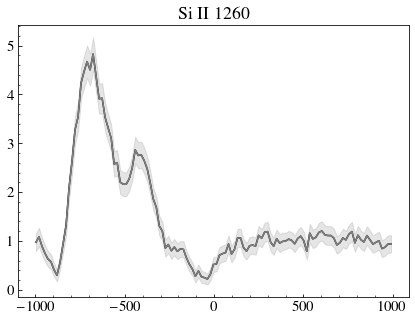

J1612_0817


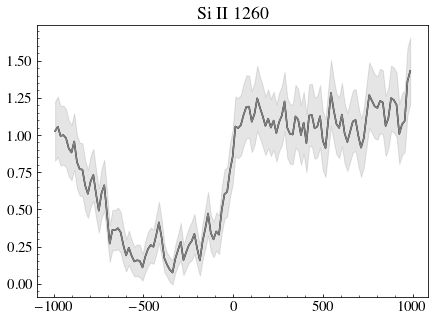

In [60]:
EWSi = np.zeros((45,2)) 
EWSi[EWSi == 0] = np.nan
EWC = np.zeros((45,2))
EWC[EWC == 0] = np.nan

FSi = np.zeros((45,2))
FSi[FSi == 0] = np.nan

FC = np.zeros((45,2))
FC[FC == 0] = np.nan

VSi = np.zeros((45,2))
VSi[VSi == 0] = np.nan

VC = np.zeros((45,2))
VC[VC == 0] = np.nan

for i in range(len(galaxy)):
   # i = 4
    spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[i].replace("_", ""), label[i])
    gal   = fits.open(spec)
#     print(galaxy[i])
#     if(galaxy[i] != 'J1323_0132'):
#         continue
    print(galaxy[i])
    HR    = gal[8].data  # Rest-frame, galactic extinction-corrected, co-added, high-resolution spectrum
    HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 

    wH, fH, eH, snrH  = HR['WAVE'],  HR['FLUX DENSITY'],  HR['ERROR'],  HR['SNR']
    wHB,fHB,eHB,snrHB = HRB['WAVE'], HRB['FLUX DENSITY'], HRB['ERROR'], HRB['SNR']

    hduin         = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    hdr           = hduin[1].header
    data          = hduin[1].data
    mask          = mask_all[i]

    wave=data['wave']
    vcIId = (data['wave']/wcII1334 -1)*c
    vsiIId =  (data['wave']/wsiII1260 -1)*c

    flux = data['flux']
    
   # fit = gaussian_filter(data['fit'], sigma = 10)
    err = data['err']
   # absflux = gaussian_filter(data['flux']/fit,sigma = 1)
   # abserr = err/fit
    
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1000)     
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-800) | ((vcII > 800) & (vcII < 1500))) & maskCII
    if(label[i] == 'j0808+3948'):
        rmedCII = ((vcII>-100) & (vcII < 100)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-800) | ((vsiII > 300) & (vsiII < 500))| ((vsiII > 1600) & (vsiII < 2000))) & maskSiII
    if(label[i] == 'j0808+3948'):
        rmedSiII = ((vsiII>-200) & (vsiII < 100)) & maskSiII
#     if(label[i] == 'j1323-1032'):
#         rmedSiII = ((vsiII>1000) & (vsiII < 1600)) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    
    
    fig, axs = plt.subplots(1,1,figsize=(7,5))
#     axs[0].plot(vcII, fcII,  c='k', label = 'Observed')
#     axs[0].fill_between(vcII,fcII-ecII/fmedCII, fcII+ecII/fmedCII,  color= 'k', alpha = 0.1)
#     axs[0].set_title('C II 1334')
#     axs[0].axhline(1, linestyle = '--', c = 'gray')


        
    axs.plot(vsiII, fsiII,   c = 'k' )
    axs.plot(vsiII, fsiII,   c = 'gray' )
    axs.fill_between(vsiII,fsiII-esiII/fmedSiII, fsiII+esiII/fmedSiII, color = 'k', alpha = 0.1)
    axs.set_title('Si II 1260')

    plt.show()
